## *Introduction*

Welcome to our football player scouting and analysis notebook! In this notebook, we explore the exciting field of football analytics, focusing on player performance, potential, and market value. Our goal is to uncover patterns and insights that can aid football clubs in their scouting efforts and player development strategies.

We'll also be exploring the distribution of unique players across different football leagues, identifying leagues that stand out in terms of player diversity. Furthermore, we'll be examining how the performance of specific players evolves over time, comparing the stats of different players, and much more.

In addition to visualizing data, we'll be applying supervised and unsupervised machine learning algorithms to predict various outcomes such as a player's overall rating, likelihood of injury, and market value. These predictive models can provide valuable insights for clubs looking to invest in new talent or manage their existing roster effectively.

## *Business Model*

Our business model revolves around providing actionable insights to football clubs, helping them make informed decisions about player recruitment and development. By leveraging data analytics and machine learning, we aim to:

- Identify promising young talents who could become future stars.
- Predict a player's future performance based on various factors such as age, current skill levels, injury history, etc.
- Estimate a player's market value, aiding clubs in transfer negotiations.
- Assess the risk of player injuries, helping clubs manage their squads more effectively.

## *Data Overview*
Our dataset combines hybrid data from the FIFA game spanning from 2018 to 2022, incorporating information from the top 5 football leagues worldwide (Premier League - Bundesliga - La Liga - Serie A - Ligue 1)



# Data preprocessing

## Importing libraries

In [1]:
!pip install understatapi adjustText streamlit folium geopandas

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 397.2/397.2 kB 6.6 MB/s eta 0:00:00a 0:00:01
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Installing backend dependencies ... done
  Preparing metadata (pyproject.toml) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 8.1/8.1 MB 61.5 MB/s eta 0:00:00:00:0100:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 147.5/147.5 kB 11.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 178.7/178.7 kB 13.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 58.8/58.8 kB 4.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 61.2/61.2 kB 4.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 138.1/138.1 kB 11.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.7/4.7 MB 71.6 MB/s eta 0:00:00:00:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 82.1/82.1 kB 6.4 MB/s eta 0:00:00
  Created wheel for understatapi: filename=understatapi-0.6.1-py3-none-any

In [2]:
import pandas as pd
import numpy as np
import plotly.express as px
import matplotlib.pyplot as plt
import plotly
import seaborn as sns
from sklearn.impute import KNNImputer
from understatapi import UnderstatClient
from sklearn.preprocessing import LabelEncoder,StandardScaler
from sklearn.feature_selection import SelectKBest,chi2,f_classif
from statsmodels.stats.outliers_influence import variance_inflation_factor as VIF
import requests
import folium
import plotly.graph_objects as go
import geopandas as gpd
import matplotlib.colors as mcolors
import re
from adjustText import adjust_text
import matplotlib.ticker as mtick

In [3]:
excel_file = pd.ExcelFile("/kaggle/input/fifa-players/fifa_2022_datasets/Career Mode player datasets - FIFA 15-22.xlsx")

for sheet_name in excel_file.sheet_names:
    sheet_data = excel_file.parse(sheet_name)
    csv_file_name = f"{sheet_name}.csv"
    sheet_data.to_csv(csv_file_name, index=False)
df18 = pd.read_csv("FIFA 18.csv")
df19 = pd.read_csv("FIFA 19.csv")
df20 = pd.read_csv("FIFA 20.csv")
df21 = pd.read_csv("FIFA 21.csv")
df22 = pd.read_csv("FIFA 22.csv")

/tmp/ipykernel_32/2679588775.py:7: DtypeWarning: Columns (81,82,83,84,85) have mixed types. Specify dtype option on import or set low_memory=False.
  df18 = pd.read_csv("FIFA 18.csv")
/tmp/ipykernel_32/2679588775.py:11: DtypeWarning: Columns (25,108) have mixed types. Specify dtype option on import or set low_memory=False.
  df22 = pd.read_csv("FIFA 22.csv")


In [4]:
df18['Year'] = 2018
df19['Year'] = 2019
df20['Year'] = 2020
df21['Year'] = 2021
df22['Year'] = 2022

## Merging dataframes

In [5]:
dfs = [ df18, df19, df20, df21,df22]
Main_df = pd.concat(dfs, axis=0, ignore_index=True)

In [6]:
Main_df

,sofifa_id,player_url,short_name,long_name,player_positions,overall,potential,value_eur,wage_eur,age,...,cb,rcb,rb,gk,player_face_url,club_logo_url,club_flag_url,nation_logo_url,nation_flag_url,Year
0,20801,https://sofifa.com/player/20801/c-ronaldo-dos-...,Cristiano Ronaldo,Cristiano Ronaldo dos Santos Aveiro,"LW, ST",94,94,95500000.0,575000.0,32,...,53+4,53+4,61+4,20+4,https://cdn.sofifa.net/players/020/801/18_120.png,https://cdn.sofifa.net/teams/243/60.png,https://cdn.sofifa.net/flags/es.png,https://cdn.sofifa.net/teams/1354/60.png,https://cdn.sofifa.net/flags/pt.png,2018
1,158023,https://sofifa.com/player/158023/lionel-messi/...,L. Messi,Lionel Andrés Messi Cuccittini,RW,93,93,105000000.0,575000.0,30,...,45+4,45+4,57+4,19+4,https://cdn.sofifa.net/players/158/023/18_120.png,https://cdn.sofifa.net/teams/241/60.png,https://cdn.sofifa.net/flags/es.png,https://cdn.sofifa.net/teams/1369/60.png,https://cdn.sofifa.net/flags/ar.png,2018
2,167495,https://sofifa.com/player/167495/manuel-neuer/...,M. Neuer,Manuel Peter Neuer,GK,92,92,61000000.0,225000.0,31,...,33+4,33+4,34+4,90+2,https://cdn.sofifa.net/players/167/495/18_120.png,https://cdn.sofifa.net/teams/21/60.png,https://cdn.sofifa.net/flags/de.png,https://cdn.sofifa.net/teams/1337/60.png,https://cdn.sofifa.net/flags/de.png,2018
3,176580,https://sofifa.com/player/176580/luis-suarez/1...,L. Suárez,Luis Alberto Suárez Díaz,ST,92,92,97000000.0,500000.0,30,...,58+4,58+4,64+4,37+4,https://cdn.sofifa.net/players/176/580/18_120.png,https://cdn.sofifa.net/teams/241/60.png,https://cdn.sofifa.net/flags/es.png,https://cdn.sofifa.net/teams/1377/60.png,https://cdn.sofifa.net/flags/uy.png,2018
4,190871,https://sofifa.com/player/190871/neymar-da-sil...,Neymar,Neymar da Silva Santos Júnior,LW,92,94,123000000.0,275000.0,25,...,46+4,46+4,59+4,20+4,https://cdn.sofifa.net/players/190/871/18_120.png,https://cdn.sofifa.net/teams/73/60.png,https://cdn.sofifa.net/flags/fr.png,https://cdn.sofifa.net/teams/1370/60.png,https://cdn.sofifa.net/flags/br.png,2018
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
92700,261962,https://sofifa.com/player/261962/defu-song/220002,Song Defu,宋德福,CDM,47,52,70000.0,1000.0,22,...,46+2,46+2,48+2,15+2,https://cdn.sofifa.net/players/261/962/22_120.png,https://cdn.sofifa.net/teams/112541/60.png,https://cdn.sofifa.net/flags/cn.png,NaN,https://cdn.sofifa.net/flags/cn.png,2022
92701,262040,https://sofifa.com/player/262040/caoimhin-port...,C. Porter,Caoimhin Porter,CM,47,59,110000.0,500.0,19,...,44+2,44+2,48+2,14+2,https://cdn.sofifa.net/players/262/040/22_120.png,https://cdn.sofifa.net/teams/445/60.png,https://cdn.sofifa.net/flags/ie.png,NaN,https://cdn.sofifa.net/flags/ie.png,2022
92702,262760,https://sofifa.com/player/262760/nathan-logue/...,N. Logue,Nathan Logue-Cunningham,CM,47,55,100000.0,500.0,21,...,45+2,45+2,47+2,12+2,https://cdn.sofifa.net/players/262/760/22_120.png,https://cdn.sofifa.net/teams/111131/60.png,https://cdn.sofifa.net/flags/ie.png,NaN,https://cdn.sofifa.net/flags/ie.png,2022
92703,262820,https://sofifa.com/player/262820/luke-rudden/2...,L. Rudden,Luke Rudden,ST,47,60,110000.0,500.0,19,...,26+2,26+2,32+2,15+2,https://cdn.sofifa.net/players/262/820/22_120.png,https://cdn.sofifa.net/teams/111131/60.png,https://cdn.sofifa.net/flags/ie.png,NaN,https://cdn.sofifa.net/flags/ie.png,2022


In [7]:
Main_df.shape

(92705, 111)

### Web scraping from understats by api

In [8]:
def understatdata(l,s):
    understat = UnderstatClient()


    league_player_data = understat.league(league=l).get_player_data(season=s)
    return league_player_data

In [9]:
epl_2018 = pd.DataFrame(understatdata('EPL','2018'))
epl_2019 = pd.DataFrame(understatdata('EPL','2019'))
epl_2020 = pd.DataFrame(understatdata('EPL','2020'))
epl_2021 = pd.DataFrame(understatdata('EPL','2021'))
epl_2022 = pd.DataFrame(understatdata('EPL','2022'))

In [10]:
laliga_2018 = pd.DataFrame(understatdata('La_Liga','2018'))
laliga_2019 = pd.DataFrame(understatdata('La_Liga','2019'))
laliga_2020 = pd.DataFrame(understatdata('La_Liga','2020'))
laliga_2021 = pd.DataFrame(understatdata('La_Liga','2021'))
laliga_2022 = pd.DataFrame(understatdata('La_Liga','2022'))

In [11]:
seriea_2018 = pd.DataFrame(understatdata('Serie_A','2018'))
seriea_2019 = pd.DataFrame(understatdata('Serie_A','2019'))
seriea_2020 = pd.DataFrame(understatdata('Serie_A','2020'))
seriea_2021 = pd.DataFrame(understatdata('Serie_A','2021'))
seriea_2022 = pd.DataFrame(understatdata('Serie_A','2022'))

In [12]:
bundesliga_2018 = pd.DataFrame(understatdata('Bundesliga','2018'))
bundesliga_2019 = pd.DataFrame(understatdata('Bundesliga','2019'))
bundesliga_2020 = pd.DataFrame(understatdata('Bundesliga','2020'))
bundesliga_2021 = pd.DataFrame(understatdata('Bundesliga','2021'))
bundesliga_2022 = pd.DataFrame(understatdata('Bundesliga','2022'))

In [13]:
Ligue1_2018 = pd.DataFrame(understatdata('Ligue_1','2018'))
Ligue1_2019 = pd.DataFrame(understatdata('Ligue_1','2019'))
Ligue1_2020 = pd.DataFrame(understatdata('Ligue_1','2020'))
Ligue1_2021 = pd.DataFrame(understatdata('Ligue_1','2021'))
Ligue1_2022 = pd.DataFrame(understatdata('Ligue_1','2022'))

In [14]:
understat_2018 = pd.concat([epl_2018,Ligue1_2018,seriea_2018,bundesliga_2018,laliga_2018],axis=0, ignore_index=True)
understat_2018['Year'] = 2018
understat_2018

,id,player_name,games,time,goals,xG,assists,xA,shots,key_passes,yellow_cards,red_cards,position,team_title,npg,npxG,xGChain,xGBuildup,Year
0,318,Pierre-Emerick Aubameyang,36,2740,22,23.549973130226135,5,4.9898480754345655,94,33,0,0,F M S,Arsenal,18,19.744131192564964,26.582433130592108,6.483639904297888,2018
1,838,Sadio Mané,36,3100,22,16.76279866695404,1,5.123735151253641,87,45,2,0,F M S,Liverpool,22,16.76279866695404,28.401348166167736,8.485083559527993,2018
2,1250,Mohamed Salah,38,3274,22,21.792449351400137,8,10.468590896576643,137,68,1,0,F S,Liverpool,19,19.50894832238555,31.78028777241707,7.865941375494003,2018
3,619,Sergio Agüero,33,2515,21,19.949161492288113,8,5.22924355044961,118,34,3,0,F S,Manchester City,19,18.42682258039713,28.700228951871395,8.10099308937788,2018
4,755,Jamie Vardy,34,2740,18,19.115979686379433,4,5.1373315351083875,79,32,3,1,F S,Leicester,14,15.310135943815112,20.782567070797086,1.9056932497769594,2018
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2590,7549,Abel Ruiz,1,20,0,0.26430800557136536,0,0.1129710003733635,1,1,0,0,S,Barcelona,0,0.26430800557136536,0.40181198716163635,0.02453329972922802,2018
2591,7555,Miguel Marí,2,68,0,0,0,0,0,0,0,0,S,Eibar,0,0,0,0,2018
2592,7586,Álex Collado,1,85,0,0.1281130015850067,0,0,2,0,0,0,S,Barcelona,0,0.1281130015850067,0.18404200673103333,0.055928800255060196,2018
2593,7604,Alejandro Catena,2,178,0,0.13818499445915222,0,0,3,0,1,0,D,Rayo Vallecano,0,0.13818499445915222,0.6171625033020973,0.6171625033020973,2018


In [15]:
understat_2019 = pd.concat([epl_2019,Ligue1_2019,seriea_2019,bundesliga_2019,laliga_2019],axis=0, ignore_index=True)
understat_2019['Year'] = 2019
understat_2019

,id,player_name,games,time,goals,xG,assists,xA,shots,key_passes,yellow_cards,red_cards,position,team_title,npg,npxG,xGChain,xGBuildup,Year
0,755,Jamie Vardy,35,3034,23,18.903520427644253,5,6.368295930325985,89,32,3,0,F S,Leicester,19,15.097683936357498,21.026604628190398,1.7243402246385813,2019
1,318,Pierre-Emerick Aubameyang,36,3143,22,16.352621614933014,3,4.492486532777548,93,26,3,1,F M S,Arsenal,20,14.830358684062958,19.964279878884554,5.339654562994838,2019
2,986,Danny Ings,38,2836,22,15.659720553085208,2,2.849086041562259,93,35,3,0,F M S,Southampton,21,14.137382855638862,18.488027464598417,5.015937743708491,2019
3,618,Raheem Sterling,33,2678,20,19.799912065267563,1,7.208590239286423,100,48,5,0,F M S,Manchester City,20,18.277569144964218,31.442028179764748,10.186004303395748,2019
4,1250,Mohamed Salah,34,2904,19,20.66332234814763,10,8.726041685789824,132,60,1,0,F S,Liverpool,16,18.379813332110643,31.37418942153454,8.425027072429657,2019
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2656,8507,Manuel Garrido,4,122,0,0.4791420102119446,0,0,1,0,1,0,F S,Leganes,0,0.4791420102119446,0.5973188085481524,0.11817679833620787,2019
2657,8509,Joan Monterde,1,1,0,0,0,0,0,0,0,0,S,Levante,0,0,0,0,2019
2658,8525,Álex Blesa,1,1,0,0,0,0,0,0,0,0,S,Levante,0,0,0.8855969905853271,0.8855969905853271,2019
2659,8531,Adrià Guerrero,2,125,0,0,0,0,0,0,1,0,D S,Valencia,0,0,0.14007000625133514,0.14007000625133514,2019


In [16]:
understat_2020 = pd.concat([epl_2020,Ligue1_2020,seriea_2020,bundesliga_2020,laliga_2020],axis=0, ignore_index=True)
understat_2020['Year'] = 2020
understat_2020

,id,player_name,games,time,goals,xG,assists,xA,shots,key_passes,yellow_cards,red_cards,position,team_title,npg,npxG,xGChain,xGBuildup,Year
0,647,Harry Kane,35,3097,23,22.174864932894707,14,7.57709795050323,138,49,1,0,F,Tottenham,19,19.130178958177567,24.995637115091085,4.451255418360233,2020
1,1250,Mohamed Salah,37,3085,22,20.250850511714816,5,6.528527559712529,126,55,0,0,F M S,Liverpool,16,15.683834107592702,28.968229439109564,9.800236526876688,2020
2,1228,Bruno Fernandes,37,3117,18,16.019450719468296,12,11.474997889250517,121,95,6,0,M S,Manchester United,9,8.407837779261172,26.91141940653324,11.932286506518722,2020
3,453,Son Heung-Min,37,3139,17,11.023286264389753,10,9.51299634668976,68,75,0,0,F M S,Tottenham,16,10.26211767271161,20.671933140605688,6.608754173852503,2020
4,822,Patrick Bamford,38,3085,17,18.40186234563589,7,3.782248348928988,107,30,3,0,F S,Leeds,15,16.879525646567345,23.394968066364527,4.13179549202323,2020
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2754,9457,José Boacho,4,21,0,0.018616599962115288,0,0,1,0,1,0,S,Getafe,0,0.018616599962115288,0.03350280039012432,0.014886200428009033,2020
2755,9496,Alejandro Cantero,4,245,0,0.44234349578619003,0,1.0825661644339561,3,3,1,0,F S,Levante,0,0.44234349578619003,1.4155192002654076,0.3262679874897003,2020
2756,9519,Carlos Domínguez,4,360,0,0.06754989922046661,0,0.03489400073885918,1,1,2,0,D,Celta Vigo,0,0.06754989922046661,0.24829096300527453,0.24829096300527453,2020
2757,9520,Hugo Sotelo,1,1,0,0,0,0,0,0,0,0,S,Celta Vigo,0,0,0,0,2020


In [17]:
understat_2021 = pd.concat([epl_2021,Ligue1_2021,seriea_2021,bundesliga_2021,laliga_2021],axis=0, ignore_index=True)
understat_2021['Year'] = 2021
understat_2021

,id,player_name,games,time,goals,xG,assists,xA,shots,key_passes,yellow_cards,red_cards,position,team_title,npg,npxG,xGChain,xGBuildup,Year
0,453,Son Heung-Min,35,3051,23,16.992173068225384,7,7.846952574327588,86,73,2,0,F M,Tottenham,23,16.992173068225384,29.624786227941513,10.343098422512412,2021
1,1250,Mohamed Salah,35,2757,23,24.364288866519928,13,9.790822226554155,139,62,1,0,F S,Liverpool,18,19.79727490246296,32.15880052000284,11.22197961062193,2021
2,2371,Cristiano Ronaldo,30,2468,18,17.212831899523735,3,4.424962695688009,110,26,8,0,F S,Manchester United,15,14.929328348487616,23.253704860806465,7.720637893304229,2021
3,647,Harry Kane,37,3229,17,20.68507192377001,9,9.81828890554607,133,48,5,0,F M S,Tottenham,13,17.640392211265862,31.89218362979591,9.80840826407075,2021
4,838,Sadio Mané,34,2833,16,16.82961556315422,2,5.269158905372024,98,39,5,0,F S,Liverpool,16,16.82961556315422,28.448098309338093,11.072973331436515,2021
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2843,10577,Mario Gila,2,18,0,0,0,0,0,0,0,0,S,Real Madrid,0,0,0.09685210138559341,0.09685210138559341,2021
2844,10590,Marc Urena,3,44,0,0,0,0.3772909939289093,0,1,2,0,S,Alaves,0,0,0.3772909939289093,0,2021
2845,10601,Alejandro Primo,1,90,0,0,0,0,0,0,0,0,GK,Levante,0,0,0,0,2021
2846,10618,Unai Ropero,1,10,0,0,0,0,0,0,0,0,S,Alaves,0,0,0,0,2021


In [18]:
understat_2022 = pd.concat([epl_2022,Ligue1_2022,seriea_2022,bundesliga_2022,laliga_2022],axis=0, ignore_index=True)
understat_2022['Year'] = 2022
understat_2022

,id,player_name,games,time,goals,xG,assists,xA,shots,key_passes,yellow_cards,red_cards,position,team_title,npg,npxG,xGChain,xGBuildup,Year
0,8260,Erling Haaland,35,2803,36,32.761399537324905,8,5.8491098545491695,123,29,5,0,F S,Manchester City,29,27.433209866285324,31.963398084044456,3.285816218703985,2022
1,647,Harry Kane,38,3414,30,23.06444012373686,3,7.547407771460712,133,57,6,0,F,Tottenham,25,18.497427217662334,25.079117983579636,5.095352162607014,2022
2,998,Ivan Toney,33,2960,20,21.69119757413864,4,4.909892840310931,94,26,9,0,F,Brentford,14,16.363018790259957,18.1100468672812,4.024585669860244,2022
3,1250,Mohamed Salah,38,3307,19,23.340063713490963,12,8.720245610922575,125,65,2,0,F M S,Liverpool,17,20.295387655496597,32.54413793236017,8.866782674565911,2022
4,468,Callum Wilson,31,1911,18,18.856768030673265,5,3.567963434383273,73,24,4,0,F S,Newcastle United,15,16.57326026633382,15.517562381923199,1.810890594497323,2022
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2801,11524,José Antonio de la Rosa,2,40,0,0,1,0.009748131036758423,0,1,0,0,S,Cadiz,0,0,0.30467095971107483,0.30467095971107483,2022
2802,11525,Babatunde Akinsola,1,5,0,0,0,0,0,0,0,0,S,Real Valladolid,0,0,0,0,2022
2803,11527,Lamine Yamal,1,2,0,0.4306701719760895,0,0,1,0,0,0,S,Barcelona,0,0.4306701719760895,0.478724867105484,0.048054713755846024,2022
2804,11591,Francisco Mwepu,1,17,0,0,0,0,0,0,0,0,S,Cadiz,0,0,0.3146209716796875,0.3146209716796875,2022


## Convert columns datatypes

In [19]:
def to_numeric(df,col):
    for index, value in df[col].items():
        if isinstance(value, str):
            if '+' in value:
                parts = value.split('+')
                updated_value = (int(parts[0]) + int(parts[1]))
                df.loc[index, col] = updated_value
            if '-' in value:  
                parts = value.split('-')
                updated_value = (int(parts[0]) - int(parts[1]))
                df.loc[index, col] = updated_value
    df[col] = pd.to_numeric(df[col])

In [20]:
lst = ['ls','st','rs','lw','lf','cf','rf','rw','lam','cam','ram','lm','lcm','cm','rcm','rm','lwb','ldm','cdm','rdm','rwb','lb','lcb','cb','rcb','rb','gk']
for i in lst:
    to_numeric(Main_df,i)

In [21]:
Main_df['club_contract_valid_until'] = pd.to_numeric(Main_df['club_contract_valid_until'])

In [22]:
Main_df['club_joined'] = pd.to_datetime(Main_df['club_joined'])
Main_df['club_joined']

0       2009-07-01
1       2004-07-01
2       2011-07-01
3       2014-07-11
4       2017-08-03
           ...    
92700   2021-04-01
92701   2021-02-22
92702   2021-06-18
92703   2021-06-18
92704   2021-08-31
Name: club_joined, Length: 92705, dtype: datetime64[ns]

In [23]:
Main_df['club_joined'] = Main_df['Year'] - Main_df['club_joined'].dt.year
Main_df['club_joined']

0         9.0
1        14.0
2         7.0
3         4.0
4         1.0
         ... 
92700     1.0
92701     1.0
92702     1.0
92703     1.0
92704     1.0
Name: club_joined, Length: 92705, dtype: float64

## Missing Values

In [24]:
def nullprec(df):
    for i in df.columns:
        if df[i].isnull().any():
            nullperc = df[i].isnull().sum()/df.shape[0] * 100
            print(f'null percentage of {i} is {round(nullperc,ndigits=3)}')

In [25]:
nullprec(Main_df)

null percentage of value_eur is 1.125
null percentage of wage_eur is 1.074
null percentage of club_team_id is 1.074
null percentage of club_name is 1.074
null percentage of league_name is 1.074
null percentage of league_level is 1.49
null percentage of club_position is 1.074
null percentage of club_jersey_number is 1.074
null percentage of club_loaned_from is 94.434
null percentage of club_joined is 6.64
null percentage of club_contract_valid_until is 1.074
null percentage of nation_team_id is 94.319
null percentage of nation_position is 94.319
null percentage of nation_jersey_number is 94.319
null percentage of release_clause_eur is 6.697
null percentage of player_tags is 92.033
null percentage of player_traits is 55.169
null percentage of pace is 11.136
null percentage of shooting is 11.136
null percentage of passing is 11.136
null percentage of dribbling is 11.136
null percentage of defending is 11.136
null percentage of physic is 11.136
null percentage of goalkeeping_speed is 88.86

In [26]:
print(nullprec(understat_2018))
print(nullprec(understat_2019))
print(nullprec(understat_2020))
print(nullprec(understat_2021))
print(nullprec(understat_2022))

None
None
None
None
None


### Dropping useless columns

In [27]:
lst = ['club_logo_url','club_flag_url','nation_logo_url','player_traits','player_tags','nation_jersey_number','nation_position','nation_team_id','club_loaned_from',
       'club_position','club_jersey_number','club_team_id','sofifa_id','player_url','dob',
       'nationality_id','real_face','player_face_url','nation_flag_url']

Main_df.drop(lst,axis = 1,inplace=True)

In [28]:
lst

['club_logo_url',
 'club_flag_url',
 'nation_logo_url',
 'player_traits',
 'player_tags',
 'nation_jersey_number',
 'nation_position',
 'nation_team_id',
 'club_loaned_from',
 'club_position',
 'club_jersey_number',
 'club_team_id',
 'sofifa_id',
 'player_url',
 'dob',
 'nationality_id',
 'real_face',
 'player_face_url',
 'nation_flag_url']

In [29]:
Main_df

,short_name,long_name,player_positions,overall,potential,value_eur,wage_eur,age,height_cm,weight_kg,...,cdm,rdm,rwb,lb,lcb,cb,rcb,rb,gk,Year
0,Cristiano Ronaldo,Cristiano Ronaldo dos Santos Aveiro,"LW, ST",94,94,95500000.0,575000.0,32,185,80,...,66,66,70,65,57,57,57,65,24,2018
1,L. Messi,Lionel Andrés Messi Cuccittini,RW,93,93,105000000.0,575000.0,30,170,72,...,63,63,66,61,49,49,49,61,23,2018
2,M. Neuer,Manuel Peter Neuer,GK,92,92,61000000.0,225000.0,31,193,92,...,45,45,40,38,37,37,37,38,92,2018
3,L. Suárez,Luis Alberto Suárez Díaz,ST,92,92,97000000.0,500000.0,30,182,86,...,69,69,72,68,62,62,62,68,41,2018
4,Neymar,Neymar da Silva Santos Júnior,LW,92,94,123000000.0,275000.0,25,175,68,...,63,63,68,63,50,50,50,63,24,2018
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
92700,Song Defu,宋德福,CDM,47,52,70000.0,1000.0,22,180,64,...,48,48,50,50,48,48,48,50,17,2022
92701,C. Porter,Caoimhin Porter,CM,47,59,110000.0,500.0,19,175,70,...,48,48,51,50,46,46,46,50,16,2022
92702,N. Logue,Nathan Logue-Cunningham,CM,47,55,100000.0,500.0,21,178,72,...,48,48,49,49,47,47,47,49,14,2022
92703,L. Rudden,Luke Rudden,ST,47,60,110000.0,500.0,19,173,66,...,31,31,35,34,28,28,28,34,17,2022


In [30]:
def drp(player_char):
    lst = ['id','position','team_title','yellow_cards','red_cards']
    player_char.drop(lst,axis=1,inplace=True)


In [31]:
drp(understat_2018)
drp(understat_2019)
drp(understat_2020)
drp(understat_2021)
drp(understat_2022)

### Filling missing values

In [32]:
lst = ['pace','shooting','passing','dribbling','defending','physic']

Main_df.loc[Main_df['player_positions'] == 'GK', lst] = Main_df.loc[Main_df['player_positions'] == 'GK', lst].replace(np.nan, 0)

In [33]:
Main_df[Main_df['player_positions'] == 'GK'].loc[:,lst]

,pace,shooting,passing,dribbling,defending,physic
2,0.0,0.0,0.0,0.0,0.0,0.0
10,0.0,0.0,0.0,0.0,0.0,0.0
11,0.0,0.0,0.0,0.0,0.0,0.0
17,0.0,0.0,0.0,0.0,0.0,0.0
22,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...
92676,0.0,0.0,0.0,0.0,0.0,0.0
92682,0.0,0.0,0.0,0.0,0.0,0.0
92691,0.0,0.0,0.0,0.0,0.0,0.0
92693,0.0,0.0,0.0,0.0,0.0,0.0


In [34]:
Main_df.loc[Main_df['player_positions'] != 'GK','goalkeeping_speed'] = Main_df.loc[Main_df['player_positions'] != 'GK','goalkeeping_speed'].replace(np.nan,0)

In [35]:
Main_df.loc[Main_df['player_positions'] != 'GK','goalkeeping_speed']

0        0.0
1        0.0
3        0.0
4        0.0
5        0.0
        ... 
92700    0.0
92701    0.0
92702    0.0
92703    0.0
92704    0.0
Name: goalkeeping_speed, Length: 82381, dtype: float64

In [36]:
nullprec(Main_df)

null percentage of value_eur is 1.125
null percentage of wage_eur is 1.074
null percentage of club_name is 1.074
null percentage of league_name is 1.074
null percentage of league_level is 1.49
null percentage of club_joined is 6.64
null percentage of club_contract_valid_until is 1.074
null percentage of release_clause_eur is 6.697
null percentage of lw is 0.683
null percentage of rw is 0.683


In [37]:
imputer = KNNImputer(n_neighbors=5)
Main_df['value_eur'] = imputer.fit_transform(Main_df[['value_eur']])
Main_df['wage_eur'] = imputer.fit_transform(Main_df[['wage_eur']])
Main_df['release_clause_eur'] = imputer.fit_transform(Main_df[['release_clause_eur']])

In [38]:
lst = ['club_name','league_name']
Main_df[lst] = Main_df[lst].replace(np.nan,'Free Agent')

In [39]:
Main_df['league_level'] = Main_df['league_level'].replace(np.nan,0)

In [40]:
Main_df[(Main_df['club_contract_valid_until'].isnull()) & (Main_df['club_joined'].isnull())] = Main_df[(Main_df['club_contract_valid_until'].isnull()) & (Main_df['club_joined'].isnull())].replace(np.nan,0)

In [41]:
Main_df

,short_name,long_name,player_positions,overall,potential,value_eur,wage_eur,age,height_cm,weight_kg,...,cdm,rdm,rwb,lb,lcb,cb,rcb,rb,gk,Year
0,Cristiano Ronaldo,Cristiano Ronaldo dos Santos Aveiro,"LW, ST",94,94,95500000.0,575000.0,32,185,80,...,66,66,70,65,57,57,57,65,24,2018
1,L. Messi,Lionel Andrés Messi Cuccittini,RW,93,93,105000000.0,575000.0,30,170,72,...,63,63,66,61,49,49,49,61,23,2018
2,M. Neuer,Manuel Peter Neuer,GK,92,92,61000000.0,225000.0,31,193,92,...,45,45,40,38,37,37,37,38,92,2018
3,L. Suárez,Luis Alberto Suárez Díaz,ST,92,92,97000000.0,500000.0,30,182,86,...,69,69,72,68,62,62,62,68,41,2018
4,Neymar,Neymar da Silva Santos Júnior,LW,92,94,123000000.0,275000.0,25,175,68,...,63,63,68,63,50,50,50,63,24,2018
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
92700,Song Defu,宋德福,CDM,47,52,70000.0,1000.0,22,180,64,...,48,48,50,50,48,48,48,50,17,2022
92701,C. Porter,Caoimhin Porter,CM,47,59,110000.0,500.0,19,175,70,...,48,48,51,50,46,46,46,50,16,2022
92702,N. Logue,Nathan Logue-Cunningham,CM,47,55,100000.0,500.0,21,178,72,...,48,48,49,49,47,47,47,49,14,2022
92703,L. Rudden,Luke Rudden,ST,47,60,110000.0,500.0,19,173,66,...,31,31,35,34,28,28,28,34,17,2022


In [42]:
imputer = KNNImputer(n_neighbors=5)
Main_df['lw'] = imputer.fit_transform(Main_df[['lw']])
Main_df['rw'] = imputer.fit_transform(Main_df[['rw']])

In [43]:
Main_df.dropna(inplace=True)

## Feature engineering

In [44]:
Trial_df = Main_df.copy()

In [45]:
Trial_df['Future_pot'] = (Trial_df['potential'] - Trial_df['overall'])

In [46]:
Trial_df['Future_pot']

0         0
1         0
2         0
3         0
4         2
         ..
92700     5
92701    12
92702     8
92703    13
92704    13
Name: Future_pot, Length: 87545, dtype: int64

In [47]:
Trial_df['BMI'] = Trial_df['weight_kg'] / ((Trial_df['height_cm'] / 100) ** 2)
Trial_df['Tackle'] = (Trial_df['defending_standing_tackle'] + Trial_df['defending_sliding_tackle']) / 2
Trial_df['Dribble'] = (Trial_df['dribbling'] + Trial_df['skill_dribbling']) / 2
Trial_df['Speed'] = (Trial_df['movement_sprint_speed'] + Trial_df['movement_acceleration'] + Trial_df['pace']) / 3
Trial_df['Passing'] = (Trial_df['passing'] + Trial_df['skill_long_passing'] + Trial_df['skill_curve']) / 3
Trial_df['Shooting'] = (Trial_df['attacking_finishing'] + Trial_df['shooting']) / 2
Trial_df["Cleangoal"] = (Trial_df['goalkeeping_diving'] + Trial_df['goalkeeping_handling'] / 2 )
Trial_df["GK_concentration"] = (Trial_df['goalkeeping_positioning'] + Trial_df['goalkeeping_reflexes'] / 2 )

In [48]:
columns = ['BMI', 'Tackle', 'Dribble', 'Speed', 'Passing', 'Shooting', 'Cleangoal', 'GK_concentration', 'Future_pot']

# Create an empty DataFrame with the specified columns
trial_df = pd.DataFrame(columns=columns)

# Display column names vertically
for column in columns:
    print(column)

BMI
Tackle
Dribble
Speed
Passing
Shooting
Cleangoal
GK_concentration
Future_pot


In [49]:
Trial_df.drop(['defending_standing_tackle','dribbling','skill_dribbling','defending_sliding_tackle','goalkeeping_diving','goalkeeping_handling','goalkeeping_positioning','goalkeeping_reflexes','weight_kg','height_cm','attacking_finishing','movement_sprint_speed','movement_acceleration','pace'],axis=1,inplace=True)

In [50]:
positions = ['ls', 'st', 'rs', 'lw', 'lf', 'cf', 'rf', 'rw', 'lam', 'cam', 'ram',
             'lm', 'lcm', 'cm', 'rcm', 'rm', 'lwb', 'ldm', 'cdm', 'rdm', 'rwb', 'lb',
             'lcb', 'cb', 'rcb', 'rb', 'gk']


Trial_df['Best_position'] = None
Trial_df['Secondary_position'] = None

for i in range(len(Trial_df)):
    player_scores = []
    for position in positions:
        score = Trial_df[position].iloc[i]
        player_scores.append((position, score))

    sorted_positions = sorted(player_scores, key=lambda x: x[1], reverse=True)
    best_position = sorted_positions[0][0]
    Trial_df.at[i, 'Best_position'] = best_position

    if len(sorted_positions) > 1:
        secondary_position = sorted_positions[1][0]
        Trial_df.at[i, 'Secondary_position'] = secondary_position

In [51]:
league_to_country = {
    'Spain Primera Division': 'Spain',
    'German 1. Bundesliga': 'Germany',
    'French Ligue 1': 'France',
    'Italian Serie A': 'Italy',
    'English Premier League': 'England',
    'Turkish Süper Lig': 'Turkey',
    'Portuguese Liga ZON SAGRES': 'Portugal',
    'USA Major League Soccer': 'USA',
    'Free Agent': 'Unknown',
    'Russian Premier League': 'Russia',
    'Ukrainian Premier League': 'Ukraine',
    'Argentina Primera División': 'Argentina',
    'Mexican Liga MX': 'Mexico',
    'Holland Eredivisie': 'Netherlands',
    'Japanese J. League Division 1': 'Japan',
    'Czech Republic Gambrinus Liga': 'Czech Republic',
    'Belgian Jupiler Pro League': 'Belgium',
    'English League Championship': 'England',
    'Scottish Premiership': 'Scotland',
    'Greek Super League': 'Greece',
    'Spanish Segunda División': 'Spain',
    'Swiss Super League': 'Switzerland',
    'Colombian Liga Postobón': 'Colombia',
    'Saudi Abdul L. Jameel League': 'Saudi Arabia',
    'Swedish Allsvenskan': 'Sweden',
    'French Ligue 2': 'France',
    'Chilian Campeonato Nacional': 'Chile',
    'South African Premier Division': 'South Africa',
    'Campeonato Brasileiro Série A': 'Brazil',
    'Italian Serie B': 'Italy',
    'Australian Hyundai A-League': 'Australia',
    'German 2. Bundesliga': 'Germany',
    'Polish T-Mobile Ekstraklasa': 'Poland',
    'Austrian Football Bundesliga': 'Austria',
    'Danish Superliga': 'Denmark',
    'Korean K League 1': 'South Korea',
    'Norwegian Eliteserien': 'Norway',
    'English League One': 'England',
    'German 3. Bundesliga': 'Germany',
    'English League Two': 'England',
    'Finnish Veikkausliiga': 'Finland',
    'Rep. Ireland Airtricity League': 'Ireland',
    'Chinese Super League': 'China',
    'Croatian Prva HNL': 'Croatia',
    'Rest of World': 'Unknown',
    'Romanian Liga I': 'Romania',
    'UAE Arabian Gulf League': 'United Arab Emirates',
    'Uruguayan Primera División': 'Uruguay',
    'Paraguayan Primera División': 'Paraguay',
    'Ecuadorian Serie A': 'Ecuador',
    'Peruvian Primera División': 'Peru',
    'Liga de Fútbol Profesional Boliviano': 'Bolivia',
    'Venezuelan Primera División': 'Venezuela',
    'Hungarian Nemzeti Bajnokság I': 'Hungary',
    'Indian Super League': 'India',
    'Cypriot First Division': 'Cyprus',
    'English National League': 'England'
}
# use league name to determine country
Trial_df['playing_country'] = Trial_df['league_name'].map(league_to_country)
Trial_df['playing_country'].fillna('Unknown', inplace=True)

### Merging between features of two datasets

In [52]:
Main_df.columns

Index(['short_name', 'long_name', 'player_positions', 'overall', 'potential',
       'value_eur', 'wage_eur', 'age', 'height_cm', 'weight_kg', 'club_name',
       'league_name', 'league_level', 'club_joined',
       'club_contract_valid_until', 'nationality_name', 'preferred_foot',
       'weak_foot', 'skill_moves', 'international_reputation', 'work_rate',
       'body_type', 'release_clause_eur', 'pace', 'shooting', 'passing',
       'dribbling', 'defending', 'physic', 'attacking_crossing',
       'attacking_finishing', 'attacking_heading_accuracy',
       'attacking_short_passing', 'attacking_volleys', 'skill_dribbling',
       'skill_curve', 'skill_fk_accuracy', 'skill_long_passing',
       'skill_ball_control', 'movement_acceleration', 'movement_sprint_speed',
       'movement_agility', 'movement_reactions', 'movement_balance',
       'power_shot_power', 'power_jumping', 'power_stamina', 'power_strength',
       'power_long_shots', 'mentality_aggression', 'mentality_interceptions',

In [53]:
def convert(stat , player_df,year):
    pl = player_df[player_df['Year'] == year]
    lst = ['Secondary_position','player_positions','Best_position','overall','playing_country','Future_pot','potential','value_eur','wage_eur','BMI','Dribble','Speed','age',
       'attacking_crossing','attacking_heading_accuracy','attacking_short_passing','attacking_volleys','skill_curve', 'skill_fk_accuracy',
       'mentality_positioning','mentality_vision','mentality_penalties']

    df = stat.copy()
    df[lst] = None

    for i, row in df.iterrows():
        ns = ''
        player_name = row['player_name']
        firstword = player_name.split(' ')[0]
        let = player_name.split(' ')[0][0]
        last = player_name.split(' ')[-1]
        if len(player_name.split(' ')) > 1:
            second = player_name.split(' ')[1]
            ns = let + '. ' + second
        nl = let + '. ' + last


        if any(pl['short_name'].isin([player_name, ns,nl,firstword])):

            matching_player = pl[pl['short_name'].isin([player_name, ns,nl,firstword])].iloc[0]

            df.loc[i, lst] = matching_player[lst]

    df.dropna(inplace=True)

    return df

In [54]:
understat_2018 = convert(understat_2018,Trial_df,2018)
understat_2019 = convert(understat_2019,Trial_df,2019)
understat_2020 = convert(understat_2020,Trial_df,2020)
understat_2021 = convert(understat_2021,Trial_df,2021)
understat_2022 = convert(understat_2022,Trial_df,2022)

In [55]:
understat_2020.head()

,player_name,games,time,goals,xG,assists,xA,shots,key_passes,npg,...,age,attacking_crossing,attacking_heading_accuracy,attacking_short_passing,attacking_volleys,skill_curve,skill_fk_accuracy,mentality_positioning,mentality_vision,mentality_penalties
0,Harry Kane,35,3097,23,22.174864932894707,14,7.57709795050323,138,49,19,...,25.0,75.0,86.0,81.0,85.0,78.0,68.0,93.0,81.0,90.0
1,Mohamed Salah,37,3085,22,20.250850511714816,5,6.528527559712529,126,55,16,...,27.0,79.0,59.0,84.0,79.0,83.0,69.0,92.0,84.0,77.0
2,Bruno Fernandes,37,3117,18,16.019450719468296,12,11.474997889250517,121,95,9,...,24.0,86.0,58.0,86.0,86.0,86.0,87.0,81.0,88.0,87.0
3,Son Heung-Min,37,3139,17,11.023286264389753,10,9.51299634668976,68,75,16,...,25.0,58.0,55.0,63.0,41.0,52.0,45.0,63.0,52.0,53.0
4,Patrick Bamford,38,3085,17,18.40186234563589,7,3.782248348928988,107,30,15,...,25.0,58.0,69.0,67.0,60.0,67.0,59.0,75.0,62.0,69.0


In [56]:
player_char = pd.concat([understat_2018,understat_2019,understat_2020,understat_2021,understat_2022],axis=0,ignore_index=True)
pd.set_option('display.max_columns',None)
player_char

,player_name,games,time,goals,xG,assists,xA,shots,key_passes,npg,npxG,xGChain,xGBuildup,Year,Secondary_position,player_positions,Best_position,overall,playing_country,Future_pot,potential,value_eur,wage_eur,BMI,Dribble,Speed,age,attacking_crossing,attacking_heading_accuracy,attacking_short_passing,attacking_volleys,skill_curve,skill_fk_accuracy,mentality_positioning,mentality_vision,mentality_penalties
0,Pierre-Emerick Aubameyang,36,2740,22,23.549973130226135,5,4.9898480754345655,94,33,18,19.744131192564964,26.582433130592108,6.483639904297888,2018,st,ST,ls,88.0,Germany,0.0,88.0,61000000.0,160000.0,22.877406,81.5,95.666667,28.0,77.0,79.0,77.0,86.0,78.0,74.0,89.0,77.0,79.0
1,Sadio Mané,36,3100,22,16.76279866695404,1,5.123735151253641,87,45,22,16.76279866695404,28.401348166167736,8.485083559527993,2018,cam,"RW, LW",lam,84.0,England,3.0,87.0,39000000.0,170000.0,22.530612,85.5,93.0,25.0,72.0,53.0,77.0,68.0,74.0,64.0,84.0,78.0,71.0
2,Mohamed Salah,38,3274,22,21.792449351400137,8,10.468590896576643,137,68,19,19.50894832238555,31.78028777241707,7.865941375494003,2018,cm,RW,lcm,83.0,England,3.0,86.0,32500000.0,130000.0,23.183673,87.0,93.0,25.0,73.0,59.0,79.0,71.0,70.0,60.0,83.0,78.0,61.0
3,Sergio Agüero,33,2515,21,19.949161492288113,8,5.22924355044961,118,34,19,18.42682258039713,28.700228951871395,8.10099308937788,2018,st,ST,ls,89.0,England,0.0,89.0,66500000.0,325000.0,23.388687,89.0,87.0,29.0,70.0,68.0,79.0,85.0,82.0,72.0,91.0,83.0,83.0
4,Jamie Vardy,34,2740,18,19.115979686379433,4,5.1373315351083875,79,32,14,15.310135943815112,20.782567070797086,1.9056932497769594,2018,cb,ST,lcb,81.0,England,0.0,81.0,17000000.0,90000.0,23.095409,76.5,91.0,30.0,63.0,64.0,66.0,73.0,59.0,48.0,84.0,72.0,76.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9924,Diego Collado,2,2,0,0,0,0,0,0,0,0,0,0,2022,rm,LB,lm,68.0,Japan,3.0,71.0,1500000.0,2000.0,22.992624,69.0,83.0,25.0,65.0,59.0,69.0,49.0,36.0,37.0,65.0,55.0,42.0
9925,Ángel Alarcón,3,19,0,0.044088199734687805,0,0,1,0,0,0.044088199734687805,0.08238060027360916,0.08238060027360916,2022,cdm,ST,ldm,78.0,Spain,0.0,78.0,7000000.0,31000.0,22.985398,77.5,71.0,34.0,56.0,71.0,70.0,80.0,62.0,50.0,83.0,62.0,69.0
9926,Alexander Callens,6,108,0,0,0,0,0,0,0,0,0.061734993010759354,0.061734993010759354,2022,st,CB,ls,71.0,USA,1.0,72.0,1700000.0,6000.0,21.967858,47.0,41.666667,29.0,23.0,71.0,69.0,40.0,28.0,26.0,25.0,35.0,43.0
9927,Ángel Alarcón,1,1,0,0,0,0,0,0,0,0,0,0,2022,cdm,ST,ldm,78.0,Spain,0.0,78.0,7000000.0,31000.0,22.985398,77.5,71.0,34.0,56.0,71.0,70.0,80.0,62.0,50.0,83.0,62.0,69.0


In [57]:
player_char.columns

Index(['player_name', 'games', 'time', 'goals', 'xG', 'assists', 'xA', 'shots',
       'key_passes', 'npg', 'npxG', 'xGChain', 'xGBuildup', 'Year',
       'Secondary_position', 'player_positions', 'Best_position', 'overall',
       'playing_country', 'Future_pot', 'potential', 'value_eur', 'wage_eur',
       'BMI', 'Dribble', 'Speed', 'age', 'attacking_crossing',
       'attacking_heading_accuracy', 'attacking_short_passing',
       'attacking_volleys', 'skill_curve', 'skill_fk_accuracy',
       'mentality_positioning', 'mentality_vision', 'mentality_penalties'],
      dtype='object')

In [58]:
player_char.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 9929 entries, 0 to 9928
Data columns (total 36 columns):
 #   Column                      Non-Null Count  Dtype 
---  ------                      --------------  ----- 
 0   player_name                 9929 non-null   object
 1   games                       9929 non-null   object
 2   time                        9929 non-null   object
 3   goals                       9929 non-null   object
 4   xG                          9929 non-null   object
 5   assists                     9929 non-null   object
 6   xA                          9929 non-null   object
 7   shots                       9929 non-null   object
 8   key_passes                  9929 non-null   object
 9   npg                         9929 non-null   object
 10  npxG                        9929 non-null   object
 11  xGChain                     9929 non-null   object
 12  xGBuildup                   9929 non-null   object
 13  Year                        9929 non-null   int6

## Statistical tests

In [59]:
lst = ['short_name','long_name','player_positions','club_name','league_name','nationality_name']
stat_test = Main_df.drop(lst,axis = 1)

In [60]:
s = (stat_test.dtypes == 'object')
cat_col = list(s[s].index)
cat_col

['preferred_foot', 'work_rate', 'body_type']

In [61]:
for i in cat_col:
    lb = LabelEncoder()
    stat_test[i] = lb.fit_transform(stat_test[i])
stat_test

,overall,potential,value_eur,wage_eur,age,height_cm,weight_kg,league_level,club_joined,club_contract_valid_until,preferred_foot,weak_foot,skill_moves,international_reputation,work_rate,body_type,release_clause_eur,pace,shooting,passing,dribbling,defending,physic,attacking_crossing,attacking_finishing,attacking_heading_accuracy,attacking_short_passing,attacking_volleys,skill_dribbling,skill_curve,skill_fk_accuracy,skill_long_passing,skill_ball_control,movement_acceleration,movement_sprint_speed,movement_agility,movement_reactions,movement_balance,power_shot_power,power_jumping,power_stamina,power_strength,power_long_shots,mentality_aggression,mentality_interceptions,mentality_positioning,mentality_vision,mentality_penalties,mentality_composure,defending_marking_awareness,defending_standing_tackle,defending_sliding_tackle,goalkeeping_diving,goalkeeping_handling,goalkeeping_kicking,goalkeeping_positioning,goalkeeping_reflexes,goalkeeping_speed,ls,st,rs,lw,lf,cf,rf,rw,lam,cam,ram,lm,lcm,cm,rcm,rm,lwb,ldm,cdm,rdm,rwb,lb,lcb,cb,rcb,rb,gk,Year
0,94,94,95500000.0,575000.0,32,185,80,1.0,9.0,2021.0,1,4,5,5,1,9,195800000.0,90.0,93.0,82.0,90.0,33.0,80.0,85,94,88,83,88,91,81,76,77,93,89,91,89,96,63,94,95,92,80,92,63,29,95,85,85,95,22,31,23,7,11,15,14,11,0.0,94,94,94,94.0,94,94,94,94.0,93,93,93,93,86,86,86,93,70,66,66,66,70,65,57,57,57,65,24,2018
1,93,93,105000000.0,575000.0,30,170,72,1.0,14.0,2018.0,0,4,4,5,8,9,215300000.0,89.0,90.0,86.0,96.0,26.0,61.0,77,95,71,88,85,97,89,90,87,95,92,87,90,95,95,85,68,73,59,88,48,22,93,90,74,96,13,28,26,6,11,15,14,8,0.0,92,92,92,93.0,93,93,93,93.0,93,93,93,93,88,88,88,93,66,63,63,63,66,61,49,49,49,61,23,2018
2,92,92,61000000.0,225000.0,31,193,92,1.0,7.0,2021.0,1,4,1,5,8,5,100700000.0,0.0,0.0,0.0,0.0,0.0,0.0,15,13,25,55,11,30,14,11,59,48,58,61,52,85,35,25,78,44,83,16,29,30,12,70,47,70,10,10,11,91,90,95,91,89,60.0,40,40,40,43.0,44,44,44,43.0,51,51,51,48,52,52,52,48,40,45,45,45,40,38,37,37,37,38,92,2018
3,92,92,97000000.0,500000.0,30,182,86,1.0,4.0,2021.0,1,4,4,5,2,4,198900000.0,82.0,90.0,79.0,87.0,42.0,81.0,77,94,77,83,88,86,86,84,64,91,88,77,86,93,60,87,69,89,80,86,78,41,92,84,85,83,30,45,38,27,25,31,33,37,0.0,92,92,92,90.0,91,91,91,90.0,91,91,91,89,84,84,84,89,72,69,69,69,72,68,62,62,62,68,41,2018
4,92,94,123000000.0,275000.0,25,175,68,1.0,1.0,2022.0,1,5,5,5,2,9,236800000.0,92.0,84.0,79.0,95.0,30.0,60.0,75,89,62,81,83,96,81,84,75,95,94,90,96,88,82,80,61,78,53,77,56,36,90,80,81,92,21,24,33,9,9,15,15,11,0.0,88,88,88,92.0,91,91,91,92.0,92,92,92,91,83,83,83,91,68,63,63,63,68,63,50,50,50,63,24,2018
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
92700,47,52,70000.0,1000.0,22,180,64,1.0,1.0,2021.0,1,3,2,1,8,1,114000.0,58.0,35.0,46.0,48.0,42.0,49.0,46,32,48,50,30,45,33,38,48,49,56,60,55,53,70,46,62,51,46,30,52,42,38,43,42,37,38,43,48,6,10,5,15,13,0.0,46,46,46,46.0,45,45,45,46.0,48,48,48,49,48,48,48,49,50,48,48,48,50,50,48,48,48,50,17,2022
92701,47,59,110000.0,500.0,19,175,70,1.0,1.0,2021.0,1,3,2,1,8,1,193000.0,59.0,39.0,50.0,46.0,41.0,51.0,54,33,46,51,32,41,53,31,50,42,60,58,64,49,69,49,47,63,47,38,49,39,51,49,44,47,37,44,47,11,12,6,8,10,0.0,47,47,47,47.0,46,46,46,47.0,49,49,49,51,49,49,49,51,51,48,48,48,51,50,46,46,46,50,16,2022
92702,47,55,100000.0,500.0,21,178,72,1.0,1.0,2021.0,1,3,2,1,8,1,175000.0,60.0,37.0,45.0,49.0,41.0,52.0,39,32,43,49,37,47,37,37,49,49,60,60,58,46,59,50,57,56,50,34,51,38,45,46,39,36,38,44,48,8,6,7,10,6,0.0,47,47,47,46.0,46,46,46,46.0,49,49,49,50,49,49,49,50,49,48,48,48,49,49,47,47,47,49,14,2022
92703,47,60,110000.0,500.0,19,173,66,1.0,1.0,2021.0,1,3,2,1,8,1,239000.0,68.0,46.0,36.0,48.0,15.0,42.0,29,49,40,38,34,42,36,34,33,45,69,67,72,48,73,48,50,50,40,41,34,14,47,40,49,47,10,14,11,7,10,7,14,15

In [62]:
lst = []
for i in Main_df['player_positions']:
    lst.append(i.split(',')[0])
Main_df['position'] = lst
Main_df['position']
player_features = ['pace','shooting','passing','dribbling','defending','physic','attacking_crossing','attacking_finishing',
                   'attacking_heading_accuracy','attacking_short_passing','attacking_volleys','skill_dribbling','skill_curve','skill_fk_accuracy','skill_long_passing','skill_ball_control',
                   'movement_acceleration','movement_sprint_speed','movement_agility','movement_reactions','movement_balance','power_shot_power','power_jumping','power_stamina','power_strength','power_long_shots',
                   'mentality_aggression','mentality_interceptions','mentality_positioning','mentality_vision','mentality_penalties',
                    'mentality_composure','defending_marking_awareness','defending_standing_tackle','defending_sliding_tackle',
        'goalkeeping_diving','goalkeeping_handling','goalkeeping_kicking','goalkeeping_positioning','goalkeeping_reflexes','goalkeeping_speed']

df_position = pd.DataFrame()
for position,feature in Main_df.groupby(Main_df['position'])[player_features].mean().iterrows():
    top = dict(feature.nlargest(10))
    df_position[position] = tuple(top)
df_position

,CAM,CB,CDM,CF,CM,GK,LB,LM,LW,LWB,RB,RM,RW,RWB,ST
0,movement_balance,power_strength,power_stamina,movement_agility,movement_balance,goalkeeping_reflexes,movement_acceleration,movement_acceleration,movement_acceleration,movement_acceleration,movement_sprint_speed,movement_acceleration,movement_acceleration,movement_sprint_speed,power_strength
1,movement_agility,physic,physic,movement_acceleration,power_stamina,goalkeeping_diving,pace,pace,pace,pace,pace,pace,pace,pace,movement_sprint_speed
2,movement_acceleration,power_jumping,mentality_aggression,movement_balance,attacking_short_passing,goalkeeping_positioning,movement_sprint_speed,movement_sprint_speed,movement_sprint_speed,movement_sprint_speed,movement_acceleration,movement_sprint_speed,movement_sprint_speed,movement_acceleration,pace
3,pace,defending_standing_tackle,power_strength,pace,movement_agility,goalkeeping_handling,power_stamina,movement_agility,movement_agility,power_stamina,power_stamina,movement_agility,movement_agility,power_stamina,movement_acceleration
4,movement_sprint_speed,mentality_aggression,attacking_short_passing,movement_sprint_speed,skill_ball_control,goalkeeping_kicking,movement_balance,movement_balance,movement_balance,movement_agility,movement_balance,movement_balance,movement_balance,movement_balance,power_jumping
5,dribbling,defending,power_jumping,dribbling,movement_acceleration,power_strength,movement_agility,dribbling,skill_dribbling,movement_balance,movement_agility,dribbling,skill_dribbling,movement_agility,attacking_finishing
6,skill_ball_control,attacking_heading_accuracy,defending_standing_tackle,skill_dribbling,dribbling,movement_reactions,power_jumping,skill_dribbling,dribbling,power_jumping,power_jumping,skill_dribbling,dribbling,power_jumping,power_shot_power
7,skill_dribbling,defending_sliding_tackle,movement_balance,skill_ball_control,skill_long_passing,power_jumping,physic,skill_ball_control,skill_ball_control,physic,physic,skill_ball_control,skill_ball_control,physic,movement_agility
8,attacking_short_passing,defending_marking_awareness,mentality_interceptions,power_shot_power,pace,movement_balance,defending_standing_tackle,power_stamina,power_shot_power,dribbling,defending_standing_tackle,power_stamina,power_shot_power,power_strength,mentality_positioning
9,mentality_vision,mentality_interceptions,skill_ball_control,mentality_positioning,movement_sprint_speed,mentality_composure,defending_sliding_tackle,power_shot_power,power_stamina,attacking_crossing,defending_sliding_tackle,attacking_short_passing,power_stamina,dribbling,physic


### Chi square test

In [63]:
xl,yl = stat_test.drop(columns = 'overall'), stat_test['overall']

bestfeatures = SelectKBest(score_func=chi2, k=10)
dfit = bestfeatures.fit(xl,yl)

df_scores = pd.DataFrame(dfit.scores_)
df_cols = pd.DataFrame(xl.columns)

feature_importance = pd.concat([df_cols, df_scores],axis=1)
feature_importance.columns = ['Feature','Score']
feature_importance.nlargest(20,'Score')

,Feature,Score
15,release_clause_eur,2.098946e+12
1,value_eur,1.201409e+12
2,wage_eur,3.098767e+09
41,power_long_shots,1.242718e+05
28,skill_curve,1.120145e+05
47,mentality_composure,1.100774e+05
18,passing,1.032443e+05
17,shooting,9.954691e+04
29,skill_fk_accuracy,9.816247e+04
22,attacking_crossing,9.725128e+04


### Anova test

In [64]:
bestfeatures = SelectKBest(score_func=f_classif, k=10)
dfit = bestfeatures.fit(xl,yl)
df_scores = pd.DataFrame(dfit.scores_)
df_cols = pd.DataFrame(xl.columns)

feature_importance = pd.concat([df_cols, df_scores],axis=1)
feature_importance.columns = ['Feature','Score']
feature_importance.nlargest(20,'Score')

,Feature,Score
1,value_eur,9126.319907
15,release_clause_eur,8976.744042
2,wage_eur,6052.514412
35,movement_reactions,5271.037270
12,international_reputation,2306.259603
47,mentality_composure,1759.105047
0,potential,1685.887446
69,lcm,761.603430
70,cm,761.603430
71,rcm,761.603430


In [65]:
scale = StandardScaler()
stat_test_sc = scale.fit_transform(stat_test)

### VIF Test

In [66]:
vif_data_sc = pd.DataFrame()
vif_data_sc["feature"] = stat_test.columns

vif_data_sc["VIF"] = [VIF(stat_test_sc, i) for i in range(len(stat_test.columns))]

/opt/conda/lib/python3.10/site-packages/statsmodels/stats/outliers_influence.py:198: RuntimeWarning: divide by zero encountered in double_scalars
  vif = 1. / (1. - r_squared_i)


In [67]:
vif_data_sc

,feature,VIF
0,overall,15.143776
1,potential,6.154060
2,value_eur,21.707525
3,wage_eur,3.829394
4,age,5.250344
...,...,...
81,cb,inf
82,rcb,inf
83,rb,inf
84,gk,1806.933792


In [68]:
player_char.to_csv('player_char.csv',index = False)

In [69]:
Trial_df.to_csv('Trial_df.csv', index = False)

In [140]:
Main_df.to_csv('Fifa.csv',index = False)

----------------------------------------------------------------------------------------------------------------------------------------------------------------------------
# **Visualizations**
- **DataSet Oriented**
- **Business Oriented**
----------------------------------------------------------------------------------------------------------------------------------------------------------------------------

> ***Part 1***






`Data Exploration - Features`

In [70]:
Trial_df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 92482 entries, 0 to 87540
Data columns (total 90 columns):
 #   Column                       Non-Null Count  Dtype  
---  ------                       --------------  -----  
 0   short_name                   87545 non-null  object 
 1   long_name                    87545 non-null  object 
 2   player_positions             87545 non-null  object 
 3   overall                      87545 non-null  float64
 4   potential                    87545 non-null  float64
 5   value_eur                    87545 non-null  float64
 6   wage_eur                     87545 non-null  float64
 7   age                          87545 non-null  float64
 8   club_name                    87545 non-null  object 
 9   league_name                  87545 non-null  object 
 10  league_level                 87545 non-null  float64
 11  club_joined                  87545 non-null  float64
 12  club_contract_valid_until    87545 non-null  float64
 13  nationality_name     

/opt/conda/lib/python3.10/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)
/tmp/ipykernel_32/4255099349.py:17: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


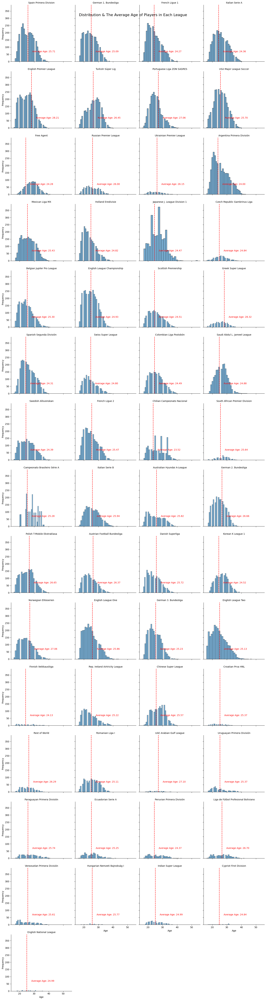

In [71]:
# Calculate the average age for each league
league_mean_age = Trial_df.groupby('league_name')['age'].mean().reset_index()
# Create a histogram with facetting by league
g = sns.FacetGrid(Trial_df, col='league_name', col_wrap=4, height=4)
g.map(sns.histplot, 'age', bins=30, alpha=0.6)
g.set_axis_labels("Age", "Frequency")
# Add vertical lines and average age labels
for ax, league_row in zip(g.axes, league_mean_age.iterrows()):
    league, mean_age = league_row[1]
    ax.axvline(mean_age, color='red', linestyle='--', linewidth=1.5)
    ax.text(mean_age + 3, 65, f'Average Age: {mean_age:.2f}', color='red')

g.set_titles("{col_name}")
g.fig.suptitle("Distribution & The Average Age of Players in Each League", fontsize=16)
g.fig.subplots_adjust(top=0.85)
plt.subplots_adjust(hspace=0.4)
plt.tight_layout()
plt.show()

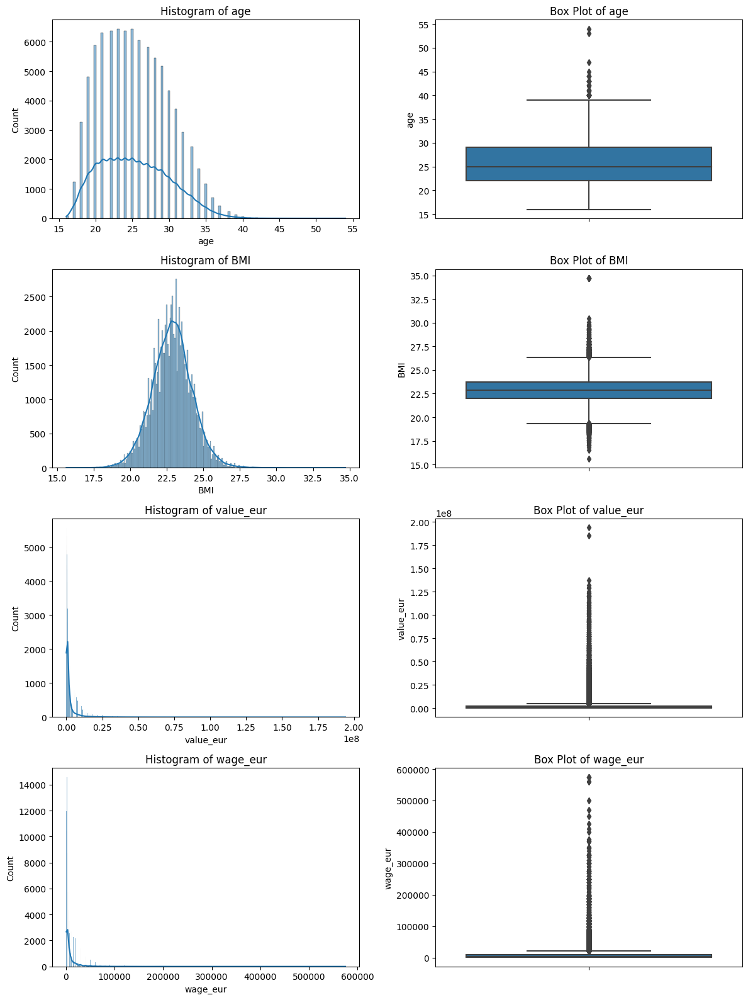

In [72]:
numerical_col = ['age', 'BMI', 'value_eur', 'wage_eur']
fig, axes = plt.subplots(nrows=len(numerical_col), ncols=2, figsize=(12, 16))
fig.subplots_adjust(hspace=0.5)

# distribution of player demographics features
for i, col in enumerate(numerical_col):
    sns.histplot(data=Trial_df, x=col, ax=axes[i, 0], kde=True)
    axes[i, 0].set_title(f'Histogram of {col}')
    sns.boxplot(data=Trial_df, y=col, ax=axes[i, 1])
    axes[i, 1].set_title(f'Box Plot of {col}')

plt.tight_layout()
plt.show()



> Distribution of players allover World leagues


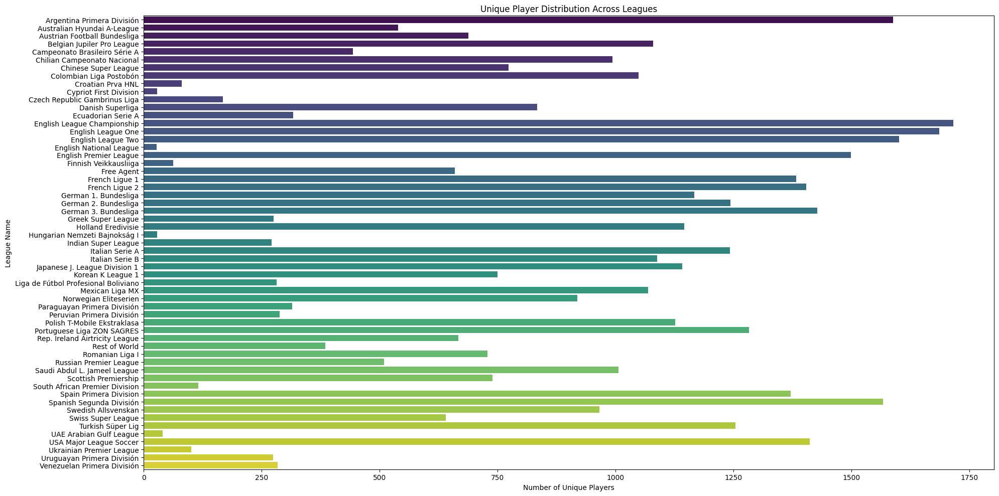

In [73]:
# Count the number of unique players in each league
unique_players_by_league = Trial_df.groupby('league_name')['long_name'].nunique().reset_index()
# Sort the data by league name
unique_players_by_league = unique_players_by_league.sort_values(by='league_name')
plt.figure(figsize=(20, 10))
sns.barplot(x='long_name', y='league_name', data=unique_players_by_league, palette='viridis')
plt.xlabel('Number of Unique Players')
plt.ylabel('League Name')
plt.title('Unique Player Distribution Across Leagues')
plt.xticks(rotation=0)
plt.tight_layout()
plt.show()
#A01

Player Potential and Age a

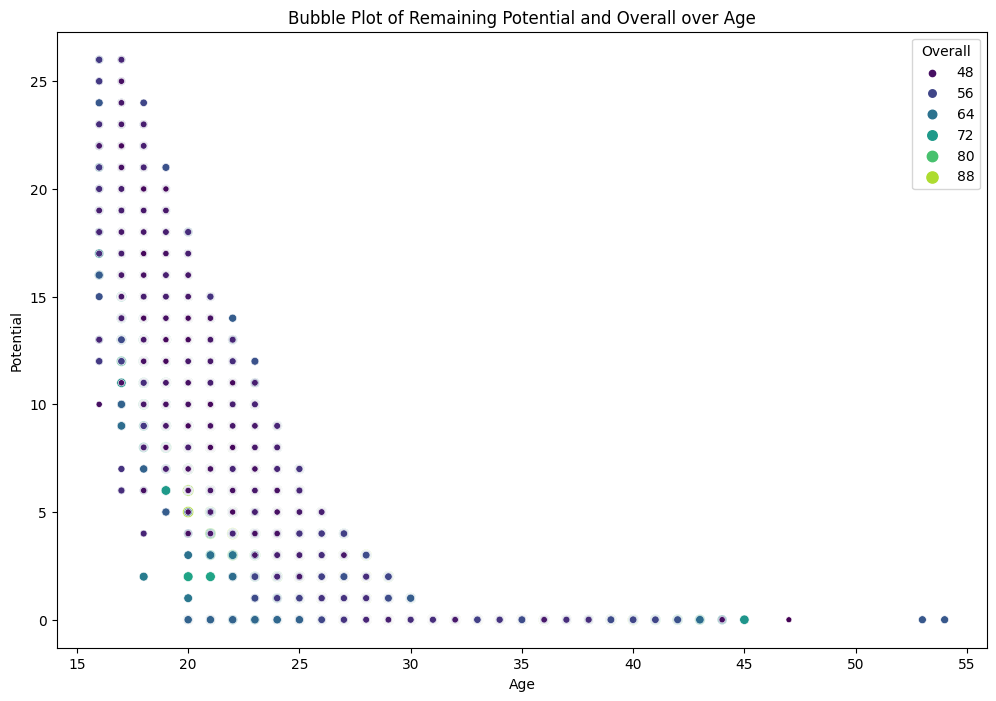

In [74]:
plt.figure(figsize=(12, 8))
sns.scatterplot(data=Trial_df, x='age', y='Future_pot', size='overall', hue='overall', palette='viridis')
plt.xlabel('Age')
plt.ylabel('Potential')
plt.title('Bubble Plot of Remaining Potential and Overall over Age')
plt.legend(title='Overall')
plt.show()
#A02

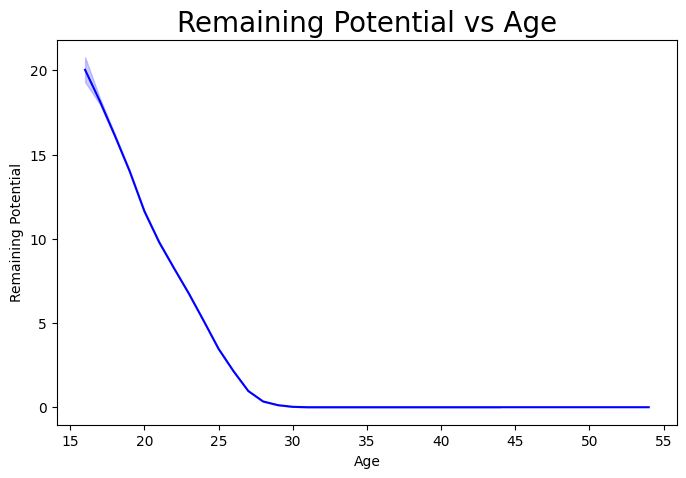

In [75]:
plt.figure(figsize=(8, 5))
sns.lineplot(x=Trial_df['age'], y=Trial_df['Future_pot'], color='blue')
plt.title('Remaining Potential vs Age', fontsize=20)
plt.xlabel('Age')
plt.ylabel('Remaining Potential')
plt.show()
#A03

Age,Potential and Overall Relation

In [76]:
fig = px.scatter_3d(Trial_df, x='age', y='potential', z='overall', color='overall',
                    title='Age vs Potential vs Overall')
fig.show()



> Remaining potential and affectness by Age



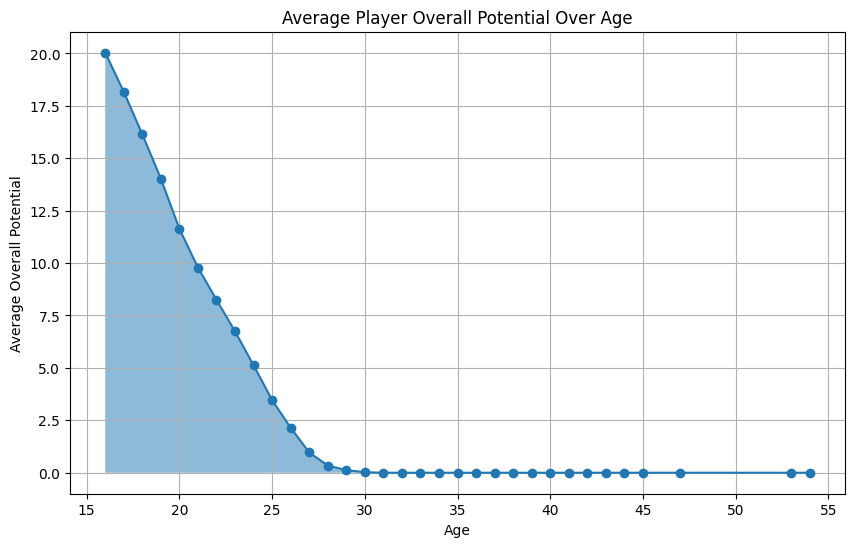

In [77]:
average_potential_by_age = Trial_df.groupby('age')['Future_pot'].mean()
plt.figure(figsize=(10, 6))
plt.plot(average_potential_by_age.index, average_potential_by_age.values, marker='o', linestyle='-')
plt.fill_between(average_potential_by_age.index, average_potential_by_age.values, alpha=0.5)
plt.title('Average Player Overall Potential Over Age')
plt.xlabel('Age')
plt.ylabel('Average Overall Potential')
plt.grid(True)
plt.show()
# A04

> **Player potential relation with Age and Position**
- All Possible Positions


In [78]:
average_potential_by_position = Trial_df.groupby(['player_positions', 'age'])['Future_pot'].mean().unstack()
fig = go.Figure(data=go.Heatmap(
    z=average_potential_by_position.values,
    x=average_potential_by_position.columns.values,
    y=average_potential_by_position.index.values,
    colorscale='Viridis',  # Choose a suitable color scale
))
fig.update_layout(
    title='Average Player Potential by Position and Age',
    xaxis_title='Age',
    yaxis_title='Player Positions',
)
fig.show()

# A05

- Best Predicted Position

In [79]:
AvgPot_age = Trial_df.groupby(['potential', 'Best_position'])['Future_pot'].mean().unstack()
fig = go.Figure(data=go.Heatmap(
                   z=AvgPot_age.values,
                   x=AvgPot_age.columns.values,
                   y=AvgPot_age.index.values,
                   colorscale='YlGnBu'))
fig.update_layout(
    title='Average Player Potential by Age and Position',
    xaxis_nticks=36)
fig.show()
# A05

> Player remaining potential and it's relation with Player form

/opt/conda/lib/python3.10/site-packages/seaborn/axisgrid.py:118: UserWarning:

The figure layout has changed to tight



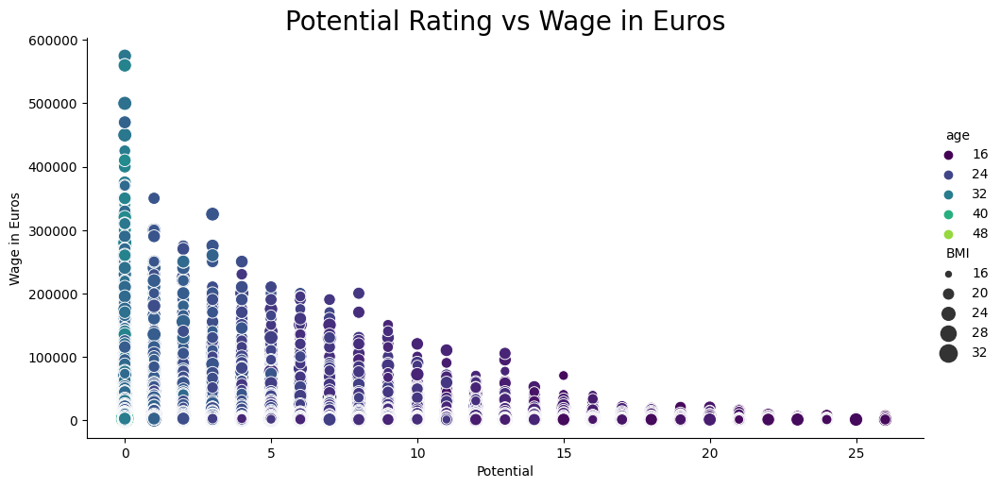

In [80]:
sns.relplot(x='Future_pot',y='wage_eur',hue='age',palette = 'viridis',size="BMI", sizes=(15, 200),aspect=2,data=Trial_df)
plt.title('Potential Rating vs Wage in Euros',fontsize = 20)
plt.xlabel('Potential')
plt.ylabel('Wage in Euros')
plt.show()
# A06

> BMI and Body Stealth rating

In [81]:
fig = px.scatter(Trial_df, x='BMI', y='Speed', color='BMI', title='BMI vs Speed', color_continuous_scale='Viridis', trendline='lowess')
fig.update_xaxes(title='BMI')
fig.update_yaxes(title='Speed')
fig.show()
# A07

Players Values and Rating Relation

/opt/conda/lib/python3.10/site-packages/seaborn/axisgrid.py:118: UserWarning:

The figure layout has changed to tight



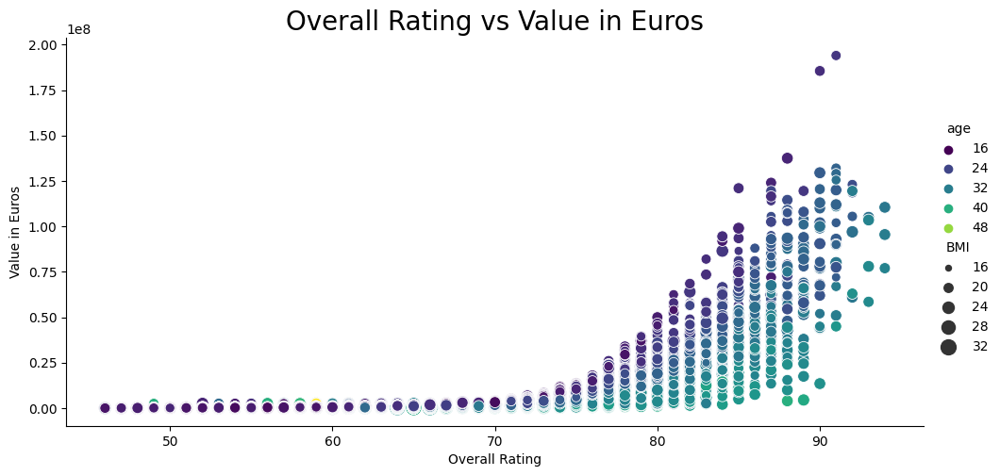

In [82]:
sns.relplot(x='overall',y='value_eur',hue='age',palette = 'viridis',size="BMI", sizes=(16, 150),aspect=2,data=Trial_df)
plt.title('Overall Rating vs Value in Euros',fontsize = 20)
plt.xlabel('Overall Rating')
plt.ylabel('Value in Euros')
plt.show()
# A09

/tmp/ipykernel_32/1657349905.py:44: UserWarning:

Glyph 38518 (\N{CJK UNIFIED IDEOGRAPH-9676}) missing from current font.

/tmp/ipykernel_32/1657349905.py:44: UserWarning:

Glyph 24378 (\N{CJK UNIFIED IDEOGRAPH-5F3A}) missing from current font.

/tmp/ipykernel_32/1657349905.py:44: UserWarning:

Glyph 40857 (\N{CJK UNIFIED IDEOGRAPH-9F99}) missing from current font.

/opt/conda/lib/python3.10/site-packages/IPython/core/pylabtools.py:152: UserWarning:

Glyph 38518 (\N{CJK UNIFIED IDEOGRAPH-9676}) missing from current font.

/opt/conda/lib/python3.10/site-packages/IPython/core/pylabtools.py:152: UserWarning:

Glyph 24378 (\N{CJK UNIFIED IDEOGRAPH-5F3A}) missing from current font.

/opt/conda/lib/python3.10/site-packages/IPython/core/pylabtools.py:152: UserWarning:

Glyph 40857 (\N{CJK UNIFIED IDEOGRAPH-9F99}) missing from current font.



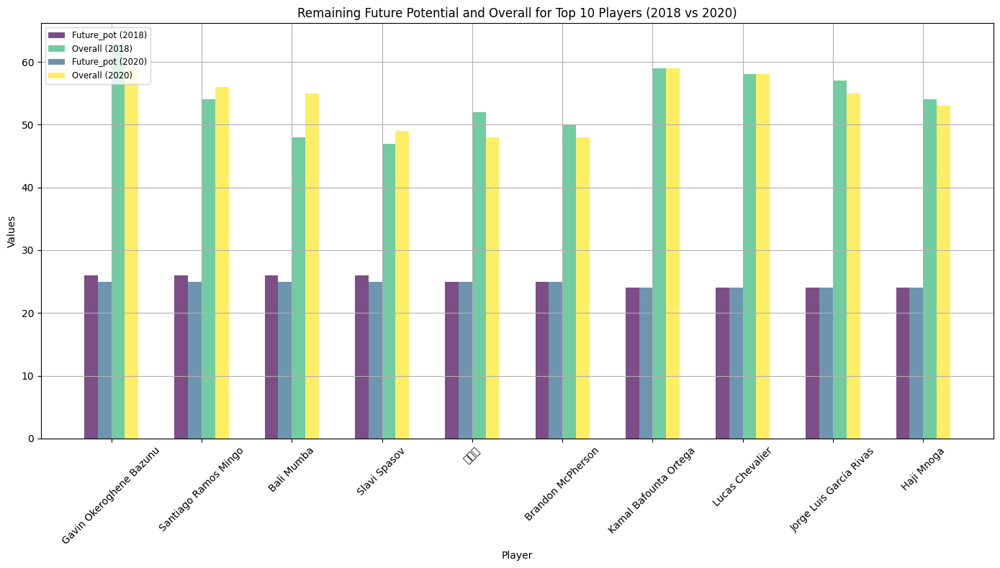

In [83]:
bar_width = 0.15
years = [2018,2020]
future_pot_values = []
overall_values = []
# lists to store Future_pot and Overall values for each year
for year in years:
    # Filter the players for the current year and select the top 10 by Future_pot
    filtered_players = Trial_df[Trial_df['Year'] == year].nlargest(10, 'Future_pot')
    future_pot_values.append(filtered_players['Future_pot'])
    overall_values.append(filtered_players['overall'])
players = filtered_players['long_name']


#  x-axis index
index = np.arange(len(players))
plt.figure(figsize=(14, 8))
color_map = plt.get_cmap('viridis')
colors = color_map(np.linspace(0, 1, len(years) * 2))
# Remaining Potential and Overall values for the top 10 players for every year
for i in range(len(years)):
    plt.bar(
        index + i * bar_width,
        future_pot_values[i],
        bar_width,
        label=f'Future_pot ({years[i]})',
        alpha=0.7,
        color=colors[i]
    )
    plt.bar(
        index + (i + len(years)) * bar_width,
        overall_values[i],
        bar_width,
        label=f'Overall ({years[i]})',
        alpha=0.7,
        color=colors[i + len(years)]
    )

plt.xlabel('Player')
plt.ylabel('Values')
plt.title('Remaining Future Potential and Overall for Top 10 Players (2018 vs 2020)')
plt.xticks(index + 1.5 * bar_width, players, rotation=45)
plt.legend(fontsize='small', loc='upper left')
plt.grid()
plt.tight_layout()
plt.show()

In [84]:
# filtered_players = Trial_df[(Trial_df['Year'] == 2018)]
# top_10_players = filtered_players.nlargest(10, 'Futre_pot')
# plt.figure(figsize=(12, 6))
# sns.lineplot(x='Year', y='overall', hue='long_name', data=Trial_df)
# plt.xlabel('Year')
# plt.ylabel('Overall Rating')
# plt.title('Overall Rating Over the Years for Top 10 Players with Highest Future Potential (2018)')
# plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
# plt.grid(True)
# plt.show()

`Some features oriented analysis`

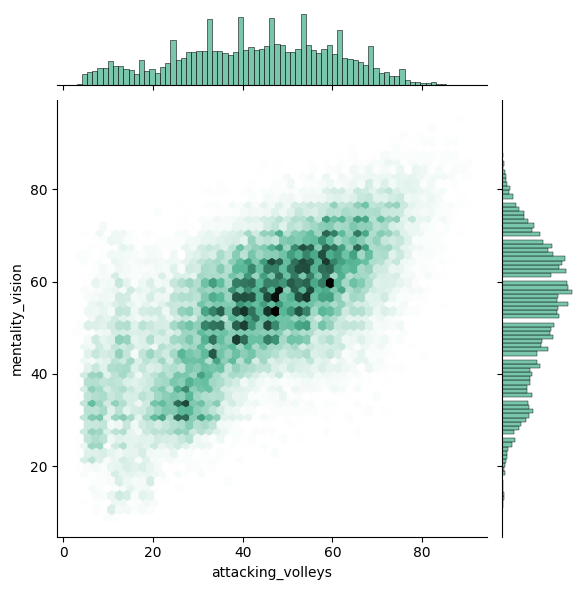

In [85]:
sns.jointplot(x=Trial_df['attacking_volleys'], y=Trial_df['mentality_vision'], kind="hex", color="#4CB391")

/tmp/ipykernel_32/3371028779.py:2: MatplotlibDeprecationWarning:

The seaborn styles shipped by Matplotlib are deprecated since 3.6, as they no longer correspond to the styles shipped by seaborn. However, they will remain available as 'seaborn-v0_8-<style>'. Alternatively, directly use the seaborn API instead.



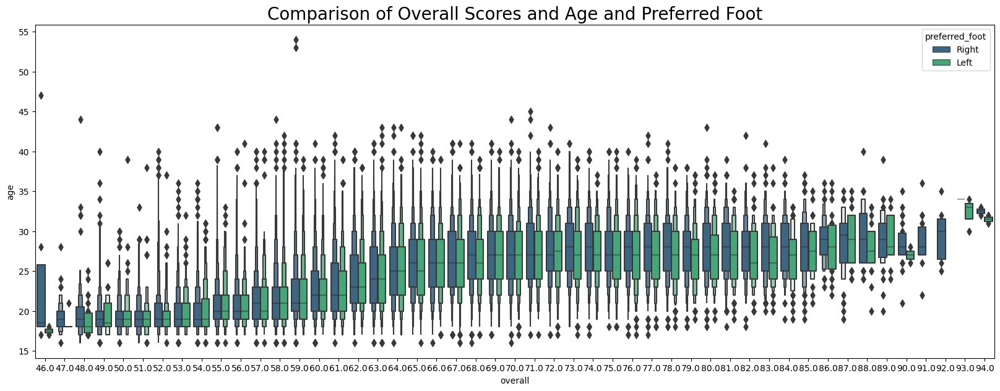

In [86]:
plt.rcParams['figure.figsize'] = (20, 7)
plt.style.use('seaborn-dark-palette')
sns.boxenplot(data=Trial_df, x='overall', y='age', hue='preferred_foot', palette='viridis')
plt.title('Comparison of Overall Scores and Age and Preferred Foot', fontsize=20)
plt.show()
# A10

In [87]:
filtered_data = Trial_df[(Trial_df['Year'] == 2022) & (Trial_df['overall'])]
rating = pd.DataFrame(filtered_data.groupby(['playing_country'])['overall'].mean().reset_index())
count = pd.DataFrame(rating.groupby('playing_country')['overall'].sum().reset_index())
fig = px.choropleth(count,
                    locations='playing_country',
                    locationmode='country names',
                    color='overall',
                    color_continuous_scale='viridis',
                    title='League Country vs High Average Overall in 2022 Season'
                   )
fig.show()
# A11

In [88]:
filtered_data = Trial_df[(Trial_df['Year'] == 2022) & (Trial_df['Future_pot'] > 15)]
rating = pd.DataFrame(filtered_data.groupby(['playing_country'])['Future_pot'].sum().reset_index())
count = pd.DataFrame(rating.groupby('playing_country')['Future_pot'].sum().reset_index())
fig = px.choropleth(count,
                    locations='playing_country',
                    locationmode='country names',
                    color='Future_pot',
                    color_continuous_scale='viridis',
                    title='League Country vs High Potential players in 2022 Season'
                   )
fig.show()
# A12

In [89]:
filtered_data = Trial_df[(Trial_df['Year'] == 2022) & (Trial_df['Future_pot'] >= 15) & (Trial_df['overall'] >= 65)]
mean_value = pd.DataFrame(filtered_data.groupby(['playing_country'])['value_eur'].mean().reset_index())

# Create a choropleth map
fig = px.choropleth(
    mean_value,
    locations='playing_country',
    locationmode='country names',
    color='value_eur',
    color_continuous_scale='viridis',
    title='Average Value of Players with High Potential in 2022 Season by Country'
)
fig.show()
# A13

In [90]:
filtered_data = Trial_df[(Trial_df['Future_pot'] > 15) & (Trial_df['overall'] > 65)]
mean_value = filtered_data.groupby(['playing_country'])['value_eur'].mean().reset_index()
mean_value['value_eur'] = mean_value['value_eur'] / 1e6
mean_value['value_eur'] = mean_value['value_eur'].round(2)
mean_value['value_eur'] = mean_value['value_eur'].apply(lambda x: f'{x:.1f}M')
sorted_countries = mean_value.sort_values(by='value_eur', ascending=False)
sorted_countries
# A13

,playing_country,value_eur
23,Uruguay,4.8M
17,Scotland,4.0M
1,Austria,3.4M
0,Argentina,3.3M
3,Colombia,3.2M
4,Croatia,3.0M
16,Russia,3.0M
5,Czech Republic,3.0M
18,Spain,2.6M
2,Belgium,2.5M


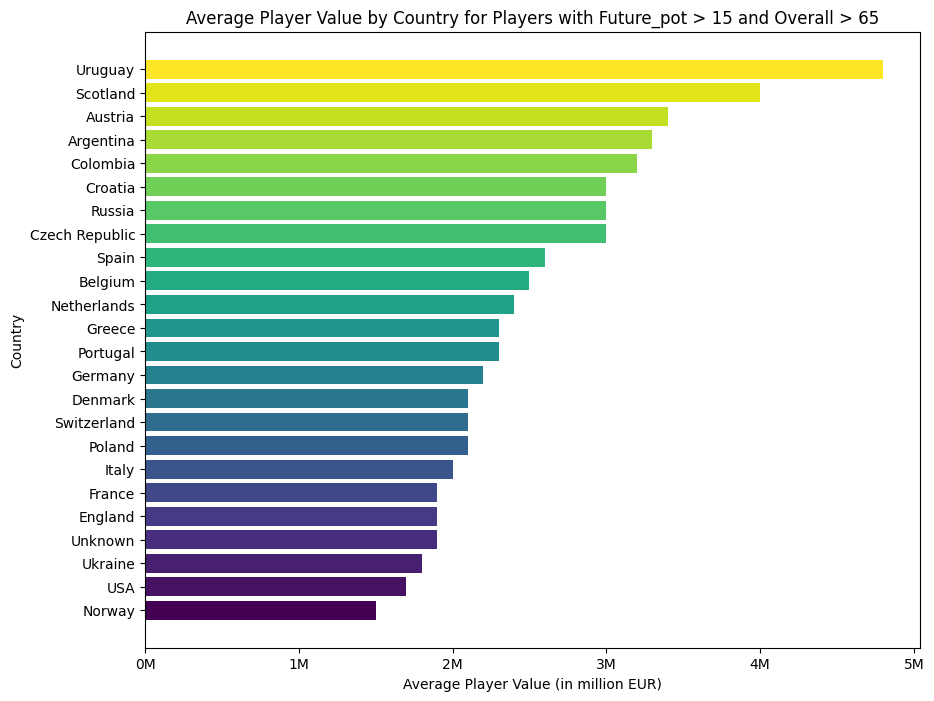

In [91]:
filtered_data = Trial_df[(Trial_df['Future_pot'] > 15) & (Trial_df['overall'] > 65)]
mean_value = filtered_data.groupby(['playing_country'])['value_eur'].mean().reset_index()
mean_value['value_eur'] = mean_value['value_eur'] / 1e6
mean_value['value_eur'] = mean_value['value_eur'].round(2)
mean_value['value_eur'] = mean_value['value_eur'].apply(lambda x: f'{x:.1f}M')
sorted_countries = mean_value.sort_values(by='value_eur', ascending=False)
sorted_countries
sorted_countries = sorted_countries.sort_values(by='value_eur', ascending=True)

plt.figure(figsize=(10, 8))
plt.barh(sorted_countries['playing_country'], sorted_countries['value_eur'].str.replace('M', '').astype(float), color=plt.cm.viridis(np.linspace(0, 1, len(sorted_countries))))
plt.xlabel('Average Player Value (in million EUR)')
plt.ylabel('Country')
plt.title('Average Player Value by Country for Players with Future_pot > 15 and Overall > 65')
# Format y-axis to display in M
fmt = '{x:,.0f}M'
tick = mtick.StrMethodFormatter(fmt)
plt.gca().xaxis.set_major_formatter(tick)
plt.show()
# A13

----------------------------------------

> **Players Oriented Comparisons**

In [92]:
# Creating a method to compare a Player's growth over Time
def player_growth(player_name):
    years = [2018, 2019, 2020, 2021, 2022]  # List of years
    traces = []

    for year in years:
        data_for_year = Trial_df[Trial_df['Year'] == year]
        player_data = data_for_year[data_for_year['long_name'].str.startswith(player_name)]
        if not player_data.empty:
            trace = go.Scatterpolar(
                r=[player_data['Speed'].values[0], player_data['shooting'].values[0], player_data['passing'].values[0],
                   player_data['Dribble'].values[0], player_data['defending'].values[0],
                   player_data['physic'].values[0], player_data["overall"].values[0]],
                theta=['Speed', 'Shooting', 'Passing', 'Dribbling', 'Defending', 'Physic', 'Overall'],
                fill='toself',
                name=str(year)
            )
            traces.append(trace)
    data = traces
    layout = go.Layout(
        polar=dict(
            radialaxis=dict(
                visible=True,
                range=[0, 100]
            )
        ),
        template="plotly_white",
        showlegend=True,
        font=dict(family='Cambria, monospace', size=12, color='#000000'),
        title="Stats: {} from 2018 to 2022".format(player_name)
    )
    fig = go.Figure(data=data, layout=layout)
    plotly.offline.iplot(fig, filename="Player stats")
player_growth("Boulaye Dia")
# A14

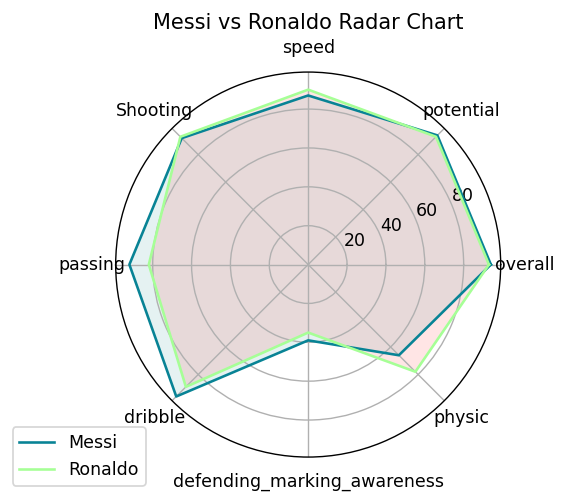

In [93]:
def RadarChart(player1, values1, player2, values2):
    Attributes = ["overall", "potential", "speed", "Shooting", "passing", "dribble", "defending_marking_awareness", "physic"]

    values1 += values1[:1]
    values2 += values2[:1]
    angles = np.linspace(0, 2 * np.pi, len(Attributes), endpoint=False).tolist()
    angles += angles[:1]

    fig = plt.figure(figsize=(4, 4), dpi=125)
    ax = fig.add_subplot(111, polar=True)
    plt.xticks(angles[:-1], Attributes)
    ax.plot(angles, values1, label=player1, color="#088395")
    ax.fill(angles, values1, 'teal', alpha=0.1)
    ax.plot(angles, values2, label=player2, color="#A6FF96")
    ax.fill(angles, values2, 'red', alpha=0.1)
    plt.legend(loc='upper right', bbox_to_anchor=(0.1, 0.1))
    plt.title(f'{player1} vs {player2} Radar Chart')

    plt.show()


RadarChart("Messi", [94.0, 94.0, 87.0, 92.0, 92.0, 96.0, 39.0, 66.0], "Ronaldo", [93.0, 93.0, 90.0, 93.0, 82.0, 89.0, 35.0, 78.0])
# A15

In [94]:
Trial_df["value_eur"]

0         95500000.0
1        105000000.0
2         61000000.0
3         97000000.0
4        123000000.0
            ...     
87492            NaN
87506            NaN
87526            NaN
87532            NaN
87540            NaN
Name: value_eur, Length: 92482, dtype: float64

In [95]:
imputer = KNNImputer(n_neighbors=5)
Trial_2 = Trial_df.copy()
Trial_2['value_eur'] = imputer.fit_transform(Trial_2['value_eur'].values.reshape(-1, 1))

In [96]:
top_players = Trial_df[Trial_df['Year'] == 2019].nlargest(25, 'Future_pot')
def top_players_growth():
    years = [2018, 2019, 2020, 2021, 2022]
    #  top players from 2020
    for _, player in top_players.iterrows():
        player_name = player['long_name']
        traces = []
        for year in years:
            data_for_year = Trial_df[(Trial_df['Year'] == year) & (Trial_df['long_name'] == player_name)]
            if not data_for_year.empty:
                player_data = data_for_year.iloc[0]
                trace = go.Scatterpolar(
                    r=[player_data['Speed'], player_data['shooting'], player_data['passing'],
                       player_data['Dribble'], player_data['defending'],
                       player_data['physic'], player_data["overall"]],
                    theta=['Pace', 'Shooting', 'Passing', 'Dribbling', 'Defending', 'Physic', 'Overall'],
                    fill='toself',
                    name=str(year)  # legend
                )
                traces.append(trace)
        data_for_2022 = Trial_df[(Trial_df['Year'] == 2022) & (Trial_df['long_name'] == player_name)]
        if not data_for_2022.empty:
            player_age = data_for_2022.iloc[0]['age']
            player_league = data_for_2022.iloc[0]['league_name']
            player_positions = data_for_2022.iloc[0]['player_positions']

            data_for_2019 = Trial_df[(Trial_df['Year'] == 2019) & (Trial_df['long_name'] == player_name)]
            if not data_for_2019.empty:
                value_eur_2019 = data_for_2019.iloc[0]['value_eur']
                value_eur_2022 = data_for_2022.iloc[0]['value_eur']
                # Add value_eur for 2019 and 2022 as text
                value_text = "Value € in 2019: {}<br>Value € in 2022: {}".format(value_eur_2019, value_eur_2022)
                layout = go.Layout(
                    polar=dict(
                        radialaxis=dict(
                            visible=True,
                            range=[0, 100]
                        )
                    ),
                    template="plotly_white",
                    showlegend=True,
                    font=dict(family='Cambria, monospace', size=12, color='#000000'),
                    title="{}'s Stats from 2018 to 2022<br>Age in 2022: {}<br>League: {}<br>Positions: {}<br>{}".format(player_name, player_age, player_league, player_positions, value_text)
                )
            else:
                # No data for 2019, create layout without value_eur text
                layout = go.Layout(
                    polar=dict(
                        radialaxis=dict(
                            visible=True,
                            range=[0, 100]
                        )
                    ),
                    template="plotly_white",
                    showlegend=True,
                    font=dict(family='Cambria, monospace', size=12, color='#000000'),
                    title="{}'s Stats from 2018 to 2022<br>Age in 2022: {}<br>League: {}<br>Positions: {}".format(player_name, player_age, player_league, player_positions)
                )
        else:
            # No data for 2022, create layout without value_eur text
            layout = go.Layout(
                polar=dict(
                    radialaxis=dict(
                        visible=True,
                        range=[0, 100]
                    )
                ),
                template="plotly_white",
                showlegend=True,
                font=dict(family='Cambria, monospace', size=12, color='#000000'),
                title="{}'s Stats from 2018 to 2022".format(player_name)
            )

        fig = go.Figure(data=traces, layout=layout)
        plotly.offline.iplot(fig, filename="{}'s stats".format(player_name))
top_players_growth()
# A16

/tmp/ipykernel_32/4214191867.py:4: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



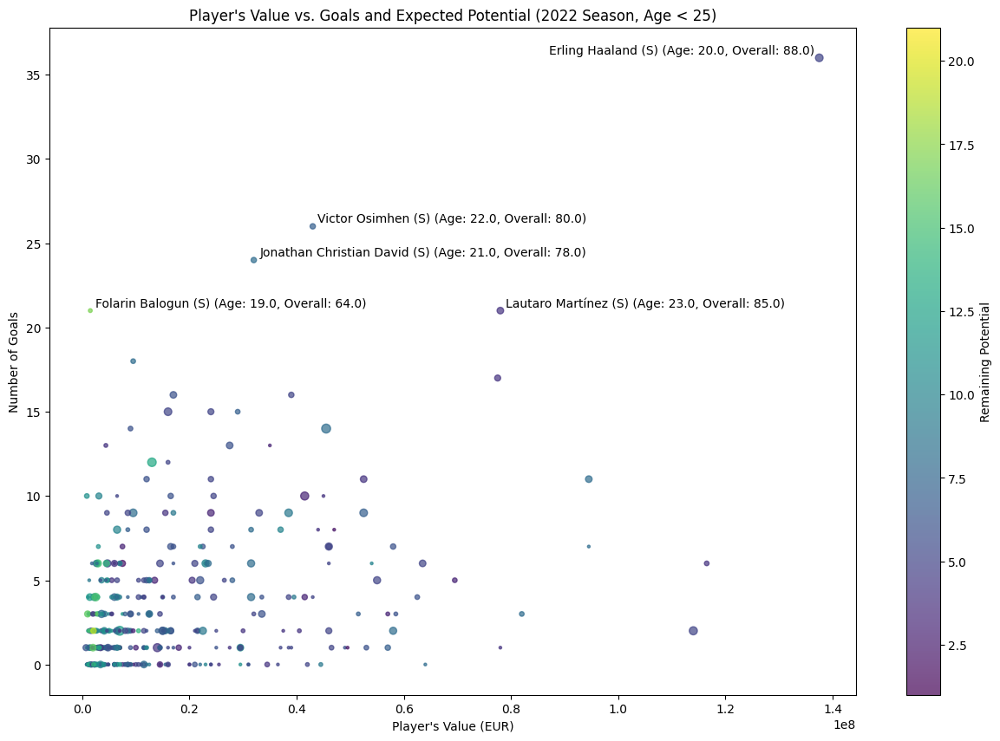

In [97]:
from adjustText import adjust_text
# players younger than 25
filtered_df = player_char[(player_char['Year'] == 2022) & (player_char['age'] < 25)]
filtered_df['goals'] = filtered_df['goals'].astype(int)
value_eur = filtered_df['value_eur'].astype(float)
goals = filtered_df['goals']
assists = filtered_df['assists'].astype(int)
Future_potential = filtered_df['Future_pot'].astype(int)
player_names = filtered_df['player_name']
player_positions = filtered_df['player_positions']
plt.figure(figsize=(15, 10))
scatter = plt.scatter(value_eur, goals, c=Future_potential, s=assists*5, cmap='viridis', alpha=0.7)
plt.title("Player's Value vs. Goals and Expected Potential (2022 Season, Age < 25)")
plt.xlabel("Player's Value (EUR)")
plt.ylabel("Number of Goals")


colorbar = plt.colorbar(scatter)
colorbar.set_label("Remaining Potential")
texts = []

for i, row in filtered_df.iterrows():
    if row['goals'] > 20:
        label = f"{row['player_name']} ({row['player_positions'][0]}) (Age: {row['age']}, Overall: {row['overall']})"
        text = plt.text(row['value_eur'], row['goals'], label, ha='left', va='bottom', rotation=0)
        texts.append(text)

adjust_text(texts, expand_text=(0.8, 0.8))
plt.show()
# A17

In [98]:
#  convert to numeric
numeric_columns = [
    'games', 'time', 'goals', 'xG', 'assists', 'xA', 'shots', 'key_passes', 'npg', 'npxG',
    'xGChain', 'xGBuildup', 'overall', 'Future_pot', 'potential', 'value_eur', 'wage_eur',
    'BMI', 'Dribble', 'Speed', 'age', 'attacking_crossing', 'attacking_heading_accuracy',
    'attacking_short_passing', 'attacking_volleys', 'skill_curve', 'skill_fk_accuracy',
    'mentality_positioning', 'mentality_vision', 'mentality_penalties'
]
player_char[numeric_columns] = player_char[numeric_columns].apply(pd.to_numeric, errors='coerce')

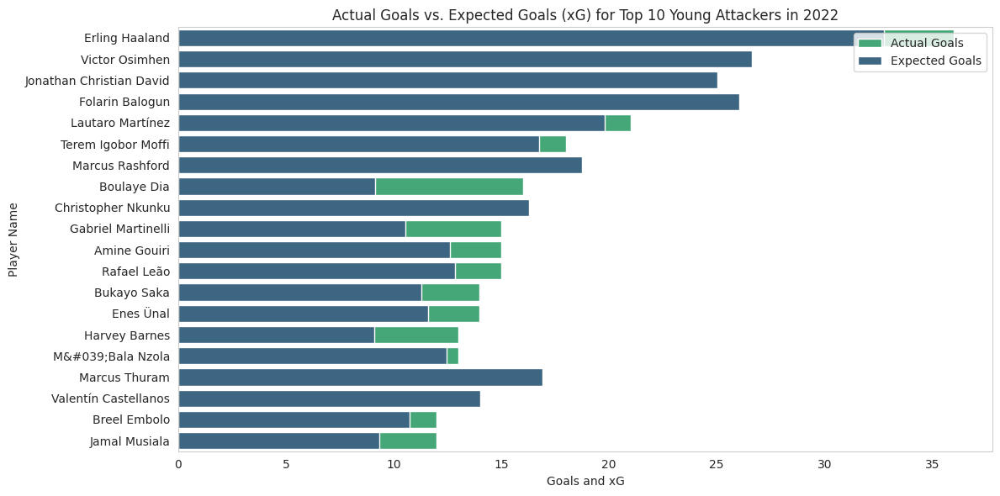

In [99]:
young_strikers_2022 = player_char[(player_char['age'] < 25) & (player_char['Year'] == 2022)]
top_10_strikers_2022 = young_strikers_2022.nlargest(20, 'goals')
plt.figure(figsize=(12, 6))
sns.set_style("whitegrid")
colors = sns.color_palette("viridis", n_colors=2)
sns.barplot(data=top_10_strikers_2022, x='goals', y='player_name', color=colors[1], label='Actual Goals')
sns.barplot(data=top_10_strikers_2022, x='xG', y='player_name', color=colors[0], label='Expected Goals')
plt.xlabel('Goals and xG')
plt.ylabel('Player Name')
plt.title('Actual Goals vs. Expected Goals (xG) for Top 10 Young Attackers in 2022')
plt.legend(loc='upper right')
plt.grid(axis='x')
plt.tight_layout()
plt.show()
#A18

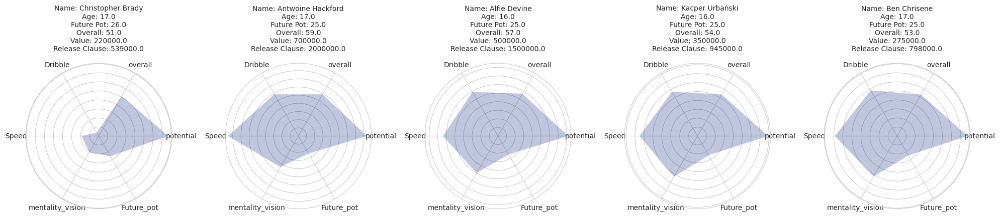

In [100]:
Trial_df['Future_pot'] = pd.to_numeric(Trial_df['Future_pot'], errors='coerce')
Trial_df['potential'] = pd.to_numeric(Trial_df['potential'], errors='coerce')
young_players_2022 = Trial_df[(Trial_df['age'] < 25) & (Trial_df['Year'] == 2022)]
top_players_2022 = young_players_2022.nlargest(5, 'Future_pot')


attributes = ['potential', 'overall', 'Dribble', 'Speed', 'mentality_vision', 'Future_pot']

fig, axes = plt.subplots(1, len(top_players_2022), figsize=(20, 8), subplot_kw=dict(polar=True))
for i, (_, player) in enumerate(top_players_2022.iterrows()):
    player_name = player['long_name']
    player_age = player['age']
    player_future_pot = player['Future_pot']
    player_overall = player['overall']
    player_value = player['value_eur']
    player_release_clause = player['release_clause_eur']
    #---------------------
    ax = axes[i]
    num_vars = len(attributes)
    # Split the circle into even parts and save the angles so we know where to put each axis.
    angles = np.linspace(0, 2 * np.pi, num_vars, endpoint=False).tolist()
    # The plot is a circle, so we need to "complete the loop" and append the start value to the end.
    player_values = [player[attr] for attr in attributes]
    player_values += player_values[:1]
    angles += angles[:1]
    ax.fill(angles, player_values, alpha=0.25)
    ax.set_yticklabels([])
    ax.set_thetagrids(np.degrees(angles[:-1]), attributes)
    #---------------------
    # Add player information as text titles or descriptions
    info_text = f'Name: {player_name}\nAge: {player_age}\nFuture Pot: {player_future_pot}\nOverall: {player_overall}\nValue: {player_value}\nRelease Clause: {player_release_clause}\n'
    ax.set_title(info_text, fontsize=10)
plt.tight_layout()
plt.show()

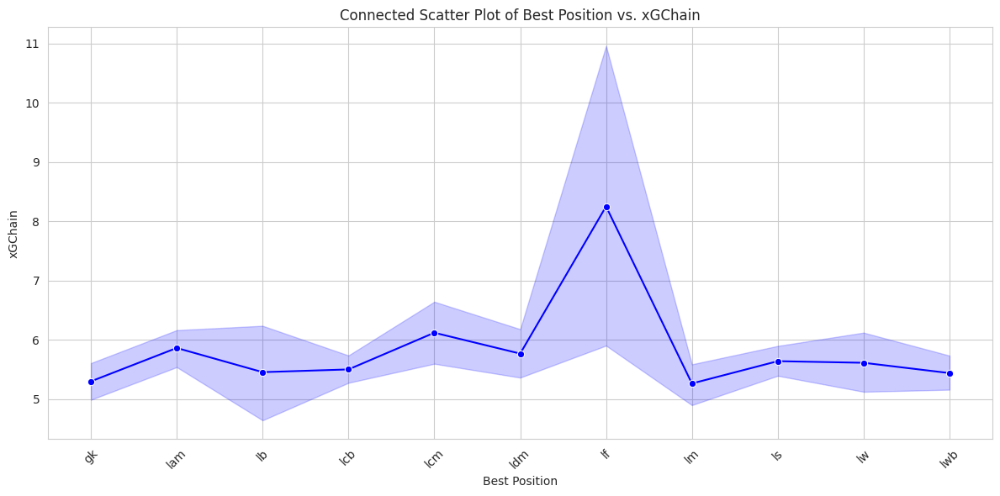

In [101]:
player_char_sorted = player_char.sort_values(by='Best_position')
plt.figure(figsize=(12, 6))
sns.lineplot(data=player_char_sorted, x='Best_position', y='xGChain', marker='o', sort=False, color='b')
plt.xlabel('Best Position')
plt.ylabel('xGChain')
plt.title('Connected Scatter Plot of Best Position vs. xGChain')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

<Figure size 1200x600 with 0 Axes>

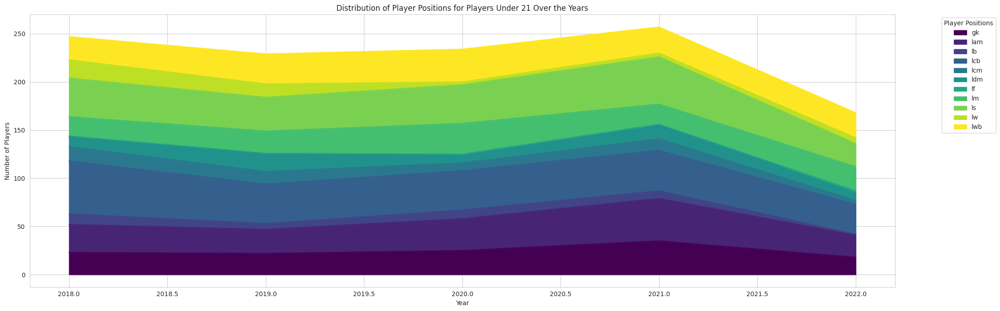

In [102]:
# Filter the dataset for players under 21
young_players = player_char[player_char['age'] < 21]

# Group the data by 'Year' and 'player_positions' and count the number of players in each combination
position_counts = young_players.groupby(['Year', 'Best_position']).size().unstack(fill_value=0)

# Create a stacked area chart
plt.figure(figsize=(12, 6))
position_counts.plot(kind='area', stacked=True, colormap='viridis')


plt.xlabel('Year')
plt.ylabel('Number of Players')
plt.title('Distribution of Player Positions for Players Under 21 Over the Years')
plt.tight_layout()
plt.legend(title='Player Positions', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.show()

In [103]:
def calculate_position_score(row):
    position_scores = {}
    for position in df_position.columns:
        position_features = df_position[position]
        score = 0
        for feature in position_features:
            score += row[feature]
        position_scores[position] = score
    best_position = max(position_scores, key=position_scores.get)
    return best_position, position_scores
row = Main_df.iloc[0]
best_position, position_scores = calculate_position_score(row)
print("The best position for this player is",best_position,"score =",position_scores[best_position])

The best position for this player is ST score = 897.0


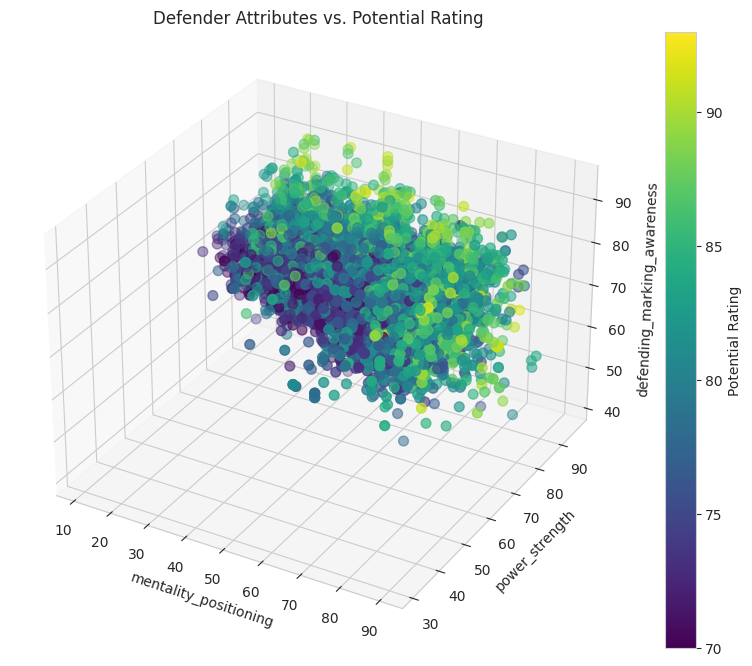

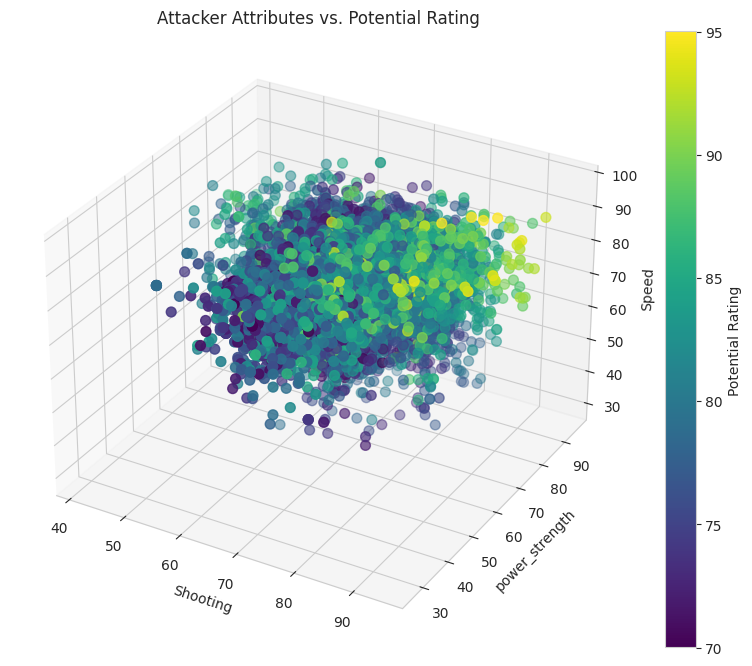

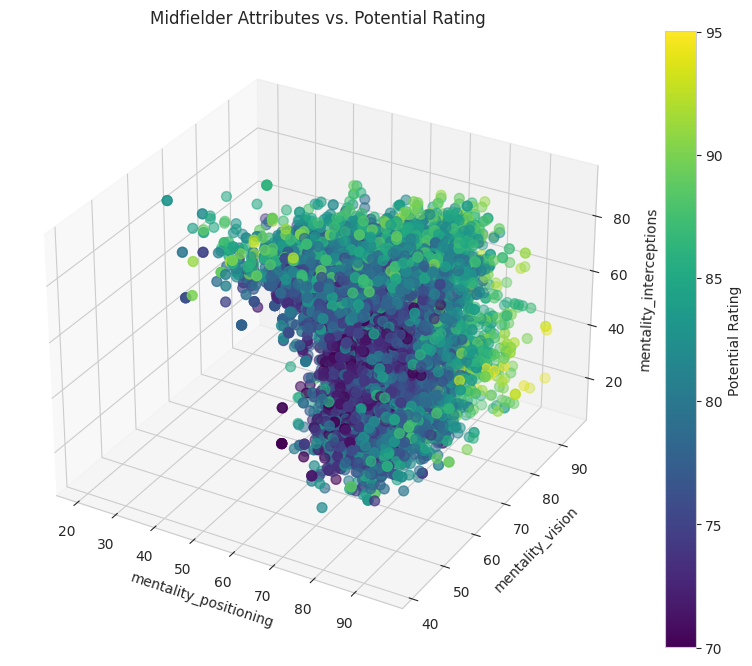

In [104]:
GK = ['gk']
Defend = ['lb', 'lcb', 'cb', 'rcb', 'rb']
Attack = ['lw', 'cf', 'rw', 'lf', 'rf', 'st']
Mid = ['lam', 'cam', 'ram', 'lm', 'lcm', 'cm', 'rcm', 'rm']
defending_attributes = ['mentality_positioning', 'power_strength', 'defending_marking_awareness']
attacking_attributes = ['Shooting', 'power_strength', 'Speed']
midfield_attributes = ['mentality_positioning', 'mentality_vision', 'mentality_interceptions']


def create_3d_scatter(positions, attributes, title):
    fig = plt.figure(figsize=(10, 8))
    ax = fig.add_subplot(111, projection='3d')
    condition = Trial_df[positions].ge(70).sum(axis=1) >= 3
    sc = ax.scatter(Trial_df.loc[condition, attributes[0]], Trial_df.loc[condition, attributes[1]], Trial_df.loc[condition, attributes[2]],
                    c=Trial_df.loc[condition, 'potential'], cmap='viridis', s=50)
    ax.set_xlabel(attributes[0])
    ax.set_ylabel(attributes[1])
    ax.set_zlabel(attributes[2])
    ax.set_title(title)
    cbar = fig.colorbar(sc)
    cbar.set_label('Potential Rating')

create_3d_scatter(Defend, defending_attributes, 'Defender Attributes vs. Potential Rating')
create_3d_scatter(Attack, attacking_attributes, 'Attacker Attributes vs. Potential Rating')
create_3d_scatter(Mid, midfield_attributes, 'Midfielder Attributes vs. Potential Rating')
plt.show()

/opt/conda/lib/python3.10/site-packages/seaborn/axisgrid.py:118: UserWarning:

The figure layout has changed to tight



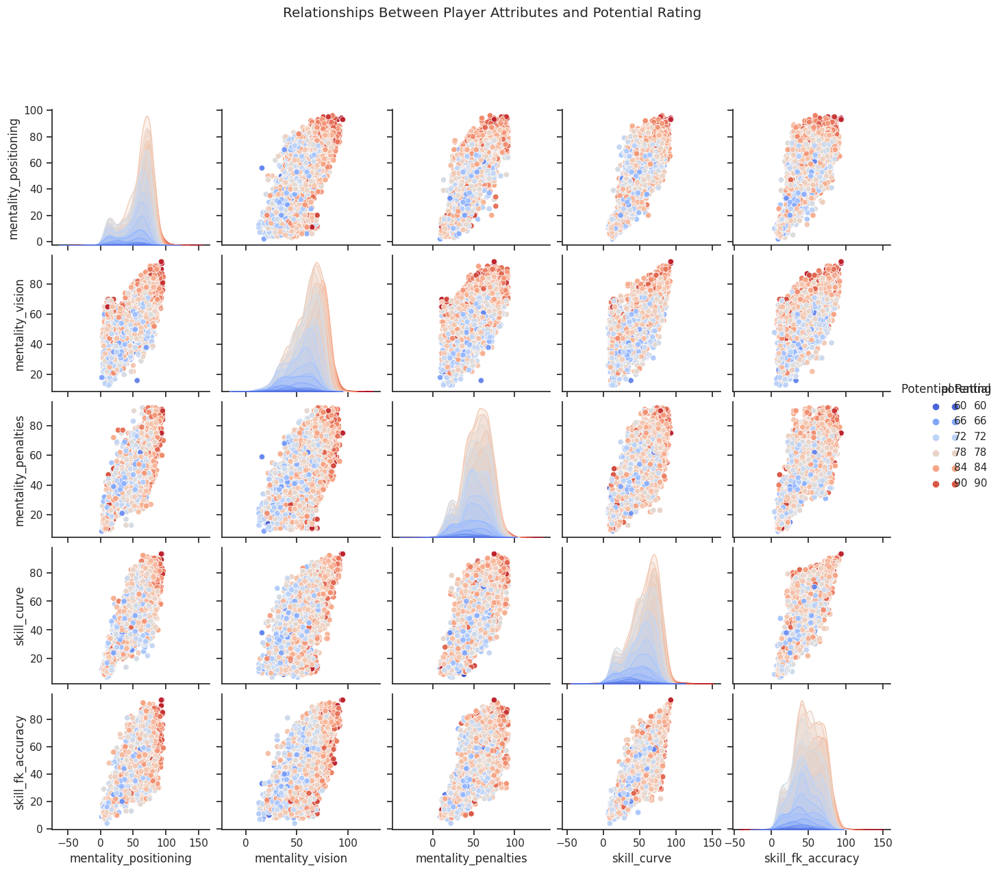

In [105]:
attributes = ['mentality_positioning', 'mentality_vision', 'mentality_penalties',
              'skill_curve', 'skill_fk_accuracy']
sns.set(style="ticks")
g = sns.pairplot(player_char, vars=attributes, hue='potential', palette='coolwarm')
g.fig.suptitle("Relationships Between Player Attributes and Potential Rating", y=1.02)
plt.subplots_adjust(top=0.9)
g.add_legend(title='Potential Rating')
plt.show()

In [106]:
# Transform the DataFrame into an edge list
edges = pd.melt(df_position, var_name='source', value_name='target').dropna()

# Create a links DataFrame
links = edges.groupby(['source', 'target']).size().reset_index()
links.columns = ['source', 'target', 'value']

# Create a nodes DataFrame
nodes = pd.DataFrame(list(set(links['source']).union(set(links['target']))), columns=['name'])

# Map positions and features to numeric values for plotting
nodes['index'] = range(len(nodes))

# Update links DataFrame with numeric values
links['source'] = links['source'].map(nodes.set_index('name')['index'])
links['target'] = links['target'].map(nodes.set_index('name')['index'])
# Get the 'viridis' colormap from matplotlib
cmap = plt.get_cmap('YlGnBu')

# Generate colors from the colormap and convert them to hexadecimal
node_colors = [mcolors.to_hex(cmap(i)) for i in range(len(nodes))]
link_colors = [mcolors.to_hex(cmap(i)) for i in range(len(links))]

# Create a Sankey diagram
fig = go.Figure(data=[go.Sankey(
    node=dict(
        pad=180,  # Increase this value to add more space between nodes
        thickness=80,
        line=dict(color="black", width=0.6),
        label=nodes['name'],
        color=node_colors  # Use the node_colors list here
    ),
    link=dict(
        source=links['source'],
        target=links['target'],
        value=links['value'],
        color=link_colors  # Use link_colors here
    ))])

fig.update_layout(title_text="Sankey Diagram with Feature Colors", font_size=11)
fig.show()

In [107]:
# Assuming you have already calculated 'country_values' as described in your code
# player_char = Trial_df[Trial_df['age'] < 21]

# # Group by 'playing_country' and sum 'value_eur'
# country_values = Trial_df.groupby('playing_country')['value_eur'].sum()
# # Get the minimum and maximum values
# min_value = country_values.min()
# max_value = country_values.max()

# # Print or use the min and max values as needed
# print(f"Minimum Total Value (EUR) among countries: {min_value}")
# print(f"Maximum Total Value (EUR) among countries: {max_value}")

In [108]:
Trial_df.columns

Index(['short_name', 'long_name', 'player_positions', 'overall', 'potential',
       'value_eur', 'wage_eur', 'age', 'club_name', 'league_name',
       'league_level', 'club_joined', 'club_contract_valid_until',
       'nationality_name', 'preferred_foot', 'weak_foot', 'skill_moves',
       'international_reputation', 'work_rate', 'body_type',
       'release_clause_eur', 'shooting', 'passing', 'defending', 'physic',
       'attacking_crossing', 'attacking_heading_accuracy',
       'attacking_short_passing', 'attacking_volleys', 'skill_curve',
       'skill_fk_accuracy', 'skill_long_passing', 'skill_ball_control',
       'movement_agility', 'movement_reactions', 'movement_balance',
       'power_shot_power', 'power_jumping', 'power_stamina', 'power_strength',
       'power_long_shots', 'mentality_aggression', 'mentality_interceptions',
       'mentality_positioning', 'mentality_vision', 'mentality_penalties',
       'mentality_composure', 'defending_marking_awareness',
       'goalkeep

In [109]:
# import pandas as pd
# import matplotlib.pyplot as plt
# import numpy as np
# import plotly.graph_objs as go
# import plotly.offline

# # Load the dataset


# # Define the attribute mapping table
# attribute_mapping = {
#     'CAM': ['movement_balance', 'movement_agility', 'movement_acceleration', 'pace', 'dribbling', 'skill_ball_control', 'skill_dribbling', 'attacking_short_passing', 'mentality_vision'],
#     'CB': ['power_strength', 'physic', 'power_jumping', 'defending_standing_tackle', 'mentality_aggression', 'attacking_heading_accuracy', 'defending_sliding_tackle', 'defending_marking_awareness', 'mentality_interceptions'],
#     'CDM': ['power_stamina', 'movement_acceleration', 'power_strength', 'pace', 'movement_agility', 'attacking_short_passing', 'mentality_interceptions', 'skill_ball_control', 'mentality_positioning'],
#     'CF': ['movement_agility', 'movement_acceleration', 'movement_balance', 'pace', 'dribbling', 'skill_ball_control', 'skill_dribbling', 'power_shot_power', 'mentality_positioning'],
#     'CM': ['movement_balance', 'movement_agility', 'movement_acceleration', 'pace', 'dribbling', 'skill_ball_control', 'attacking_short_passing', 'mentality_vision', 'mentality_interceptions'],
#     'GK': ['goalkeeping_reflexes', 'goalkeeping_diving', 'goalkeeping_positioning', 'goalkeeping_handling', 'goalkeeping_kicking', 'movement_reactions', 'mentality_composure', 'defending_standing_tackle', 'mentality_positioning'],
#     'LB': ['movement_acceleration', 'pace', 'movement_sprint_speed', 'movement_agility', 'movement_balance', 'movement_reactions', 'power_jumping', 'defending_standing_tackle', 'power_stamina'],
#     'LM': ['movement_acceleration', 'pace', 'movement_sprint_speed', 'movement_agility', 'skill_dribbling', 'skill_ball_control', 'mentality_composure', 'attacking_crossing', 'attacking_short_passing'],
#     'LW': ['movement_acceleration', 'pace', 'movement_sprint_speed', 'movement_agility', 'dribbling', 'skill_ball_control', 'skill_dribbling', 'power_shot_power', 'mentality_positioning'],
#     'LWB': ['movement_acceleration', 'pace', 'movement_sprint_speed', 'movement_agility', 'movement_balance', 'power_stamina', 'defending_standing_tackle', 'power_shot_power', 'attacking_crossing'],
#     'RB': ['movement_acceleration', 'pace', 'movement_sprint_speed', 'movement_agility', 'movement_balance', 'movement_reactions', 'power_jumping', 'defending_standing_tackle', 'power_stamina'],
#     'RM': ['movement_acceleration', 'pace', 'movement_sprint_speed', 'movement_agility', 'skill_dribbling', 'skill_ball_control', 'mentality_composure', 'attacking_crossing', 'attacking_short_passing'],
#     'RW': ['movement_acceleration', 'pace', 'movement_sprint_speed', 'movement_agility', 'dribbling', 'skill_ball_control', 'skill_dribbling', 'power_shot_power', 'mentality_positioning'],
#     'RWB': ['movement_acceleration', 'pace', 'movement_sprint_speed', 'movement_agility', 'movement_balance', 'power_stamina', 'defending_standing_tackle', 'power_shot_power', 'attacking_crossing'],
#     'ST': ['movement_sprint_speed', 'pace', 'movement_agility', 'movement_balance', 'dribbling', 'skill_ball_control', 'skill_dribbling', 'power_shot_power', 'attacking_finishing']
# }

# # Creating a method to compare 5 Players
# def top5(ls_name, column, value, Trial_df):
#     x = Trial_df[Trial_df["long_name"] == ls_name[0]]
#     y = Trial_df[Trial_df["long_name"] == ls_name[1]]
#     z = Trial_df[Trial_df["long_name"] == ls_name[2]]
#     az = Trial_df[Trial_df["long_name"] == ls_name[3]]
#     bz = Trial_df[Trial_df["long_name"] == ls_name[4]]

#     trace0 = go.Scatterpolar(
#         r=[x['pace'].values[0], x['shooting'].values[0], x['passing'].values[0], x['dribbling'].values[0],
#            x['defending'].values[0], x['physic'].values[0], x["overall"].values[0]],
#         theta=['Pace', 'Shooting', 'Passing', 'Dribbling', 'Defending', 'Physic', 'Overall'],
#         fill='toself',
#         name=x.long_name.values[0]
#     )

#     trace1 = go.Scatterpolar(
#         r=[y['pace'].values[0], y['shooting'].values[0], y['passing'].values[0], y['dribbling'].values[0],
#            y['defending'].values[0], y['physic'].values[0], y["overall"].values[0]],
#         theta=['Pace', 'Shooting', 'Passing', 'Dribbling', 'Defending', 'Physic', 'Overall'],
#         fill='toself',
#         name=y.long_name.values[0]
#     )

#     trace2 = go.Scatterpolar(
#         r=[z['pace'].values[0], z['shooting'].values[0], z['passing'].values[0], z['dribbling'].values[0],
#            z['defending'].values[0], z['physic'].values[0], z["overall"].values[0]],
#         theta=['Pace', 'Shooting', 'Passing', 'Dribbling', 'Defending', 'Physic', 'Overall'],
#         fill='toself',
#         name=z.long_name.values[0]
#     )

#     trace3 = go.Scatterpolar(
#         r=[az['pace'].values[0], az['shooting'].values[0], az['passing'].values[0], az['dribbling'].values[0],
#            az['defending'].values[0], az['physic'].values[0], az["overall"].values[0]],
#         theta=['Pace', 'Shooting', 'Passing', 'Dribbling', 'Defending', 'Physic', 'Overall'],
#         fill='toself',
#         name=az.long_name.values[0]
#     )

#     trace4 = go.Scatterpolar(
#         r=[bz['pace'].values[0], bz['shooting'].values[0], bz['passing'].values[0], bz['dribbling'].values[0],
#            bz['defending'].values[0], bz['physic'].values[0], bz["overall"].values[0]],
#         theta=['Pace', 'Shooting', 'Passing', 'Dribbling', 'Defending', 'Physic', 'Overall'],
#         fill='toself',
#         name=bz.long_name.values[0]
#     )

#     data = [trace0, trace1, trace2, trace3, trace4]

#     layout = go.Layout(
#         polar=dict(
#             radialaxis=dict(
#                 visible=True,
#                 range=[0, 100]
#             )
#         ),
#         template="plotly_white",
#         showlegend=True,
#         font=dict(family='Cambria, monospace', size=12, color='#000000'),
#         title="{} stats comparison for top 5 under €{} -: {} vs {} vs {} vs {} vs {}".format(column, value,
#                                                                                                 x.long_name.values[
#                                                                                                     0],
#                                                                                                 y.long_name.values[
#                                                                                                     0],
#                                                                                                 z.long_name.values[
#                                                                                                     0],
#                                                                                                 az.long_name.values[
#                                                                                                     0],
#                                                                                                 bz.long_name.values[
#                                                                                                     0]
#                                                                                                 )

#     )
#     fig = go.Figure(data=data, layout=layout)
#     plotly.offline.iplot(fig, filename="Player stats")
#     return None

# # Creating a method to pick top 5 player in position
# def position(pos, value, Trial_df):
#     column = str('Position_') + str.upper(pos)
#     print("You've Entered Position: ", column)
#     print("You've Entered Value €: ", value)

#     # Check if the position exists in the attribute mapping
#     if column in attribute_mapping:
#         ls_name = Trial_df[(Trial_df[column] == 1) & (Trial_df['value_eur'] <= value)]['long_name'].head(5).values
#         print(ls_name)
#         top5(ls_name, column, value, Trial_df)
#     else:
#         print("Position not found in the attribute mapping.")

# # Example usage:
# position('CB', 50000000, Trial_df)


In [110]:
# import matplotlib.pyplot as plt
# import numpy as np
# from matplotlib.cm import get_cmap

# # Filter the DataFrame for young talents (e.g., players younger than 25)
# young_players = player_char[player_char['age'] < 25]

# # Calculate the change in potential rating for each player
# young_players['potential_change'] = young_players['Future_pot'].astype(int)

# # Sort the DataFrame by potential change in descending order
# sorted_players = young_players.sort_values(by='potential_change', ascending=False)

# # Select the top N players with the most significant potential improvement
# top_players = sorted_players.head(5)  # You can adjust the number of top players to display

# # Define the attributes (stats) you want to compare
# attributes = ['potential_change', 'overall', 'Dribble', 'Speed', 'mentality_vision']

# # Create a radar chart
# fig, ax = plt.subplots(figsize=(8, ), subplot_kw=dict(polar=True))
# angles = np.linspace(0, 2 * np.pi, len(attributes), endpoint=False).tolist()
# angles += angles[:1]  # Close the plot by repeating the first angle

# cmap = get_cmap('viridis')
# colors = cmap(np.linspace(0, 1, len(top_players)))

# for i, (_, player) in enumerate(top_players.iterrows()):
#     values = player[attributes].tolist()
#     values += values[:1]  # Close the plot by repeating the first value
#     ax.fill(angles, values, alpha=0.2, label=player['player_name'], color=colors[i])

# ax.set_xticks(angles[:-1])
# ax.set_xticklabels(attributes)
# plt.title('Comparison of Young Talents with Most Potential Improvement (Radar Chart)')
# plt.legend(loc='upper right', bbox_to_anchor=(1.1, 1.1))

# plt.show()


In [111]:
Trial_df.columns

Index(['short_name', 'long_name', 'player_positions', 'overall', 'potential',
       'value_eur', 'wage_eur', 'age', 'club_name', 'league_name',
       'league_level', 'club_joined', 'club_contract_valid_until',
       'nationality_name', 'preferred_foot', 'weak_foot', 'skill_moves',
       'international_reputation', 'work_rate', 'body_type',
       'release_clause_eur', 'shooting', 'passing', 'defending', 'physic',
       'attacking_crossing', 'attacking_heading_accuracy',
       'attacking_short_passing', 'attacking_volleys', 'skill_curve',
       'skill_fk_accuracy', 'skill_long_passing', 'skill_ball_control',
       'movement_agility', 'movement_reactions', 'movement_balance',
       'power_shot_power', 'power_jumping', 'power_stamina', 'power_strength',
       'power_long_shots', 'mentality_aggression', 'mentality_interceptions',
       'mentality_positioning', 'mentality_vision', 'mentality_penalties',
       'mentality_composure', 'defending_marking_awareness',
       'goalkeep

In [112]:
pip install scipy


Note: you may need to restart the kernel to use updated packages.


In [113]:
# import pandas as pd
# import matplotlib.pyplot as plt
# import numpy as np

# # Load the dataset


# # Convert 'Future_pot' and 'potential' columns to numeric
# Trial_df['Future_pot'] = pd.to_numeric(Trial_df['Future_pot'], errors='coerce')
# Trial_df['potential'] = pd.to_numeric(Trial_df['potential'], errors='coerce')

# # Filter the DataFrame for young talents (e.g., players younger than 25) and for the 2020 season
# young_players = Trial_df[(Trial_df['age'] < 25) & (Trial_df['Year'] == 2020)]

# # Calculate the change in potential rating for each player
# young_players['potential_change'] = young_players['potential'] - young_players['overall']

# # Sort the DataFrame by potential change in descending order
# sorted_players = young_players.sort_values(by='potential_change', ascending=False)

# # Select the top N players with the most significant potential improvement
# top_players = sorted_players.head(5)  # You can adjust the number of top players to display

# # Define the attributes (stats) you want to track over the 2021/22 seasons
# attributes = ['potential', 'overall', 'Dribble', 'Speed', 'mentality_vision']

# # Create a radar chart to track the progress of the top players in 2021/22 seasons

# import pandas as pd
# import matplotlib.pyplot as plt
# import numpy as np

# # Assuming you've already loaded your dataset and filtered young players
# # (young_players DataFrame)

# # Define the top N players
# top_players = young_players.head(5)  # You can adjust the number of top players to display

# # Define the attributes (stats) you want to track over the 2021/22 seasons
# attributes = ['potential', 'overall', 'Dribble', 'Speed', 'mentality_vision']

# # Create radar charts to track the progress of the top players in 2021/22 seasons

# # Iterate over the top players
# for i, (_, player) in enumerate(top_players.iterrows()):
#     player_name = player['long_name']

#     # Create a radar chart for each player
#     fig, ax = plt.subplots(figsize=(6, 6), subplot_kw=dict(polar=True))

#     # Number of variables we're plotting.
#     num_vars = len(attributes)

#     # Split the circle into even parts and save the angles so we know where to put each axis.
#     angles = np.linspace(0, 2 * np.pi, num_vars, endpoint=False).tolist()

#     # The plot is a circle, so we need to "complete the loop" and append the start value to the end.
#     player_values = [player[attr] for attr in attributes]
#     player_values += player_values[:1]
#     angles += angles[:1]

#     ax.fill(angles, player_values, alpha=0.25, label=f'{player_name}')
#     ax.set_yticklabels([])
#     ax.set_thetagrids(np.degrees(angles[:-1]), attributes)
#     plt.title(f'{player_name} - Attributes Progress in 2021/22 Seasons')
#     ax.legend()
#     plt.show()



In [115]:
#  m = folium.Map(location=[20, 0], zoom_start=2)
# # Add markers for each country
# for i in range(len(Trial_df)):
#     lat, lon = Trial_df['coordinates'].iloc[i]
#     folium.Marker([lat, lon]).add_to(m)
# m

----------------------------------------------------------------------------------------------

In [116]:
fig = px.parallel_categories(df_position)
fig.show()

In [117]:
column_lists = {col: df_position[col].tolist() for col in df_position.columns}
column_lists

{'CAM': ['movement_balance',
  'movement_agility',
  'movement_acceleration',
  'pace',
  'movement_sprint_speed',
  'dribbling',
  'skill_ball_control',
  'skill_dribbling',
  'attacking_short_passing',
  'mentality_vision'],
 'CB': ['power_strength',
  'physic',
  'power_jumping',
  'defending_standing_tackle',
  'mentality_aggression',
  'defending',
  'attacking_heading_accuracy',
  'defending_sliding_tackle',
  'defending_marking_awareness',
  'mentality_interceptions'],
 'CDM': ['power_stamina',
  'physic',
  'mentality_aggression',
  'power_strength',
  'attacking_short_passing',
  'power_jumping',
  'defending_standing_tackle',
  'movement_balance',
  'mentality_interceptions',
  'skill_ball_control'],
 'CF': ['movement_agility',
  'movement_acceleration',
  'movement_balance',
  'pace',
  'movement_sprint_speed',
  'dribbling',
  'skill_dribbling',
  'skill_ball_control',
  'power_shot_power',
  'mentality_positioning'],
 'CM': ['movement_balance',
  'power_stamina',
  'attack

In [118]:
!pip install bokeh

In [119]:
!pip install pandas circlify matplotlib


In [120]:
import holoviews as hv
from holoviews import opts, dim

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
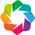

:Chord   [start,end]

In [121]:

hv.extension('bokeh')
data = [(k, v) for k, values in df_position.items() for v in values]

chord = hv.Chord(data)
chord.opts(
    opts.Chord(cmap='Category10', edge_cmap='Category10', edge_color=dim('source').str(),
               labels='name',label_text_font_size='15pt', node_color=dim('index').str(),width=800, height=800, title="positions related features")
)

chord

In [122]:
df_position

,CAM,CB,CDM,CF,CM,GK,LB,LM,LW,LWB,RB,RM,RW,RWB,ST
0,movement_balance,power_strength,power_stamina,movement_agility,movement_balance,goalkeeping_reflexes,movement_acceleration,movement_acceleration,movement_acceleration,movement_acceleration,movement_sprint_speed,movement_acceleration,movement_acceleration,movement_sprint_speed,power_strength
1,movement_agility,physic,physic,movement_acceleration,power_stamina,goalkeeping_diving,pace,pace,pace,pace,pace,pace,pace,pace,movement_sprint_speed
2,movement_acceleration,power_jumping,mentality_aggression,movement_balance,attacking_short_passing,goalkeeping_positioning,movement_sprint_speed,movement_sprint_speed,movement_sprint_speed,movement_sprint_speed,movement_acceleration,movement_sprint_speed,movement_sprint_speed,movement_acceleration,pace
3,pace,defending_standing_tackle,power_strength,pace,movement_agility,goalkeeping_handling,power_stamina,movement_agility,movement_agility,power_stamina,power_stamina,movement_agility,movement_agility,power_stamina,movement_acceleration
4,movement_sprint_speed,mentality_aggression,attacking_short_passing,movement_sprint_speed,skill_ball_control,goalkeeping_kicking,movement_balance,movement_balance,movement_balance,movement_agility,movement_balance,movement_balance,movement_balance,movement_balance,power_jumping
5,dribbling,defending,power_jumping,dribbling,movement_acceleration,power_strength,movement_agility,dribbling,skill_dribbling,movement_balance,movement_agility,dribbling,skill_dribbling,movement_agility,attacking_finishing
6,skill_ball_control,attacking_heading_accuracy,defending_standing_tackle,skill_dribbling,dribbling,movement_reactions,power_jumping,skill_dribbling,dribbling,power_jumping,power_jumping,skill_dribbling,dribbling,power_jumping,power_shot_power
7,skill_dribbling,defending_sliding_tackle,movement_balance,skill_ball_control,skill_long_passing,power_jumping,physic,skill_ball_control,skill_ball_control,physic,physic,skill_ball_control,skill_ball_control,physic,movement_agility
8,attacking_short_passing,defending_marking_awareness,mentality_interceptions,power_shot_power,pace,movement_balance,defending_standing_tackle,power_stamina,power_shot_power,dribbling,defending_standing_tackle,power_stamina,power_shot_power,power_strength,mentality_positioning
9,mentality_vision,mentality_interceptions,skill_ball_control,mentality_positioning,movement_sprint_speed,mentality_composure,defending_sliding_tackle,power_shot_power,power_stamina,attacking_crossing,defending_sliding_tackle,attacking_short_passing,power_stamina,dribbling,physic


In [123]:
Trial_df.columns

Index(['short_name', 'long_name', 'player_positions', 'overall', 'potential',
       'value_eur', 'wage_eur', 'age', 'club_name', 'league_name',
       'league_level', 'club_joined', 'club_contract_valid_until',
       'nationality_name', 'preferred_foot', 'weak_foot', 'skill_moves',
       'international_reputation', 'work_rate', 'body_type',
       'release_clause_eur', 'shooting', 'passing', 'defending', 'physic',
       'attacking_crossing', 'attacking_heading_accuracy',
       'attacking_short_passing', 'attacking_volleys', 'skill_curve',
       'skill_fk_accuracy', 'skill_long_passing', 'skill_ball_control',
       'movement_agility', 'movement_reactions', 'movement_balance',
       'power_shot_power', 'power_jumping', 'power_stamina', 'power_strength',
       'power_long_shots', 'mentality_aggression', 'mentality_interceptions',
       'mentality_positioning', 'mentality_vision', 'mentality_penalties',
       'mentality_composure', 'defending_marking_awareness',
       'goalkeep

In [124]:
# import networkx as nx
# edges = []
# for column in df_position.columns:
#     for value in df_position[column].unique():
#         edges.append((column, value))
# G = nx.Graph()
# G.add_edges_from(edges)
# plt.figure(figsize=(28, 18))
# pos = nx.spring_layout(G, k=0.95)
# nx.draw_networkx_nodes(G, pos, node_size=700)
# nx.draw_networkx_edges(G, pos, edgelist=edges, width=1.5, edge_color='gray')
# nx.draw_networkx_labels(G, pos, font_size=12, font_family='sans-serif')
# plt.title("Graph Visualization of DataFrame Columns and Values", fontsize=16)
# plt.axis('off')
# plt.show()

In [125]:
young_strikers = player_char[player_char['age'] < 25]
top_10_strikers = young_strikers.nlargest(10, 'goals')
top_10_strikers

,player_name,games,time,goals,xG,assists,xA,shots,key_passes,npg,npxG,xGChain,xGBuildup,Year,Secondary_position,player_positions,Best_position,overall,playing_country,Future_pot,potential,value_eur,wage_eur,BMI,Dribble,Speed,age,attacking_crossing,attacking_heading_accuracy,attacking_short_passing,attacking_volleys,skill_curve,skill_fk_accuracy,mentality_positioning,mentality_vision,mentality_penalties
8012,Erling Haaland,35,2803,36,32.761400,8,5.849110,123,29,29,27.433210,31.963398,3.285816,2022,cb,ST,lcb,88.0,Germany,5.0,93.0,137500000.0,110000.0,24.976087,79.0,88.333333,20.0,47.0,69.0,77.0,88.0,77.0,62.0,89.0,71.0,76.0
3118,Timo Werner,34,2825,28,23.448499,8,9.675969,123,53,25,21.175240,35.586396,7.971804,2019,rm,ST,lm,83.0,Germany,4.0,87.0,34500000.0,70000.0,22.893074,83.0,93.000000,22.0,69.0,76.0,77.0,82.0,62.0,56.0,85.0,61.0,72.0
5158,André Silva,32,2787,28,25.599132,5,5.467086,114,31,21,20.294786,26.746589,4.096429,2020,cb,ST,lcb,79.0,Italy,5.0,84.0,17000000.0,42000.0,23.082542,77.5,76.666667,23.0,59.0,77.0,69.0,79.0,69.0,33.0,84.0,68.0,80.0
8816,Victor Osimhen,32,2609,26,26.626030,4,2.648569,134,33,24,24.342134,23.062605,2.083379,2022,cm,ST,lcm,80.0,Italy,7.0,87.0,43000000.0,66000.0,22.790358,74.5,87.666667,22.0,64.0,78.0,69.0,75.0,63.0,48.0,81.0,65.0,75.0
7190,Patrik Schick,27,2127,24,20.005189,3,2.075822,90,16,23,18.489641,20.315174,3.147152,2021,rm,"ST, RW",lm,78.0,Germany,6.0,84.0,22500000.0,56000.0,21.100705,81.5,70.333333,24.0,64.0,80.0,78.0,74.0,78.0,56.0,80.0,73.0,58.0
8444,Jonathan Christian David,37,3193,24,25.025641,4,7.122997,106,52,14,16.664670,30.582719,9.340892,2022,st,ST,ls,78.0,France,8.0,86.0,32000000.0,31000.0,24.577867,78.5,85.000000,21.0,67.0,72.0,78.0,71.0,58.0,48.0,80.0,73.0,75.0
7191,Erling Haaland,24,1917,22,17.030954,7,5.894002,80,23,16,12.484373,19.772442,4.264734,2021,ls,ST,gk,84.0,Germany,8.0,92.0,92000000.0,56000.0,23.381868,75.5,84.000000,19.0,46.0,67.0,74.0,82.0,77.0,62.0,86.0,68.0,80.0
4740,Dusan Vlahovic,37,2945,21,18.476590,3,2.296163,86,18,15,13.908836,14.827188,1.562625,2020,rm,ST,lm,60.0,Italy,19.0,79.0,450000.0,5000.0,22.160665,55.0,59.000000,19.0,41.0,62.0,60.0,47.0,41.0,37.0,58.0,53.0,65.0
6377,Martin Terrier,37,2836,21,15.060966,3,5.016157,88,42,19,13.540777,24.810452,10.825361,2021,cdm,"LW, ST",ldm,76.0,France,6.0,82.0,12000000.0,39000.0,21.561909,75.0,84.000000,23.0,68.0,65.0,77.0,66.0,76.0,58.0,78.0,76.0,62.0
6788,Lautaro Martínez,35,2334,21,24.570459,3,3.604015,118,28,18,20.002662,24.541737,5.153755,2021,rm,ST,lm,84.0,Italy,7.0,91.0,86500000.0,130000.0,26.753864,86.0,83.333333,22.0,56.0,84.0,78.0,83.0,78.0,43.0,85.0,77.0,74.0


In [126]:
player_char['Future_pot'] = (player_char['potential'] - player_char['overall'])

--------------------------

In [127]:
player_char.head()

,player_name,games,time,goals,xG,assists,xA,shots,key_passes,npg,npxG,xGChain,xGBuildup,Year,Secondary_position,player_positions,Best_position,overall,playing_country,Future_pot,potential,value_eur,wage_eur,BMI,Dribble,Speed,age,attacking_crossing,attacking_heading_accuracy,attacking_short_passing,attacking_volleys,skill_curve,skill_fk_accuracy,mentality_positioning,mentality_vision,mentality_penalties
0,Pierre-Emerick Aubameyang,36,2740,22,23.549973,5,4.989848,94,33,18,19.744131,26.582433,6.483640,2018,st,ST,ls,88.0,Germany,0.0,88.0,61000000.0,160000.0,22.877406,81.5,95.666667,28.0,77.0,79.0,77.0,86.0,78.0,74.0,89.0,77.0,79.0
1,Sadio Mané,36,3100,22,16.762799,1,5.123735,87,45,22,16.762799,28.401348,8.485084,2018,cam,"RW, LW",lam,84.0,England,3.0,87.0,39000000.0,170000.0,22.530612,85.5,93.000000,25.0,72.0,53.0,77.0,68.0,74.0,64.0,84.0,78.0,71.0
2,Mohamed Salah,38,3274,22,21.792449,8,10.468591,137,68,19,19.508948,31.780288,7.865941,2018,cm,RW,lcm,83.0,England,3.0,86.0,32500000.0,130000.0,23.183673,87.0,93.000000,25.0,73.0,59.0,79.0,71.0,70.0,60.0,83.0,78.0,61.0
3,Sergio Agüero,33,2515,21,19.949161,8,5.229244,118,34,19,18.426823,28.700229,8.100993,2018,st,ST,ls,89.0,England,0.0,89.0,66500000.0,325000.0,23.388687,89.0,87.000000,29.0,70.0,68.0,79.0,85.0,82.0,72.0,91.0,83.0,83.0
4,Jamie Vardy,34,2740,18,19.115980,4,5.137332,79,32,14,15.310136,20.782567,1.905693,2018,cb,ST,lcb,81.0,England,0.0,81.0,17000000.0,90000.0,23.095409,76.5,91.000000,30.0,63.0,64.0,66.0,73.0,59.0,48.0,84.0,72.0,76.0


In [128]:
player_char.head(2)

,player_name,games,time,goals,xG,assists,xA,shots,key_passes,npg,npxG,xGChain,xGBuildup,Year,Secondary_position,player_positions,Best_position,overall,playing_country,Future_pot,potential,value_eur,wage_eur,BMI,Dribble,Speed,age,attacking_crossing,attacking_heading_accuracy,attacking_short_passing,attacking_volleys,skill_curve,skill_fk_accuracy,mentality_positioning,mentality_vision,mentality_penalties
0,Pierre-Emerick Aubameyang,36,2740,22,23.549973,5,4.989848,94,33,18,19.744131,26.582433,6.483640,2018,st,ST,ls,88.0,Germany,0.0,88.0,61000000.0,160000.0,22.877406,81.5,95.666667,28.0,77.0,79.0,77.0,86.0,78.0,74.0,89.0,77.0,79.0
1,Sadio Mané,36,3100,22,16.762799,1,5.123735,87,45,22,16.762799,28.401348,8.485084,2018,cam,"RW, LW",lam,84.0,England,3.0,87.0,39000000.0,170000.0,22.530612,85.5,93.000000,25.0,72.0,53.0,77.0,68.0,74.0,64.0,84.0,78.0,71.0


In [129]:
filtered_df = Trial_df[((Trial_df['Year']==2022)&Trial_df['age'].isin([21, 17]) & (Trial_df['defending'] > 70)&(Trial_df['value_eur'] < 5000000))]

# Group by league name and count the number of players
relation_df = filtered_df.groupby('league_name').size().reset_index(name='player_count')

# Create a bar chart
plt.figure(figsize=(10, 6))
fig = px.pie(relation_df, values='player_count', names='league_name',
             title='Number of Players by League Name whose age is Between 21, 17 years old and their defending > 70 and price < 5M)')

fig.show()

<Figure size 1000x600 with 0 Axes>

In [130]:
club = Trial_df. groupby('club_name')['value_eur'].sum().reset_index().sort_values('value_eur', ascending=True).tail(20)
fig = px.bar(club, x="value_eur", y="club_name", orientation='h')
fig.show()

In [131]:
club = Trial_df. groupby('club_name')['wage_eur'].sum().reset_index().sort_values('wage_eur', ascending=True).tail(20)
fig = px.bar(club, x="wage_eur", y="club_name", orientation='h')
fig.update_traces(marker_color='seagreen')
fig.show()

In [132]:
defence = ["CB", "RB", "LB", "LWB", "RWB", "LCB", "RCB"]
defence_lower = [position.lower() for position in defence]
midfielder = ["CM", "CDM", "CAM", "LM", "RM", "LAM", "RAM", "LCM", "RCM", "LDM", "RDM"]
midfield_lower = [position.lower() for position in midfielder]
# Apply the classification logic using numpy's np.where
Trial_df['class'] = np.where(Trial_df['player_positions'] == 'GK', 'Goal Keeper',
              np.where(Trial_df['player_positions'].isin(defence), 'Defender',
              np.where(Trial_df['player_positions'].isin(midfielder), 'Midfielder', 'Forward')))

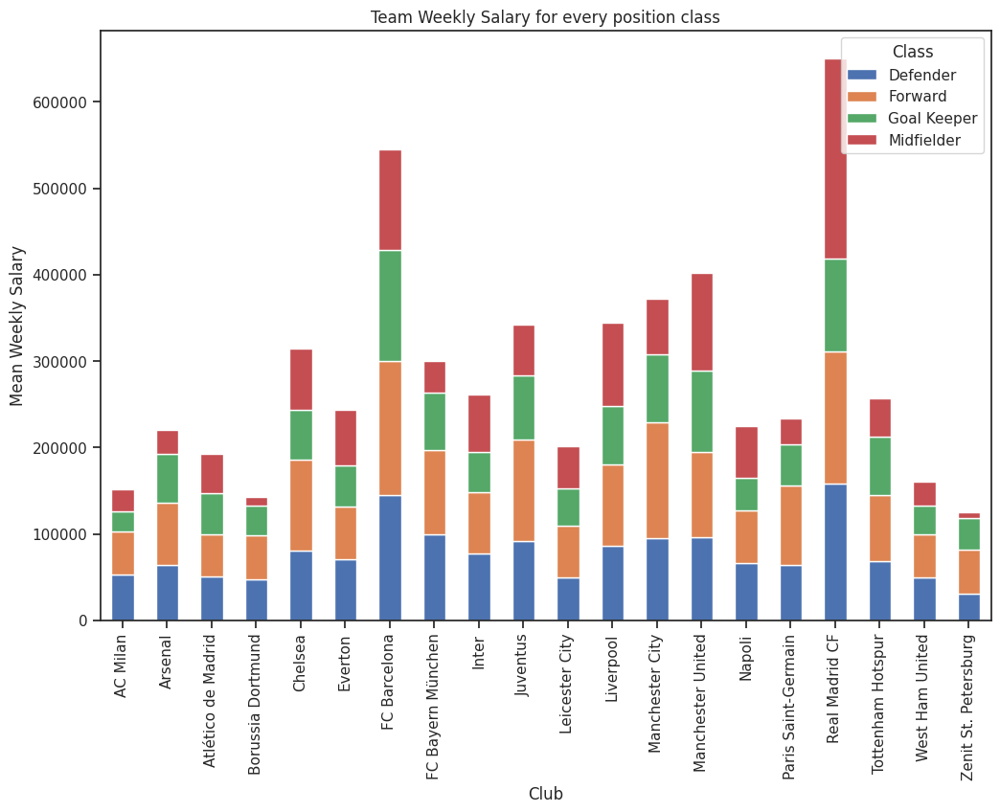

In [133]:
powerful = Trial_df.groupby('club_name')['wage_eur'].mean().reset_index()
powerful = powerful.sort_values(by='wage_eur', ascending=False).head(20)

# Calculate mean Overall rating by Club and Class
mean_by_class = Trial_df.groupby(['club_name', 'class'])['wage_eur'].mean().reset_index()

# Filter clubs in powerful
mean_by_class = mean_by_class[mean_by_class['club_name'].isin(powerful['club_name'])]

# Create a pivot table for plotting
pivot_table = mean_by_class.pivot_table(index='club_name', columns='class', values='wage_eur', fill_value=0)

# Plot the data
fig, ax = plt.subplots(figsize=(12, 8))

pivot_table.plot(kind='bar', stacked=True, ax=ax)
plt.title('Team Weekly Salary for every position class')
plt.xlabel('Club')
plt.ylabel('Mean Weekly Salary')
plt.legend(title='Class', loc='upper right')

plt.show()

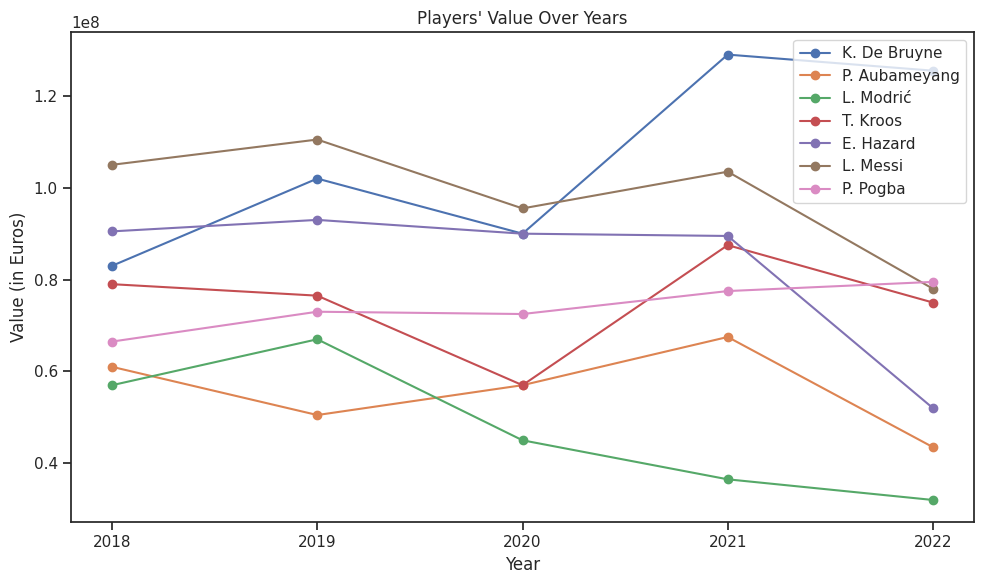

In [134]:
import numpy as np

def plot_player_value_over_years(player_names, player_df):
    plt.figure(figsize=(10, 6))

    for player_name in player_names:
        # Filter the DataFrame for the specified player
        player_data = player_df[player_df['short_name'] == player_name]

        if player_data.empty:
            print(f"Player '{player_name}' not found in the dataset.")
            continue

        # Select relevant columns for the plot
        years = player_data['Year']
        values = player_data['value_eur']

        # Create a line chart
        plt.plot(years, values, marker='o', label=player_name)

    plt.xlabel('Year')
    plt.ylabel('Value (in Euros)')
    plt.title('Players\' Value Over Years')
    plt.legend()
    plt.xticks(np.unique(years))
    plt.tight_layout()

    # Show the chart
    plt.show()
player_names = ['K. De Bruyne', 'P. Aubameyang', 'L. Modrić', 'T. Kroos', 'E. Hazard', 'L. Messi', 'P. Pogba']
plot_player_value_over_years(player_names, Trial_df)

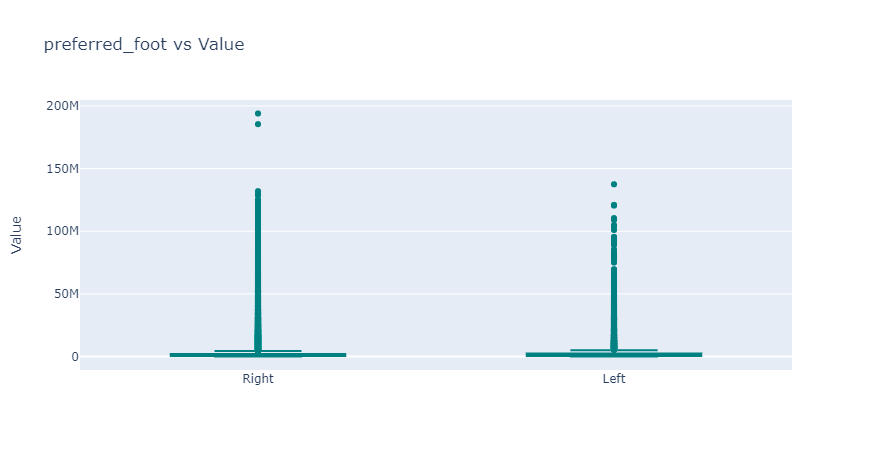

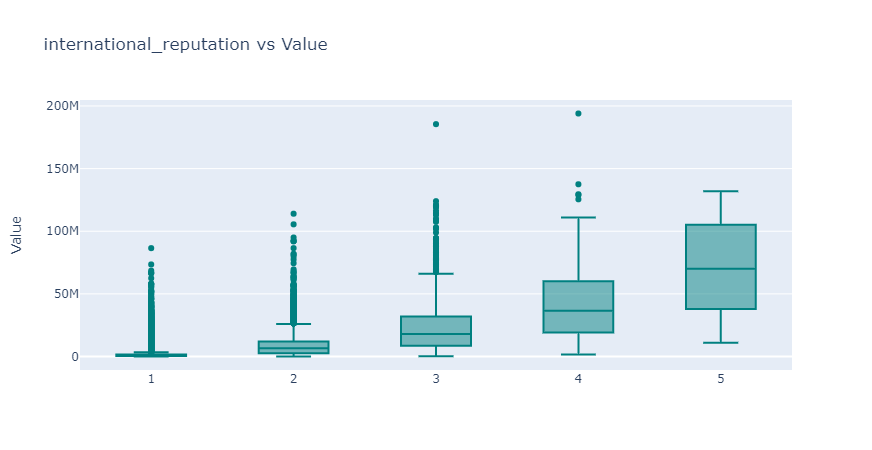

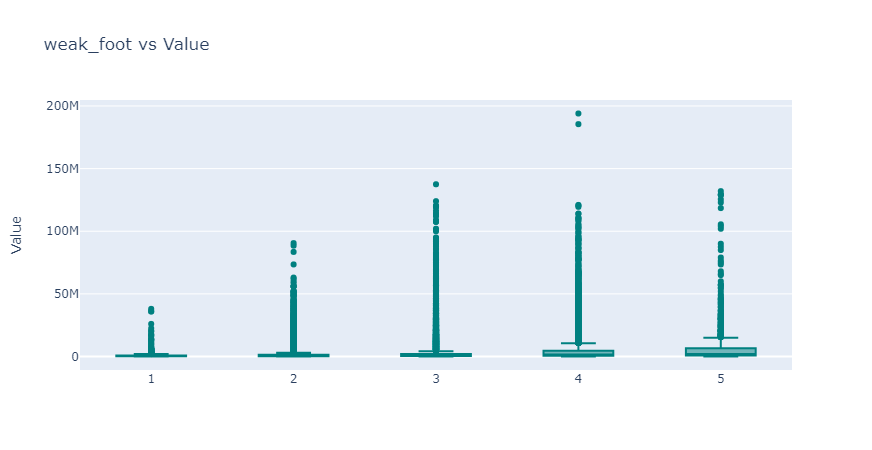

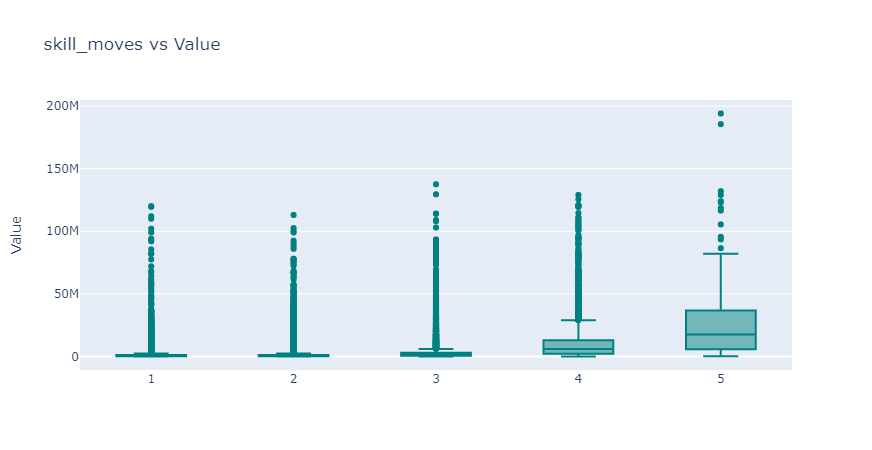

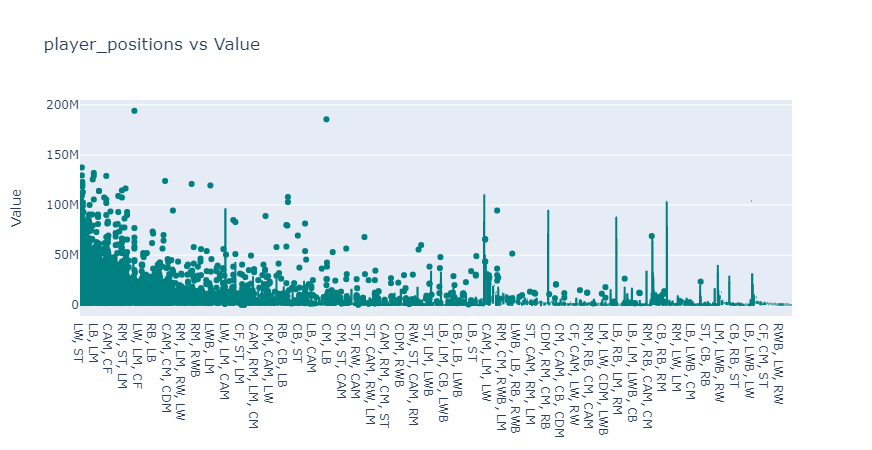

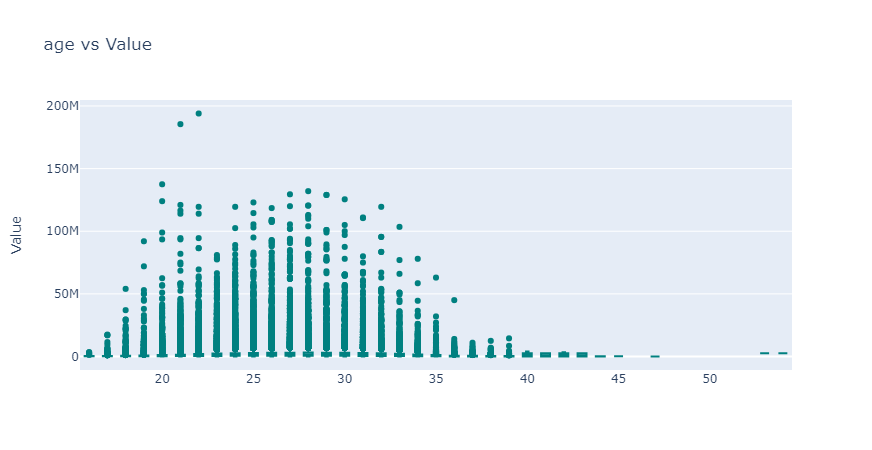

In [135]:
from plotly.offline import iplot, init_notebook_mode
import plotly.graph_objs as go
corr_cat = Trial_df.loc[:, ['preferred_foot', 'international_reputation', 'weak_foot',
                        'skill_moves', 'player_positions','age']]

init_notebook_mode(connected=True)

for i in corr_cat.columns:
    trace = go.Box(
                   x = corr_cat[i],
                   y = Trial_df['value_eur'],
                   marker = dict(color = 'teal'))
    layout = go.Layout(title = '{} vs Value'. format(i), yaxis = dict(title = 'Value'))
    fig = go.Figure(data = trace, layout = layout)
    iplot(fig)

/opt/conda/lib/python3.10/site-packages/seaborn/axisgrid.py:118: UserWarning:

The figure layout has changed to tight



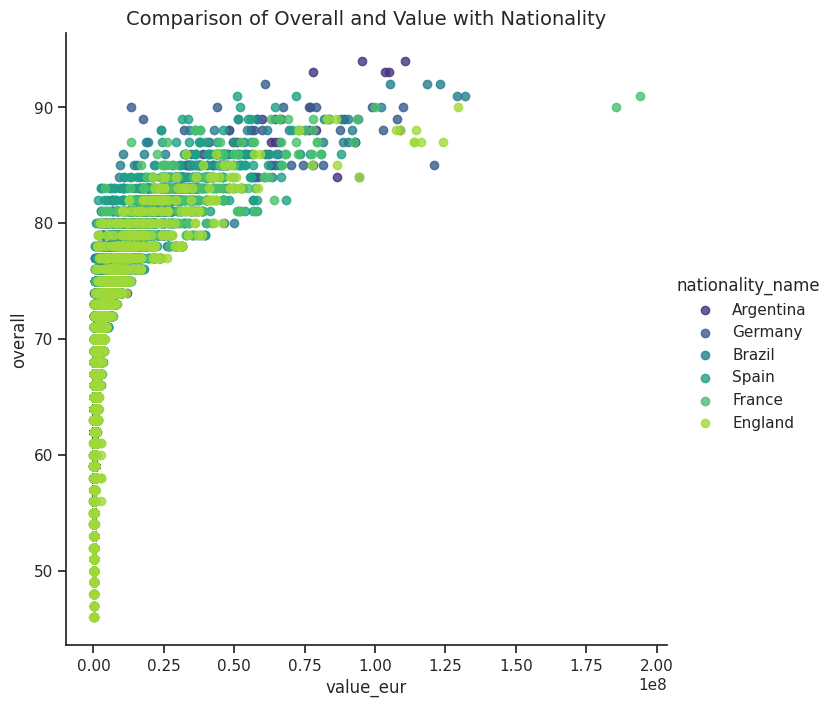

In [136]:
countries = ('England', 'Germany', 'Spain', 'Argentina', 'France', 'Brazil')

sns.lmplot(x='value_eur', y='overall', hue='nationality_name', palette='viridis',
           data=Trial_df.loc[Trial_df['nationality_name'].isin(countries)],
           fit_reg=False, height=7)

plt.title('Comparison of Overall and Value with Nationality', fontsize=14)
plt.show()

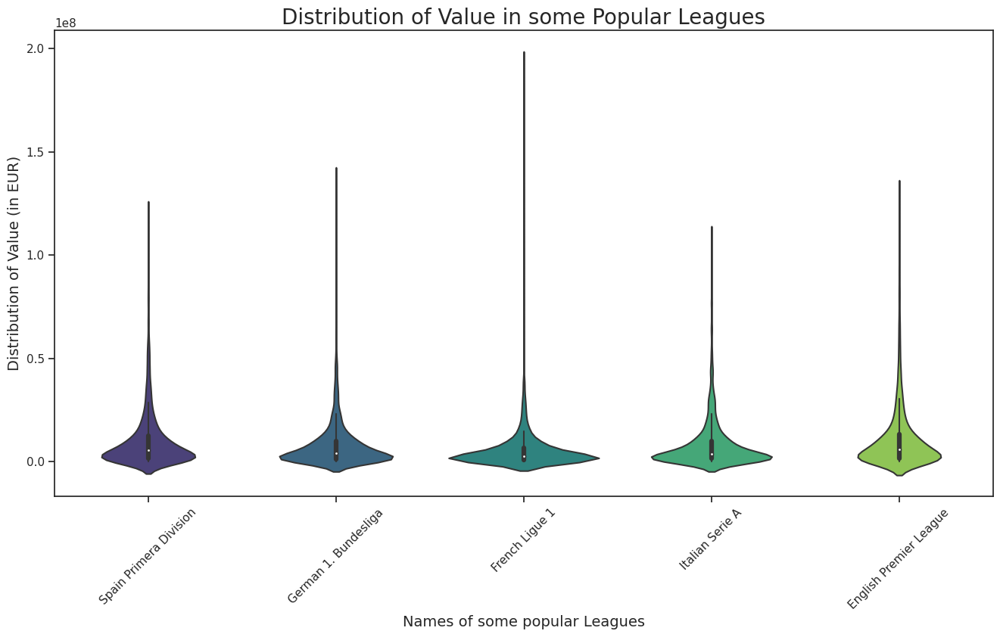

In [137]:
some_leagues = ['Spain Primera Division', 'German 1. Bundesliga', 'French Ligue 1',
                'Italian Serie A', 'English Premier League']

data_league = Trial_df.loc[Trial_df['league_name'].isin(some_leagues)]

plt.rcParams['figure.figsize'] = (16, 8)
ax = sns.violinplot(x='league_name', y='value_eur', data=data_league, palette='viridis')
ax.set_xlabel(xlabel='Names of some popular Leagues', fontsize=14)
ax.set_ylabel(ylabel='Distribution of Value (in EUR)', fontsize=14)
ax.set_title(label='Distribution of Value in some Popular Leagues', fontsize=20)
plt.xticks(rotation=45)
plt.show()

# Modeling

In [4]:
pip install shap


  Obtaining dependency information for shap from https://files.pythonhosted.org/packages/e5/4c/a4785425971e7433a7d80fa0ff9cd9f5f35303d4e99446190d91c72648c9/shap-0.44.0-cp311-cp311-win_amd64.whl.metadata
   ---------------------------------------- 0.0/448.0 kB ? eta -:--:--
   --- ------------------------------------ 41.0/448.0 kB 1.9 MB/s eta 0:00:01
   ---------- ----------------------------- 122.9/448.0 kB 1.4 MB/s eta 0:00:01
   ------------------ --------------------- 204.8/448.0 kB 1.6 MB/s eta 0:00:01
   -------------------------------- ------- 358.4/448.0 kB 2.0 MB/s eta 0:00:01
   ---------------------------------------- 448.0/448.0 kB 2.0 MB/s eta 0:00:00


In [21]:
import pandas as pd
from sklearn.linear_model import LinearRegression,Lasso,Ridge
from sklearn.model_selection import train_test_split,GridSearchCV
from sklearn.preprocessing import LabelEncoder
from sklearn.metrics import mean_absolute_error
from xgboost import XGBRegressor
from sklearn.preprocessing import RobustScaler
import shap

In [9]:
Main_df = pd.read_csv('Fifa.csv')
Trial_df = pd.read_csv('Trial_df.csv')
player_char = pd.read_csv('player_char.csv')

In [10]:
def imp_features(df,player_features):
    lst = []
    for i in df['player_positions']:
        lst.append(i.split(',')[0])
    df['position'] = lst
    
    df_position = pd.DataFrame()
    for position,feature in df.groupby(Main_df['position'])[player_features].mean().iterrows():
        top = dict(feature.nlargest(10))
        df_position[position] = tuple(top)
    return df_position


In [11]:
player_features = ['pace','shooting','passing','dribbling','defending','physic','attacking_crossing','attacking_finishing',
                    'attacking_heading_accuracy','attacking_short_passing','attacking_volleys','skill_dribbling','skill_curve','skill_fk_accuracy','skill_long_passing','skill_ball_control',
                    'movement_acceleration','movement_sprint_speed','movement_agility','movement_reactions','movement_balance','power_shot_power','power_jumping','power_stamina','power_strength','power_long_shots',	
                    'mentality_aggression','mentality_interceptions','mentality_positioning','mentality_vision','mentality_penalties',	
                        'mentality_composure','defending_marking_awareness','defending_standing_tackle','defending_sliding_tackle',    
            'goalkeeping_diving','goalkeeping_handling','goalkeeping_kicking','goalkeeping_positioning','goalkeeping_reflexes','goalkeeping_speed']
imp_features(Main_df,player_features)

,CAM,CB,CDM,CF,CM,GK,LB,LM,LW,LWB,RB,RM,RW,RWB,ST
0,movement_balance,power_strength,power_stamina,movement_agility,movement_balance,goalkeeping_reflexes,movement_acceleration,movement_acceleration,movement_acceleration,movement_acceleration,movement_sprint_speed,movement_acceleration,movement_acceleration,movement_sprint_speed,power_strength
1,movement_agility,physic,physic,movement_acceleration,power_stamina,goalkeeping_diving,pace,pace,pace,pace,pace,pace,pace,pace,movement_sprint_speed
2,movement_acceleration,power_jumping,mentality_aggression,movement_balance,attacking_short_passing,goalkeeping_positioning,movement_sprint_speed,movement_sprint_speed,movement_sprint_speed,movement_sprint_speed,movement_acceleration,movement_sprint_speed,movement_sprint_speed,movement_acceleration,pace
3,pace,defending_standing_tackle,power_strength,pace,movement_agility,goalkeeping_handling,power_stamina,movement_agility,movement_agility,power_stamina,power_stamina,movement_agility,movement_agility,power_stamina,movement_acceleration
4,movement_sprint_speed,mentality_aggression,attacking_short_passing,movement_sprint_speed,skill_ball_control,goalkeeping_kicking,movement_balance,movement_balance,movement_balance,movement_agility,movement_balance,movement_balance,movement_balance,movement_balance,power_jumping
5,dribbling,defending,power_jumping,dribbling,movement_acceleration,power_strength,movement_agility,dribbling,skill_dribbling,movement_balance,movement_agility,dribbling,skill_dribbling,movement_agility,attacking_finishing
6,skill_ball_control,attacking_heading_accuracy,defending_standing_tackle,skill_dribbling,dribbling,movement_reactions,power_jumping,skill_dribbling,dribbling,power_jumping,power_jumping,skill_dribbling,dribbling,power_jumping,power_shot_power
7,skill_dribbling,defending_sliding_tackle,movement_balance,skill_ball_control,skill_long_passing,power_jumping,physic,skill_ball_control,skill_ball_control,physic,physic,skill_ball_control,skill_ball_control,physic,movement_agility
8,attacking_short_passing,defending_marking_awareness,mentality_interceptions,power_shot_power,pace,movement_balance,defending_standing_tackle,power_stamina,power_shot_power,dribbling,defending_standing_tackle,power_stamina,power_shot_power,power_strength,mentality_positioning
9,mentality_vision,mentality_interceptions,skill_ball_control,mentality_positioning,movement_sprint_speed,mentality_composure,defending_sliding_tackle,power_shot_power,power_stamina,attacking_crossing,defending_sliding_tackle,attacking_short_passing,power_stamina,dribbling,physic


In [12]:
player_features = ['defending','physic','attacking_crossing','total_passing','total_shooting','attacking_heading_accuracy','attacking_short_passing',
                   'attacking_volleys','skill_curve','skill_fk_accuracy','skill_ball_control',
                    'movement_agility','movement_reactions','movement_balance','power_shot_power','power_jumping','power_stamina','power_strength','power_long_shots',	
                    'mentality_aggression','mentality_interceptions','mentality_positioning','mentality_vision','mentality_penalties',	
                    'mentality_composure','defending_marking_awareness','Tackle','dribble','Speed','movement_acceleration',
            'goalkeeping_diving','goalkeeping_handling','goalkeeping_kicking','goalkeeping_positioning','goalkeeping_reflexes','goalkeeping_speed']
imp_features(Trial_df,player_features)

,CAM,CB,CDM,CF,CM,GK,LB,LM,LW,LWB,RB,RM,RW,RWB,ST
0,movement_balance,power_strength,power_stamina,movement_agility,movement_balance,goalkeeping_reflexes,movement_acceleration,movement_acceleration,movement_acceleration,movement_acceleration,Speed,movement_acceleration,movement_acceleration,Speed,power_strength
1,movement_agility,physic,physic,movement_acceleration,power_stamina,goalkeeping_diving,Speed,Speed,Speed,Speed,movement_acceleration,Speed,Speed,movement_acceleration,Speed
2,movement_acceleration,power_jumping,mentality_aggression,movement_balance,attacking_short_passing,goalkeeping_positioning,power_stamina,movement_agility,movement_agility,power_stamina,power_stamina,movement_agility,movement_agility,power_stamina,movement_acceleration
3,Speed,mentality_aggression,power_strength,Speed,movement_agility,goalkeeping_handling,movement_balance,movement_balance,movement_balance,movement_agility,movement_balance,movement_balance,movement_balance,movement_balance,power_jumping
4,dribble,Tackle,attacking_short_passing,dribble,skill_ball_control,goalkeeping_kicking,movement_agility,dribble,dribble,movement_balance,movement_agility,dribble,dribble,movement_agility,power_shot_power
5,skill_ball_control,defending,power_jumping,skill_ball_control,movement_acceleration,power_strength,power_jumping,skill_ball_control,skill_ball_control,power_jumping,power_jumping,skill_ball_control,skill_ball_control,power_jumping,movement_agility
6,attacking_short_passing,attacking_heading_accuracy,movement_balance,power_shot_power,dribble,movement_reactions,physic,power_stamina,power_shot_power,physic,physic,power_stamina,power_shot_power,physic,total_shooting
7,mentality_vision,defending_marking_awareness,mentality_interceptions,mentality_positioning,Speed,power_jumping,Tackle,power_shot_power,power_stamina,attacking_crossing,Tackle,attacking_short_passing,power_stamina,power_strength,mentality_positioning
8,power_shot_power,mentality_interceptions,Tackle,power_stamina,mentality_vision,movement_balance,power_strength,attacking_short_passing,mentality_positioning,dribble,power_strength,power_shot_power,mentality_positioning,dribble,physic
9,mentality_composure,power_stamina,skill_ball_control,attacking_short_passing,physic,mentality_composure,attacking_crossing,attacking_crossing,attacking_short_passing,power_strength,mentality_aggression,attacking_crossing,attacking_short_passing,attacking_crossing,skill_ball_control


In [13]:
lst = ['ls','st','rs','lw','lf','cf','rf','rw','lam','cam','ram','lm','lcm','cm','rcm','rm','lwb','ldm','cdm','rdm','rwb','lb','lcb','cb','rcb','rb','gk']
attackpos = ['LW','ST','RW','LW','RM','LM']
midpos = ['CM','CDM','CAM']
defendpos = ['CB','RB','LB','RWB','LWB']
gkcol = ['goalkeeping_diving','goalkeeping_handling','goalkeeping_kicking','goalkeeping_positioning','goalkeeping_reflexes','goalkeeping_speed']
not_gkcol = list(set(Main_df.columns) - set(gkcol) - set(lst))
not_gkcol_trail = list(set(Trial_df.columns) - set(gkcol) - set(lst))

In [14]:
attack = Main_df[Main_df['position'].isin( attackpos)][not_gkcol]
mid =  Main_df[Main_df['position'].isin( midpos)][not_gkcol]
defend =  Main_df[Main_df['position'].isin( defendpos)][not_gkcol]

In [15]:
attack_trail = Trial_df[Trial_df['position'].isin( attackpos)][not_gkcol_trail]
mid_trail =  Trial_df[Trial_df['position'].isin( midpos)][not_gkcol_trail]
defend_trail =  Trial_df[Trial_df['position'].isin( defendpos)][not_gkcol_trail]

In [16]:
gkcol.extend(['power_strength','movement_reactions','power_jumping','movement_balance','mentality_composure',
              'overall','potential','value_eur'	,'wage_eur','age','height_cm','weight_kg',
              'club_joined','club_contract_valid_until','body_type'])
goalkeeper = Main_df[Main_df['position'] == 'GK'][gkcol]

In [17]:
gkcol_trail = ['goalkeeping_diving','goalkeeping_handling','goalkeeping_kicking','goalkeeping_positioning','goalkeeping_reflexes','goalkeeping_speed']
gkcol_trail.extend(['power_strength','movement_reactions','power_jumping','movement_balance','mentality_composure',
              'overall','potential','value_eur'	,'wage_eur','age','BMI',
              'club_joined','club_contract_valid_until','body_type'])
goalkeeper_trail = Trial_df[Trial_df['position'] == 'GK'][gkcol_trail]

In [18]:
drlst = ['position','player_positions','short_name','long_name','club_name','nationality_name','league_name','league_level','Year']
attack.drop(drlst,axis = 1,inplace=True)
mid.drop(drlst,axis=1,inplace=True)
defend.drop(drlst,axis = 1,inplace=True)
attack_trail.drop(drlst,axis = 1,inplace=True)
mid_trail.drop(drlst,axis=1,inplace=True)
defend_trail.drop(drlst,axis = 1,inplace=True)

In [19]:
def encode(df):
    s = (df.dtypes == 'object')
    cat_col = list(s[s].index)
    for i in cat_col:
        lb = LabelEncoder()
        df[i] = lb.fit_transform(df[i])

In [22]:
encode(attack)
encode(mid)
encode(defend)
encode(goalkeeper)
encode(attack_trail)
encode(mid_trail)
encode(defend_trail)
encode(goalkeeper_trail)

In [41]:
def split_scale(df,col):
    x,y = df.drop(col,axis = 1),df[col]
    x_train,x_test,y_train,y_test = train_test_split(x,y,test_size=0.25,random_state=42)
    sc = RobustScaler()
    x_train = sc.fit_transform(x_train)
    x_test = sc.fit_transform(x_test)
    x_train = pd.DataFrame(x_train, columns=x.columns)
    x_test = pd.DataFrame(x_test, columns=x.columns)
    return x_train,x_test,y_train,y_test 

The history saving thread hit an unexpected error (OperationalError('database or disk is full')).History will not be written to the database.


## Predicting overall rating

In [42]:
x_train_attack,x_test_attack,y_train_attack,y_test_attack = split_scale(attack,'overall')
x_train_mid,x_test_mid,y_train_mid,y_test_mid = split_scale(mid,'overall')
x_train_defend,x_test_defend,y_train_defend,y_test_defend = split_scale(defend,'overall')
x_train_gk,x_test_gk,y_train_gk,y_test_gk = split_scale(goalkeeper,'overall')

In [43]:
x_train_attack

,movement_sprint_speed,attacking_heading_accuracy,power_stamina,dribbling,weak_foot,power_shot_power,attacking_volleys,defending_marking_awareness,weight_kg,potential,...,power_strength,work_rate,mentality_penalties,release_clause_eur,value_eur,passing,club_joined,mentality_positioning,pace,preferred_foot
0,-1.846154,-0.736842,0.357143,0.3,2.0,1.230769,0.8750,-0.666667,1.111111,-0.625,...,-0.055556,0.166667,0.416667,-0.160541,-0.141026,0.846154,1.0,-0.166667,-1.307692,-1.0
1,-0.461538,1.263158,0.142857,0.3,-1.0,1.076923,1.1250,0.277778,0.777778,0.500,...,0.777778,0.166667,0.833333,2.594595,2.871795,0.153846,1.0,1.083333,-0.461538,-1.0
2,-0.153846,0.684211,-0.642857,-0.1,-1.0,-0.230769,0.1875,-0.666667,-0.333333,1.250,...,-0.888889,-1.166667,0.500000,0.405405,0.153846,-0.230769,-0.5,-0.250000,-0.153846,-1.0
3,0.230769,-1.210526,-0.285714,0.3,0.0,-0.538462,-0.1250,-0.222222,-1.444444,0.500,...,-0.888889,0.166667,-1.500000,-0.225135,-0.179487,-0.230769,-0.5,-0.583333,0.307692,0.0
4,0.230769,-0.157895,0.642857,0.1,0.0,-0.076923,-1.0000,1.000000,0.111111,-0.500,...,0.000000,-0.833333,-0.250000,-0.137568,-0.128205,0.000000,-0.5,-0.250000,0.538462,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19145,0.461538,0.578947,0.000000,0.5,0.0,0.307692,-0.1875,-0.611111,-0.333333,0.625,...,0.333333,0.166667,0.500000,0.783784,0.974359,-0.153846,0.5,0.666667,0.153846,0.0
19146,-0.384615,0.842105,0.071429,0.7,0.0,1.230769,1.0625,1.611111,1.666667,0.500,...,1.500000,-0.833333,1.250000,1.945946,2.615385,0.769231,-0.5,0.750000,-0.461538,0.0
19147,0.307692,0.947368,0.071429,0.6,1.0,0.615385,0.4375,-0.166667,0.777778,1.000,...,0.611111,0.166667,0.166667,2.135135,2.358974,0.307692,-0.5,0.333333,0.230769,0.0
19148,0.000000,-0.684211,-0.214286,0.8,0.0,0.538462,-0.3125,-0.111111,0.333333,0.250,...,-0.388889,-0.833333,0.083333,1.540541,1.025641,1.230769,2.5,0.583333,-0.076923,0.0


In [44]:
def score(x_train,y_train,x_test,y_test,model,model_name):
    tracc = model.score(x_train,y_train)
    tstacc = model.score(x_test,y_test)
    prtst = model.predict(x_test)
    MAE = mean_absolute_error(y_true=y_test,y_pred=prtst)
    df = pd.DataFrame({'Train score': tracc,'Test score': tstacc,'Mean_Absolute_Error':MAE},index= [model_name])
    return df

### Linear Regression

In [61]:
model_attack = LinearRegression().fit(x_train_attack,y_train_attack)
score_attack = score(x_train_attack,y_train_attack,x_test_attack,y_test_attack,model_attack,'LinearRegression_attack')

model_mid = LinearRegression().fit(x_train_mid,y_train_mid)
score_mid = score(x_train_mid,y_train_mid,x_test_mid,y_test_mid,model_mid,'LinearRegression_mid')

model_defend = LinearRegression().fit(x_train_defend,y_train_defend)
score_defend = score(x_train_defend,y_train_defend,x_test_defend,y_test_defend,model_defend,'LinearRegression_defend')

model_gk = LinearRegression().fit(x_train_gk,y_train_gk)
score_gk = score(x_train_gk,y_train_gk,x_test_gk,y_test_gk,model_gk,'LinearRegression_gk')

lineareg_score = pd.concat([score_attack,score_mid,score_defend,score_gk],axis=0)
lineareg_score

,Train score,Test score,Mean_Absolute_Error
LinearRegression_attack,0.954774,0.936911,6.200457e+05
LinearRegression_mid,0.957002,0.954289,5.008036e+05
LinearRegression_defend,0.953033,0.944902,3.657028e+05
LinearRegression_gk,0.660349,0.697324,1.371740e+06


### Lasso

In [27]:
model_attack = Lasso(alpha=0.1).fit(x_train_attack,y_train_attack)
score_attack = score(x_train_attack,y_train_attack,x_test_attack,y_test_attack,model_attack,'Lasso_attack')

model_mid = Lasso(alpha=0.1).fit(x_train_mid,y_train_mid)
score_mid = score(x_train_mid,y_train_mid,x_test_mid,y_test_mid,model_mid,'Lasso_mid')

model_defend = Lasso(alpha=0.1).fit(x_train_defend,y_train_defend)
score_defend = score(x_train_defend,y_train_defend,x_test_defend,y_test_defend,model_defend,'Lasso_defend')

model_gk = Lasso(alpha=0.1).fit(x_train_gk,y_train_gk)
score_gk = score(x_train_gk,y_train_gk,x_test_gk,y_test_gk,model_gk,'Lasso_gk')

lasso_score = pd.concat([score_attack,score_mid,score_defend,score_gk],axis=0)
lasso_score

,Train score,Test score,Mean_Absolute_Error
Lasso_attack,0.968346,0.966570,0.987751
Lasso_mid,0.952694,0.952230,1.248528
Lasso_defend,0.967748,0.967518,0.942292
Lasso_gk,0.997873,0.996169,0.383414


### Ridge

In [28]:
model_attack = Ridge(alpha=0.1).fit(x_train_attack,y_train_attack)
score_attack = score(x_train_attack,y_train_attack,x_test_attack,y_test_attack,model_attack,'Ridge_attack')

model_mid = Ridge(alpha=0.1).fit(x_train_mid,y_train_mid)
score_mid = score(x_train_mid,y_train_mid,x_test_mid,y_test_mid,model_mid,'Ridge_mid')

model_defend = Ridge(alpha=0.1).fit(x_train_defend,y_train_defend)
score_defend = score(x_train_defend,y_train_defend,x_test_defend,y_test_defend,model_defend,'Ridge_defend')

model_gk = Ridge(alpha=0.1).fit(x_train_gk,y_train_gk)
score_gk = score(x_train_gk,y_train_gk,x_test_gk,y_test_gk,model_gk,'Ridge_gk')

ridge_score = pd.concat([score_attack,score_mid,score_defend,score_gk],axis=0)
ridge_score

,Train score,Test score,Mean_Absolute_Error
Ridge_attack,0.971653,0.970479,0.939743
Ridge_mid,0.957061,0.955586,1.199445
Ridge_defend,0.972852,0.970154,0.895768
Ridge_gk,0.998400,0.996695,0.355332


In [29]:
overall_score = pd.concat([lineareg_score,lasso_score,ridge_score],axis = 0)
overall_score

,Train score,Test score,Mean_Absolute_Error
LinearRegression_attack,0.971653,0.970476,0.939776
LinearRegression_mid,0.957061,0.955573,1.199671
LinearRegression_defend,0.972852,0.970123,0.896203
LinearRegression_gk,0.998400,0.996695,0.355335
Lasso_attack,0.968346,0.966570,0.987751
Lasso_mid,0.952694,0.952230,1.248528
Lasso_defend,0.967748,0.967518,0.942292
Lasso_gk,0.997873,0.996169,0.383414
Ridge_attack,0.971653,0.970479,0.939743
Ridge_mid,0.957061,0.955586,1.199445


### Model interpretability

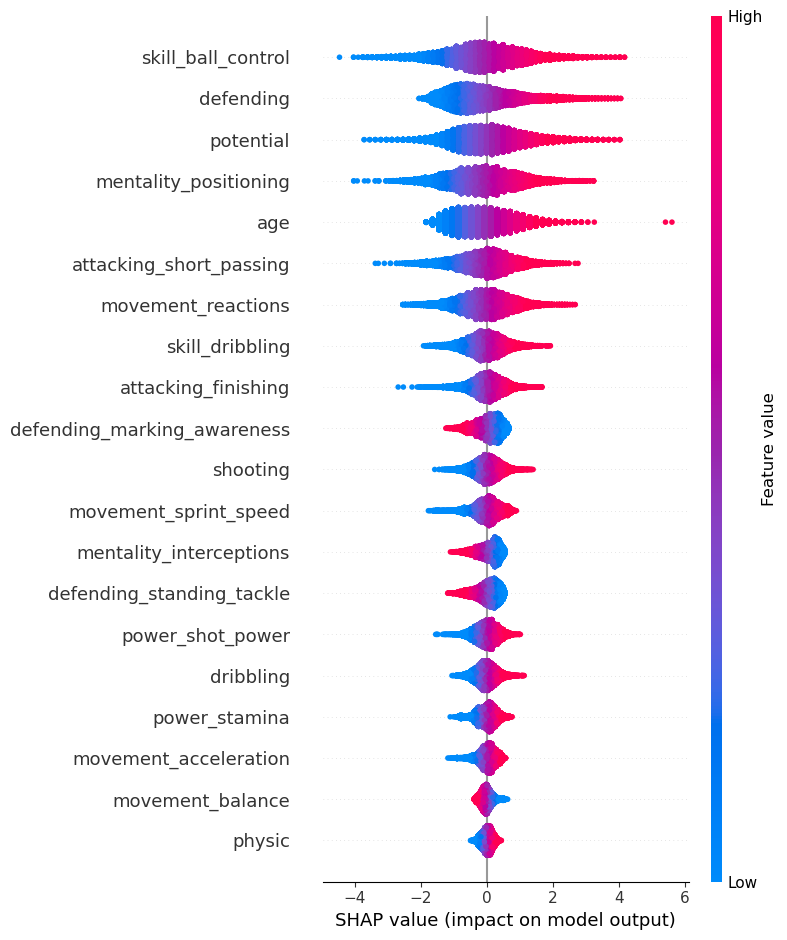

In [46]:
import shap
explainer = shap.LinearExplainer(model_attack, x_train_attack)

shap_values = explainer.shap_values(x_train_attack)

shap.summary_plot(shap_values, x_train_attack)


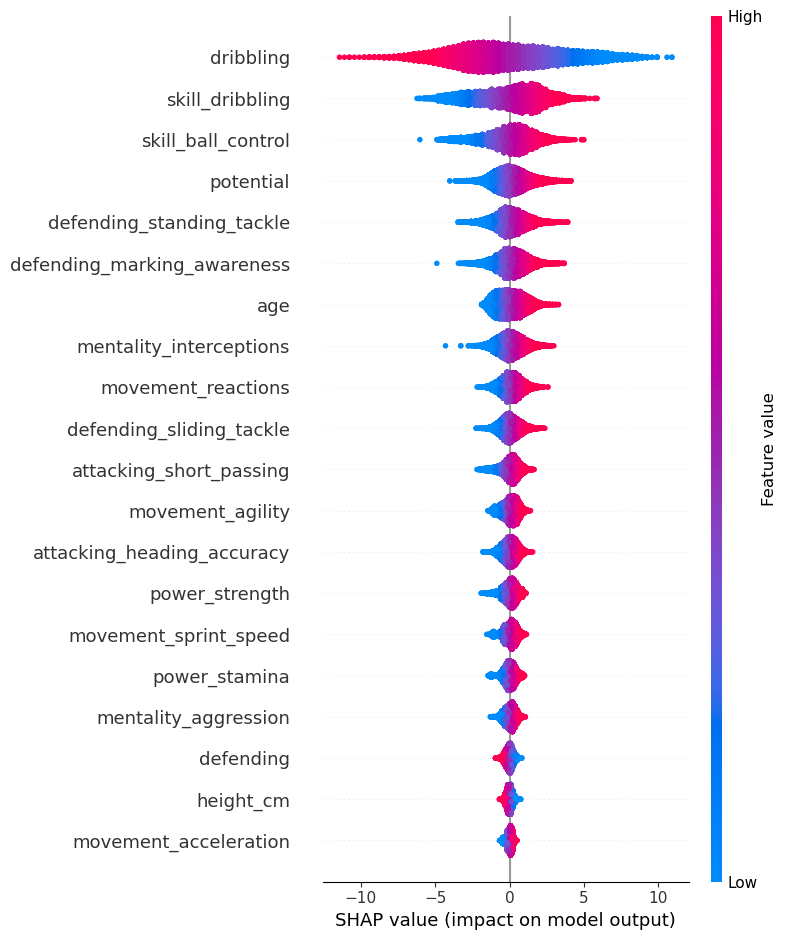

In [47]:
import shap
explainer = shap.LinearExplainer(model_defend, x_train_defend)

shap_values = explainer.shap_values(x_train_defend)

shap.summary_plot(shap_values, x_train_defend)


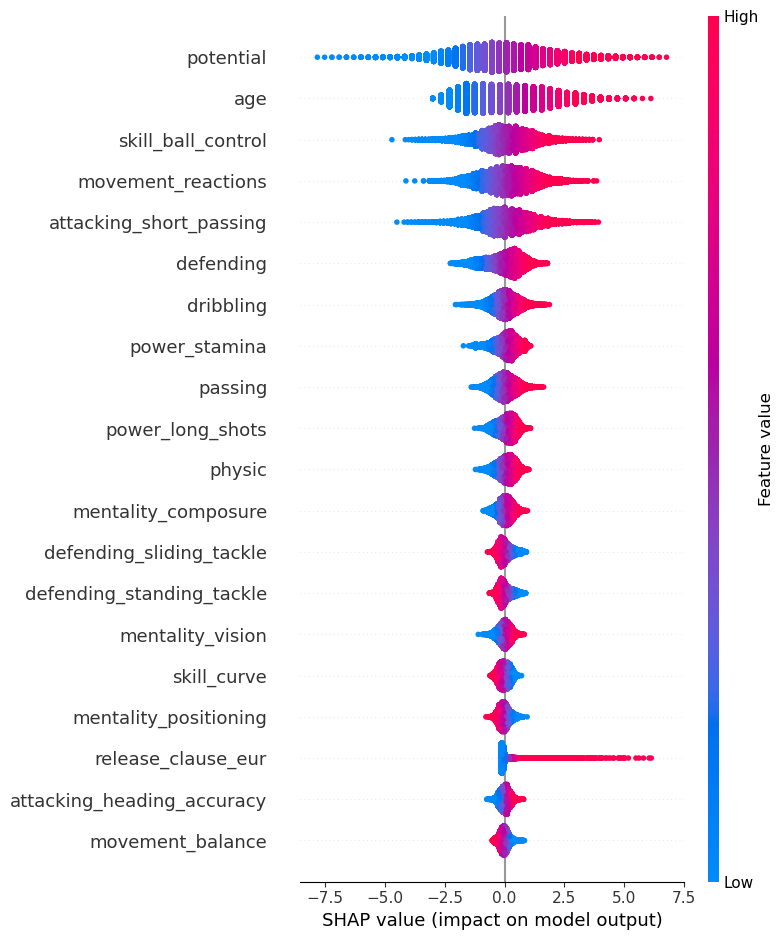

In [48]:
import shap
explainer = shap.LinearExplainer(model_mid, x_train_mid)

shap_values = explainer.shap_values(x_train_mid)

shap.summary_plot(shap_values, x_train_mid)


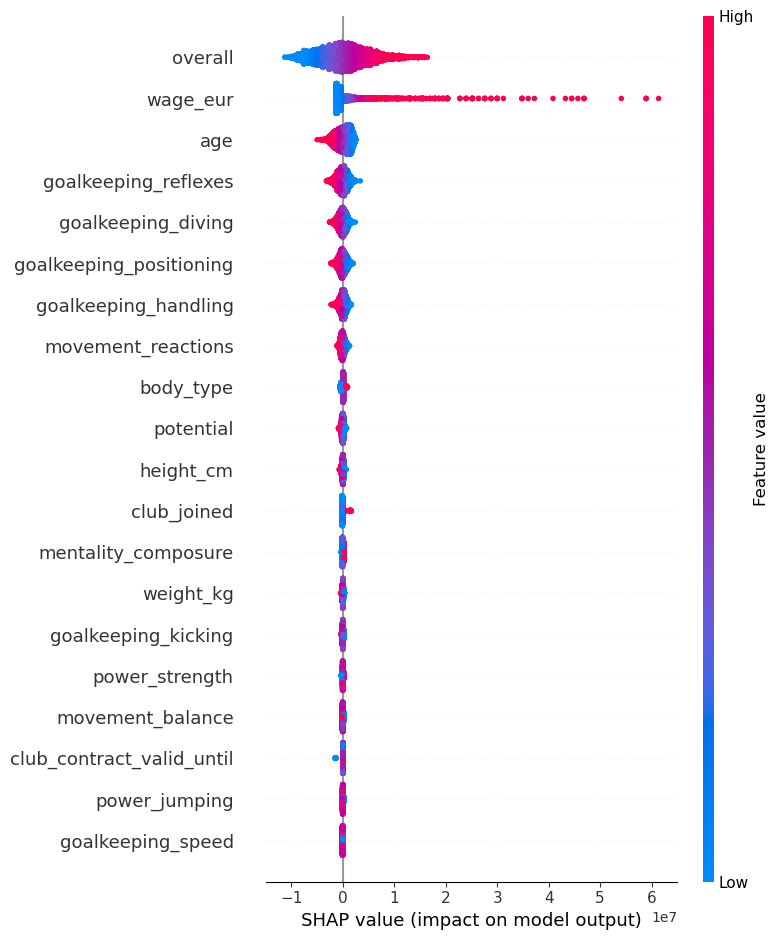

In [62]:
import shap
explainer = shap.LinearExplainer(model_gk, x_train_gk)

shap_values = explainer.shap_values(x_train_gk)

shap.summary_plot(shap_values, x_train_gk)


## Predecting value of player

In [49]:
x_train_attack,x_test_attack,y_train_attack,y_test_attack = split_scale(attack,'value_eur')
x_train_mid,x_test_mid,y_train_mid,y_test_mid = split_scale(mid,'value_eur')
x_train_defend,x_test_defend,y_train_defend,y_test_defend = split_scale(defend,'value_eur')
x_train_gk,x_test_gk,y_train_gk,y_test_gk = split_scale(goalkeeper,'value_eur')

In [56]:
model_attack = LinearRegression().fit(x_train_attack,y_train_attack)
score_attack = score(x_train_attack,y_train_attack,x_test_attack,y_test_attack,model_attack,'LinearRegression_attack')

model_mid = LinearRegression().fit(x_train_mid,y_train_mid)
score_mid = score(x_train_mid,y_train_mid,x_test_mid,y_test_mid,model_mid,'LinearRegression_mid')

model_defend = LinearRegression().fit(x_train_defend,y_train_defend)
score_defend = score(x_train_defend,y_train_defend,x_test_defend,y_test_defend,model_defend,'LinearRegression_defend')

model_gk = LinearRegression().fit(x_train_gk,y_train_gk)
score_gk = score(x_train_gk,y_train_gk,x_test_gk,y_test_gk,model_gk,'LinearRegression_gk')

lineareg_score = pd.concat([score_attack,score_mid,score_defend,score_gk],axis=0)
lineareg_score

,Train score,Test score,Mean_Absolute_Error
LinearRegression_attack,0.954774,0.936911,6.200457e+05
LinearRegression_mid,0.957002,0.954289,5.008036e+05
LinearRegression_defend,0.953033,0.944902,3.657028e+05
LinearRegression_gk,0.660349,0.697324,1.371740e+06


In [51]:
model_attack = Lasso(alpha=0.1).fit(x_train_attack,y_train_attack)
score_attack = score(x_train_attack,y_train_attack,x_test_attack,y_test_attack,model_attack,'Lasso_attack')

model_mid = Lasso(alpha=0.1).fit(x_train_mid,y_train_mid)
score_mid = score(x_train_mid,y_train_mid,x_test_mid,y_test_mid,model_mid,'Lasso_mid')

model_defend = Lasso(alpha=0.1).fit(x_train_defend,y_train_defend)
score_defend = score(x_train_defend,y_train_defend,x_test_defend,y_test_defend,model_defend,'Lasso_defend')

model_gk = Lasso(alpha=0.1).fit(x_train_gk,y_train_gk)
score_gk = score(x_train_gk,y_train_gk,x_test_gk,y_test_gk,model_gk,'Lasso_gk')

lasso_score = pd.concat([score_attack,score_mid,score_defend,score_gk],axis=0)
lasso_score

Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.632e+16, tolerance: 1.163e+14
Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.770e+16, tolerance: 8.230e+13
Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.317e+16, tolerance: 5.599e+13
Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.890e+16, tolerance: 2.291e+13


,Train score,Test score,Mean_Absolute_Error
Lasso_attack,0.954711,0.936765,6.224905e+05
Lasso_mid,0.956975,0.954132,5.072554e+05
Lasso_defend,0.952957,0.944882,3.671471e+05
Lasso_gk,0.660341,0.697335,1.369204e+06


In [52]:
model_attack = Ridge(alpha=0.1).fit(x_train_attack,y_train_attack)
score_attack = score(x_train_attack,y_train_attack,x_test_attack,y_test_attack,model_attack,'Ridge_attack')

model_mid = Ridge(alpha=0.1).fit(x_train_mid,y_train_mid)
score_mid = score(x_train_mid,y_train_mid,x_test_mid,y_test_mid,model_mid,'Ridge_mid')

model_defend = Ridge(alpha=0.1).fit(x_train_defend,y_train_defend)
score_defend = score(x_train_defend,y_train_defend,x_test_defend,y_test_defend,model_defend,'Ridge_defend')

model_gk = Ridge(alpha=0.1).fit(x_train_gk,y_train_gk)
score_gk = score(x_train_gk,y_train_gk,x_test_gk,y_test_gk,model_gk,'Ridge_gk')

ridge_score = pd.concat([score_attack,score_mid,score_defend,score_gk],axis=0)
ridge_score

,Train score,Test score,Mean_Absolute_Error
Ridge_attack,0.954774,0.936916,6.198311e+05
Ridge_mid,0.957002,0.954289,5.006772e+05
Ridge_defend,0.953033,0.944904,3.655734e+05
Ridge_gk,0.660349,0.697329,1.371003e+06


In [53]:
model_attack = XGBRegressor().fit(x_train_attack,y_train_attack)
score_attack = score(x_train_attack,y_train_attack,x_test_attack,y_test_attack,model_attack,'XGBoost_attack')

model_mid = XGBRegressor().fit(x_train_mid,y_train_mid)
score_mid = score(x_train_mid,y_train_mid,x_test_mid,y_test_mid,model_mid,'XGBoost_mid')

model_defend = XGBRegressor().fit(x_train_defend,y_train_defend)
score_defend = score(x_train_defend,y_train_defend,x_test_defend,y_test_defend,model_defend,'XGBoost_defend')

model_gk = XGBRegressor().fit(x_train_gk,y_train_gk)
score_gk = score(x_train_gk,y_train_gk,x_test_gk,y_test_gk,model_gk,'XGBoost_gk')

xgb_score = pd.concat([score_attack,score_mid,score_defend,score_gk],axis=0)
xgb_score

,Train score,Test score,Mean_Absolute_Error
XGBoost_attack,0.999379,0.958677,358215.431483
XGBoost_mid,0.999291,0.966722,368654.424568
XGBoost_defend,0.998933,0.929500,302748.429923
XGBoost_gk,0.999666,0.966507,255679.749542


In [54]:
value_score = pd.concat([lineareg_score,lasso_score,ridge_score,xgb_score],axis = 0)
value_score

,Train score,Test score,Mean_Absolute_Error
LinearRegression_attack,0.954774,0.936911,6.200457e+05
LinearRegression_mid,0.957002,0.954289,5.008036e+05
LinearRegression_defend,0.953033,0.944902,3.657028e+05
LinearRegression_gk,0.660349,0.697324,1.371740e+06
Lasso_attack,0.954711,0.936765,6.224905e+05
Lasso_mid,0.956975,0.954132,5.072554e+05
Lasso_defend,0.952957,0.944882,3.671471e+05
Lasso_gk,0.660341,0.697335,1.369204e+06
Ridge_attack,0.954774,0.936916,6.198311e+05
Ridge_mid,0.957002,0.954289,5.006772e+05


### Model interpretability

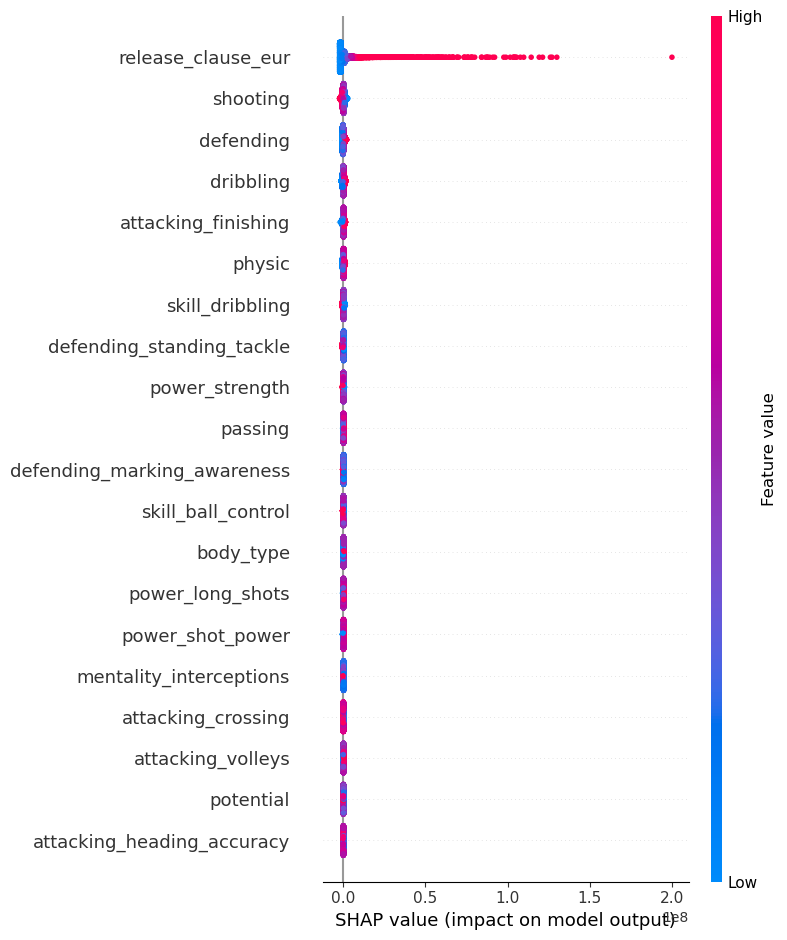

In [57]:
import shap
explainer = shap.LinearExplainer(model_attack, x_train_attack)

shap_values = explainer.shap_values(x_train_attack)

shap.summary_plot(shap_values, x_train_attack)


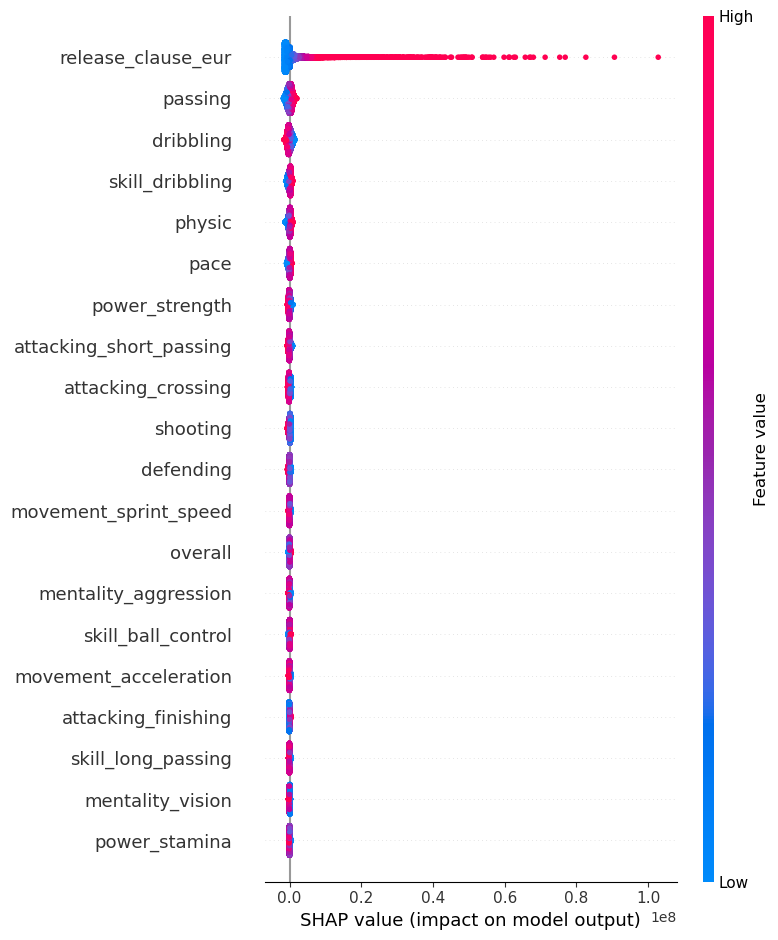

In [58]:
import shap
explainer = shap.LinearExplainer(model_defend, x_train_defend)

shap_values = explainer.shap_values(x_train_defend)

shap.summary_plot(shap_values, x_train_defend)


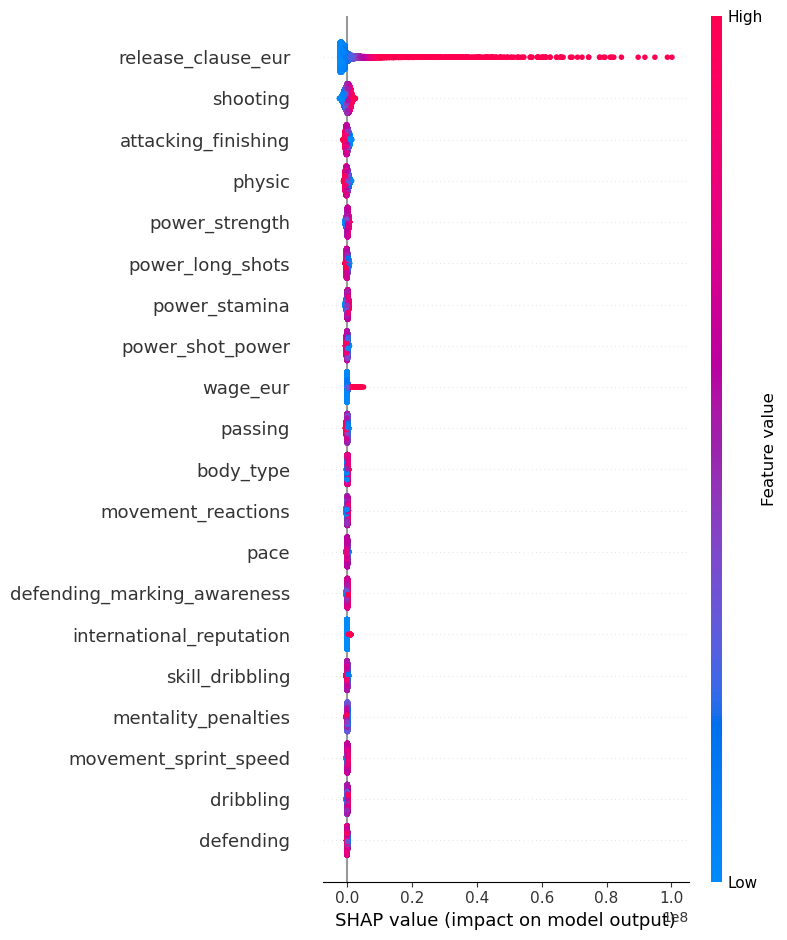

In [59]:
import shap
explainer = shap.LinearExplainer(model_mid, x_train_mid)

shap_values = explainer.shap_values(x_train_mid)

shap.summary_plot(shap_values, x_train_mid)


In [ ]:
x_train_attack,x_test_attack,y_train_attack,y_test_attack = split_scale(attack_trail,'value_eur')
x_train_mid,x_test_mid,y_train_mid,y_test_mid = split_scale(mid_trail,'value_eur')
x_train_defend,x_test_defend,y_train_defend,y_test_defend = split_scale(defend_trail,'value_eur')
x_train_gk,x_test_gk,y_train_gk,y_test_gk = split_scale(goalkeeper_trail,'value_eur')

In [ ]:
model_attack = LinearRegression().fit(x_train_attack,y_train_attack)
score_attack = score(x_train_attack,y_train_attack,x_test_attack,y_test_attack,model_attack,'LinearRegression_attack')

model_mid = LinearRegression().fit(x_train_mid,y_train_mid)
score_mid = score(x_train_mid,y_train_mid,x_test_mid,y_test_mid,model_mid,'LinearRegression_mid')

model_defend = LinearRegression().fit(x_train_defend,y_train_defend)
score_defend = score(x_train_defend,y_train_defend,x_test_defend,y_test_defend,model_defend,'LinearRegression_defend')

model_gk = LinearRegression().fit(x_train_gk,y_train_gk)
score_gk = score(x_train_gk,y_train_gk,x_test_gk,y_test_gk,model_gk,'LinearRegression_gk')

lineareg_score = pd.concat([score_attack,score_mid,score_defend,score_gk],axis=0)
lineareg_score

,Train score,Test score,Mean_Absolute_Error
LinearRegression_attack,0.954744,0.936439,6.170772e+05
LinearRegression_mid,0.956983,0.954250,5.009653e+05
LinearRegression_defend,0.952995,0.945025,3.643605e+05
LinearRegression_gk,0.659259,0.696468,1.364219e+06


In [ ]:
model_attack = Lasso(alpha=0.1).fit(x_train_attack,y_train_attack)
score_attack = score(x_train_attack,y_train_attack,x_test_attack,y_test_attack,model_attack,'Lasso_attack')

model_mid = Lasso(alpha=0.1).fit(x_train_mid,y_train_mid)
score_mid = score(x_train_mid,y_train_mid,x_test_mid,y_test_mid,model_mid,'Lasso_mid')

model_defend = Lasso(alpha=0.1).fit(x_train_defend,y_train_defend)
score_defend = score(x_train_defend,y_train_defend,x_test_defend,y_test_defend,model_defend,'Lasso_defend')

model_gk = Lasso(alpha=0.1).fit(x_train_gk,y_train_gk)
score_gk = score(x_train_gk,y_train_gk,x_test_gk,y_test_gk,model_gk,'Lasso_gk')

lasso_score = pd.concat([score_attack,score_mid,score_defend,score_gk],axis=0)
lasso_score

,Train score,Test score,Mean_Absolute_Error
Lasso_attack,0.954744,0.936639,6.140645e+05
Lasso_mid,0.956982,0.954263,4.987424e+05
Lasso_defend,0.952995,0.945029,3.641443e+05
Lasso_gk,0.659251,0.696485,1.361645e+06


In [ ]:
model_attack = Ridge(alpha=0.1).fit(x_train_attack,y_train_attack)
score_attack = score(x_train_attack,y_train_attack,x_test_attack,y_test_attack,model_attack,'Ridge_attack')

model_mid = Ridge(alpha=0.1).fit(x_train_mid,y_train_mid)
score_mid = score(x_train_mid,y_train_mid,x_test_mid,y_test_mid,model_mid,'Ridge_mid')

model_defend = Ridge(alpha=0.1).fit(x_train_defend,y_train_defend)
score_defend = score(x_train_defend,y_train_defend,x_test_defend,y_test_defend,model_defend,'Ridge_defend')

model_gk = Ridge(alpha=0.1).fit(x_train_gk,y_train_gk)
score_gk = score(x_train_gk,y_train_gk,x_test_gk,y_test_gk,model_gk,'Ridge_gk')

ridge_score = pd.concat([score_attack,score_mid,score_defend,score_gk],axis=0)
ridge_score

,Train score,Test score,Mean_Absolute_Error
Ridge_attack,0.954744,0.936449,6.169283e+05
Ridge_mid,0.956983,0.954251,5.008539e+05
Ridge_defend,0.952995,0.945025,3.643507e+05
Ridge_gk,0.659258,0.696474,1.363491e+06


In [ ]:
model_attack = XGBRegressor().fit(x_train_attack,y_train_attack)
score_attack = score(x_train_attack,y_train_attack,x_test_attack,y_test_attack,model_attack,'XGBoost_attack')

model_mid = XGBRegressor().fit(x_train_mid,y_train_mid)
score_mid = score(x_train_mid,y_train_mid,x_test_mid,y_test_mid,model_mid,'XGBoost_mid')

model_defend = XGBRegressor().fit(x_train_defend,y_train_defend)
score_defend = score(x_train_defend,y_train_defend,x_test_defend,y_test_defend,model_defend,'XGBoost_defend')

model_gk = XGBRegressor().fit(x_train_gk,y_train_gk)
score_gk = score(x_train_gk,y_train_gk,x_test_gk,y_test_gk,model_gk,'XGBoost_gk')

xgb_score = pd.concat([score_attack,score_mid,score_defend,score_gk],axis=0)
xgb_score

,Train score,Test score,Mean_Absolute_Error
XGBoost_attack,0.999367,0.962554,360869.949933
XGBoost_mid,0.999337,0.961676,375019.974536
XGBoost_defend,0.998944,0.933845,300446.332255
XGBoost_gk,0.999658,0.963927,258745.990253


## Potential

In [ ]:
x_train_attack,x_test_attack,y_train_attack,y_test_attack = split_scale(attack_trail,'potential')
x_train_mid,x_test_mid,y_train_mid,y_test_mid = split_scale(mid_trail,'potential')
x_train_defend,x_test_defend,y_train_defend,y_test_defend = split_scale(defend_trail,'potential')
x_train_gk,x_test_gk,y_train_gk,y_test_gk = split_scale(goalkeeper_trail,'potential')

In [67]:
model_attack = LinearRegression().fit(x_train_attack,y_train_attack)
score_attack = score(x_train_attack,y_train_attack,x_test_attack,y_test_attack,model_attack,'LinearRegression_attack')

model_mid = LinearRegression().fit(x_train_mid,y_train_mid)
score_mid = score(x_train_mid,y_train_mid,x_test_mid,y_test_mid,model_mid,'LinearRegression_mid')

model_defend = LinearRegression().fit(x_train_defend,y_train_defend)
score_defend = score(x_train_defend,y_train_defend,x_test_defend,y_test_defend,model_defend,'LinearRegression_defend')

model_gk = LinearRegression().fit(x_train_gk,y_train_gk)
score_gk = score(x_train_gk,y_train_gk,x_test_gk,y_test_gk,model_gk,'LinearRegression_gk')

lineareg_score = pd.concat([score_attack,score_mid,score_defend,score_gk],axis=0)
lineareg_score

,Train score,Test score,Mean_Absolute_Error
LinearRegression_attack,0.954774,0.936911,6.200457e+05
LinearRegression_mid,0.957002,0.954289,5.008036e+05
LinearRegression_defend,0.953033,0.944902,3.657028e+05
LinearRegression_gk,0.660349,0.697324,1.371740e+06


In [68]:
model_attack = Lasso(alpha=0.1).fit(x_train_attack,y_train_attack)
score_attack = score(x_train_attack,y_train_attack,x_test_attack,y_test_attack,model_attack,'Lasso_attack')

model_mid = Lasso(alpha=0.1).fit(x_train_mid,y_train_mid)
score_mid = score(x_train_mid,y_train_mid,x_test_mid,y_test_mid,model_mid,'Lasso_mid')

model_defend = Lasso(alpha=0.1).fit(x_train_defend,y_train_defend)
score_defend = score(x_train_defend,y_train_defend,x_test_defend,y_test_defend,model_defend,'Lasso_defend')

model_gk = Lasso(alpha=0.1).fit(x_train_gk,y_train_gk)
score_gk = score(x_train_gk,y_train_gk,x_test_gk,y_test_gk,model_gk,'Lasso_gk')

lasso_score = pd.concat([score_attack,score_mid,score_defend,score_gk],axis=0)
lasso_score

Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 2.632e+16, tolerance: 1.163e+14
Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.770e+16, tolerance: 8.230e+13
Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 1.317e+16, tolerance: 5.599e+13
Objective did not converge. You might want to increase the number of iterations, check the scale of the features or consider increasing regularisation. Duality gap: 3.890e+16, tolerance: 2.291e+13


,Train score,Test score,Mean_Absolute_Error
Lasso_attack,0.954711,0.936765,6.224905e+05
Lasso_mid,0.956975,0.954132,5.072554e+05
Lasso_defend,0.952957,0.944882,3.671471e+05
Lasso_gk,0.660341,0.697335,1.369204e+06


In [69]:
model_attack = Ridge(alpha=0.1).fit(x_train_attack,y_train_attack)
score_attack = score(x_train_attack,y_train_attack,x_test_attack,y_test_attack,model_attack,'Ridge_attack')

model_mid = Ridge(alpha=0.1).fit(x_train_mid,y_train_mid)
score_mid = score(x_train_mid,y_train_mid,x_test_mid,y_test_mid,model_mid,'Ridge_mid')

model_defend = Ridge(alpha=0.1).fit(x_train_defend,y_train_defend)
score_defend = score(x_train_defend,y_train_defend,x_test_defend,y_test_defend,model_defend,'Ridge_defend')

model_gk = Ridge(alpha=0.1).fit(x_train_gk,y_train_gk)
score_gk = score(x_train_gk,y_train_gk,x_test_gk,y_test_gk,model_gk,'Ridge_gk')

ridge_score = pd.concat([score_attack,score_mid,score_defend,score_gk],axis=0)
ridge_score

,Train score,Test score,Mean_Absolute_Error
Ridge_attack,0.954774,0.936916,6.198311e+05
Ridge_mid,0.957002,0.954289,5.006772e+05
Ridge_defend,0.953033,0.944904,3.655734e+05
Ridge_gk,0.660349,0.697329,1.371003e+06


In [70]:
model_attack = XGBRegressor().fit(x_train_attack,y_train_attack)
score_attack = score(x_train_attack,y_train_attack,x_test_attack,y_test_attack,model_attack,'XGBoost_attack')

model_mid = XGBRegressor().fit(x_train_mid,y_train_mid)
score_mid = score(x_train_mid,y_train_mid,x_test_mid,y_test_mid,model_mid,'XGBoost_mid')

model_defend = XGBRegressor().fit(x_train_defend,y_train_defend)
score_defend = score(x_train_defend,y_train_defend,x_test_defend,y_test_defend,model_defend,'XGBoost_defend')

model_gk = XGBRegressor().fit(x_train_gk,y_train_gk)
score_gk = score(x_train_gk,y_train_gk,x_test_gk,y_test_gk,model_gk,'XGBoost_gk')

xgb_score = pd.concat([score_attack,score_mid,score_defend,score_gk],axis=0)
xgb_score

,Train score,Test score,Mean_Absolute_Error
XGBoost_attack,0.999379,0.958677,358215.431483
XGBoost_mid,0.999291,0.966722,368654.424568
XGBoost_defend,0.998933,0.929500,302748.429923
XGBoost_gk,0.999666,0.966507,255679.749542


In [71]:
pot_score = pd.concat([lineareg_score,lasso_score,ridge_score,xgb_score],axis = 0)
pot_score

,Train score,Test score,Mean_Absolute_Error
LinearRegression_attack,0.954774,0.936911,6.200457e+05
LinearRegression_mid,0.957002,0.954289,5.008036e+05
LinearRegression_defend,0.953033,0.944902,3.657028e+05
LinearRegression_gk,0.660349,0.697324,1.371740e+06
Lasso_attack,0.954711,0.936765,6.224905e+05
Lasso_mid,0.956975,0.954132,5.072554e+05
Lasso_defend,0.952957,0.944882,3.671471e+05
Lasso_gk,0.660341,0.697335,1.369204e+06
Ridge_attack,0.954774,0.936916,6.198311e+05
Ridge_mid,0.957002,0.954289,5.006772e+05


### Model interpretability

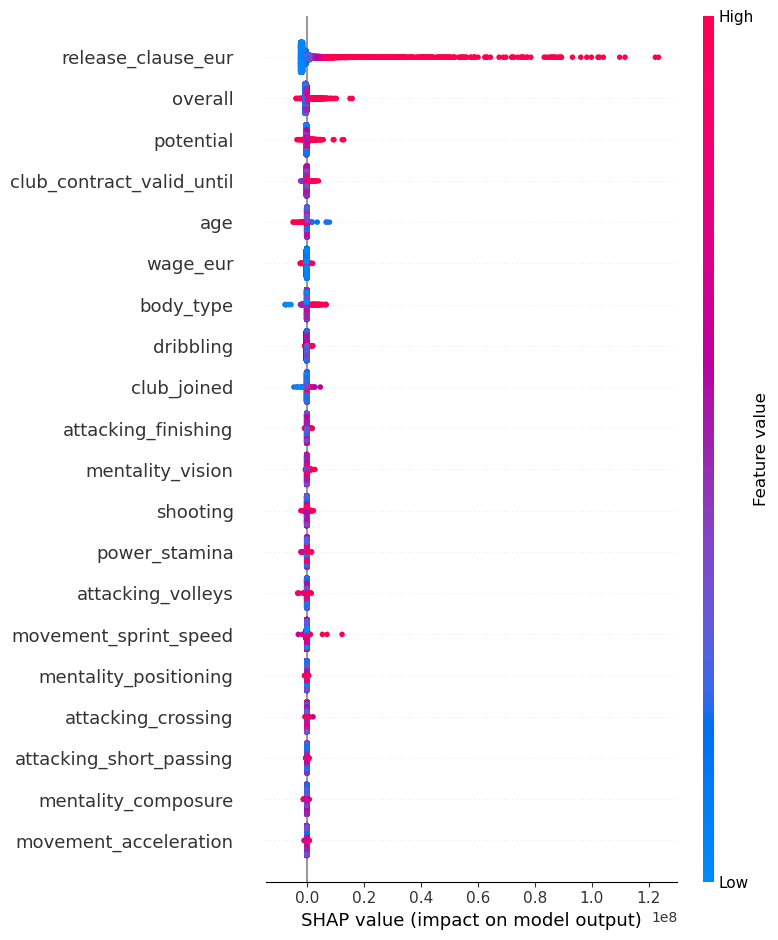

In [73]:
import shap
explainer = shap.TreeExplainer(model_attack)

shap_values = explainer.shap_values(x_train_attack)

shap.summary_plot(shap_values, x_train_attack)


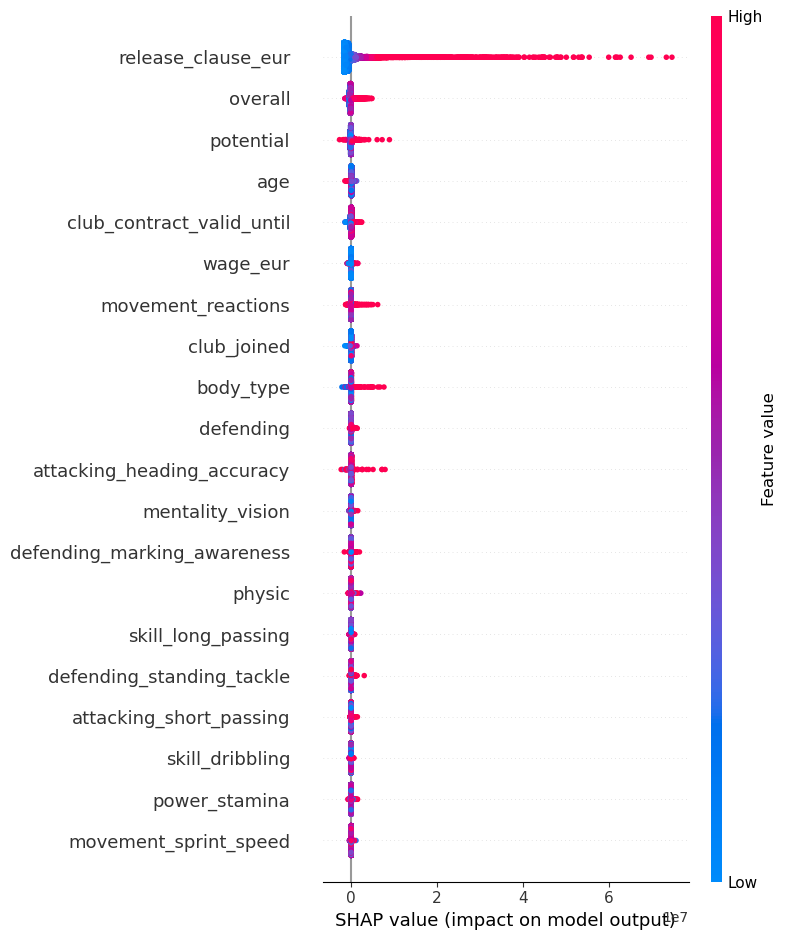

In [74]:
import shap
explainer = shap.TreeExplainer(model_defend)

shap_values = explainer.shap_values(x_train_defend)

shap.summary_plot(shap_values, x_train_defend)


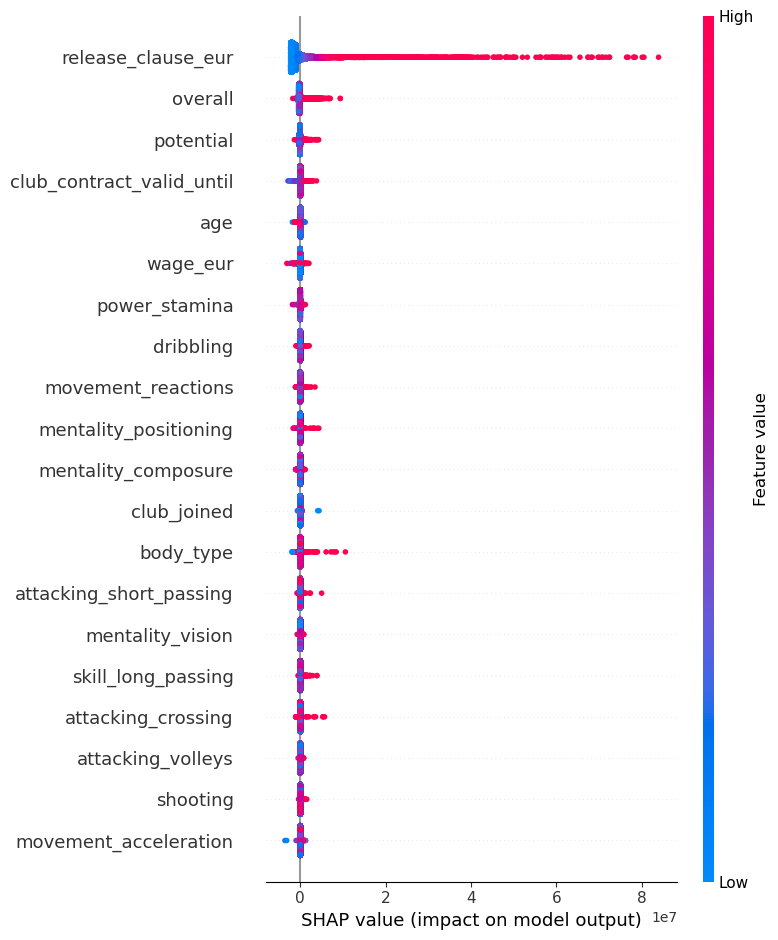

In [75]:
import shap
explainer = shap.TreeExplainer(model_mid)

shap_values = explainer.shap_values(x_train_mid)

shap.summary_plot(shap_values, x_train_mid)


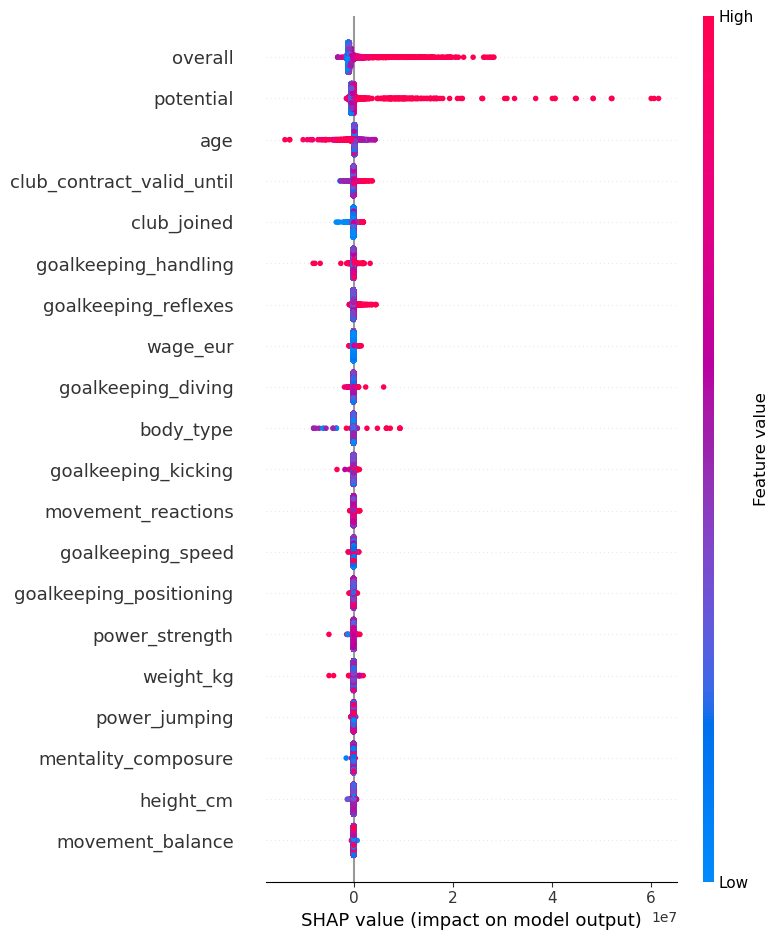

In [76]:
import shap
explainer = shap.TreeExplainer(model_gk)

shap_values = explainer.shap_values(x_train_gk)

shap.summary_plot(shap_values, x_train_gk)


## Time Series

In [ ]:
from prophet import Prophet
from statsmodels.tsa.stattools import adfuller
from statsmodels.tsa.seasonal import seasonal_decompose
from statsmodels.tsa.stattools import acf, pacf
from statsmodels.graphics.tsaplots import plot_pacf,plot_acf
from statsmodels.tsa.arima.model import ARIMA

### Overall forecasting

In [ ]:
attack_time = Trial_df[Trial_df['position'].isin( attackpos)][['overall','Year','short_name']]
mid_time =  Trial_df[Trial_df['position'].isin( midpos)][['Year','overall','short_name']]
defend_time =  Trial_df[Trial_df['position'].isin( defendpos)][['overall','Year','short_name']]
gk_time = Trial_df[Trial_df['position'] == 'GK'][['overall','Year','short_name']]

In [ ]:
def plot(df):
    fig = plt.figure(figsize=(15, 10))
    columns = 2
    rows = 5

    df['Year'] = pd.to_datetime(df['Year'],format='%Y')

    name = df['short_name'].unique()[0:50]

    st_idx = 0  
    end_idx = 5  
    pos = 1
    for i in range(1, 10):

        players_subset = name[st_idx:end_idx]

        for j in players_subset:
            plt.subplot(rows, columns, pos)
            player_data_filtered = df[df['short_name'] == j]
            plt.plot(player_data_filtered['Year'],player_data_filtered['overall'], label=j)
            plt.legend()    

        pos += 1

        st_idx += 5 
        end_idx += 5  

    plt.tight_layout()
    plt.show()


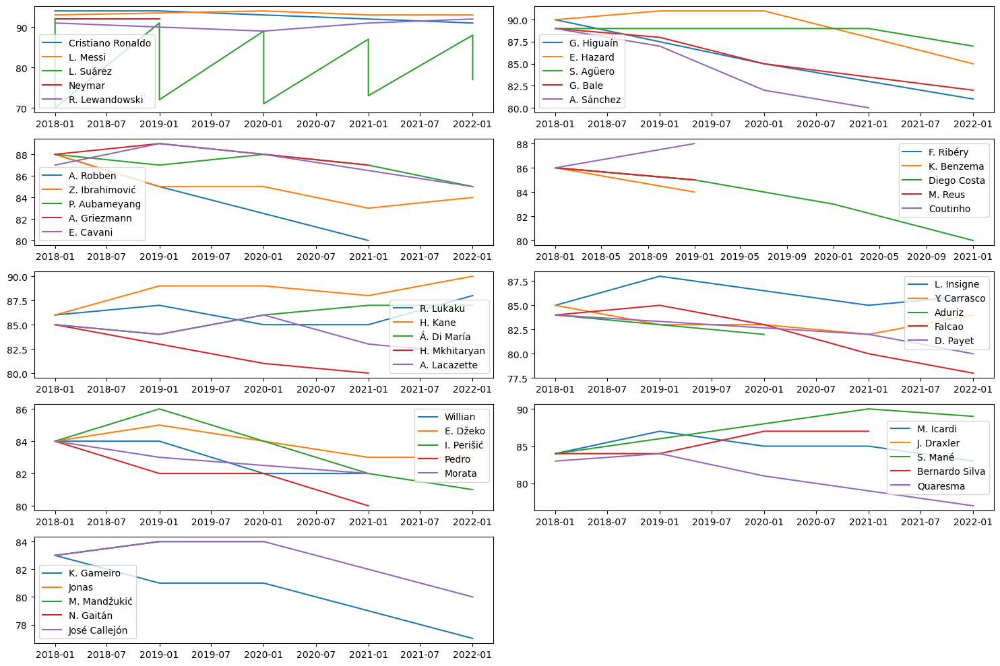

In [ ]:
plot(attack_time)

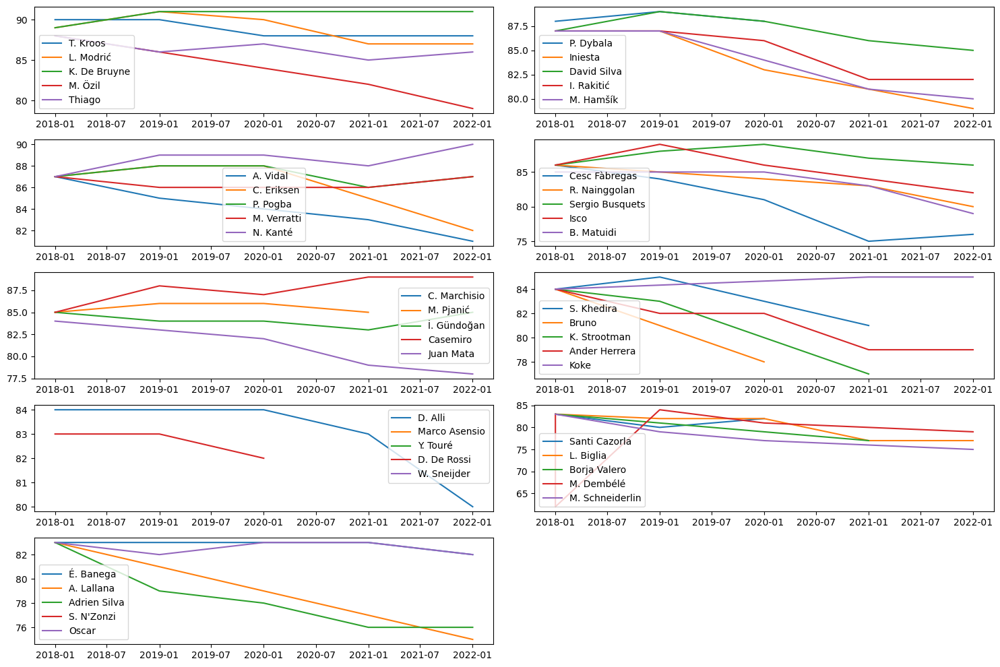

In [ ]:
plot(mid_time)

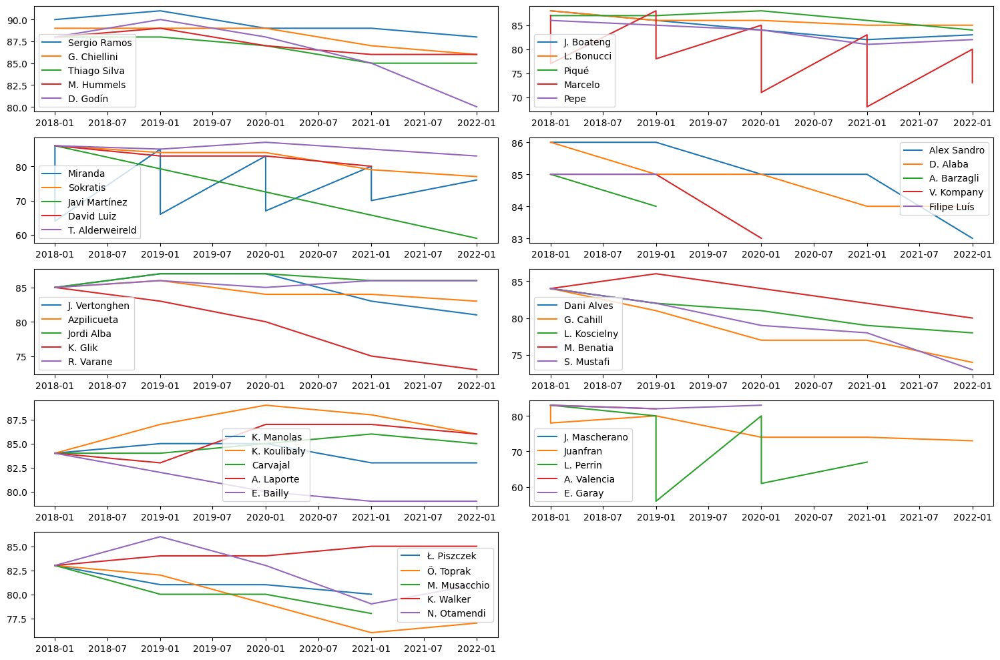

In [ ]:
plot(defend_time)

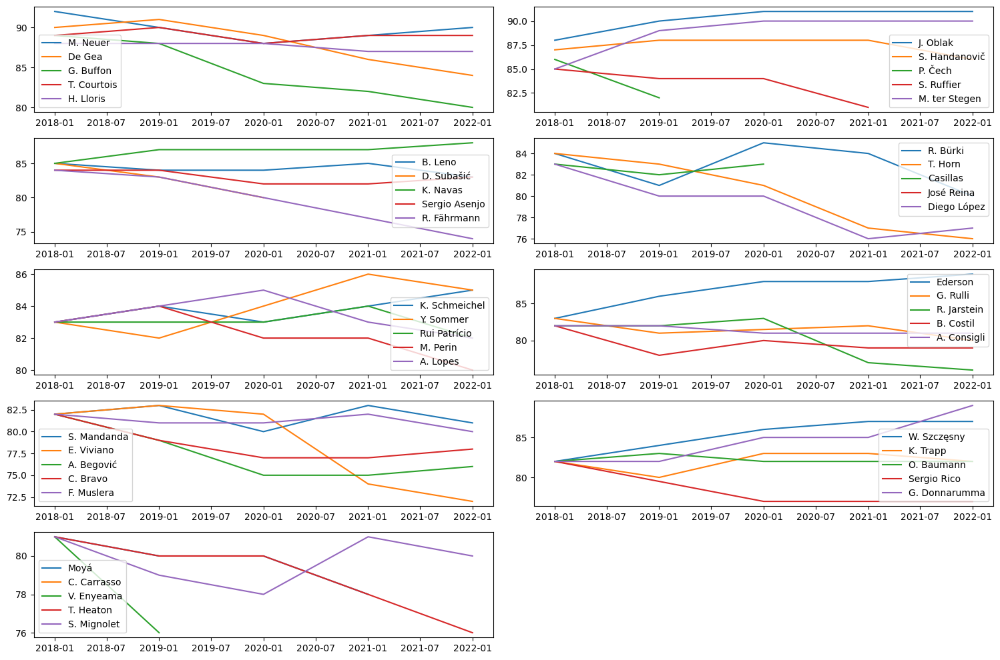

In [ ]:
plot(gk_time)

## Prophet model

### Overall Forecasting

In [ ]:
def time_series_overall(df):
    names = df[df['Year'] == 2022]['short_name'].unique()[:10]
    df['Year'] = pd.to_datetime(df['Year'],format='%Y')
    pos = 1
    err = []
    for i in names:
        df_t = df[df['short_name'] == i][['overall','Year']]
        df_t.columns = ['y', 'ds']
        df_t['cap'] = 95
        model = Prophet(growth='logistic')
        model.fit(df_t)
        val = model.predict(df_t)
        err.append(mean_absolute_error(df_t['y'],val['yhat']))
        future = model.make_future_dataframe(periods=2,freq='Y')
        future['cap'] = 95
        forecast = model.predict(future)
        forecast['cap'] = 95
        model.plot(forecast)
        plt.legend(labels = [i])
        plt.show()
    return pd.DataFrame({'Mean absolute error': err})

14:12:53 - cmdstanpy - INFO - Chain [1] start processing
14:13:03 - cmdstanpy - INFO - Chain [1] done processing


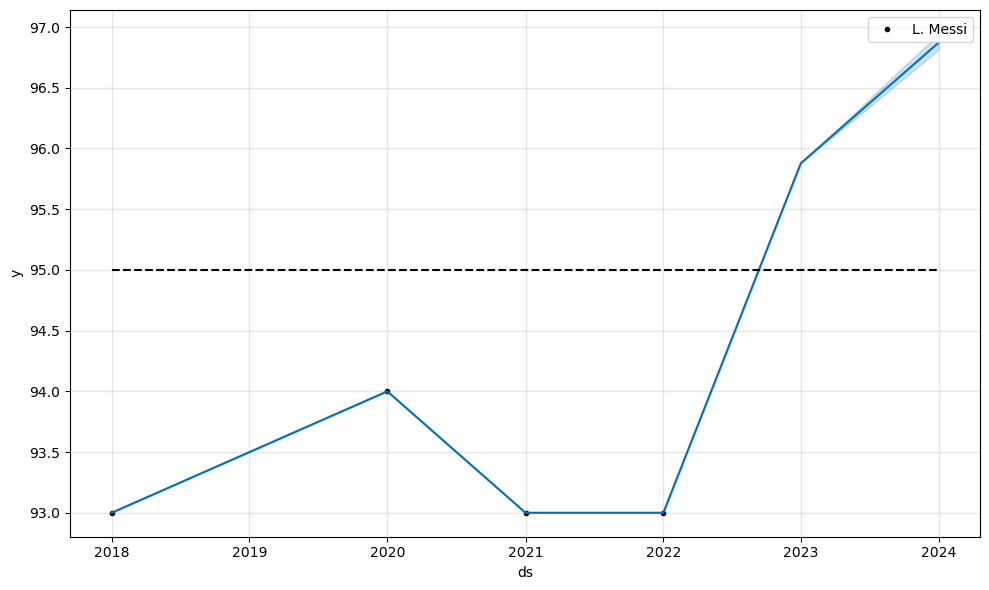

14:13:05 - cmdstanpy - INFO - Chain [1] start processing
14:13:23 - cmdstanpy - INFO - Chain [1] done processing


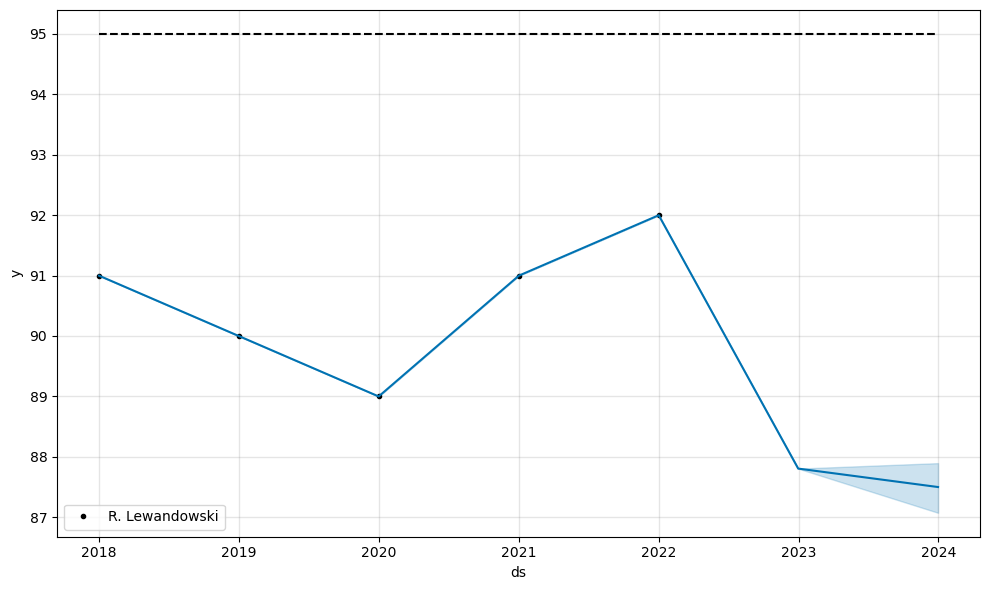

14:13:24 - cmdstanpy - INFO - Chain [1] start processing
14:13:38 - cmdstanpy - INFO - Chain [1] done processing


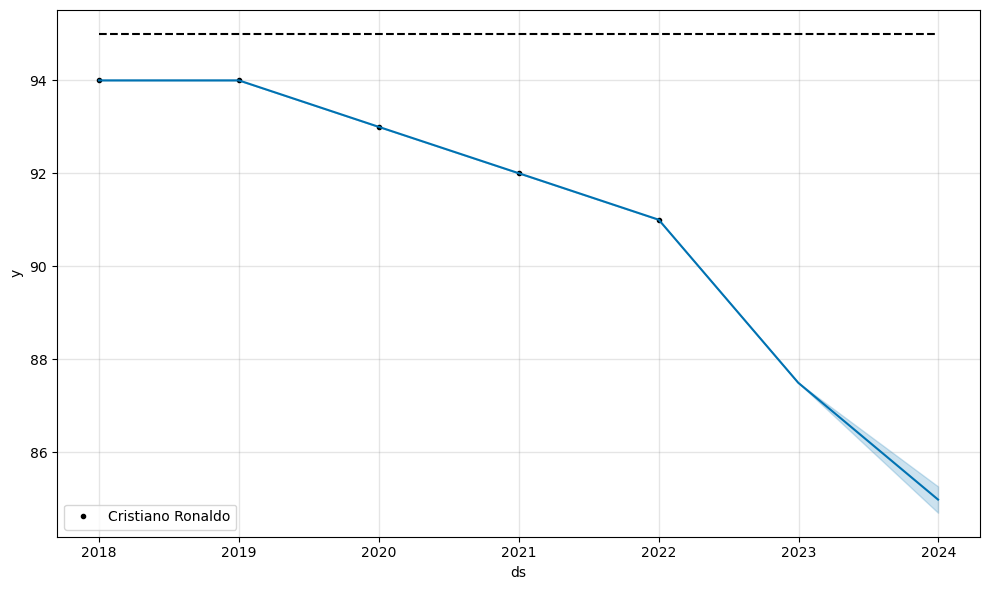

14:13:38 - cmdstanpy - INFO - Chain [1] start processing
14:13:49 - cmdstanpy - INFO - Chain [1] done processing


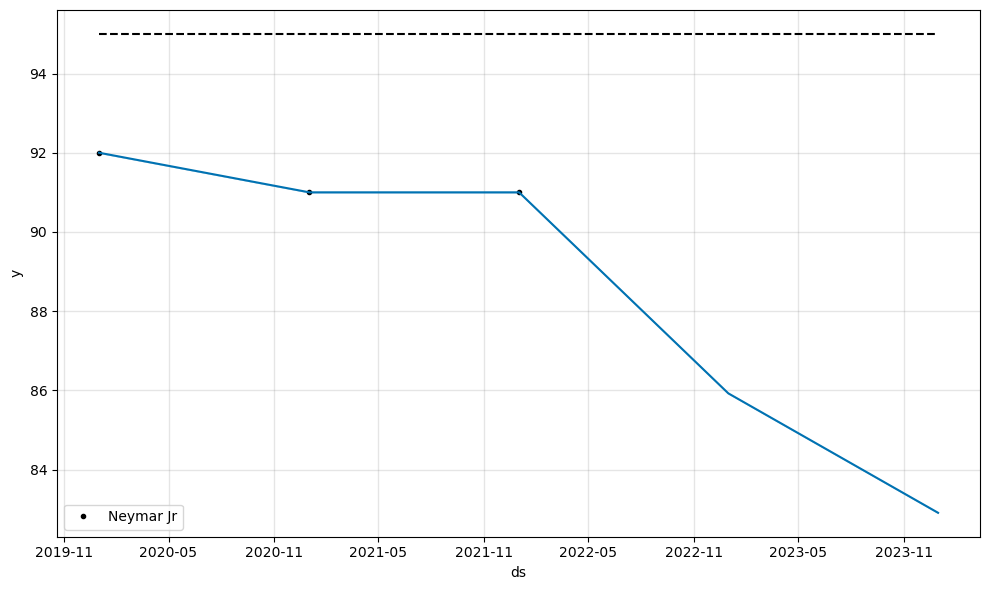

14:13:50 - cmdstanpy - INFO - Chain [1] start processing
14:13:50 - cmdstanpy - INFO - Chain [1] done processing


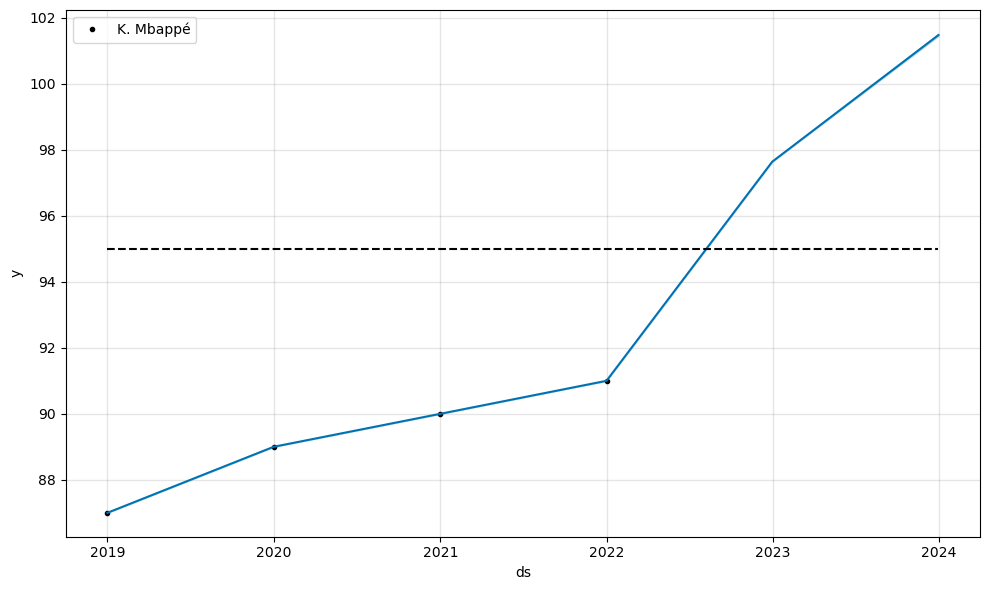

14:13:51 - cmdstanpy - INFO - Chain [1] start processing
14:13:51 - cmdstanpy - INFO - Chain [1] done processing


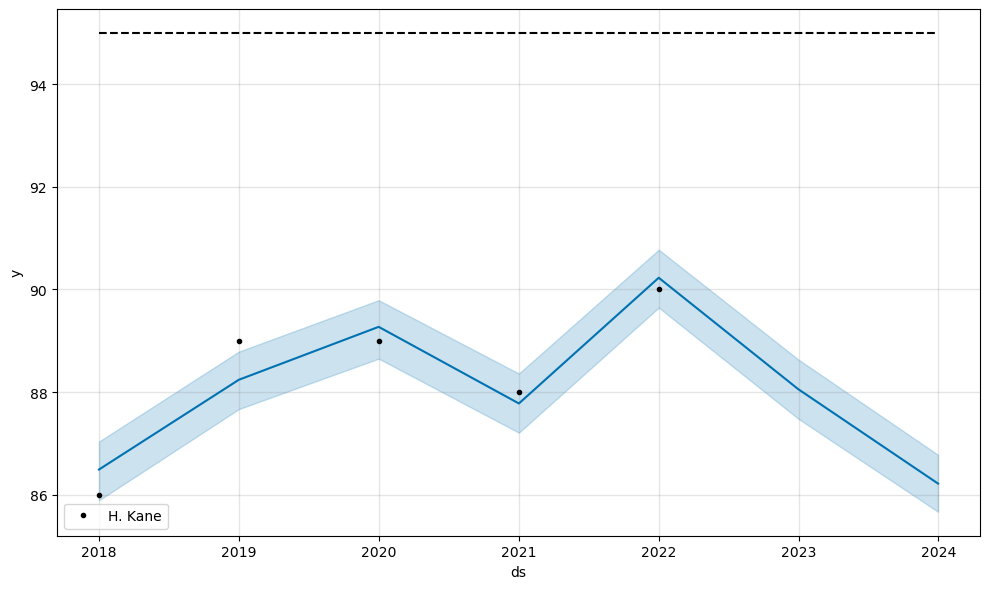

14:13:52 - cmdstanpy - INFO - Chain [1] start processing
14:13:52 - cmdstanpy - INFO - Chain [1] done processing


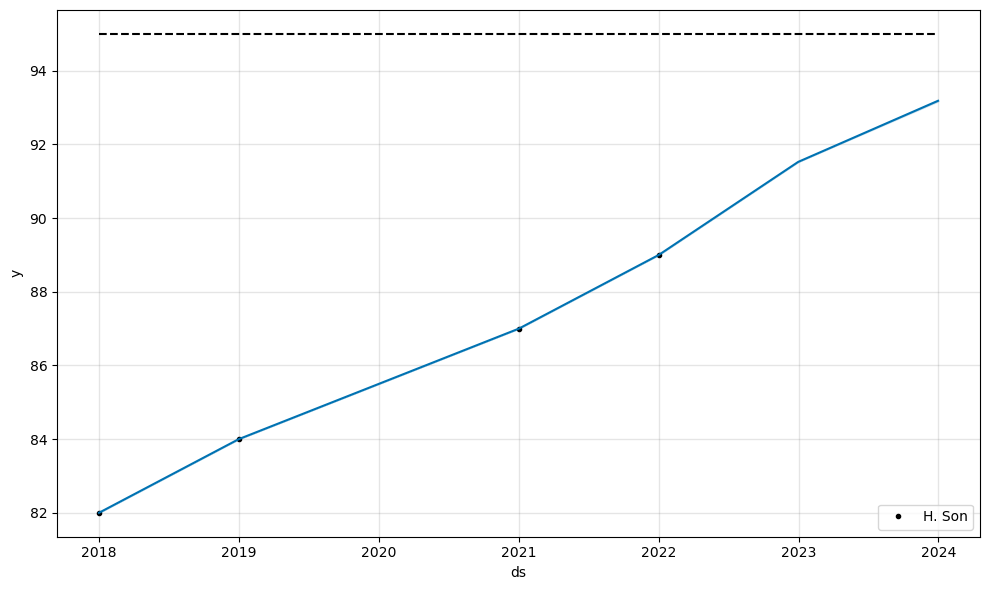

14:13:53 - cmdstanpy - INFO - Chain [1] start processing
14:13:53 - cmdstanpy - INFO - Chain [1] done processing


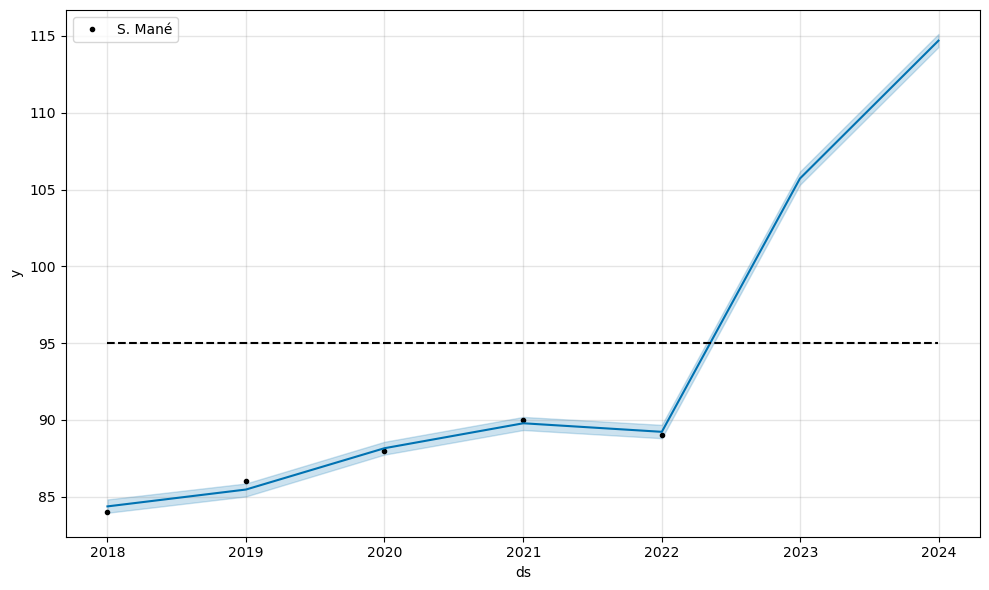

14:13:54 - cmdstanpy - INFO - Chain [1] start processing
14:13:54 - cmdstanpy - INFO - Chain [1] done processing


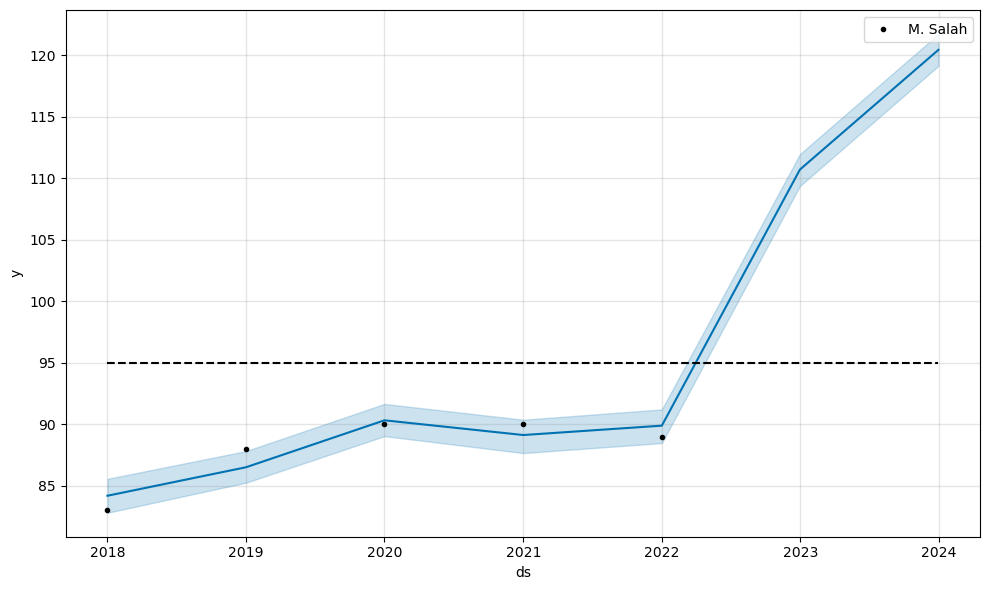

14:13:54 - cmdstanpy - INFO - Chain [1] start processing
14:13:54 - cmdstanpy - INFO - Chain [1] done processing


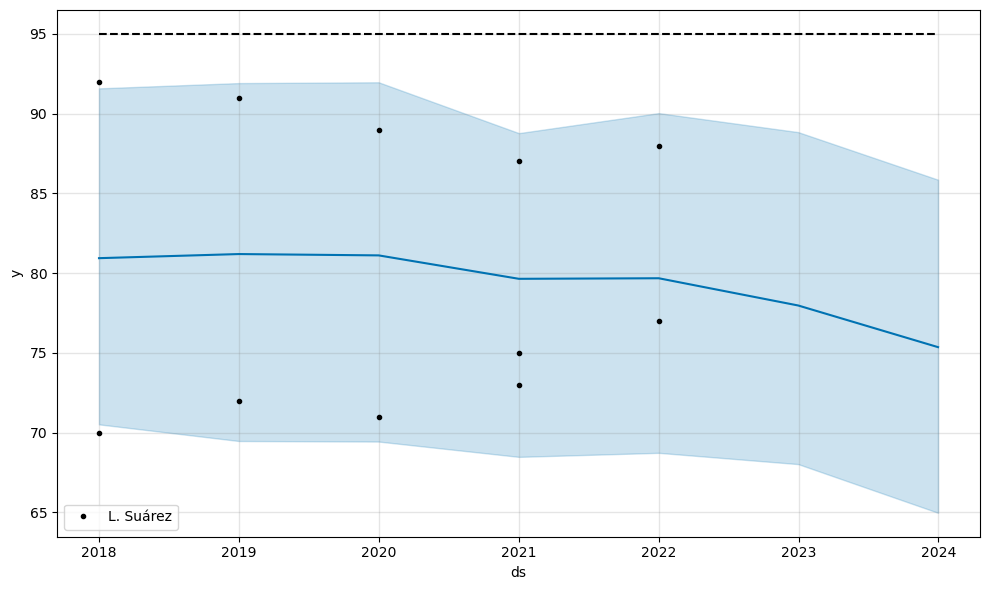

In [ ]:
err_attack = time_series_overall(attack_time)

In [ ]:
err_attack

,Mean absolute error
0,0.000020
1,0.001435
2,0.000469
3,0.000597
4,0.001389
5,0.394262
6,0.000070
7,0.300686
8,0.953517
9,8.058234


14:13:55 - cmdstanpy - INFO - Chain [1] start processing


14:13:55 - cmdstanpy - INFO - Chain [1] done processing


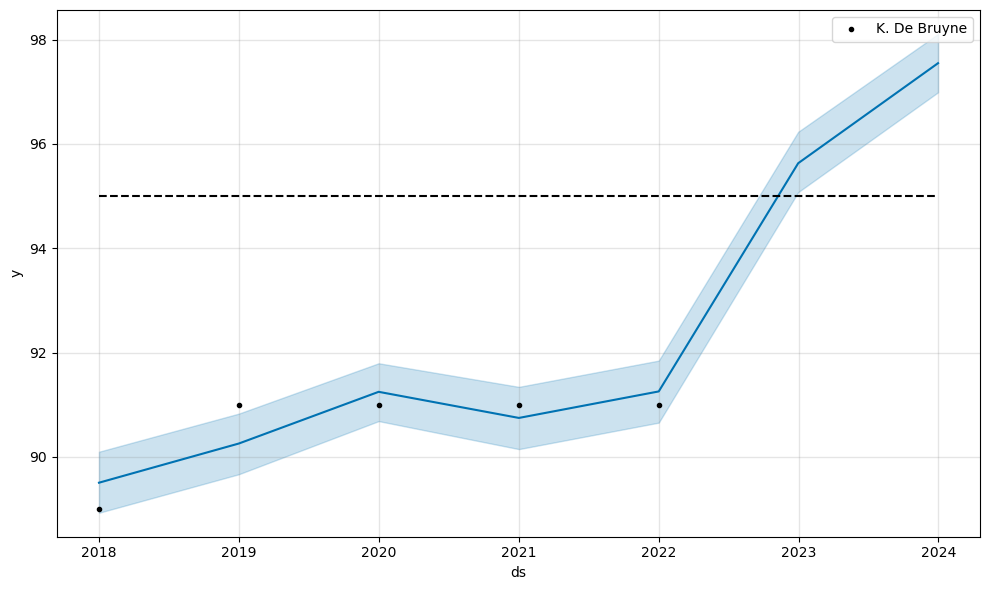

14:13:57 - cmdstanpy - INFO - Chain [1] start processing
14:14:17 - cmdstanpy - INFO - Chain [1] done processing


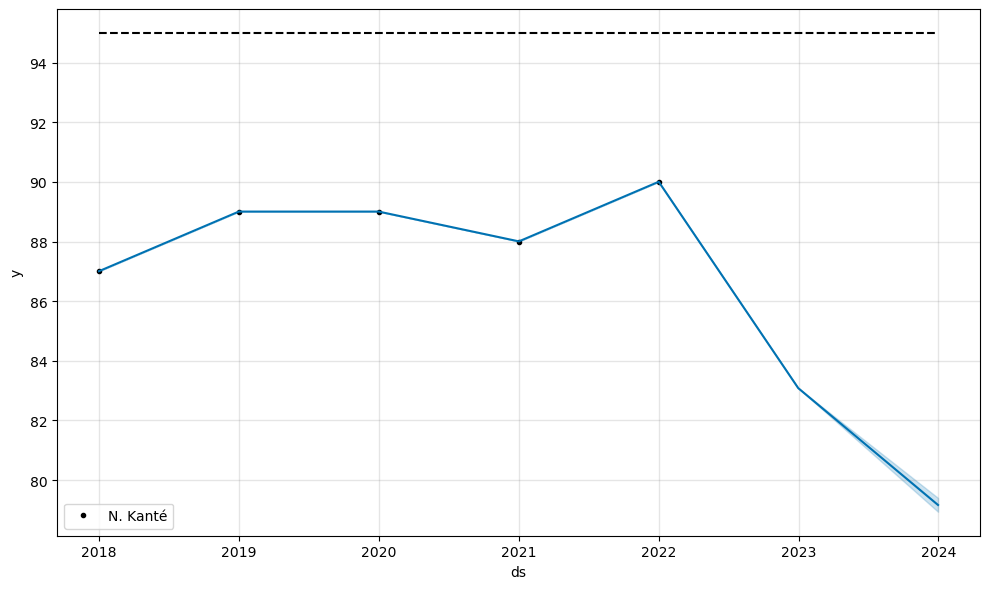

14:14:19 - cmdstanpy - INFO - Chain [1] start processing
14:14:19 - cmdstanpy - INFO - Chain [1] done processing


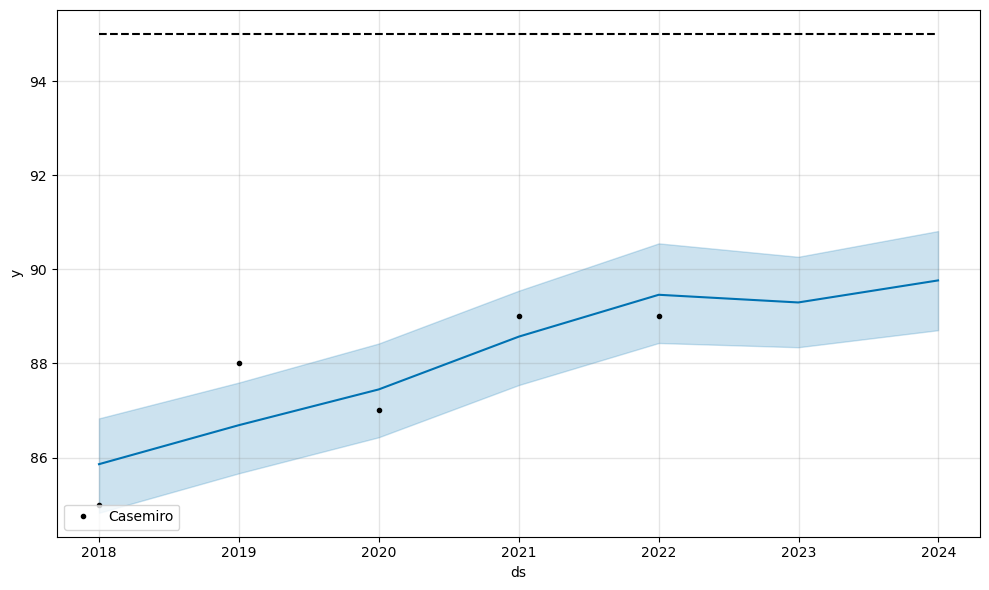

14:14:21 - cmdstanpy - INFO - Chain [1] start processing
14:14:21 - cmdstanpy - INFO - Chain [1] done processing


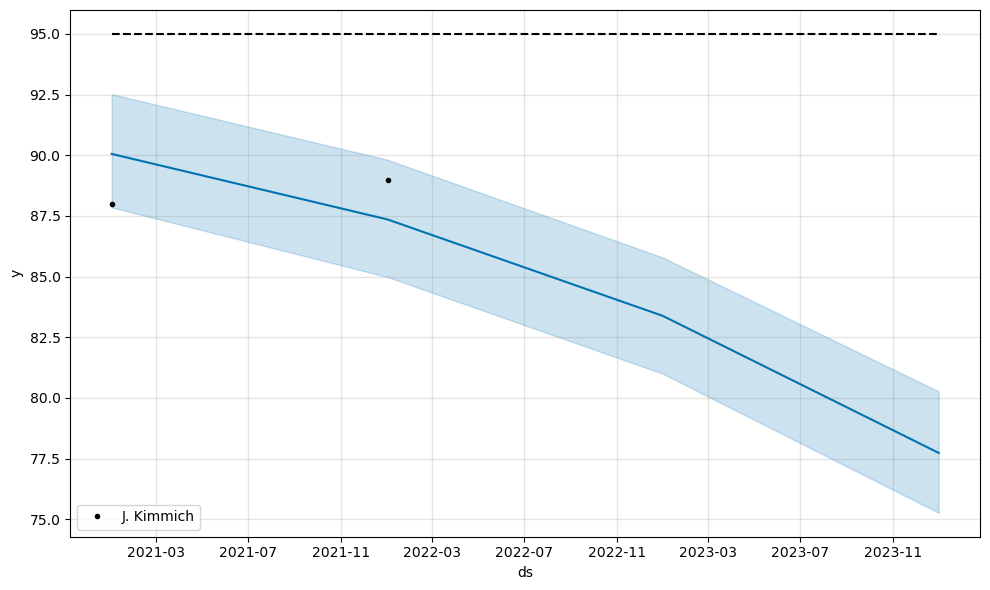

14:14:22 - cmdstanpy - INFO - Chain [1] start processing
14:14:23 - cmdstanpy - INFO - Chain [1] done processing


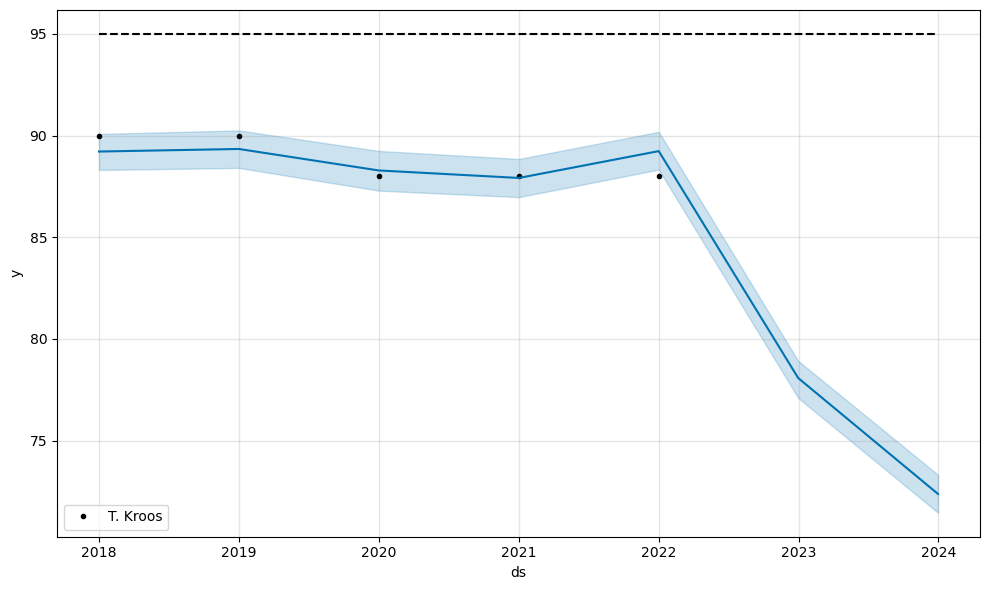

14:14:24 - cmdstanpy - INFO - Chain [1] start processing
14:14:25 - cmdstanpy - INFO - Chain [1] done processing


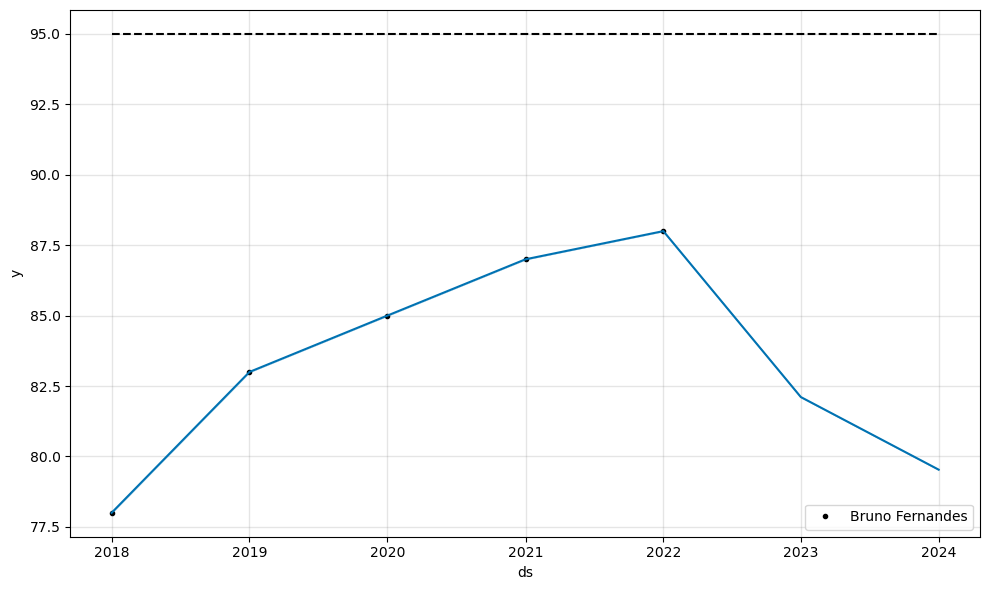

14:14:27 - cmdstanpy - INFO - Chain [1] start processing
14:14:27 - cmdstanpy - INFO - Chain [1] done processing


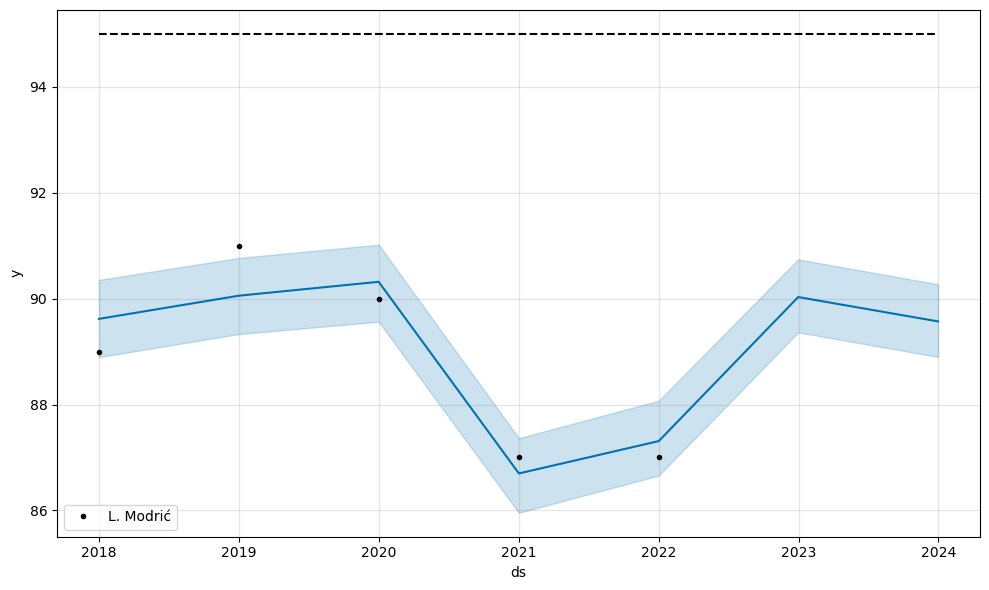

14:14:29 - cmdstanpy - INFO - Chain [1] start processing
14:14:30 - cmdstanpy - INFO - Chain [1] done processing


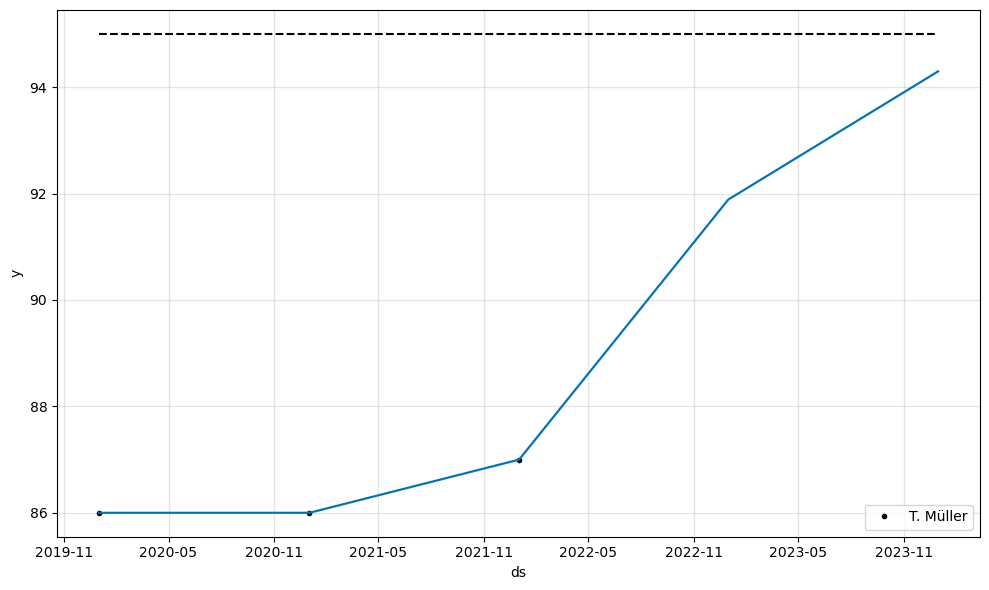

14:14:31 - cmdstanpy - INFO - Chain [1] start processing
14:14:52 - cmdstanpy - INFO - Chain [1] done processing


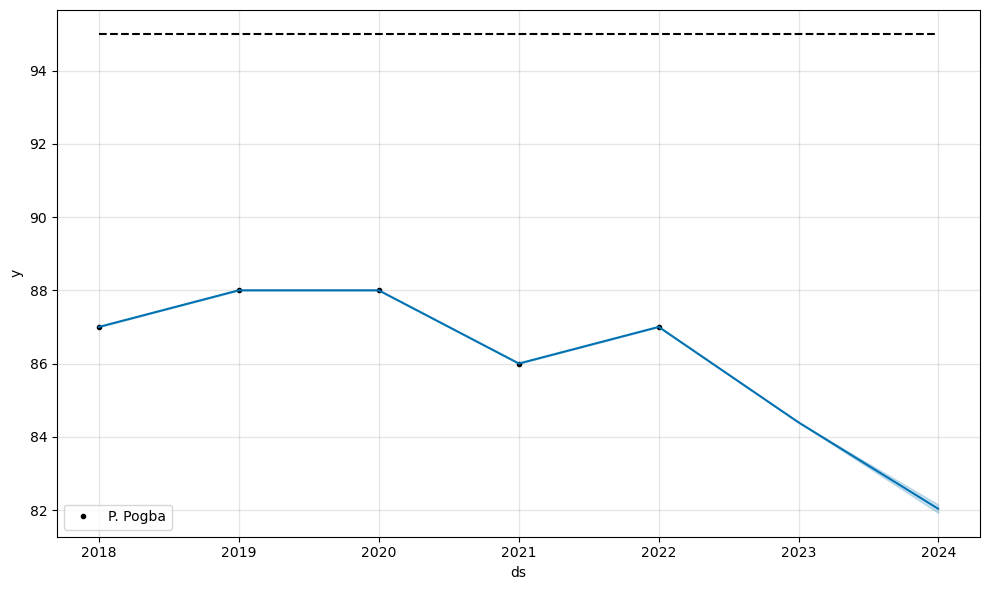

14:14:53 - cmdstanpy - INFO - Chain [1] start processing
14:15:22 - cmdstanpy - INFO - Chain [1] done processing


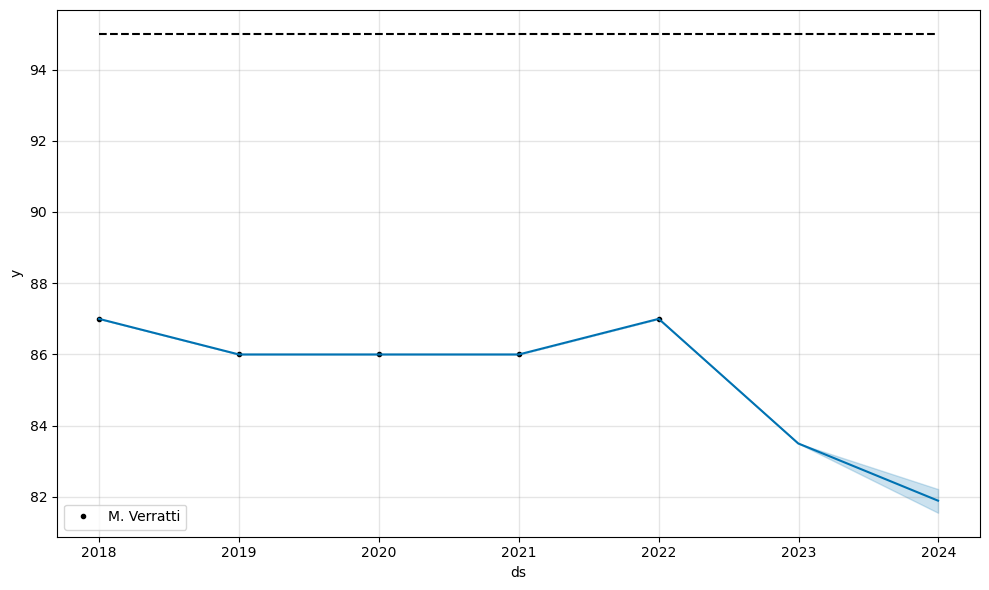

In [ ]:
err_mid = time_series_overall(mid_time)

In [ ]:
err_mid

,Mean absolute error
0,0.400625
1,0.006547
2,0.701453
3,1.850455
4,0.609258
5,0.000557
6,0.498315
7,0.000197
8,0.000011
9,0.000476


14:15:24 - cmdstanpy - INFO - Chain [1] start processing


14:15:30 - cmdstanpy - INFO - Chain [1] done processing


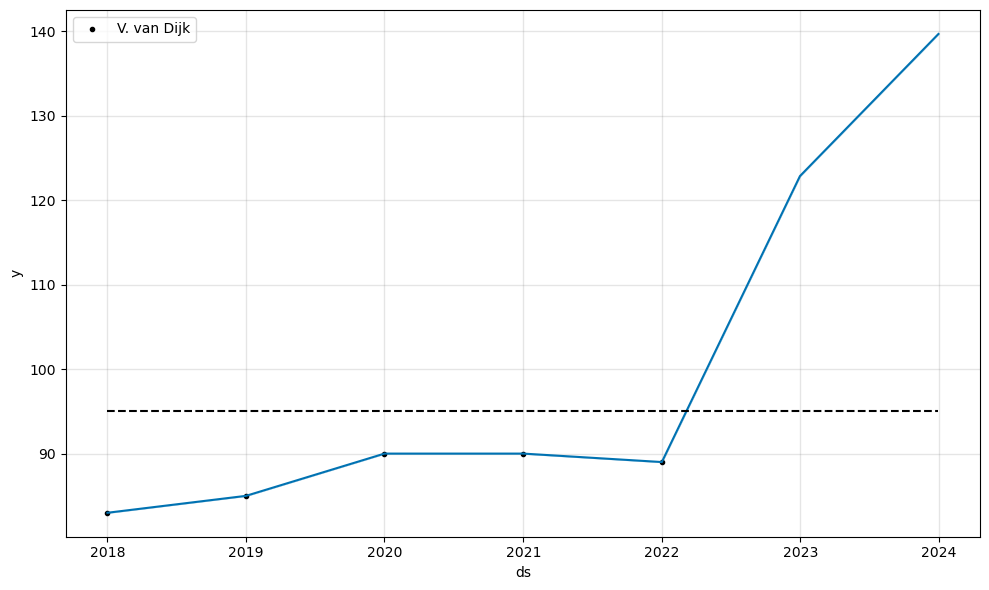

14:15:32 - cmdstanpy - INFO - Chain [1] start processing
14:15:32 - cmdstanpy - INFO - Chain [1] done processing


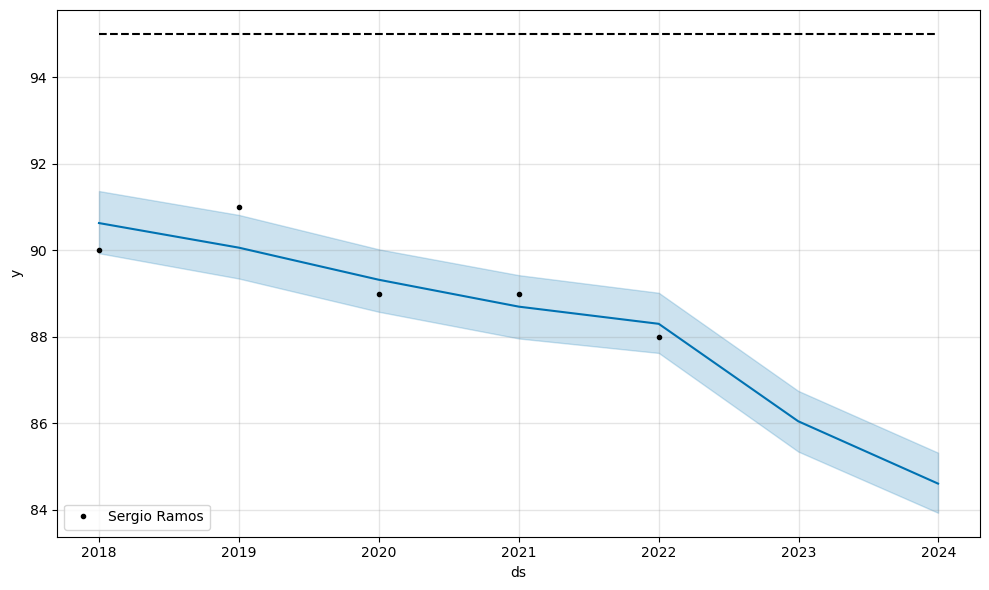

14:15:33 - cmdstanpy - INFO - Chain [1] start processing
14:15:53 - cmdstanpy - INFO - Chain [1] done processing


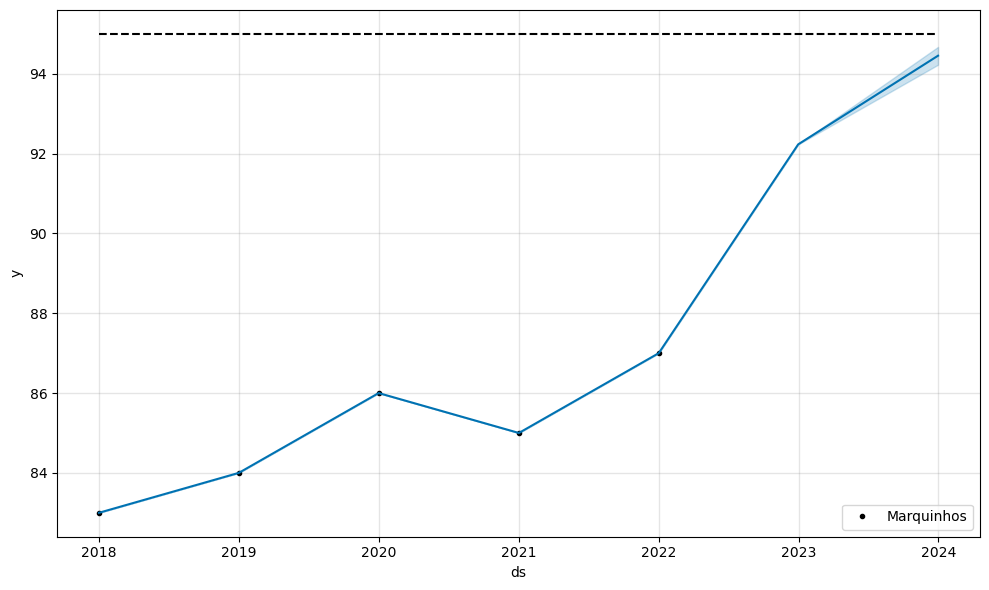

14:15:54 - cmdstanpy - INFO - Chain [1] start processing
14:15:54 - cmdstanpy - INFO - Chain [1] done processing


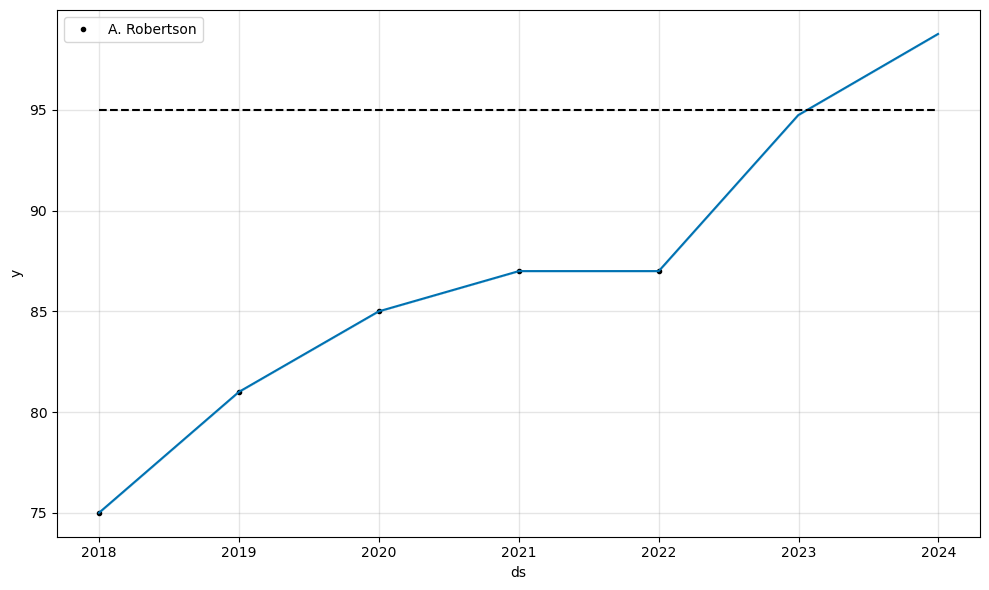

14:15:55 - cmdstanpy - INFO - Chain [1] start processing
14:15:55 - cmdstanpy - INFO - Chain [1] done processing


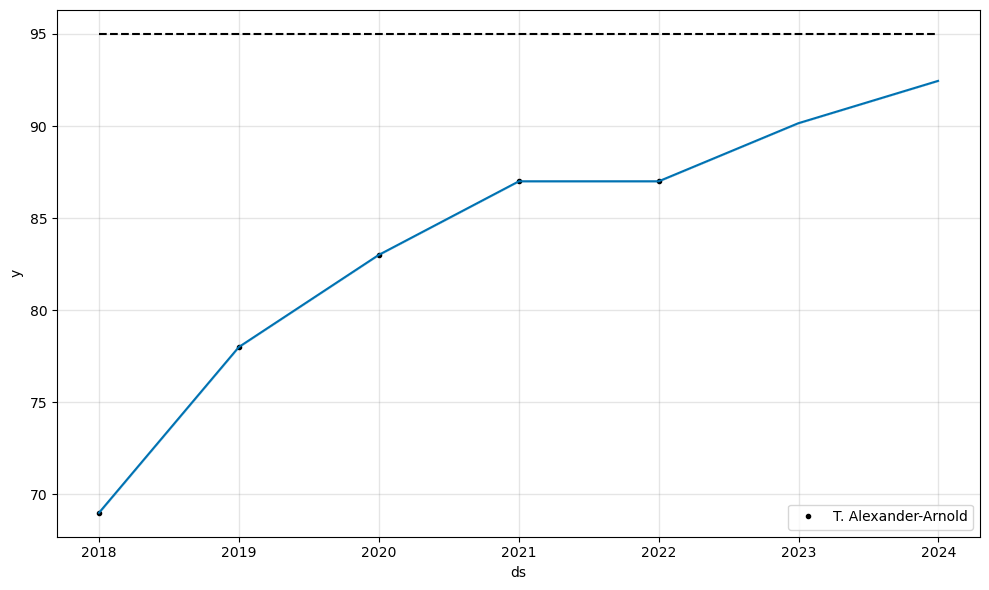

14:15:56 - cmdstanpy - INFO - Chain [1] start processing
14:15:57 - cmdstanpy - INFO - Chain [1] done processing


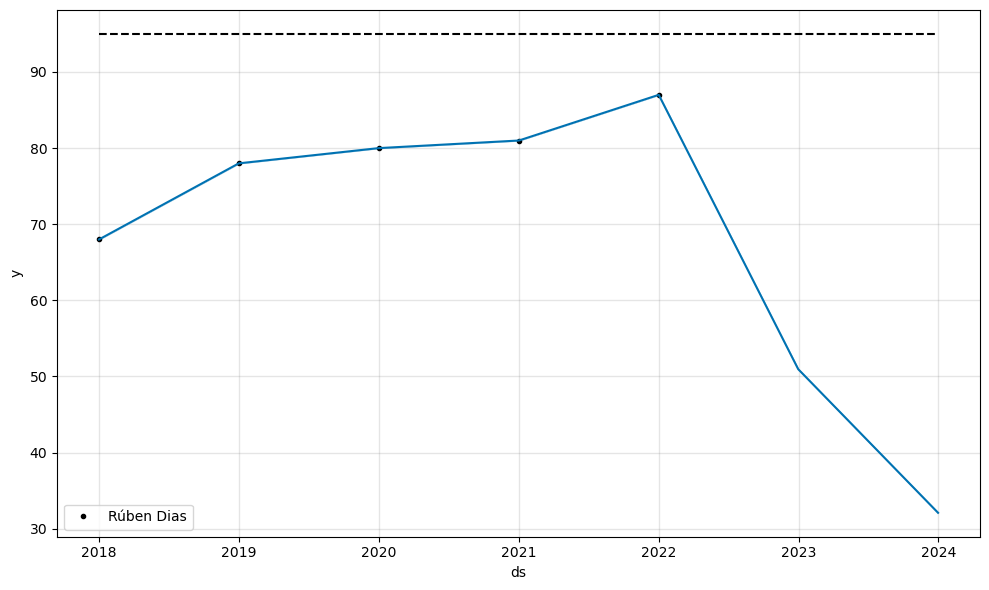

14:15:57 - cmdstanpy - INFO - Chain [1] start processing
14:16:09 - cmdstanpy - INFO - Chain [1] done processing


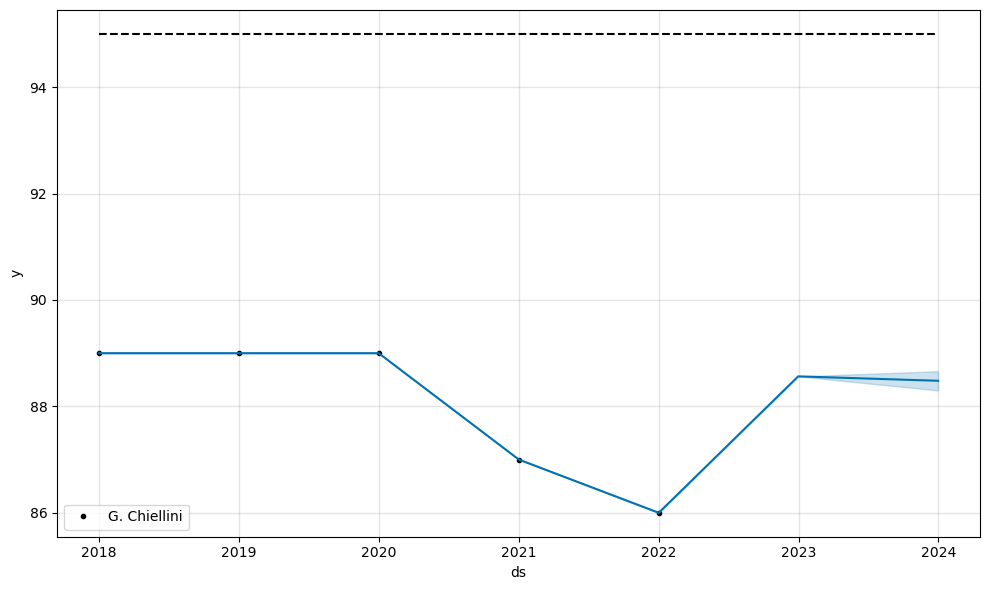

14:16:10 - cmdstanpy - INFO - Chain [1] start processing
14:16:10 - cmdstanpy - INFO - Chain [1] done processing


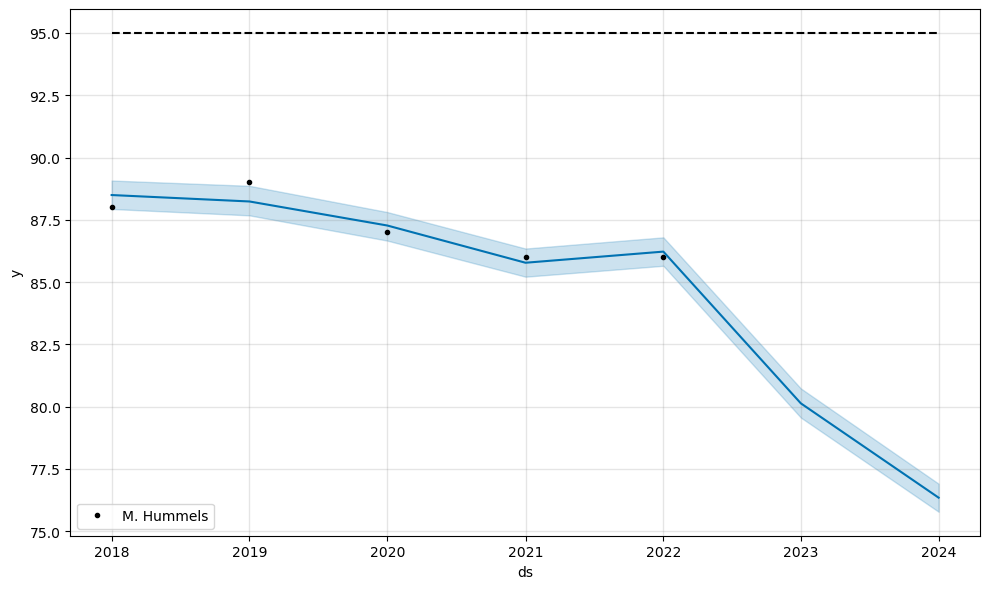

14:16:10 - cmdstanpy - INFO - Chain [1] start processing
14:16:10 - cmdstanpy - INFO - Chain [1] done processing


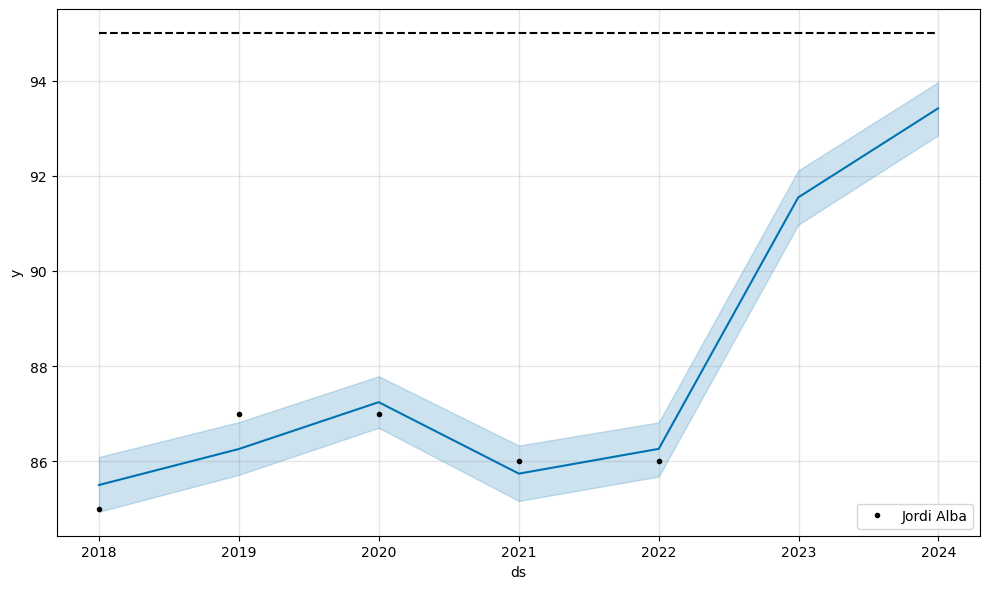

14:16:11 - cmdstanpy - INFO - Chain [1] start processing
14:16:11 - cmdstanpy - INFO - Chain [1] done processing


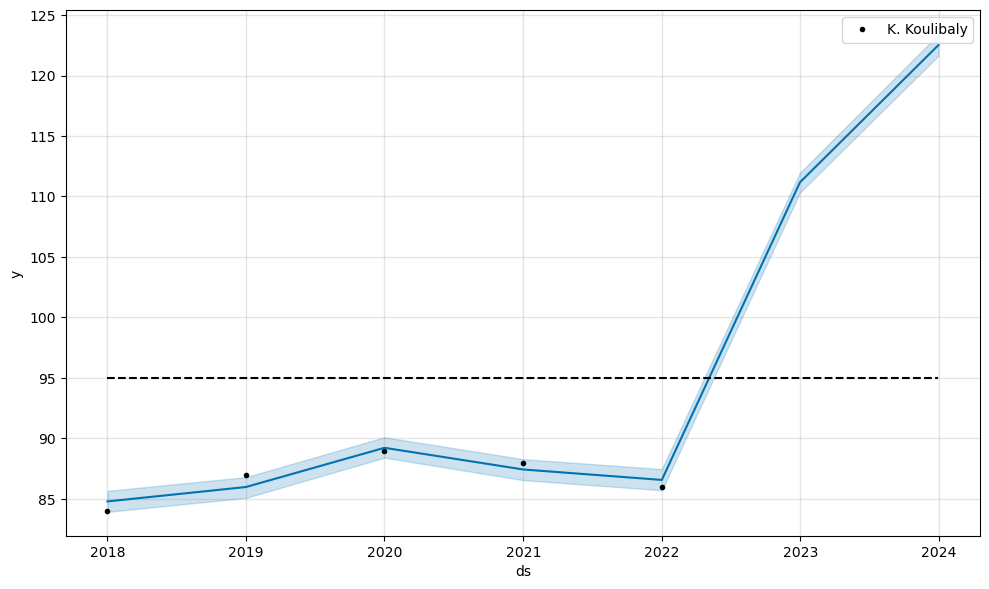

In [ ]:
err_defend = time_series_overall(defend_time)

In [ ]:
err_defend

,Mean absolute error
0,0.002545
1,0.498197
2,0.000135
3,0.001187
4,0.000030
5,0.001340
6,0.000076
7,0.395125
8,0.401163
9,0.634267


14:16:12 - cmdstanpy - INFO - Chain [1] start processing


14:16:13 - cmdstanpy - INFO - Chain [1] done processing


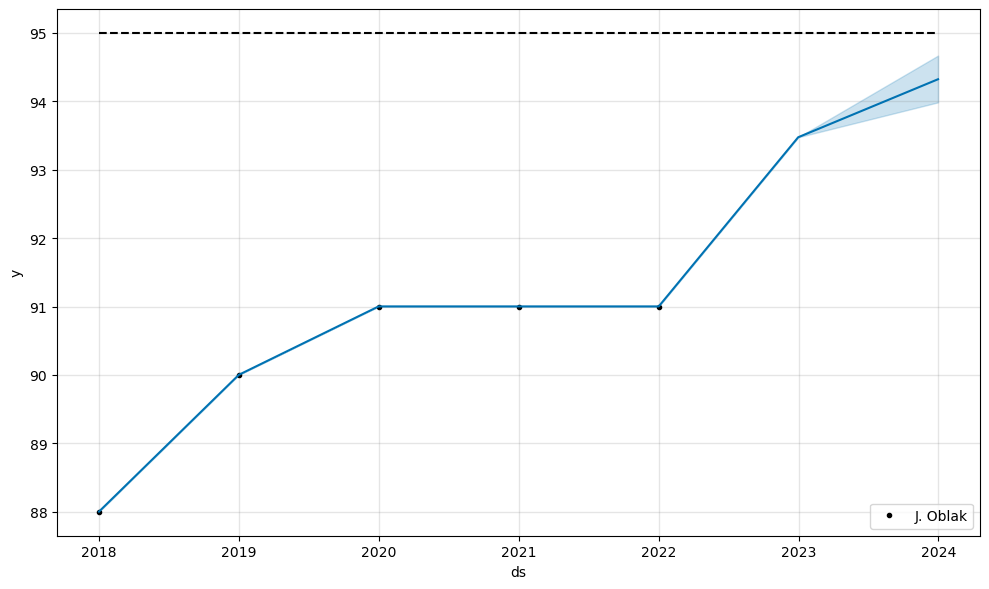

14:16:14 - cmdstanpy - INFO - Chain [1] start processing
14:16:14 - cmdstanpy - INFO - Chain [1] done processing


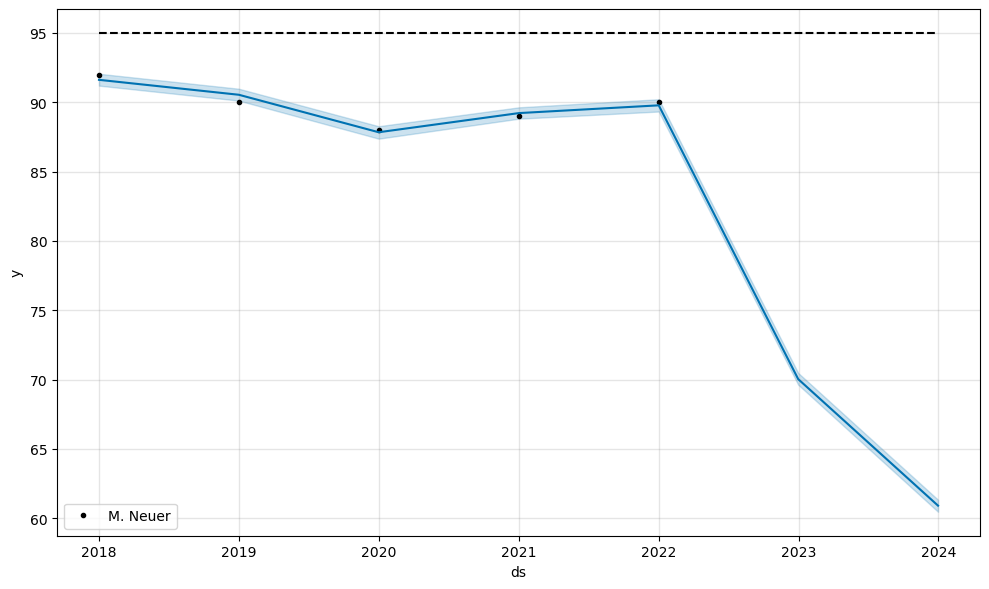

14:16:15 - cmdstanpy - INFO - Chain [1] start processing
14:16:15 - cmdstanpy - INFO - Chain [1] done processing


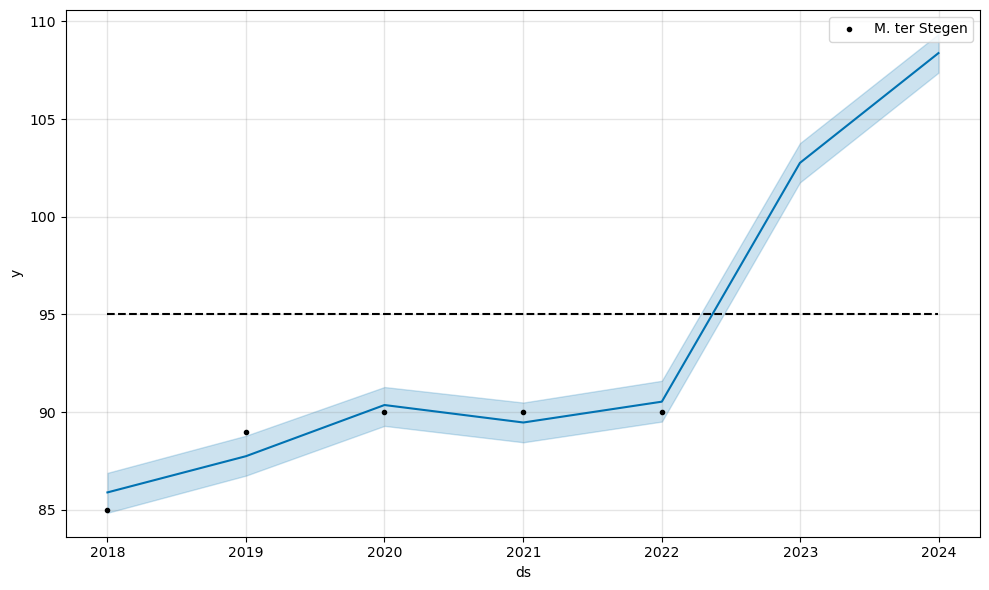

14:16:17 - cmdstanpy - INFO - Chain [1] start processing
14:16:17 - cmdstanpy - INFO - Chain [1] done processing


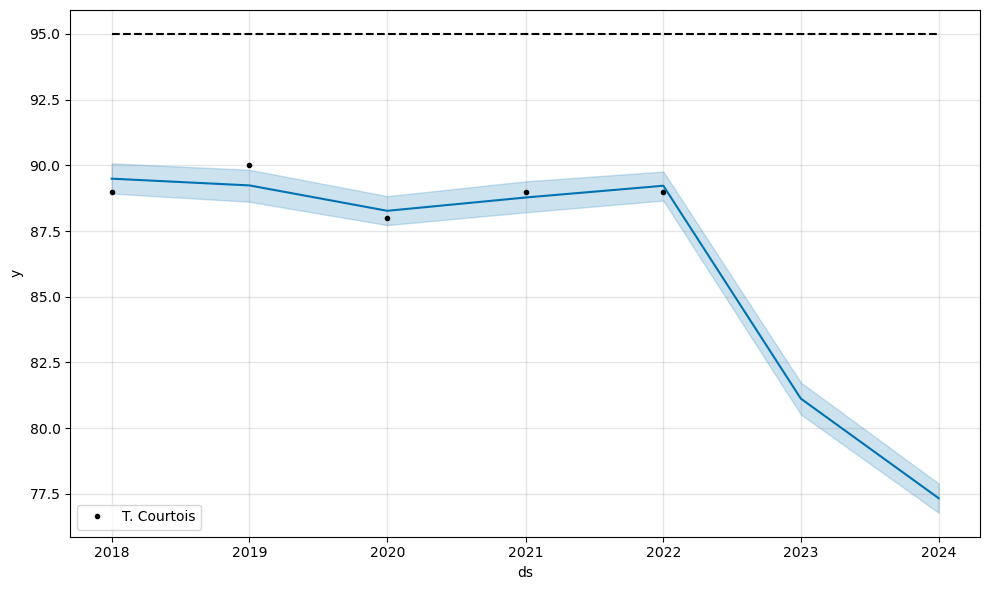

14:16:19 - cmdstanpy - INFO - Chain [1] start processing
14:16:37 - cmdstanpy - INFO - Chain [1] done processing


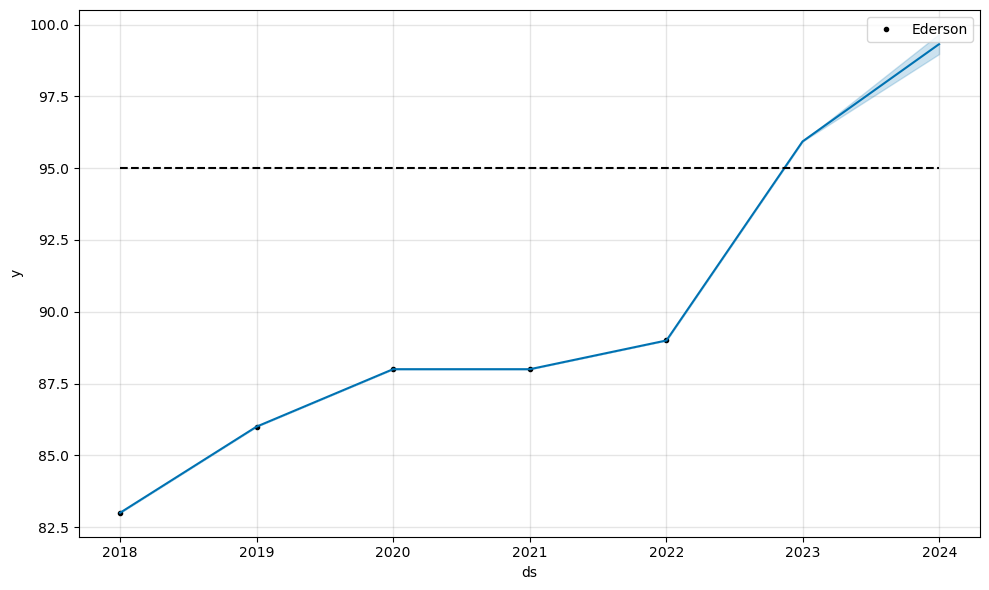

14:16:37 - cmdstanpy - INFO - Chain [1] start processing
14:16:39 - cmdstanpy - INFO - Chain [1] done processing


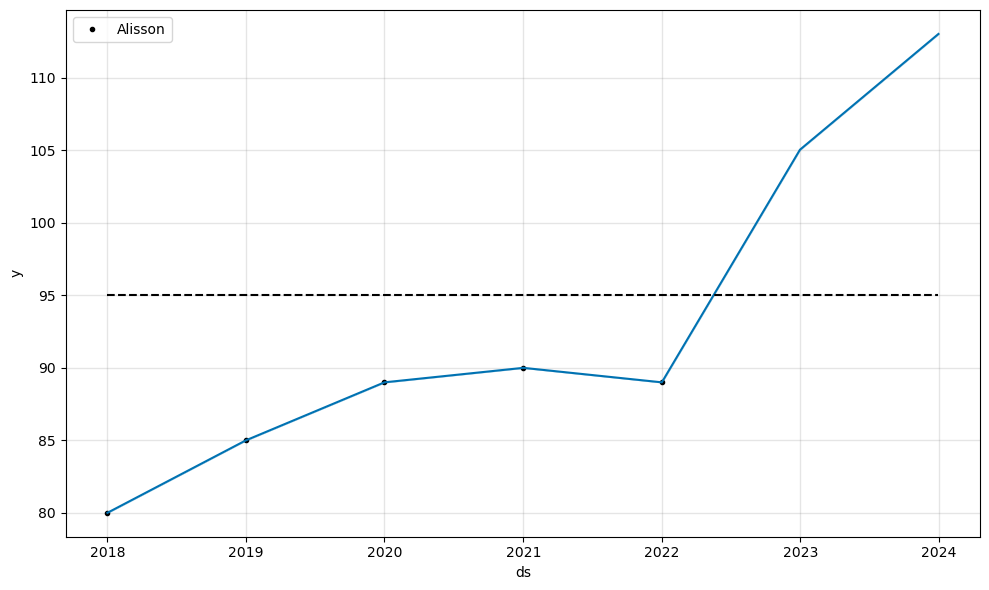

14:16:40 - cmdstanpy - INFO - Chain [1] start processing
14:16:40 - cmdstanpy - INFO - Chain [1] done processing


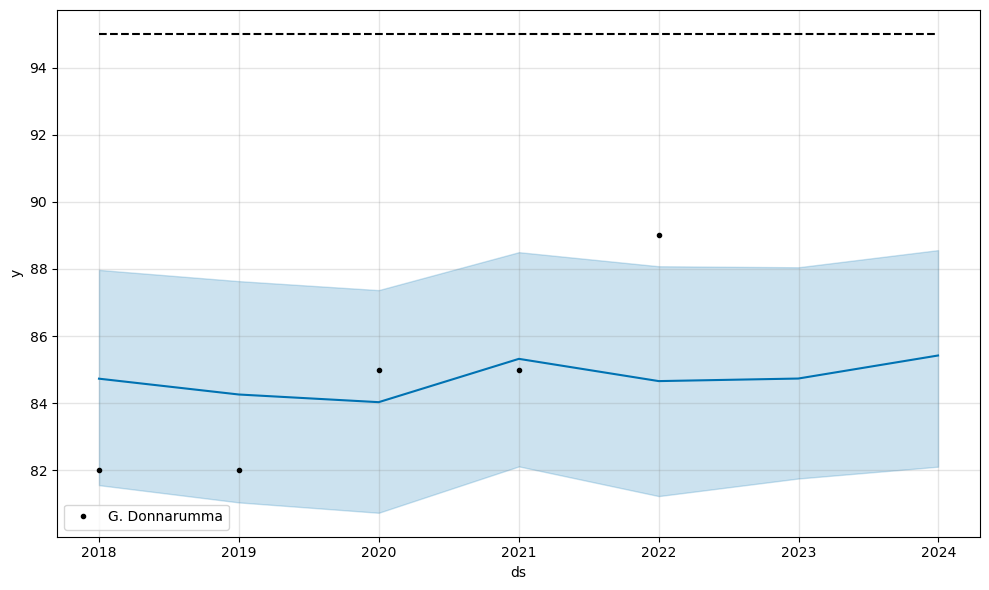

14:16:42 - cmdstanpy - INFO - Chain [1] start processing
14:17:04 - cmdstanpy - INFO - Chain [1] done processing


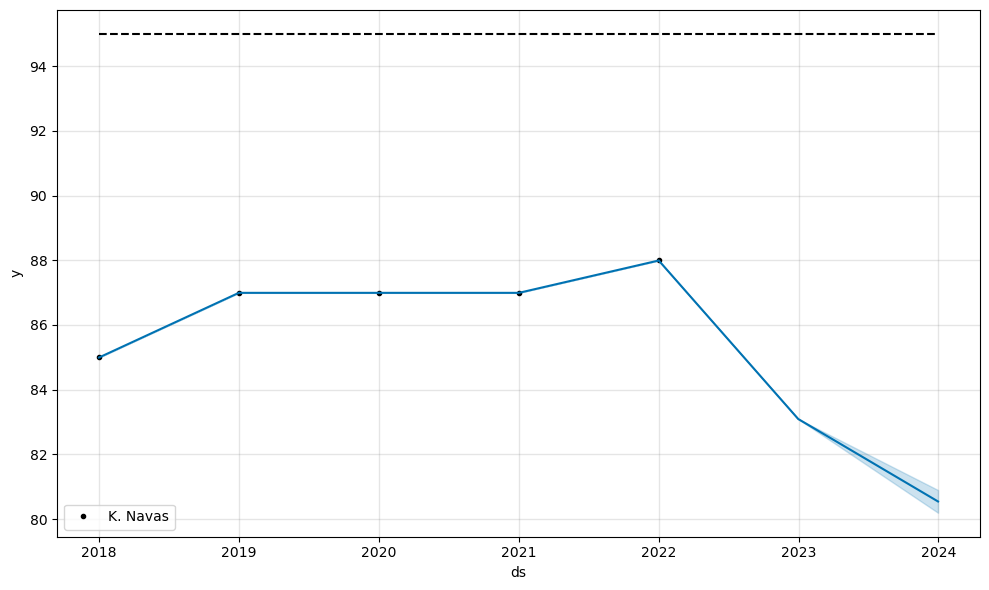

14:17:05 - cmdstanpy - INFO - Chain [1] start processing
14:17:30 - cmdstanpy - INFO - Chain [1] done processing


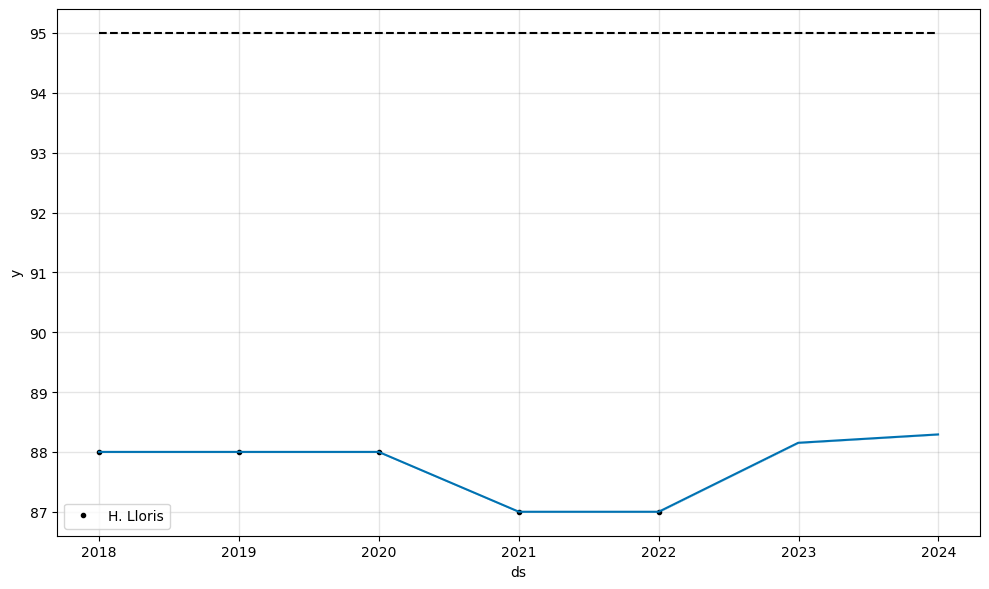

14:17:31 - cmdstanpy - INFO - Chain [1] start processing
14:17:53 - cmdstanpy - INFO - Chain [1] done processing


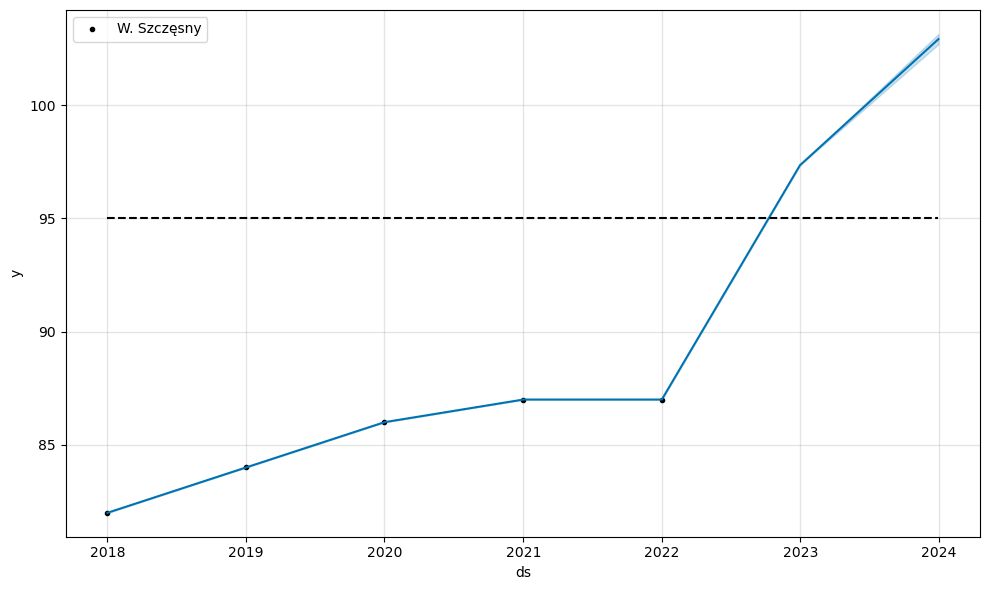

In [ ]:
err_gk = time_series_overall(gk_time)

In [ ]:
err_gk

,Mean absolute error
0,0.002231
1,0.305035
2,0.715046
3,0.394808
4,0.000127
5,0.000019
6,2.124312
7,0.005728
8,0.000496
9,0.001008


### Goals & Assist forecasting

In [ ]:
player_goals = player_char[['Year','player_name','goals']]
player_goals

,Year,player_name,goals
0,2018,Pierre-Emerick Aubameyang,22
1,2018,Sadio Mané,22
2,2018,Mohamed Salah,22
3,2018,Sergio Agüero,21
4,2018,Jamie Vardy,18
...,...,...,...
10023,2022,Ángel Alarcón,0
10024,2022,Alexander Callens,0
10025,2022,Ángel Alarcón,0
10026,2022,Francisco Mwepu,0


In [ ]:
def time_series_G_A(df,col):
    names = df[df['Year'] == 2022]['player_name'].unique()[:20]
    df['Year'] = pd.to_datetime(df['Year'],format='%Y')
    pos = 1
    err = []
    for i in names:
        df_t = df[df['player_name'] == i][[col,'Year']]
        if df_t.shape[0] < 2:
            continue
        df_t.columns = ['y', 'ds']
        df_t['cap'] = 50
        df_t['floor'] = 0
        model = Prophet(changepoint_prior_scale=0.05,growth='logistic')
        model.fit(df_t)
        val = model.predict(df_t)
        err.append(mean_absolute_error(df_t['y'],val['yhat']))
        future = model.make_future_dataframe(periods=2,freq='Y')
        future['cap'] = 50
        future['floor'] = 0
        forecast = model.predict(future)
        model.plot(forecast)
        plt.legend(labels = [i])
        plt.show()
    return pd.DataFrame({'Mean absolute error': err})

14:17:55 - cmdstanpy - INFO - Chain [1] start processing
14:17:55 - cmdstanpy - INFO - Chain [1] done processing


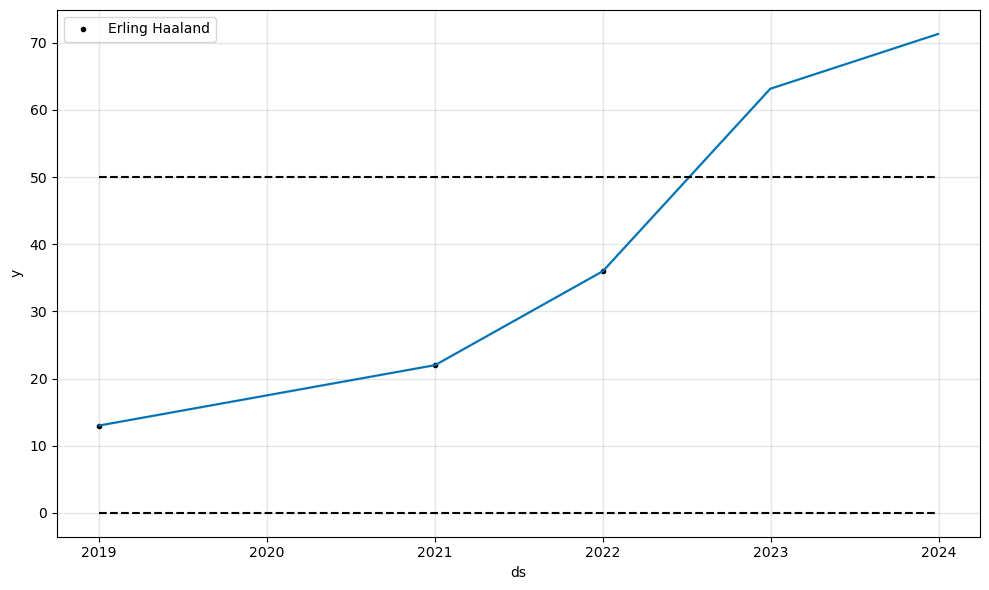

14:17:57 - cmdstanpy - INFO - Chain [1] start processing
14:17:57 - cmdstanpy - INFO - Chain [1] done processing


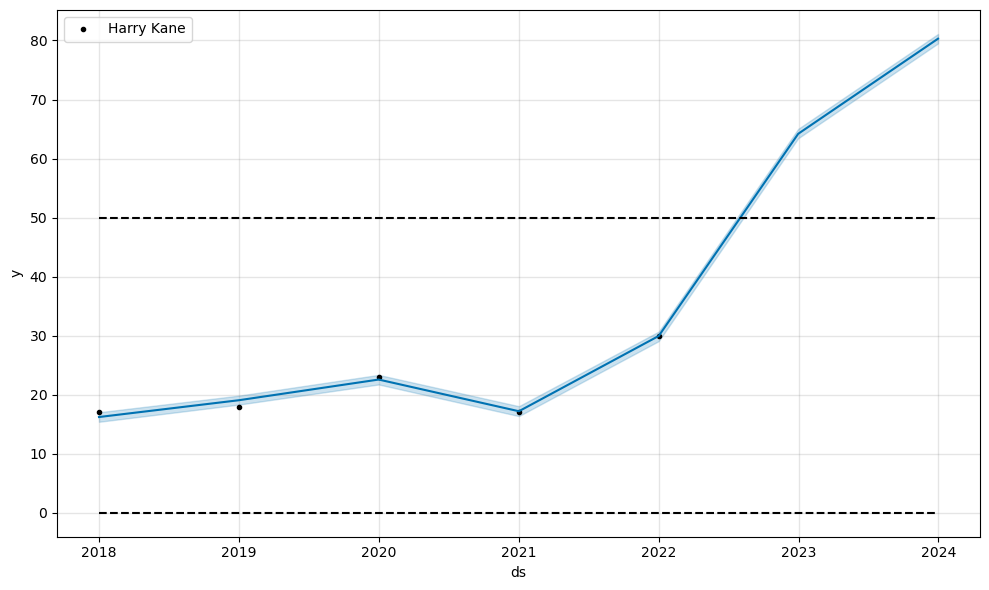

14:17:58 - cmdstanpy - INFO - Chain [1] start processing
14:18:01 - cmdstanpy - INFO - Chain [1] done processing


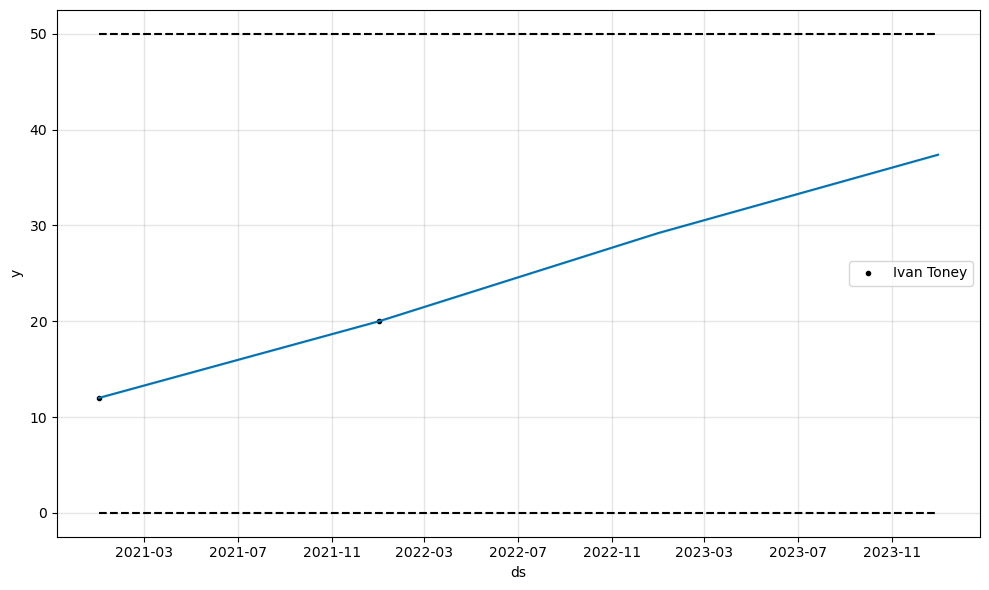

14:18:02 - cmdstanpy - INFO - Chain [1] start processing
14:18:02 - cmdstanpy - INFO - Chain [1] done processing


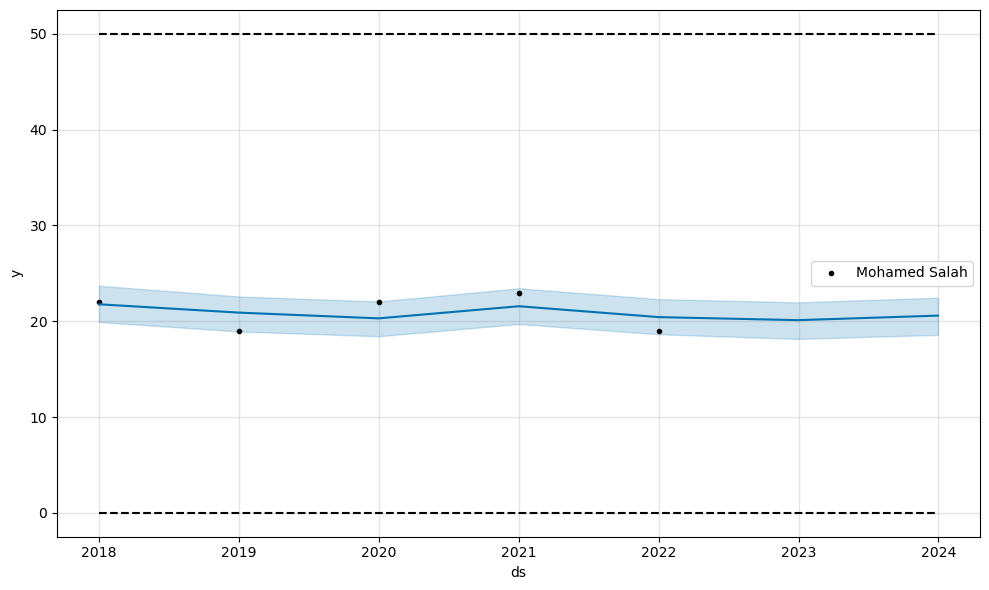

14:18:04 - cmdstanpy - INFO - Chain [1] start processing
14:18:04 - cmdstanpy - INFO - Chain [1] done processing


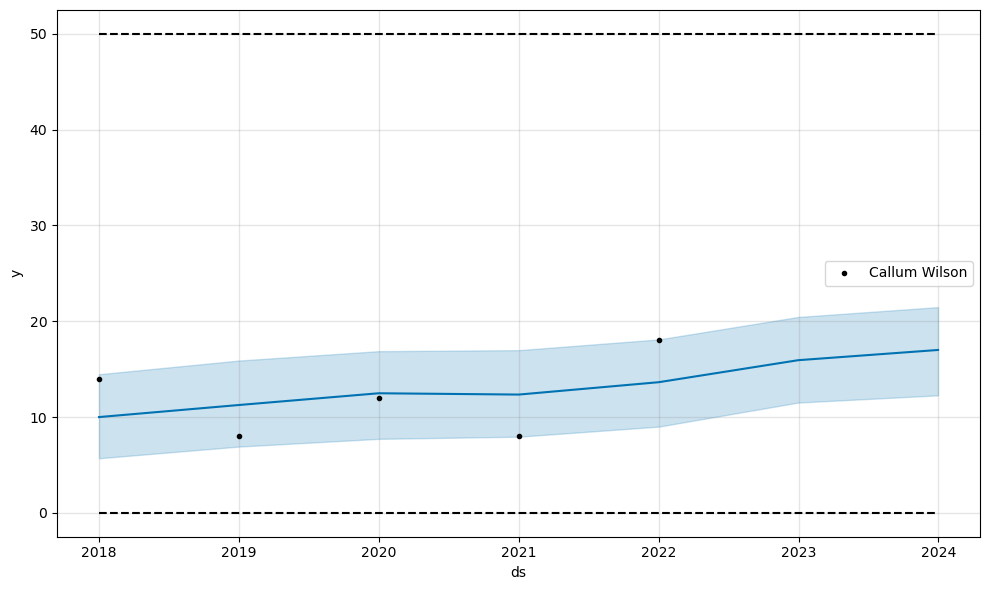

14:18:05 - cmdstanpy - INFO - Chain [1] start processing
14:18:06 - cmdstanpy - INFO - Chain [1] done processing


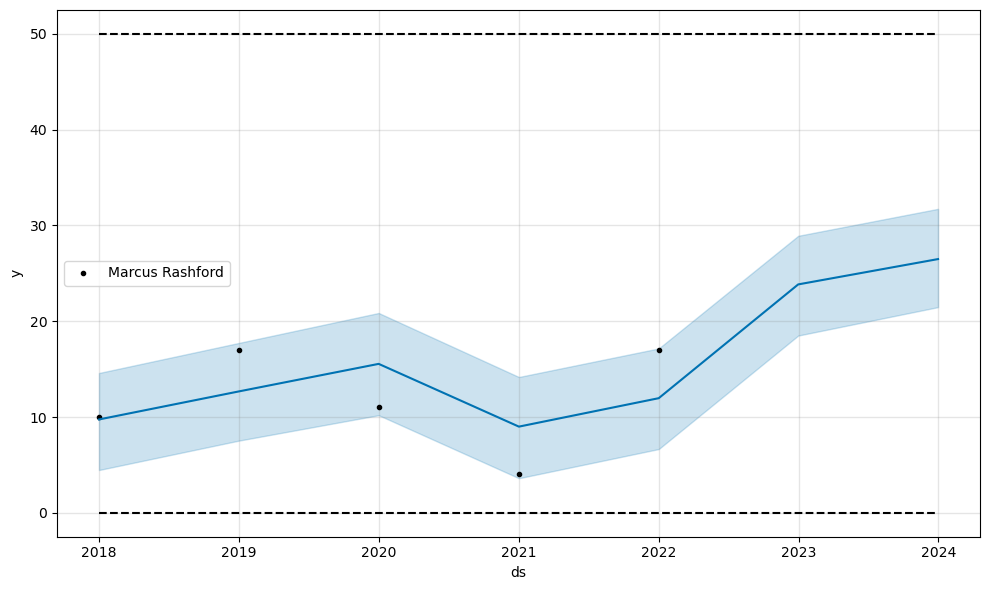

14:18:07 - cmdstanpy - INFO - Chain [1] start processing
14:18:07 - cmdstanpy - INFO - Chain [1] done processing


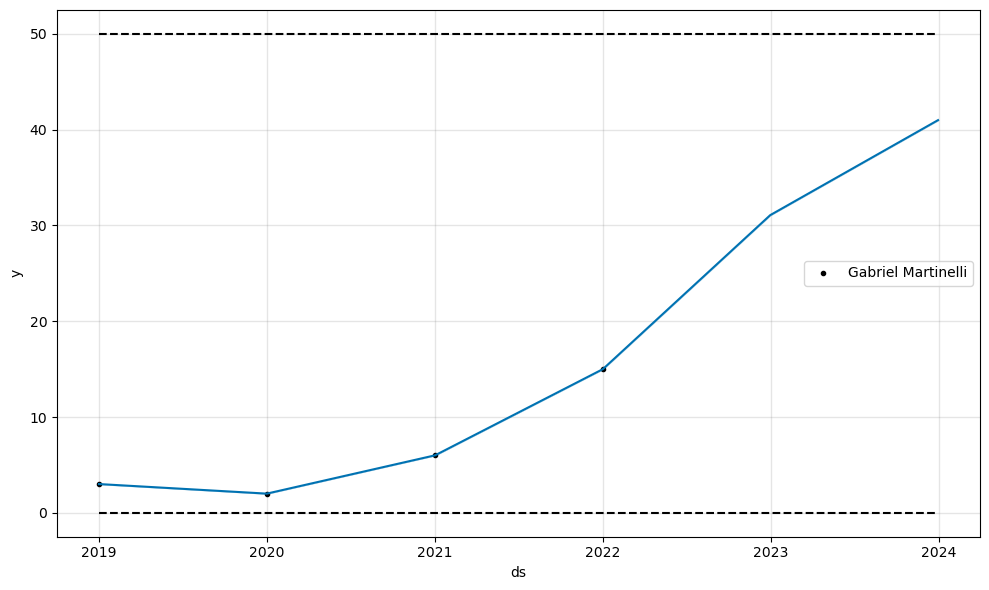

14:18:08 - cmdstanpy - INFO - Chain [1] start processing
14:18:13 - cmdstanpy - INFO - Chain [1] done processing


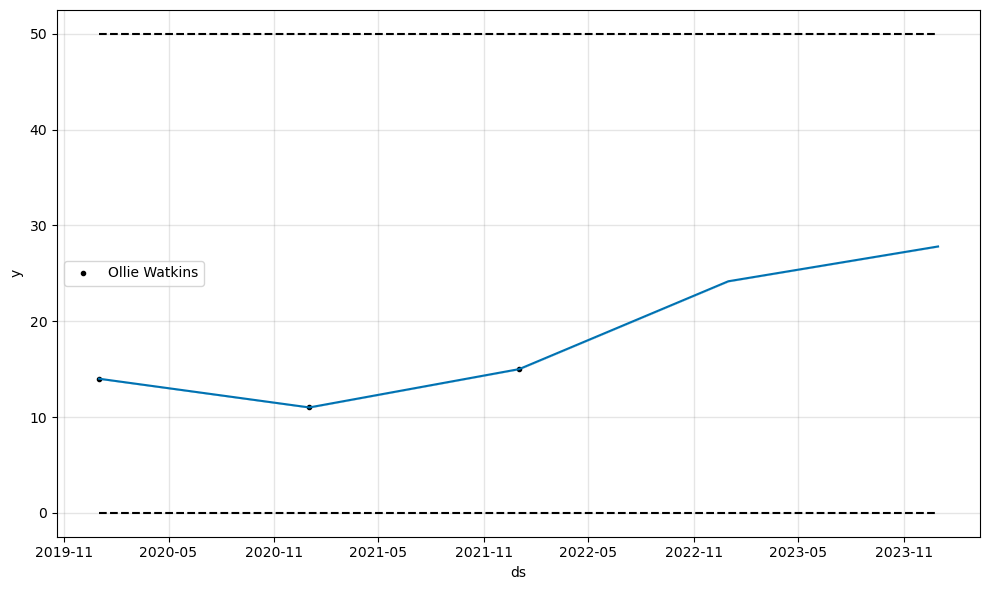

14:18:14 - cmdstanpy - INFO - Chain [1] start processing
14:18:23 - cmdstanpy - INFO - Chain [1] done processing


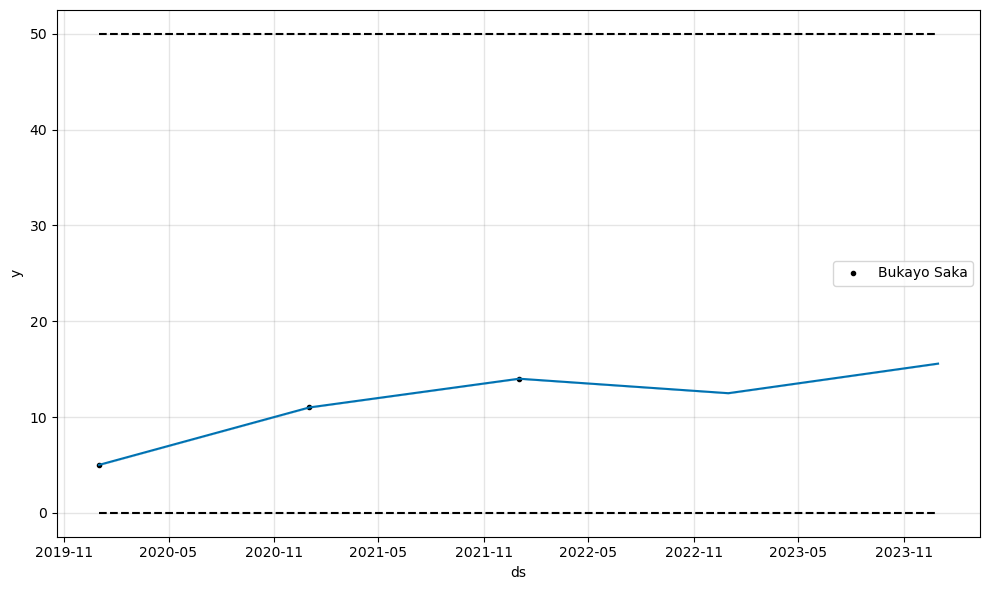

14:18:23 - cmdstanpy - INFO - Chain [1] start processing
14:18:24 - cmdstanpy - INFO - Chain [1] done processing


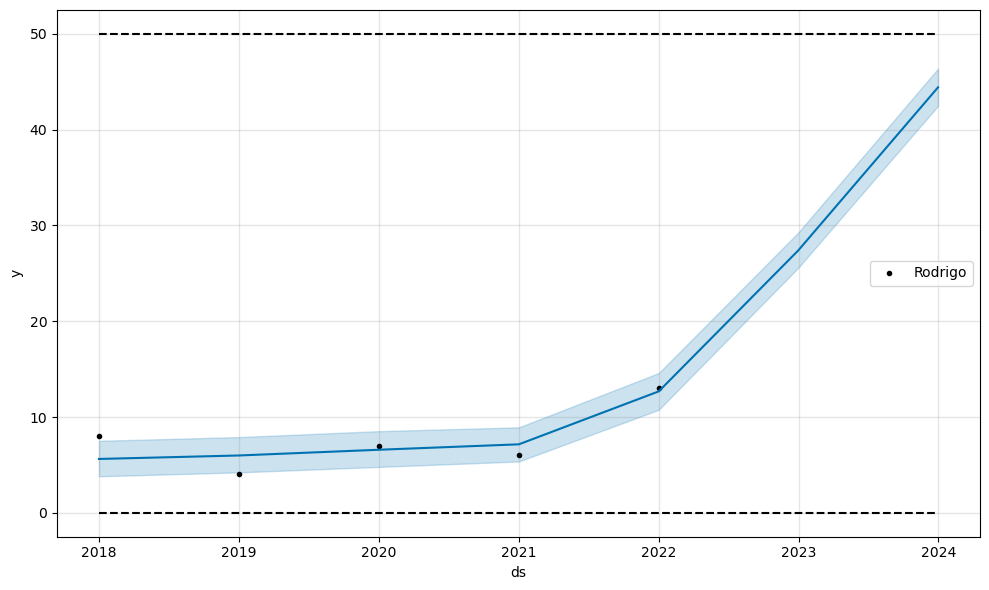

14:18:24 - cmdstanpy - INFO - Chain [1] start processing
14:18:29 - cmdstanpy - INFO - Chain [1] done processing


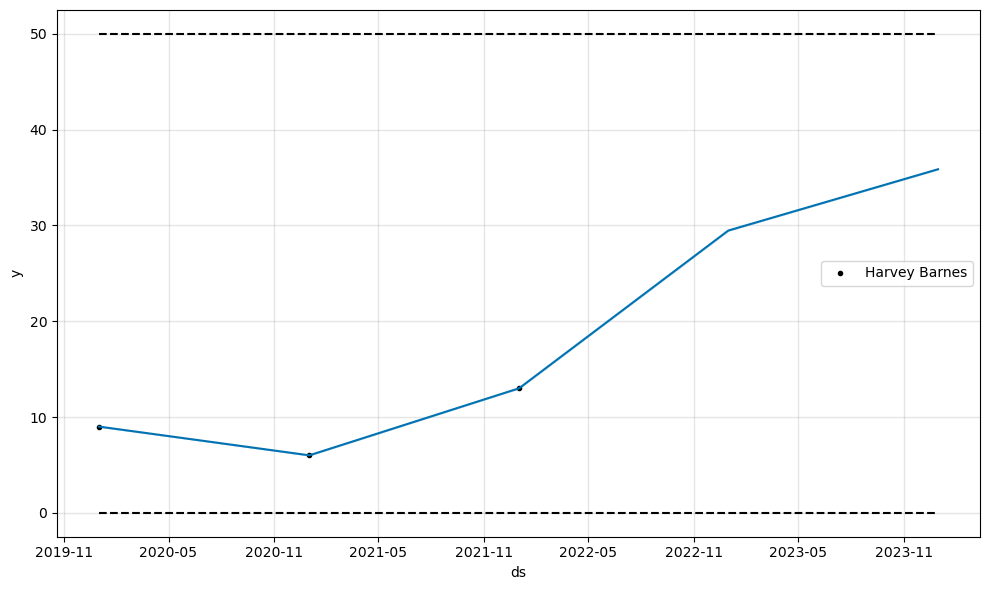

14:18:29 - cmdstanpy - INFO - Chain [1] start processing
14:18:29 - cmdstanpy - INFO - Chain [1] done processing


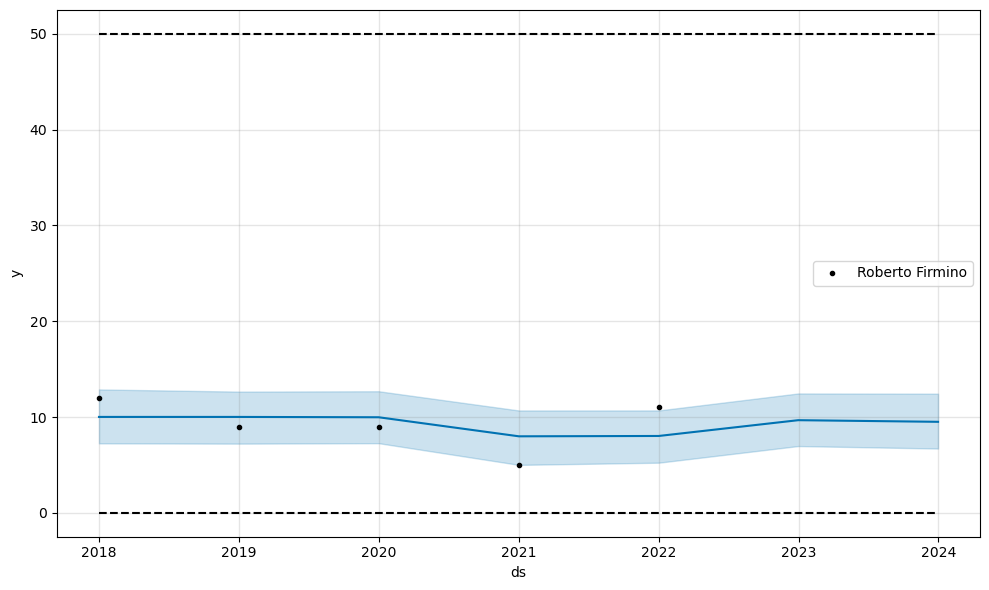

14:18:30 - cmdstanpy - INFO - Chain [1] start processing
14:18:30 - cmdstanpy - INFO - Chain [1] done processing


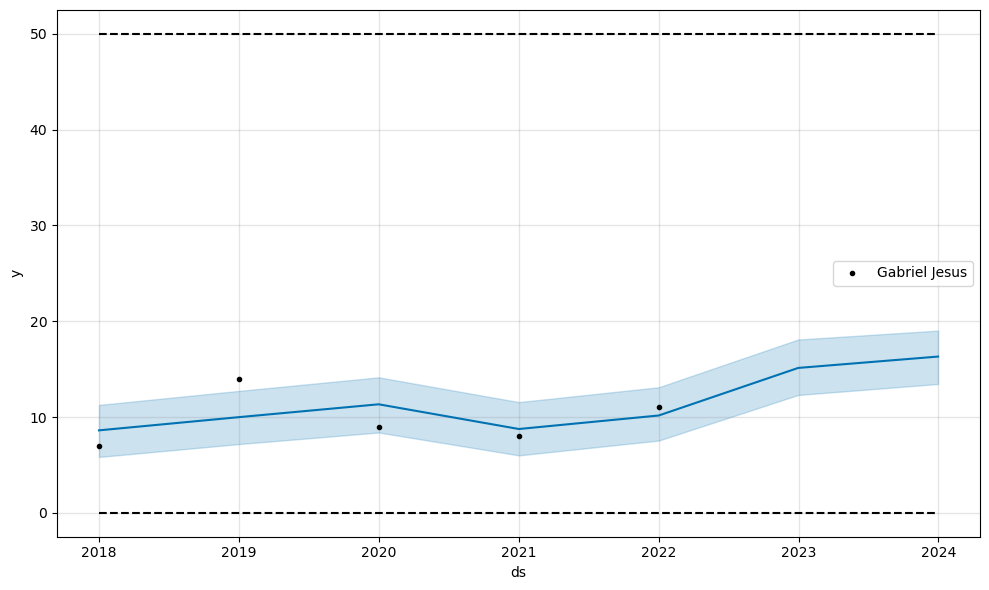

14:18:31 - cmdstanpy - INFO - Chain [1] start processing
14:18:33 - cmdstanpy - INFO - Chain [1] done processing


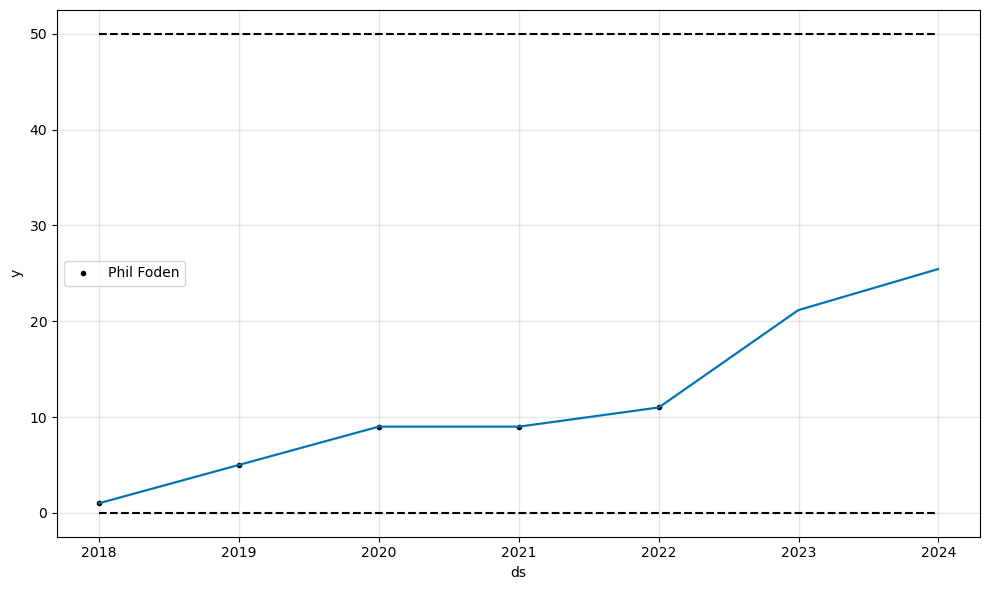

14:18:34 - cmdstanpy - INFO - Chain [1] start processing
14:18:34 - cmdstanpy - INFO - Chain [1] done processing


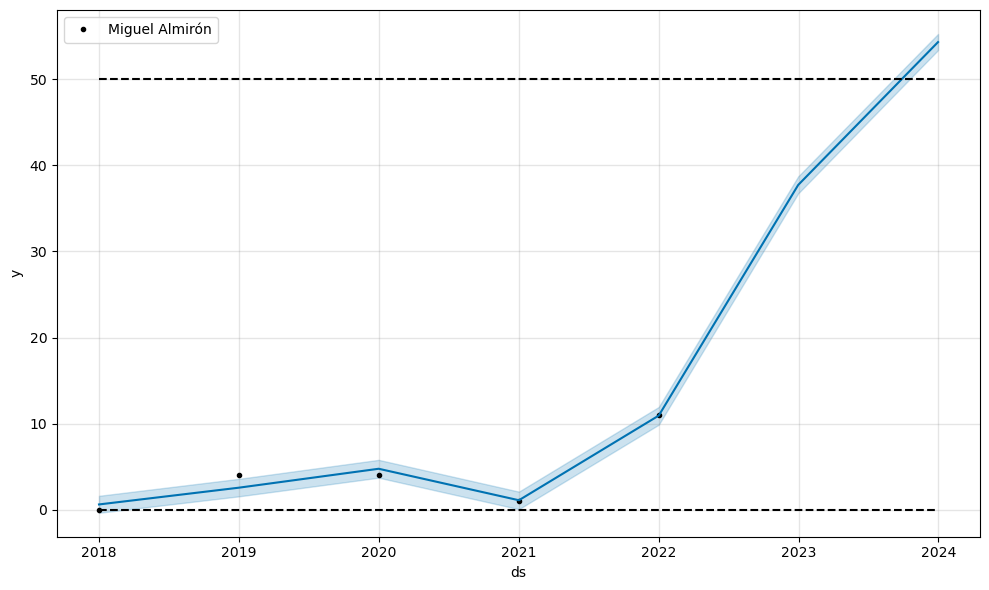

14:18:36 - cmdstanpy - INFO - Chain [1] start processing
14:18:52 - cmdstanpy - INFO - Chain [1] done processing


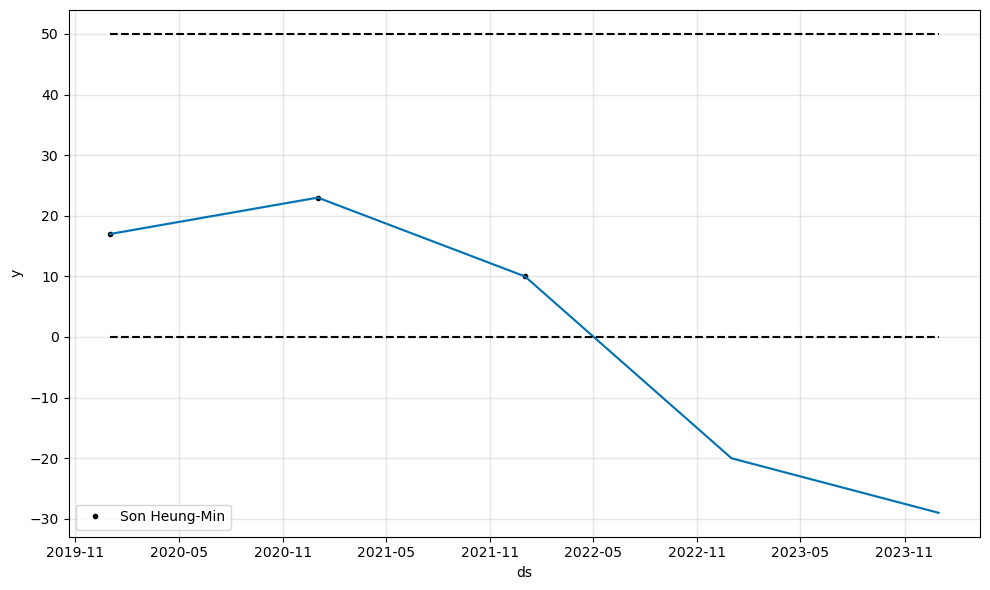

14:18:53 - cmdstanpy - INFO - Chain [1] start processing
14:18:54 - cmdstanpy - INFO - Chain [1] done processing


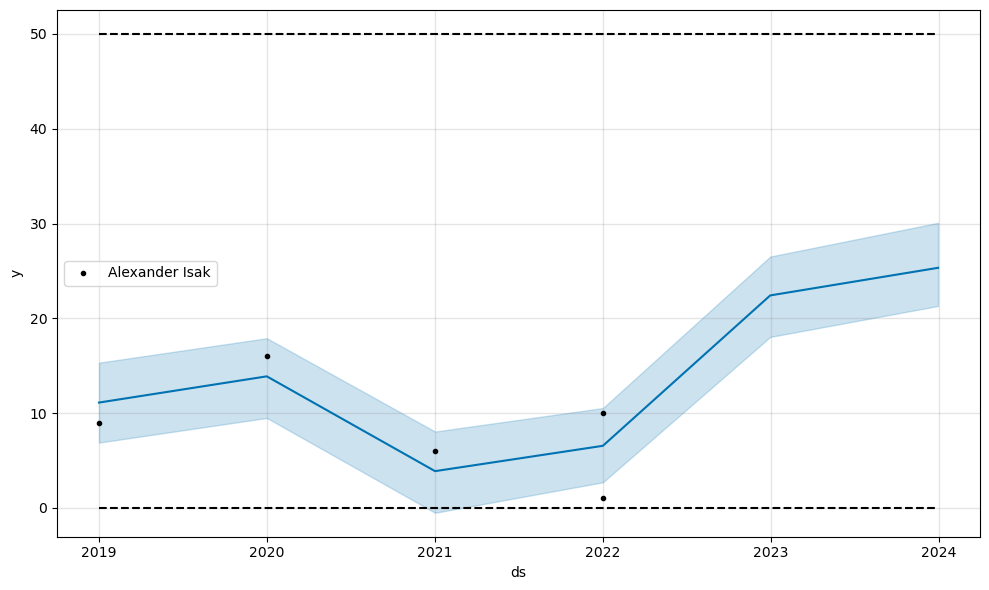

14:18:55 - cmdstanpy - INFO - Chain [1] start processing
14:18:55 - cmdstanpy - INFO - Chain [1] done processing


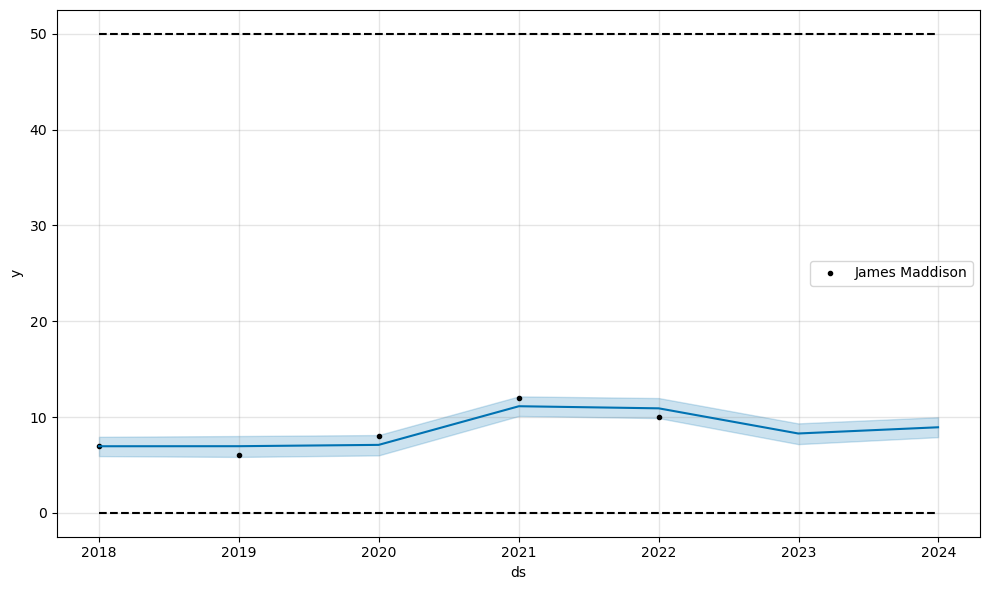

14:18:56 - cmdstanpy - INFO - Chain [1] start processing
14:18:59 - cmdstanpy - INFO - Chain [1] done processing


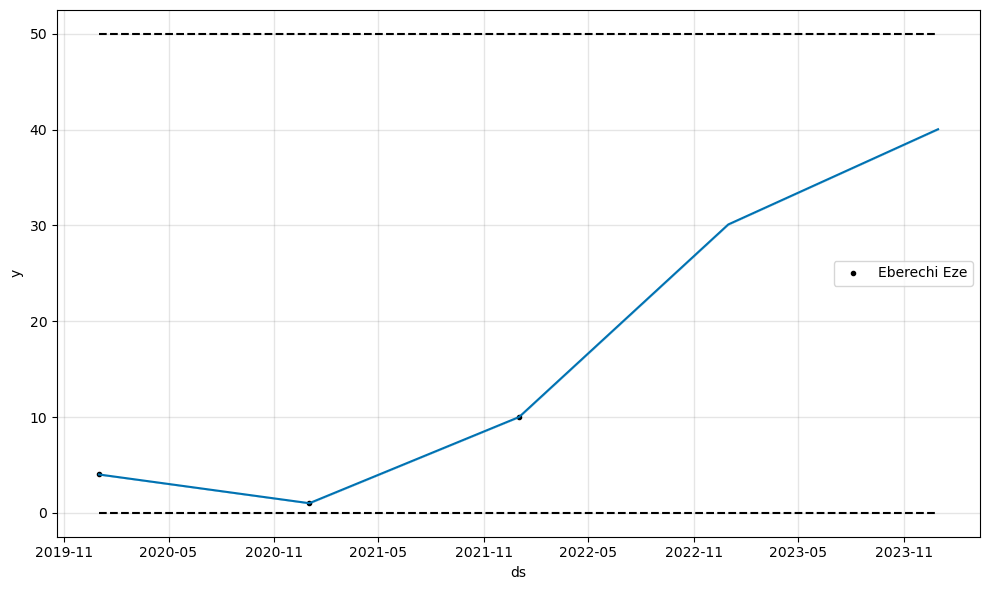

In [ ]:
err_goals = time_series_G_A(player_goals,'goals')

In [ ]:
err_goals

,Mean absolute error
0,0.000037
1,0.505060
2,0.000031
3,1.338562
4,3.289550
5,3.832344
6,0.000070
7,0.000066
8,0.000094
9,1.250760


In [ ]:
player_assists = player_char[['Year','player_name','assists']]
player_assists

,Year,player_name,assists
0,2018,Pierre-Emerick Aubameyang,5
1,2018,Sadio Mané,1
2,2018,Mohamed Salah,8
3,2018,Sergio Agüero,8
4,2018,Jamie Vardy,4
...,...,...,...
10023,2022,Ángel Alarcón,0
10024,2022,Alexander Callens,0
10025,2022,Ángel Alarcón,0
10026,2022,Francisco Mwepu,0


14:19:00 - cmdstanpy - INFO - Chain [1] start processing


14:19:08 - cmdstanpy - INFO - Chain [1] done processing


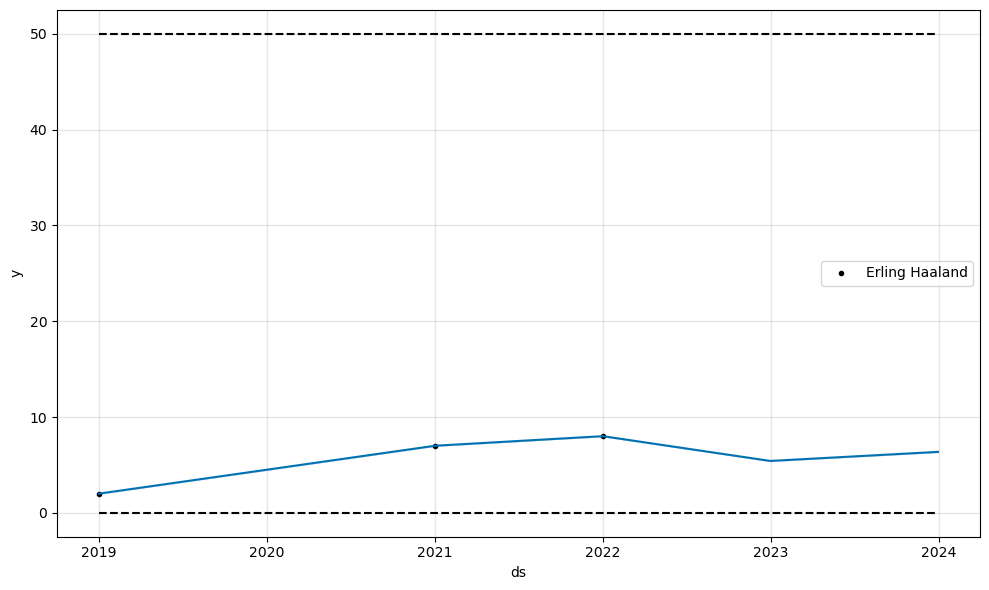

14:19:10 - cmdstanpy - INFO - Chain [1] start processing
14:19:10 - cmdstanpy - INFO - Chain [1] done processing


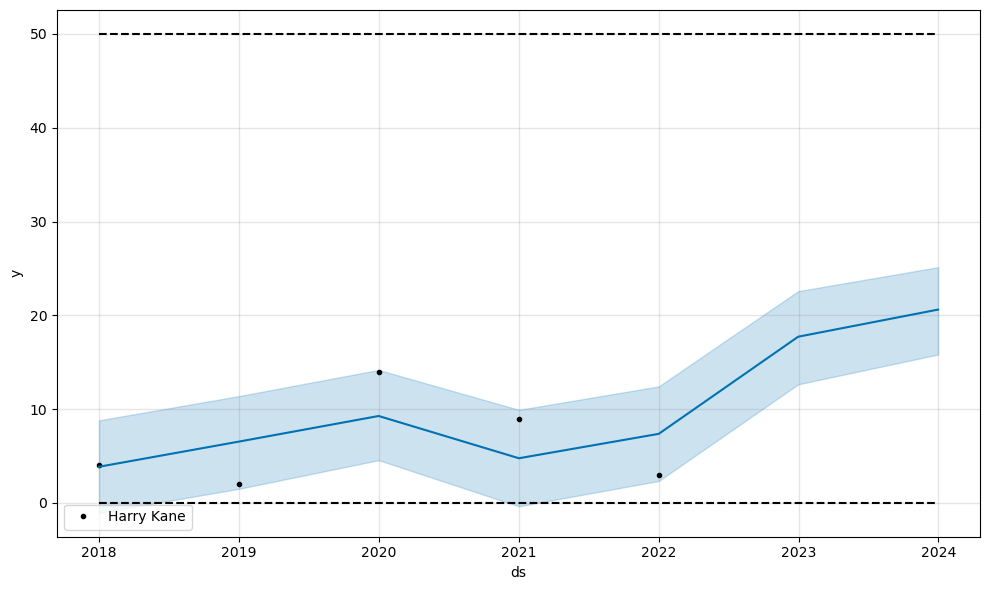

14:19:11 - cmdstanpy - INFO - Chain [1] start processing
14:19:17 - cmdstanpy - INFO - Chain [1] done processing


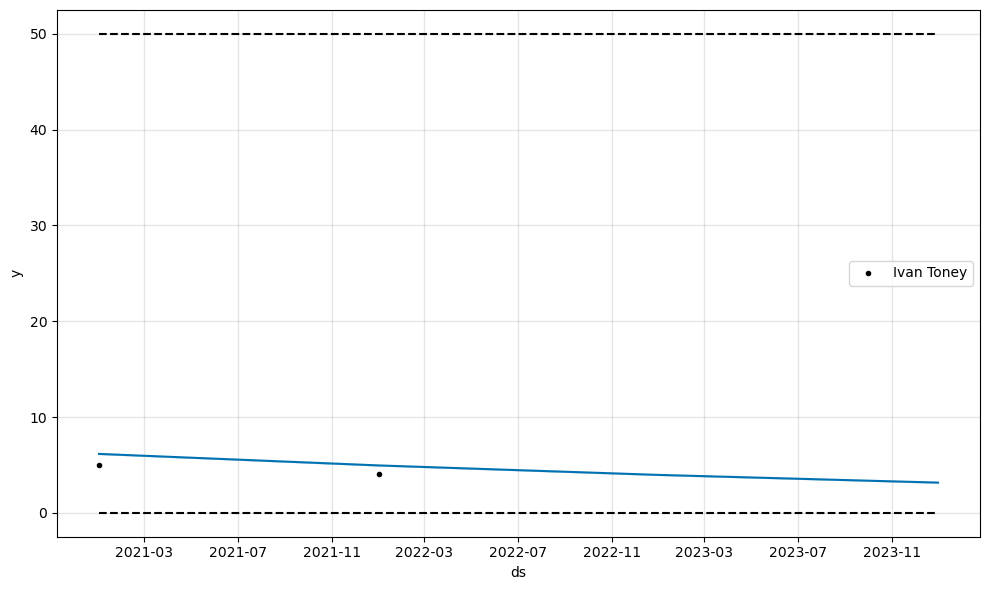

14:19:18 - cmdstanpy - INFO - Chain [1] start processing
14:19:18 - cmdstanpy - INFO - Chain [1] done processing


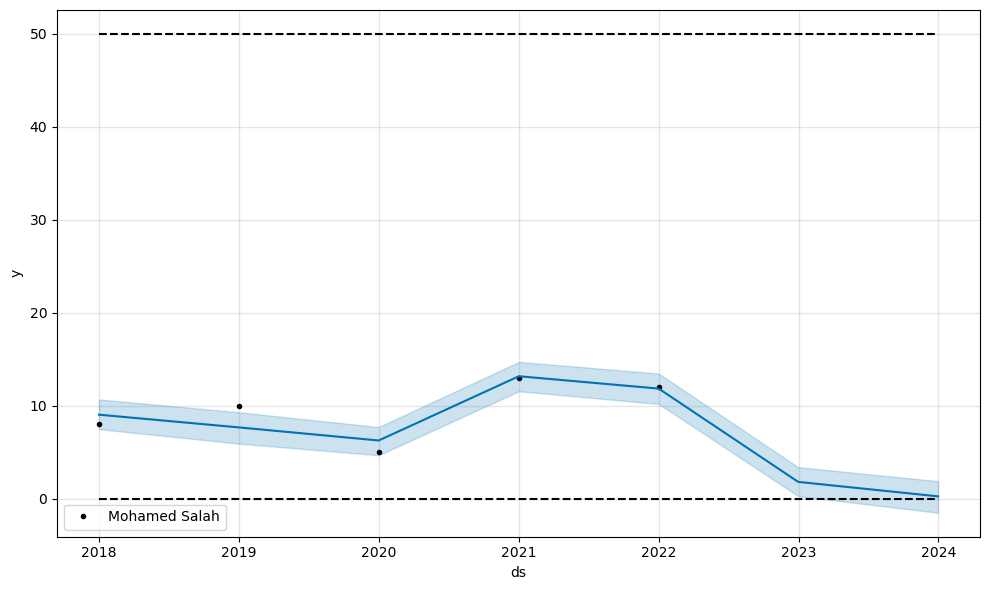

14:19:19 - cmdstanpy - INFO - Chain [1] start processing
14:19:19 - cmdstanpy - INFO - Chain [1] done processing


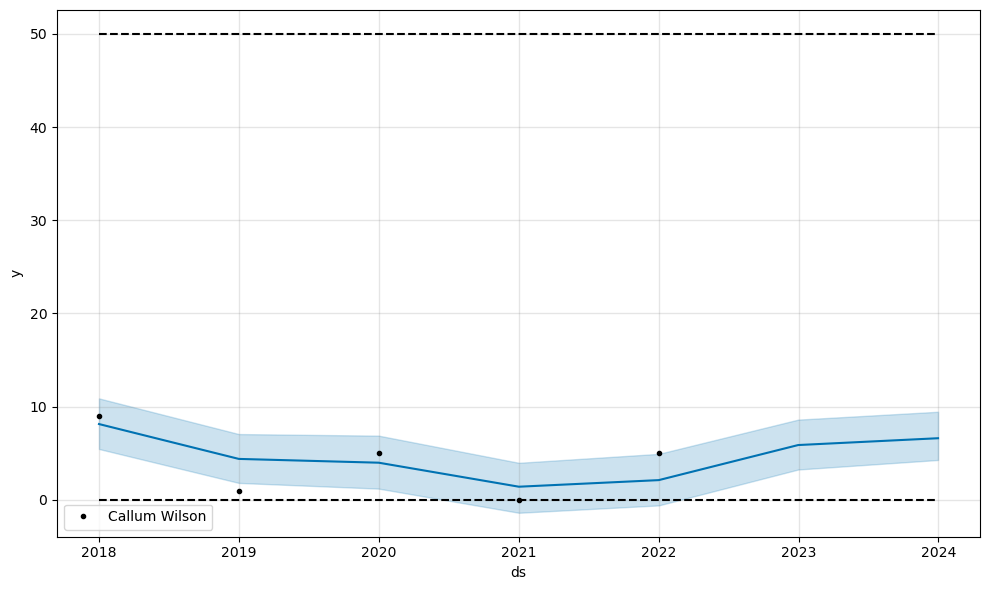

14:19:20 - cmdstanpy - INFO - Chain [1] start processing
14:19:20 - cmdstanpy - INFO - Chain [1] done processing


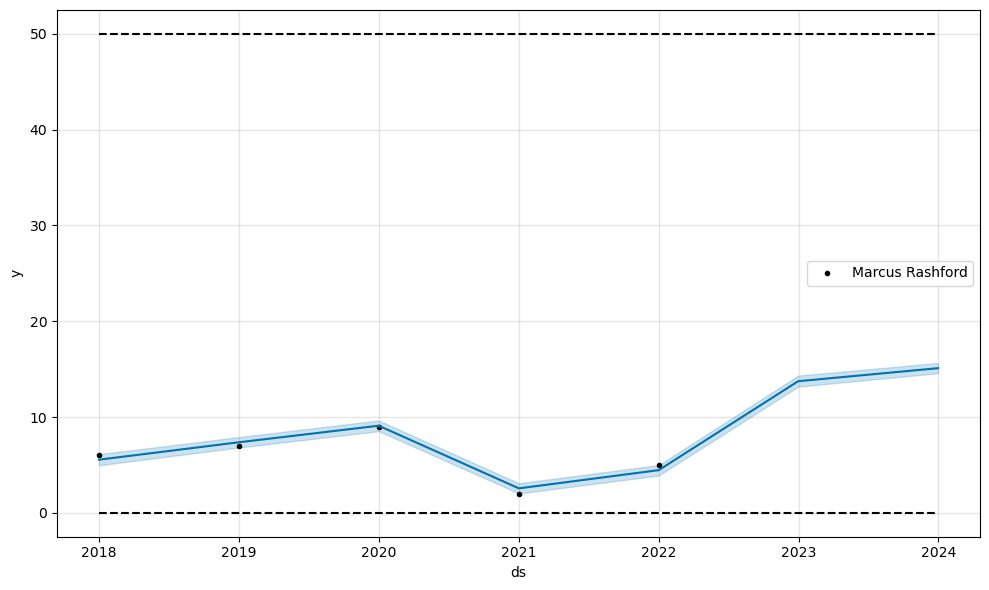

14:19:20 - cmdstanpy - INFO - Chain [1] start processing
14:19:21 - cmdstanpy - INFO - Chain [1] done processing


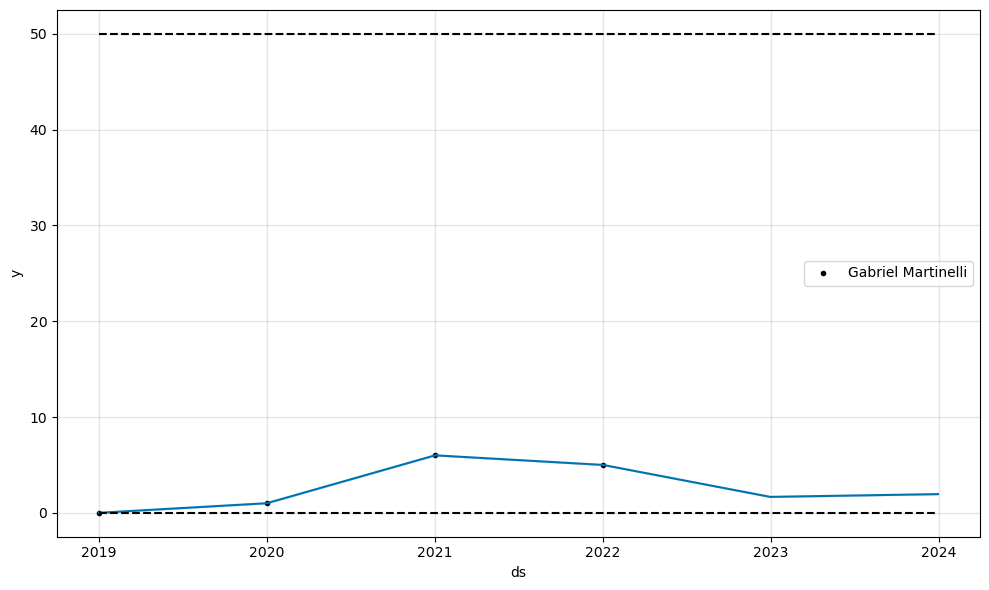

14:19:22 - cmdstanpy - INFO - Chain [1] start processing
14:19:24 - cmdstanpy - INFO - Chain [1] done processing


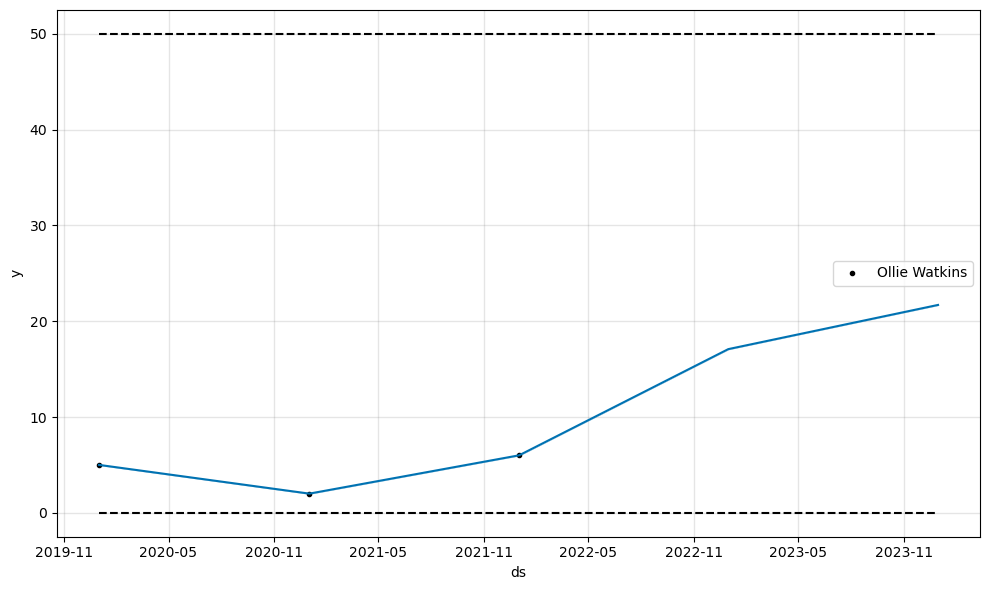

14:19:26 - cmdstanpy - INFO - Chain [1] start processing
14:19:31 - cmdstanpy - INFO - Chain [1] done processing


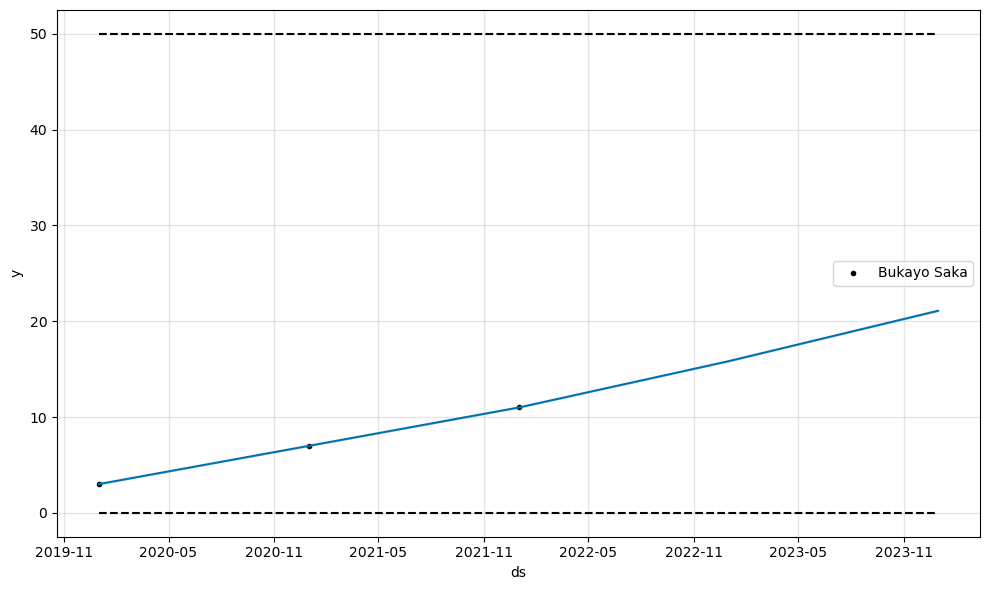

14:19:32 - cmdstanpy - INFO - Chain [1] start processing
14:19:32 - cmdstanpy - INFO - Chain [1] done processing


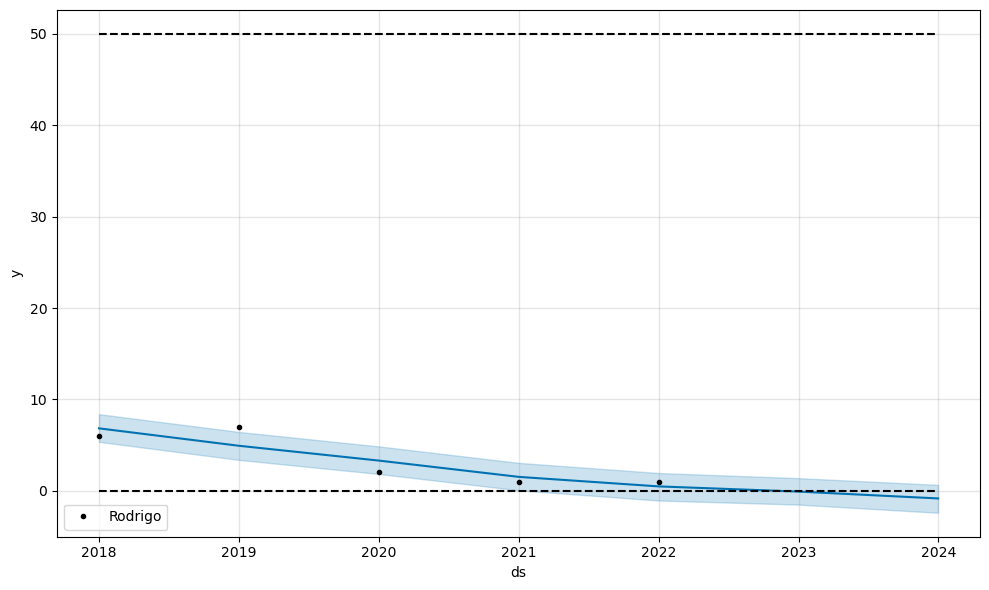

14:19:33 - cmdstanpy - INFO - Chain [1] start processing
14:19:35 - cmdstanpy - INFO - Chain [1] done processing


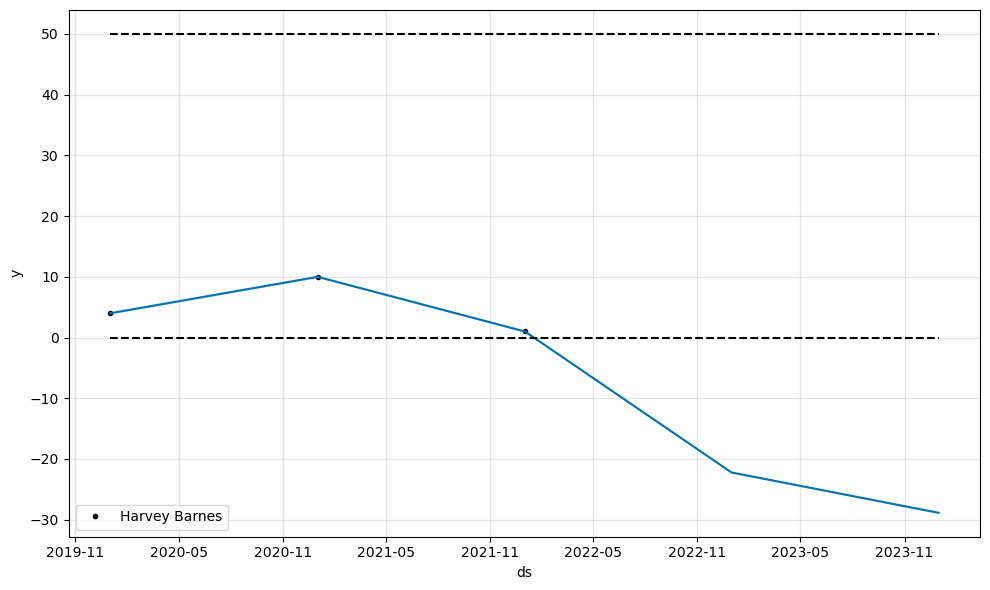

14:19:36 - cmdstanpy - INFO - Chain [1] start processing
14:19:36 - cmdstanpy - INFO - Chain [1] done processing


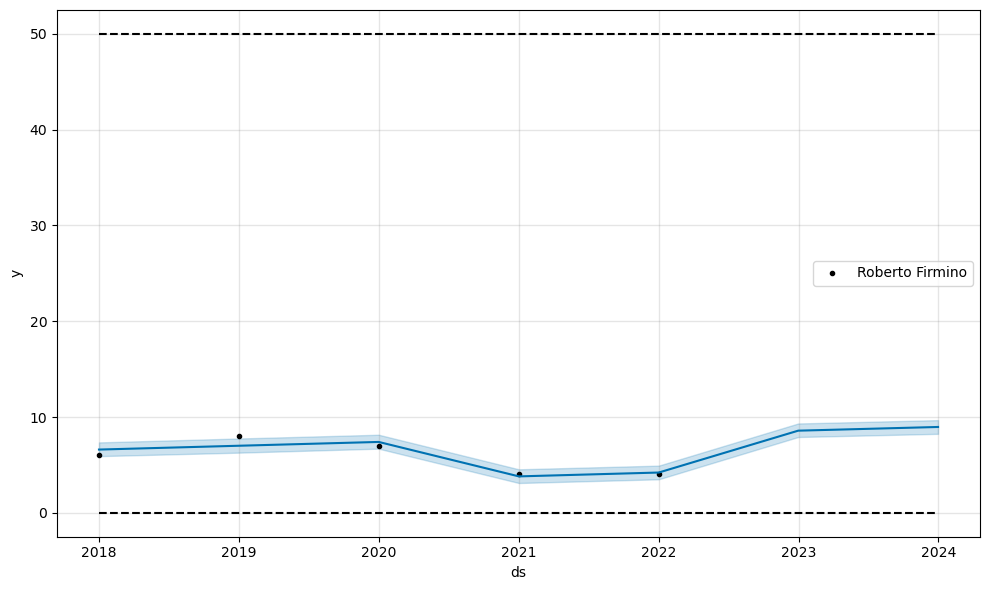

14:19:37 - cmdstanpy - INFO - Chain [1] start processing
14:19:37 - cmdstanpy - INFO - Chain [1] done processing


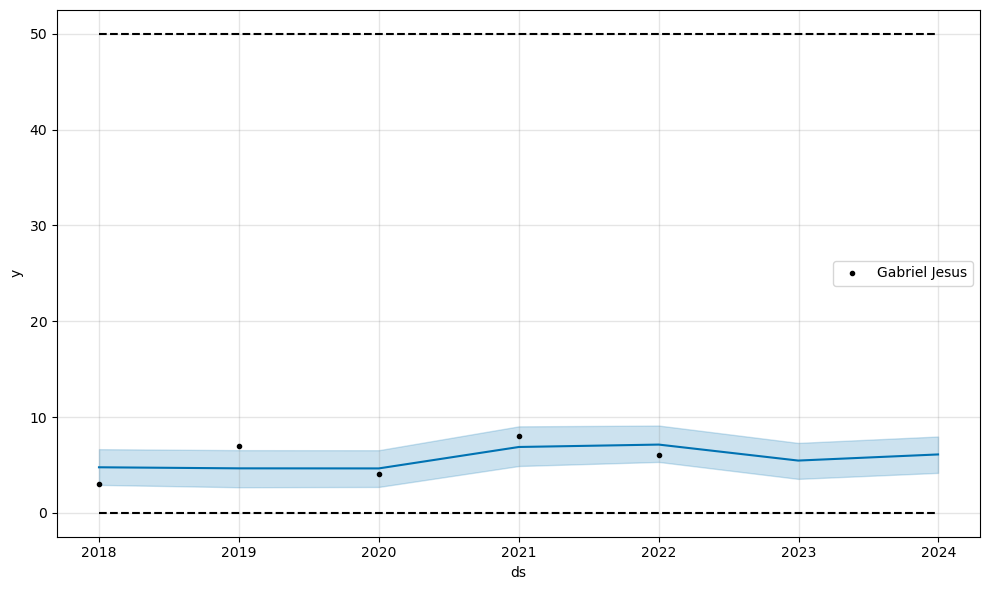

14:19:37 - cmdstanpy - INFO - Chain [1] start processing
14:19:38 - cmdstanpy - INFO - Chain [1] done processing


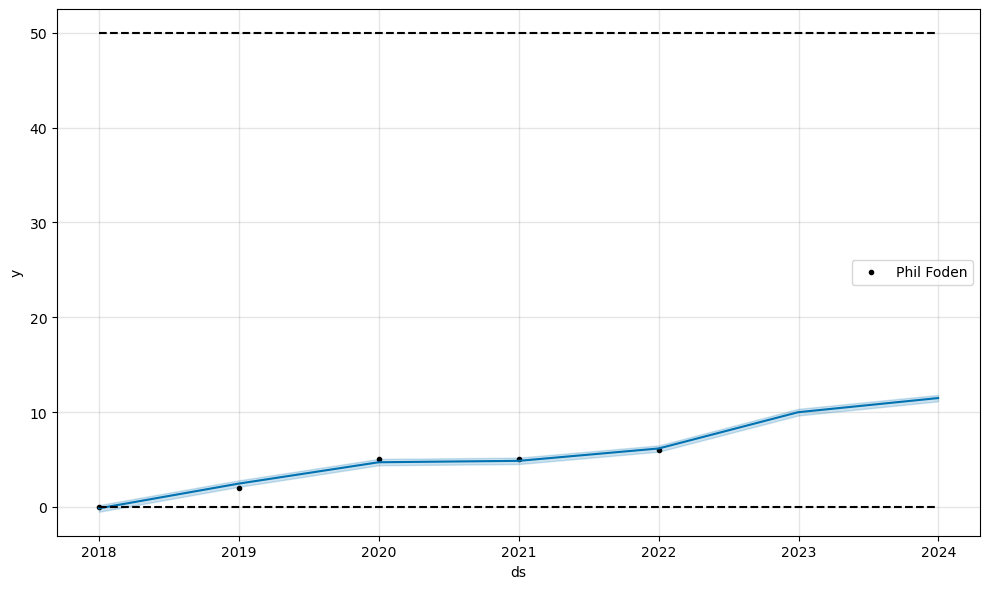

14:19:38 - cmdstanpy - INFO - Chain [1] start processing
14:19:38 - cmdstanpy - INFO - Chain [1] done processing


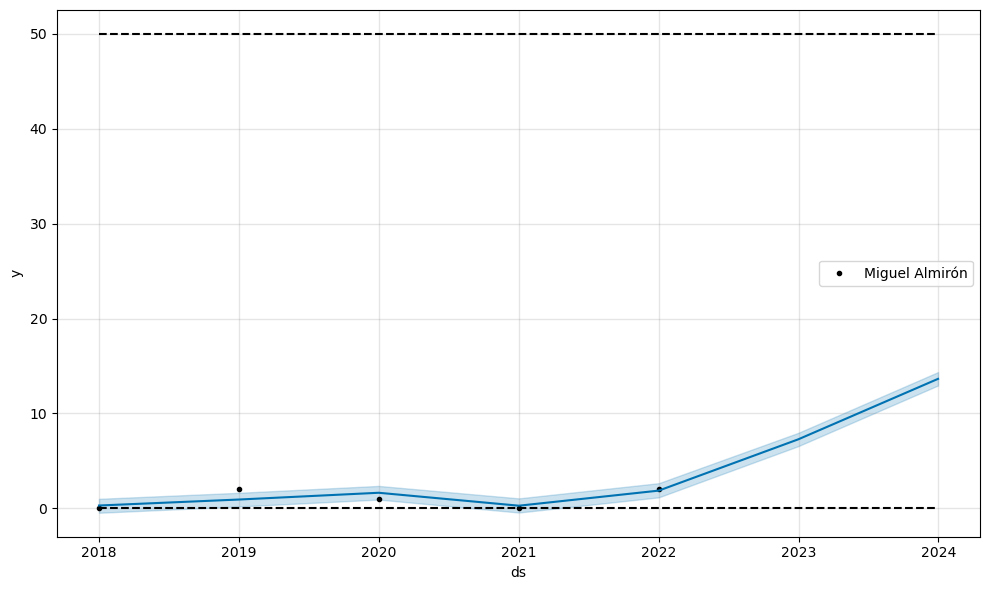

14:19:39 - cmdstanpy - INFO - Chain [1] start processing
14:19:58 - cmdstanpy - INFO - Chain [1] done processing


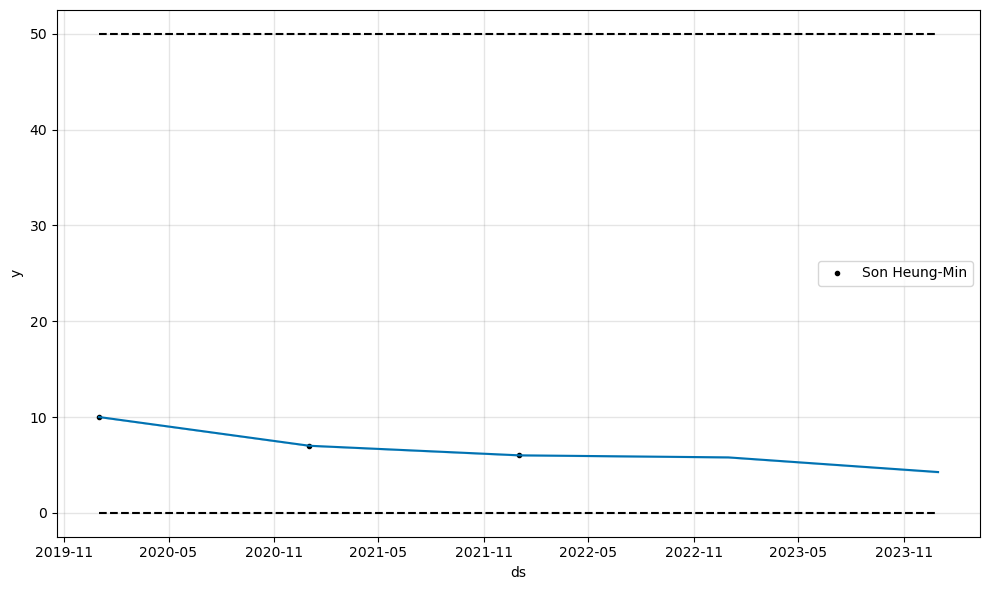

14:19:59 - cmdstanpy - INFO - Chain [1] start processing
14:20:00 - cmdstanpy - INFO - Chain [1] done processing


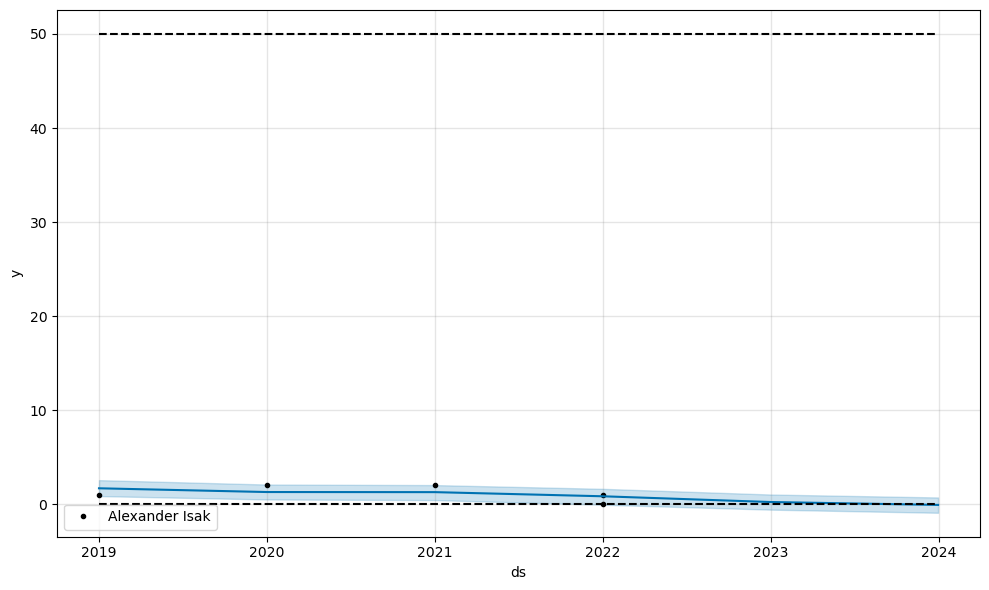

14:20:00 - cmdstanpy - INFO - Chain [1] start processing
14:20:01 - cmdstanpy - INFO - Chain [1] done processing


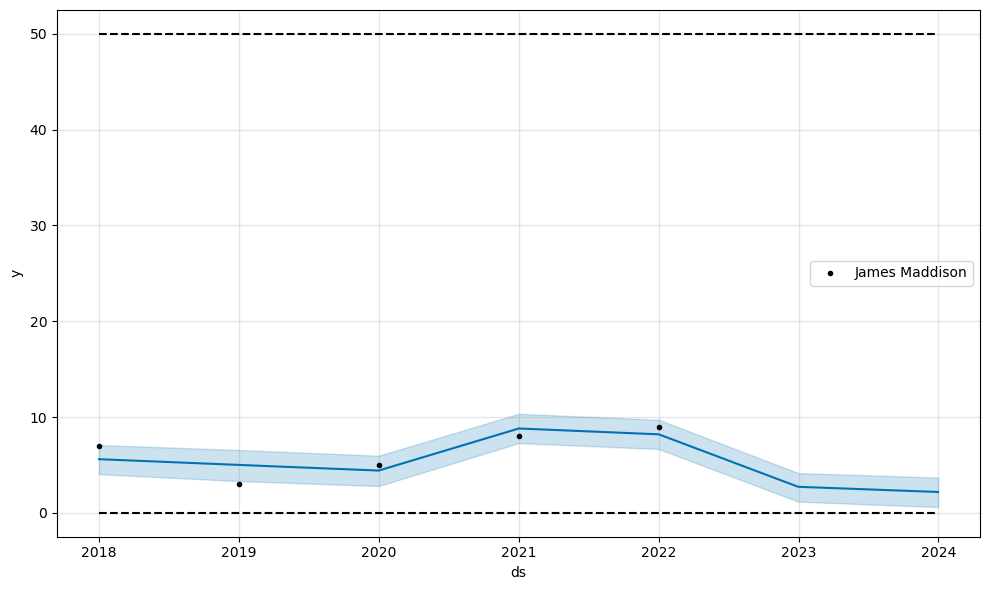

14:20:02 - cmdstanpy - INFO - Chain [1] start processing
14:20:02 - cmdstanpy - INFO - Chain [1] done processing


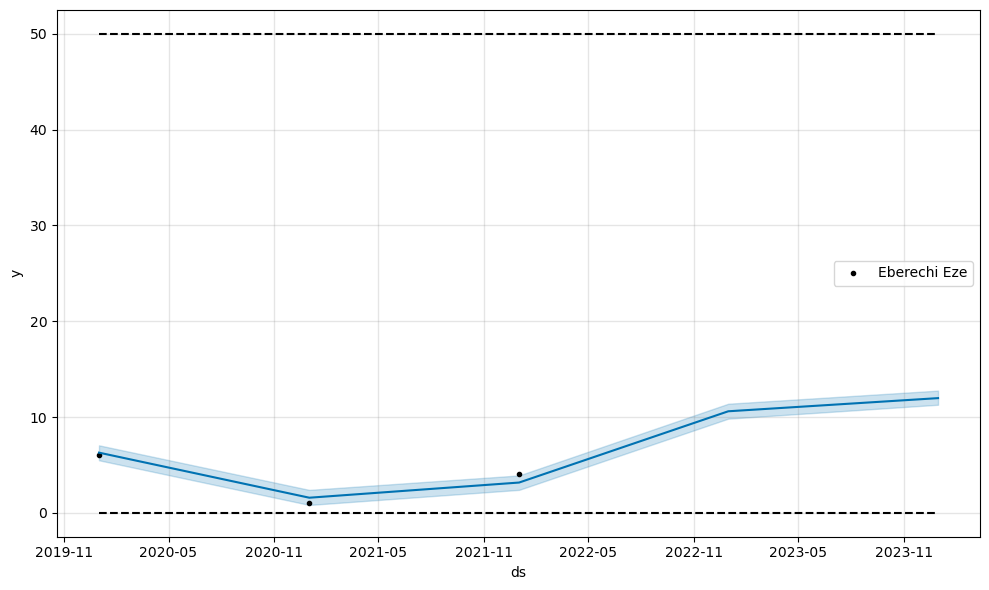

In [ ]:
err_assist = time_series_G_A(player_assists,'assists')

In [ ]:
err_assist

,Mean absolute error
0,0.000011
1,3.602494
2,1.046061
3,0.992256
4,1.912738
5,0.401353
6,0.000215
7,0.000009
8,0.000044
9,1.050316


In [ ]:
err_attack = pd.DataFrame({'Mean absolute error':err_attack.mean().values},index=['Prophet_model_attack'])
err_mid = pd.DataFrame({'Mean absolute error':err_mid.mean().values},index=['Prophet_model_mid'])
err_defend = pd.DataFrame({'Mean absolute error':err_defend.mean().values},index=['Prophet_model_defend'])
err_gk = pd.DataFrame({'Mean absolute error':err_gk.mean().values},index=['Prophet_model_gk'])

err_goals = pd.DataFrame({'Mean absolute error':err_goals.mean().values},index=['Prophet_model_goals'])
err_assist = pd.DataFrame({'Mean absolute error':err_assist.mean().values},index=['Prophet_model_assist'])

Prophet_model = pd.concat([err_attack,err_mid,err_defend,err_gk,err_goals,err_assist])
Prophet_model

,Mean absolute error
Prophet_model_attack,0.971068
Prophet_model_mid,0.406789
Prophet_model_defend,0.193406
Prophet_model_gk,0.354881
Prophet_model_goals,0.974689
Prophet_model_assist,0.732541


## ARIMA Model

### ARIMA overall forecasting

In [ ]:
attack_time = Trial_df[Trial_df['position'].isin( attackpos)][['overall','Year','short_name']]
mid_time =  Trial_df[Trial_df['position'].isin( midpos)][['Year','overall','short_name']]
defend_time =  Trial_df[Trial_df['position'].isin( defendpos)][['overall','Year','short_name']]
gk_time = Trial_df[Trial_df['position'] == 'GK'][['overall','Year','short_name']]

In [ ]:
def overall_arima(df):
    names = df[df.index == '01-01-2022']['short_name'].unique()[1:6]
    err = []
    
    for i in names:
        df_t = df[df['short_name'] == i]['overall']
        if df_t.shape[0] < 3:
            continue
        model = ARIMA(df_t,order = (2,1,2))
        result_AR_original = model.fit()
        err.append(mean_absolute_error(df_t,result_AR_original.fittedvalues))
        pred_uc = result_AR_original.get_forecast(steps = 2)
        pred_ci = pred_uc.conf_int()
        ax = df_t.plot(figsize=(14, 7))
        pred_uc.predicted_mean.plot(ax=ax, label='Forecast')
        ax.fill_between(pred_ci.index,
                        pred_ci.iloc[:, 0],
                        pred_ci.iloc[:, 1], color='k', alpha=.25)
        plt.legend(labels = [i])
        plt.show()
    return pd.DataFrame({'Mean absolute error' : err})

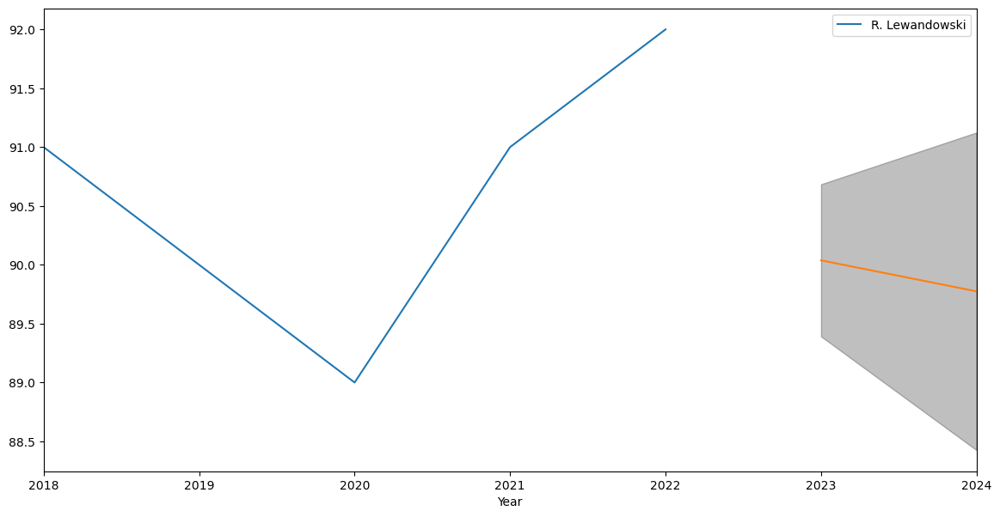

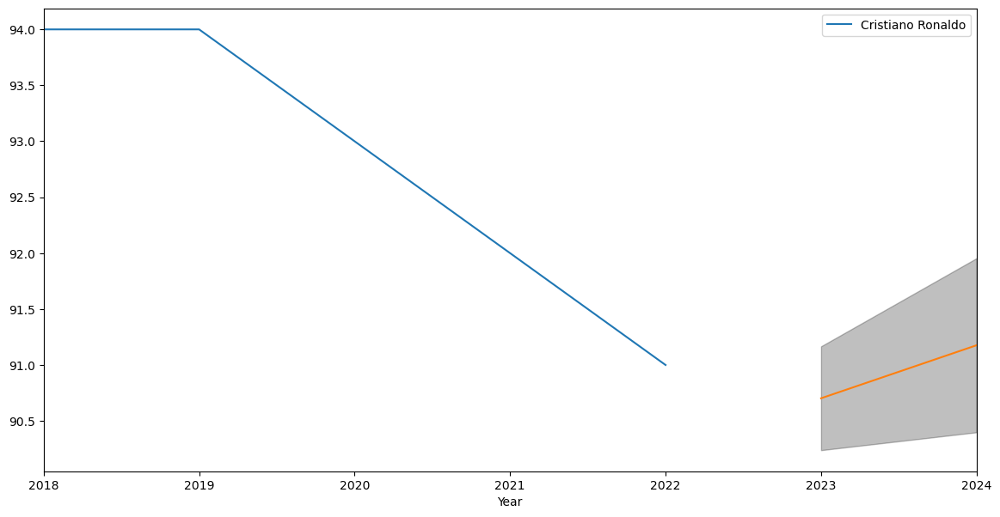

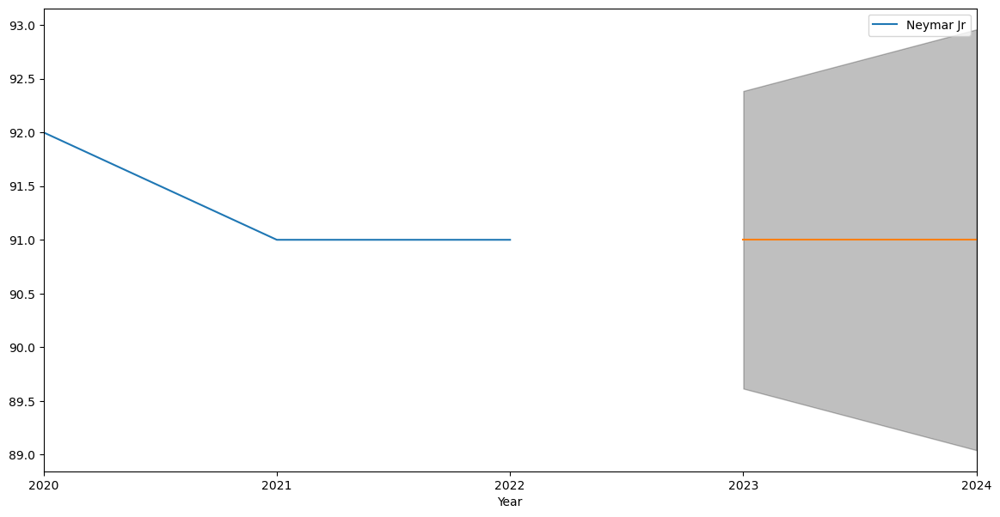

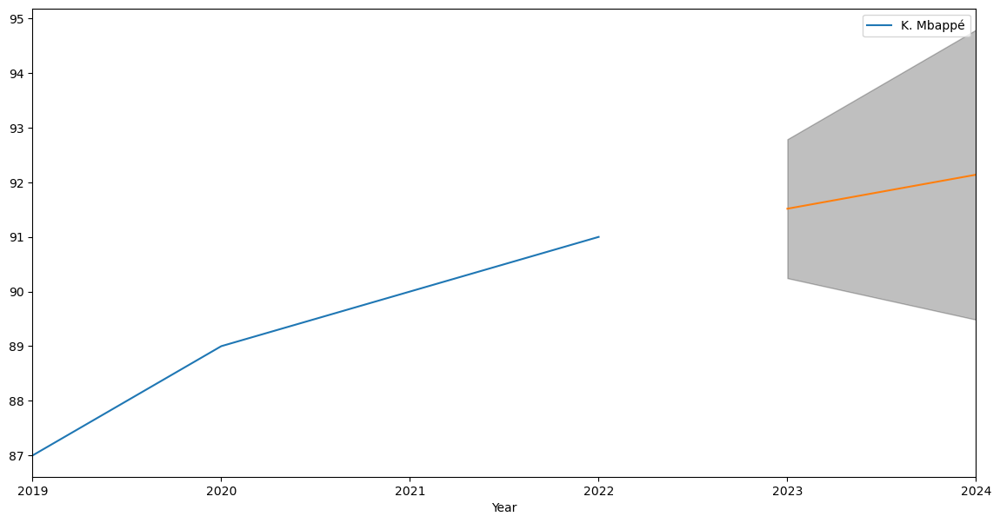

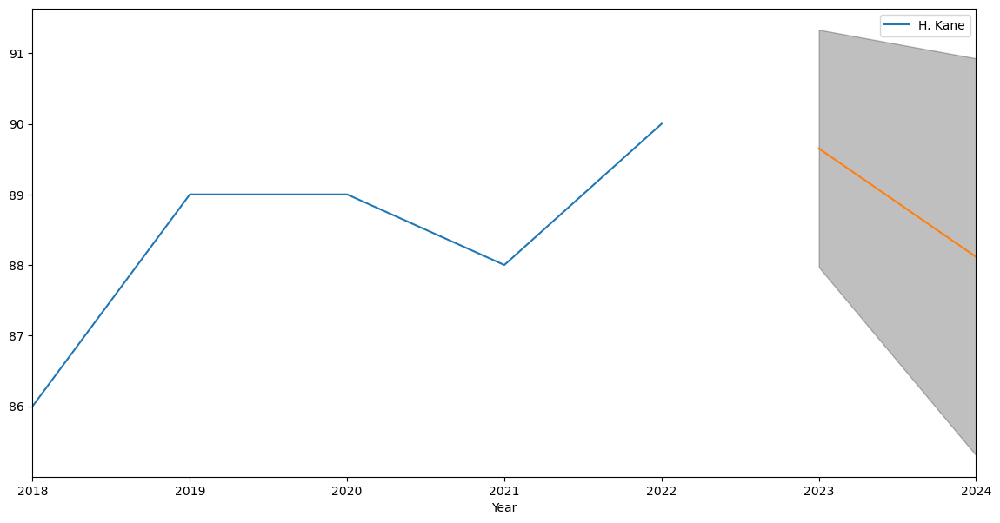

In [ ]:
attack_time['Year'] = pd.to_datetime(attack_time['Year'],format='%Y')
attack_time.set_index('Year',inplace = True)
err_attack = overall_arima(attack_time)

In [ ]:
err_attack

,Mean absolute error
0,18.821011
1,19.086044
2,31.000031
3,22.459214
4,18.186769


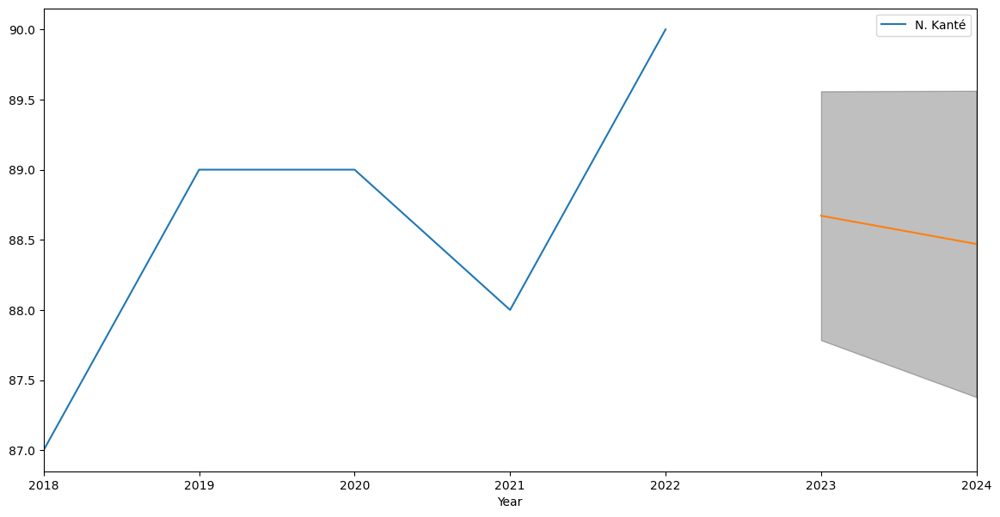

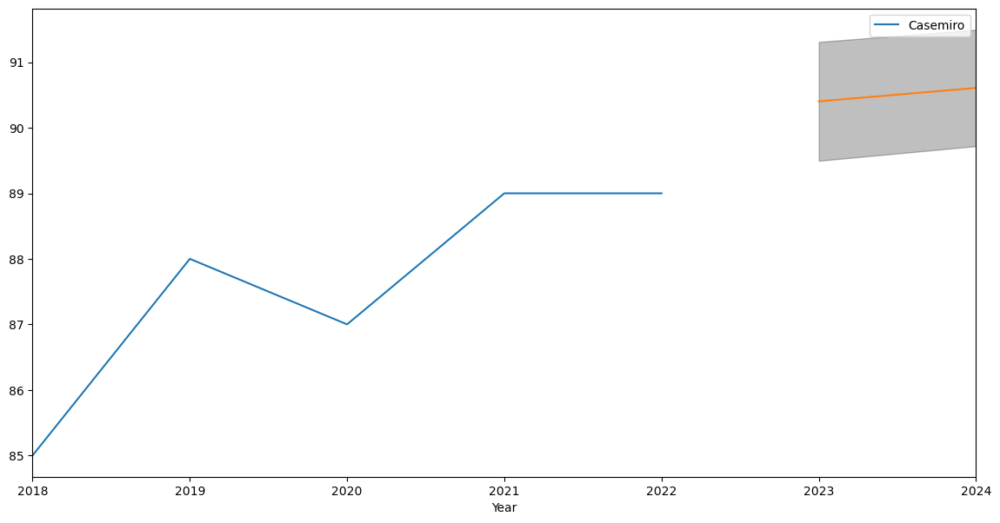

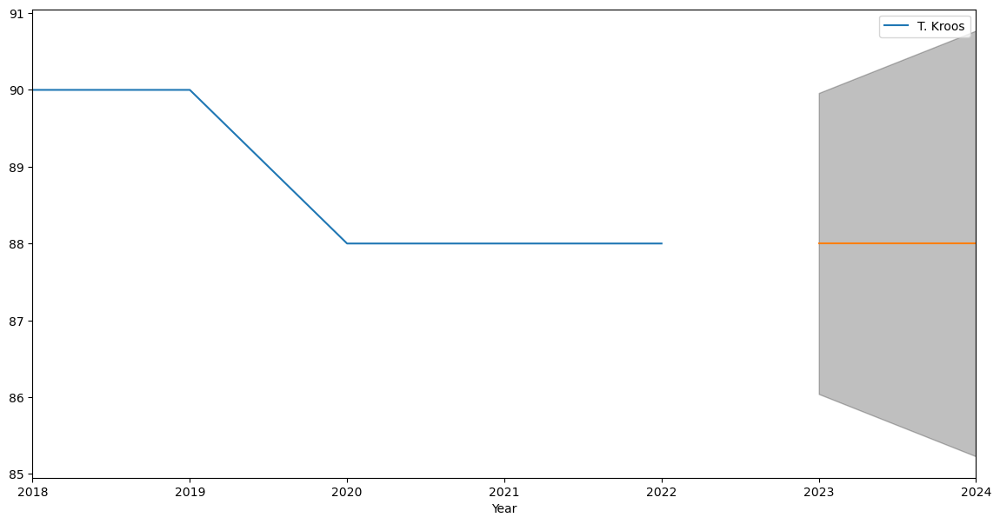

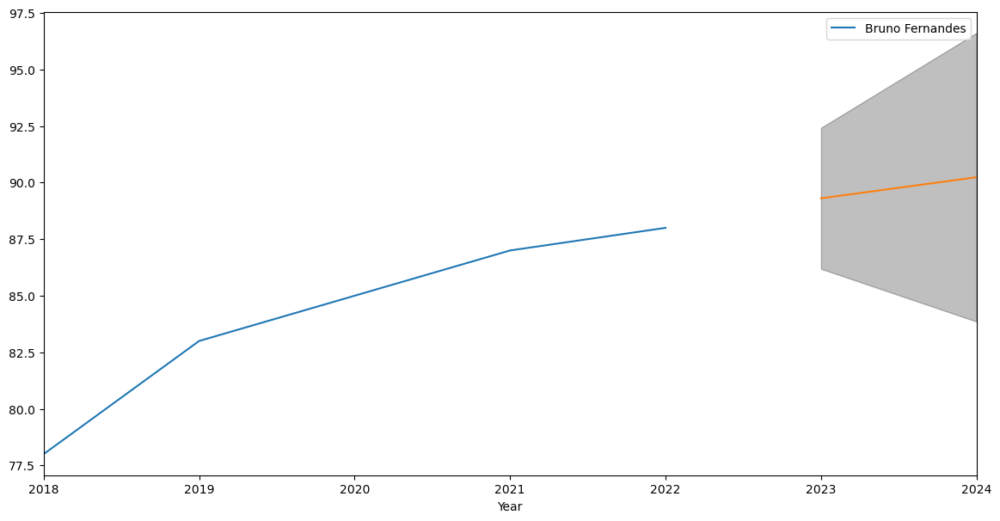

In [ ]:
mid_time['Year'] = pd.to_datetime(mid_time['Year'],format='%Y')
mid_time.set_index('Year',inplace = True)
err_mid = overall_arima(mid_time)

In [ ]:
err_mid

,Mean absolute error
0,18.189757
1,17.948526
2,18.400034
3,17.198297


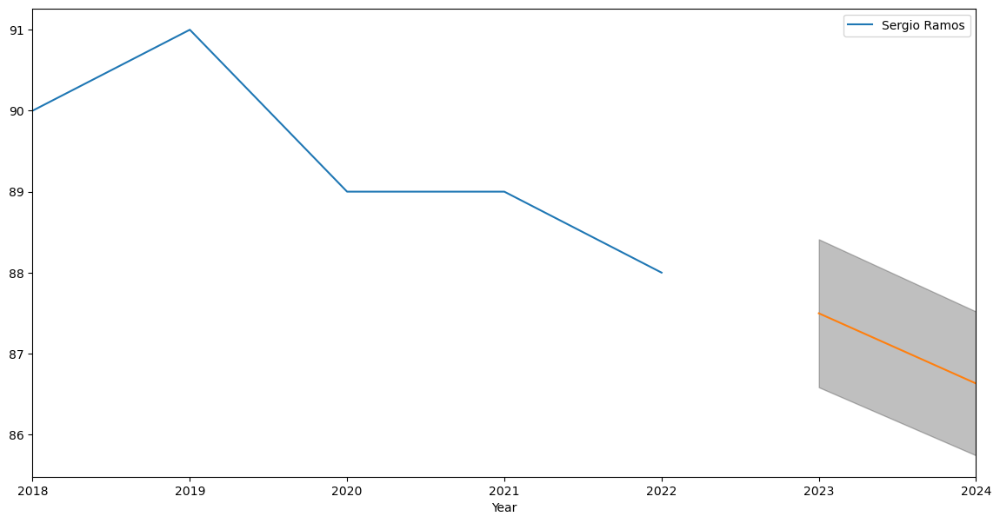

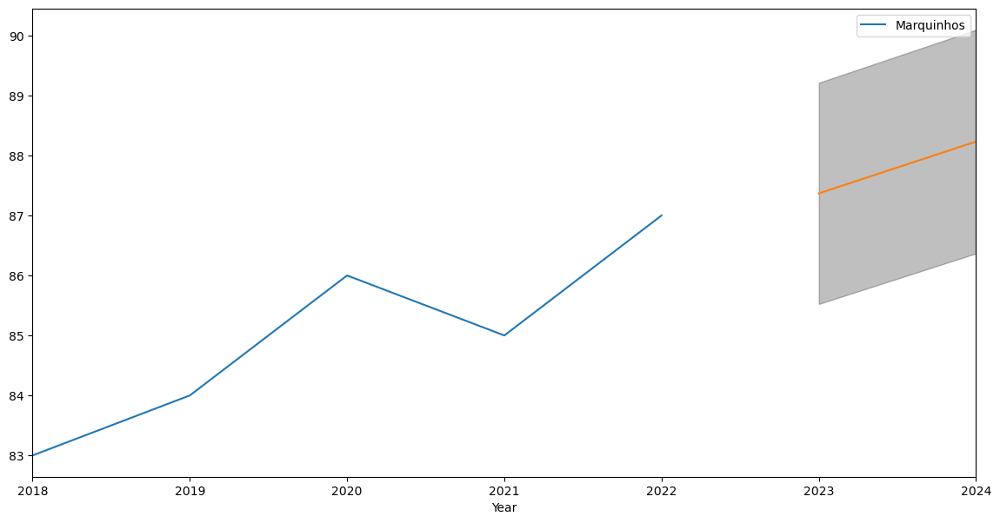

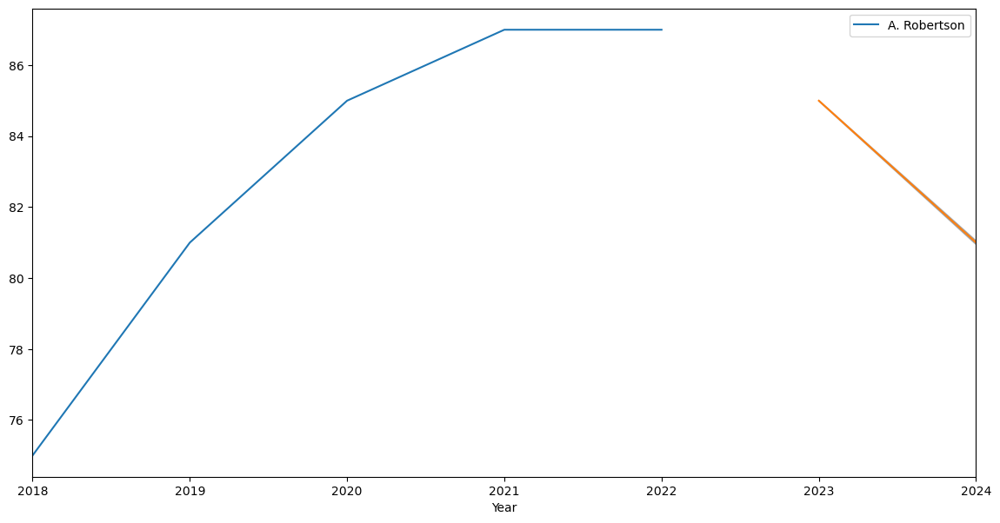

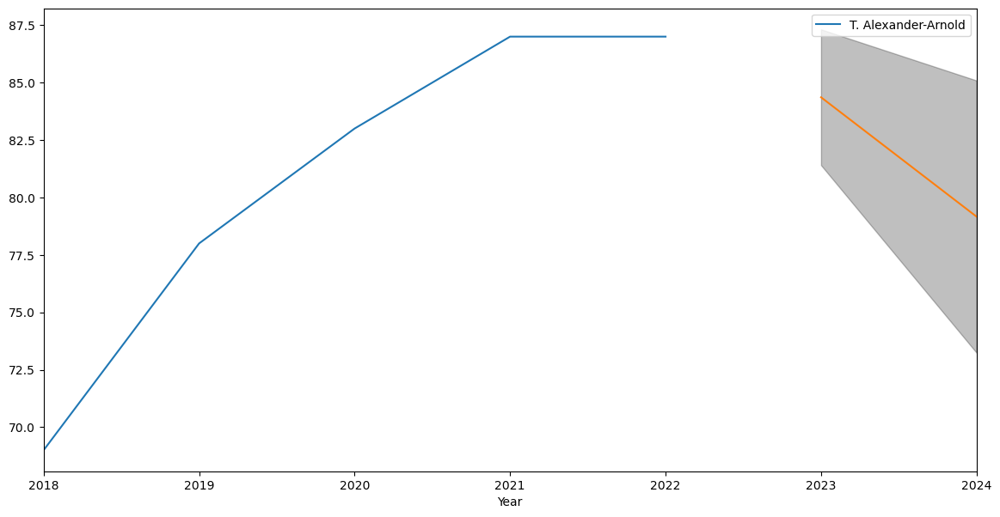

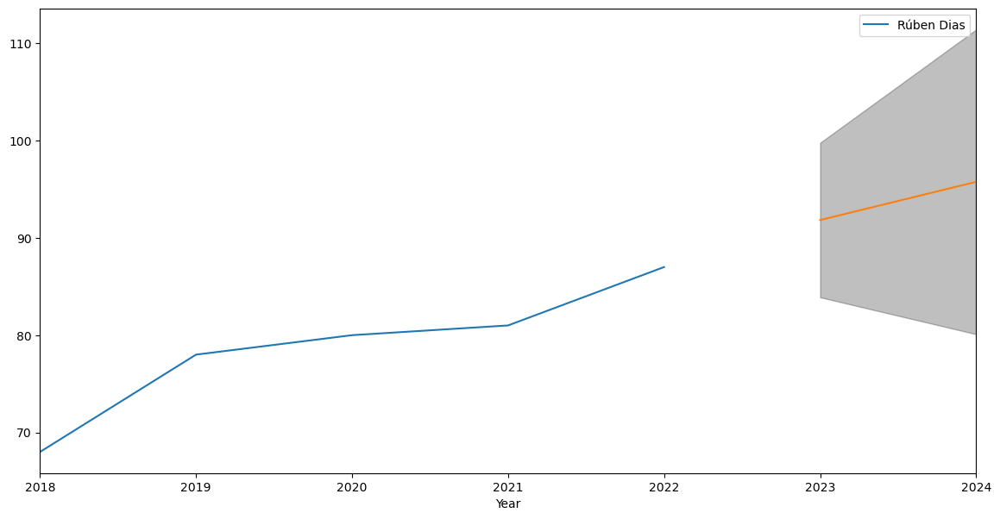

In [ ]:
defend_time['Year'] = pd.to_datetime(defend_time['Year'],format='%Y')
defend_time.set_index('Year',inplace = True)
err_defend = overall_arima(defend_time)

In [ ]:
err_defend

,Mean absolute error
0,18.721660
1,17.518863
2,16.561880
3,16.737519
4,17.039766


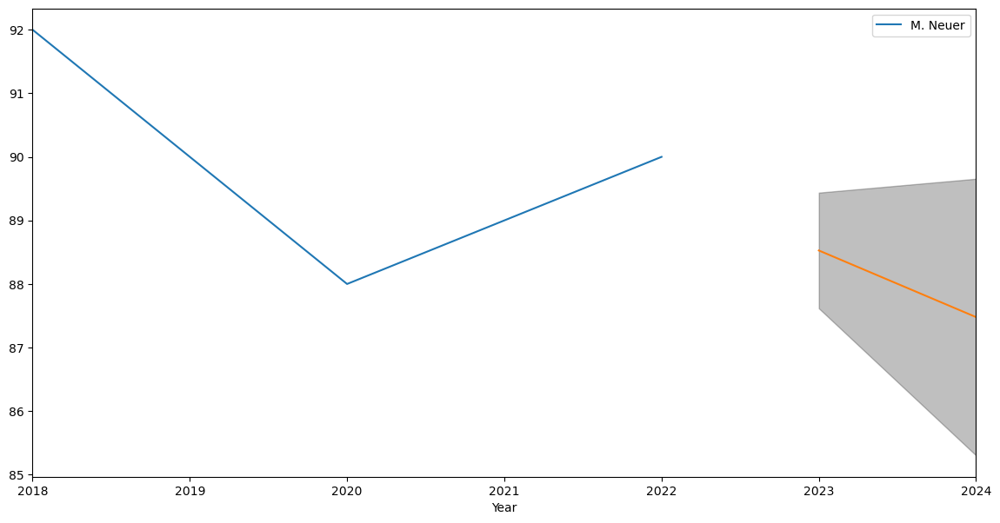

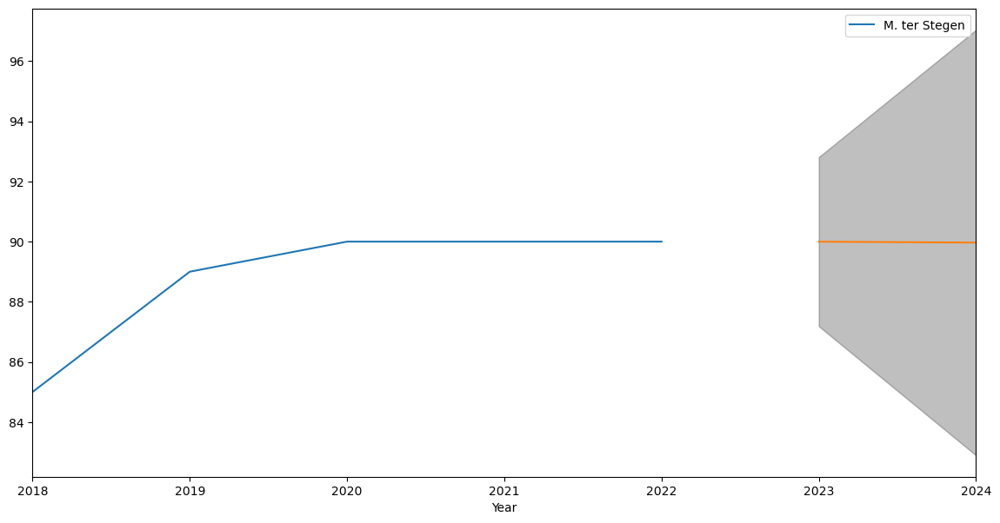

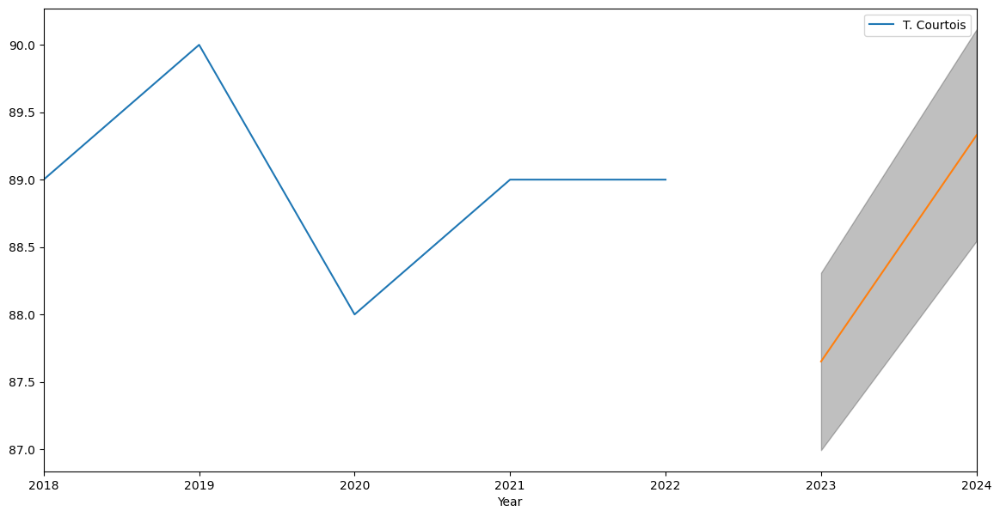

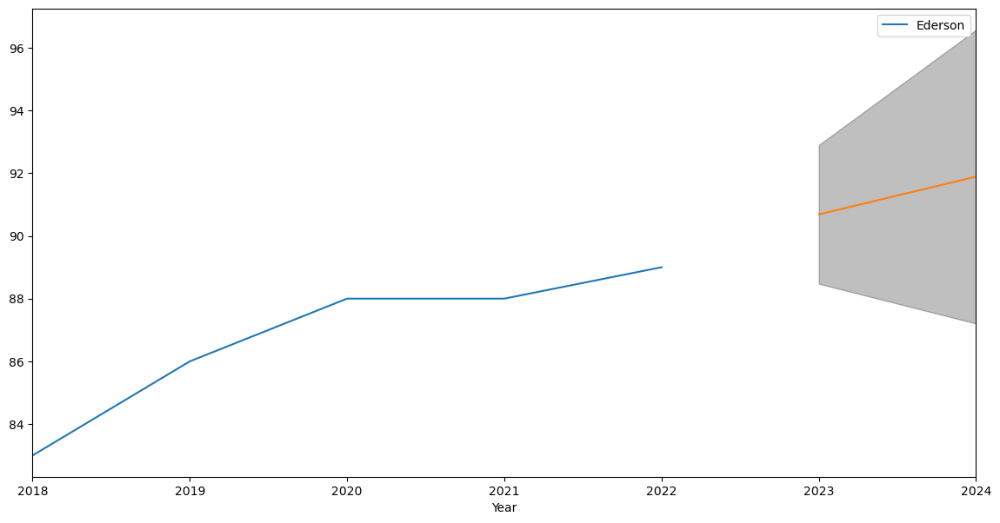

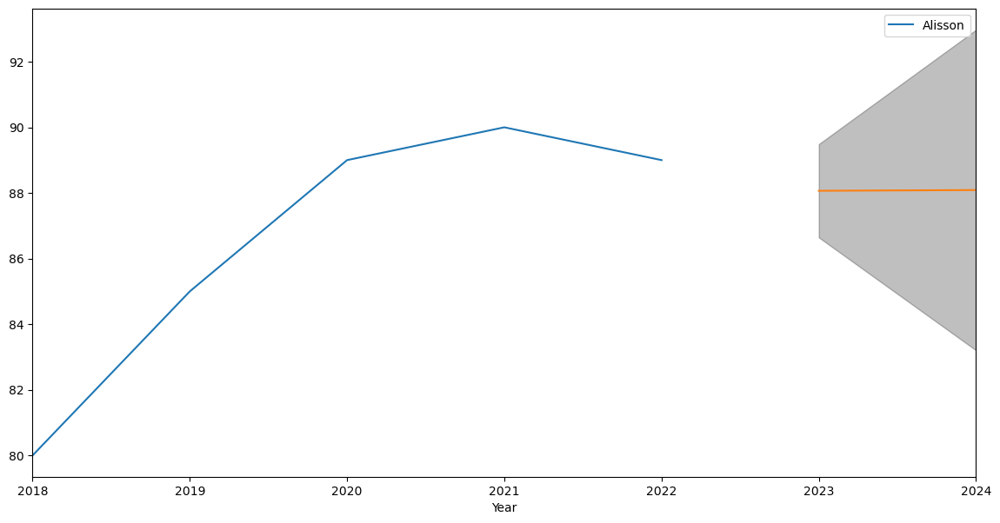

In [ ]:
gk_time['Year'] = pd.to_datetime(gk_time['Year'],format='%Y')
gk_time.set_index('Year',inplace = True)
err_gk = overall_arima(gk_time)

In [ ]:
err_gk

,Mean absolute error
0,19.337541
1,18.424824
2,18.412781
3,17.651521
4,17.242667


### ARIMA goals & assists forecasting

In [ ]:
def G_A_arima(df,col):
    names = df[df.index == '01-01-2022']['player_name'].unique()[10:16]
    err = []
    
    for i in names:
        df_t = df[df['player_name'] == i][col]
        if df_t.shape[0] < 2:
            continue
        model = ARIMA(df_t,order = (2,1,2))
        result_AR_original = model.fit()
        err.append(mean_absolute_error(df_t,result_AR_original.fittedvalues))
        pred_uc = result_AR_original.get_forecast(steps = 2)
        pred_ci = pred_uc.conf_int()
        ax = df_t.plot(figsize=(14, 7))
        pred_uc.predicted_mean.plot(ax=ax, label='Forecast')
        ax.fill_between(pred_ci.index,
                        pred_ci.iloc[:, 0],
                        pred_ci.iloc[:, 1], color='k', alpha=.25)
        plt.legend(labels = [i])
        plt.show()
    return pd.DataFrame({'Mean absolute error' : err})

In [ ]:
player_goals = player_char[['Year','player_name','goals']]
player_goals

,Year,player_name,goals
0,2018,Pierre-Emerick Aubameyang,22
1,2018,Sadio Mané,22
2,2018,Mohamed Salah,22
3,2018,Sergio Agüero,21
4,2018,Jamie Vardy,18
...,...,...,...
10023,2022,Ángel Alarcón,0
10024,2022,Alexander Callens,0
10025,2022,Ángel Alarcón,0
10026,2022,Francisco Mwepu,0


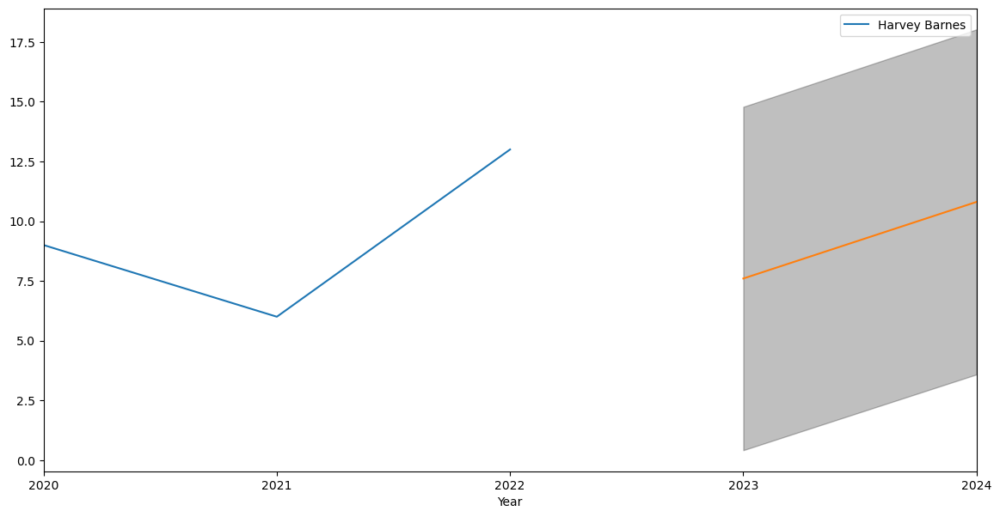

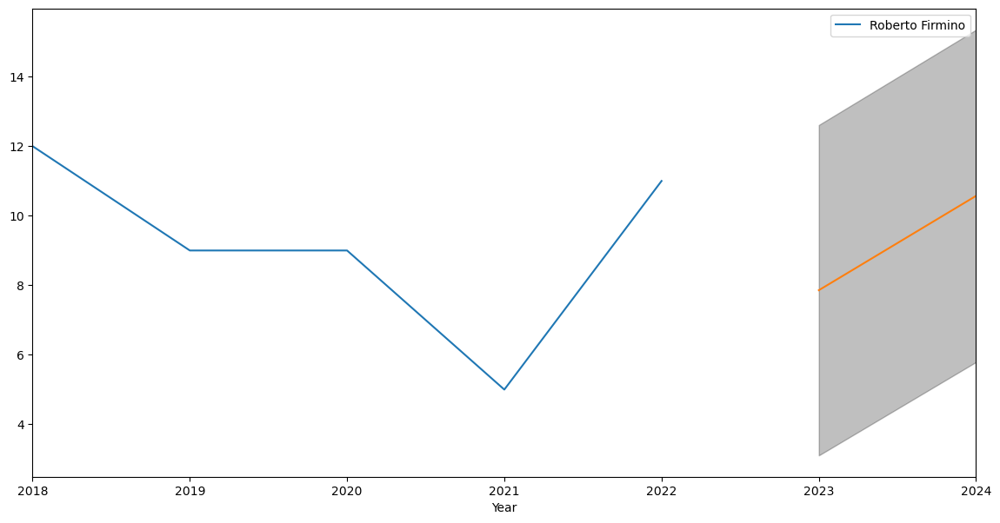

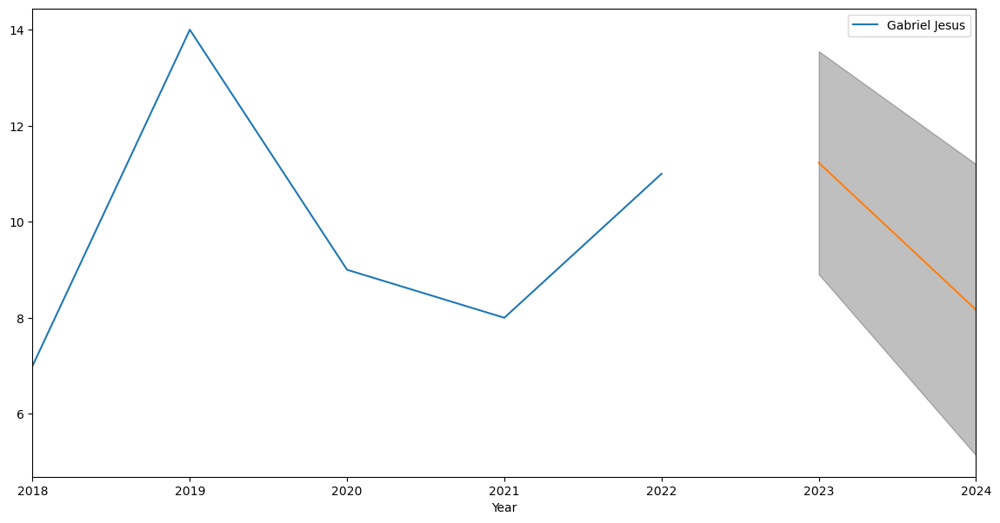

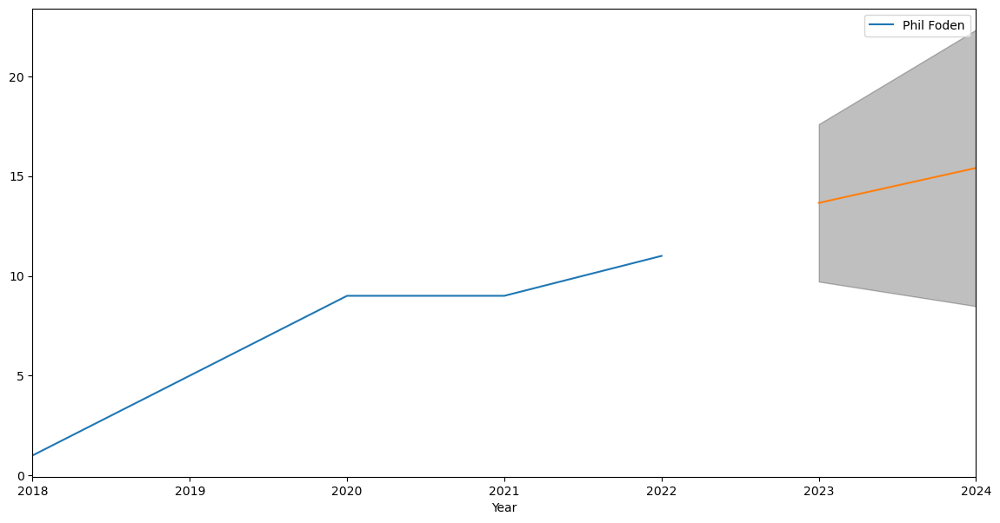

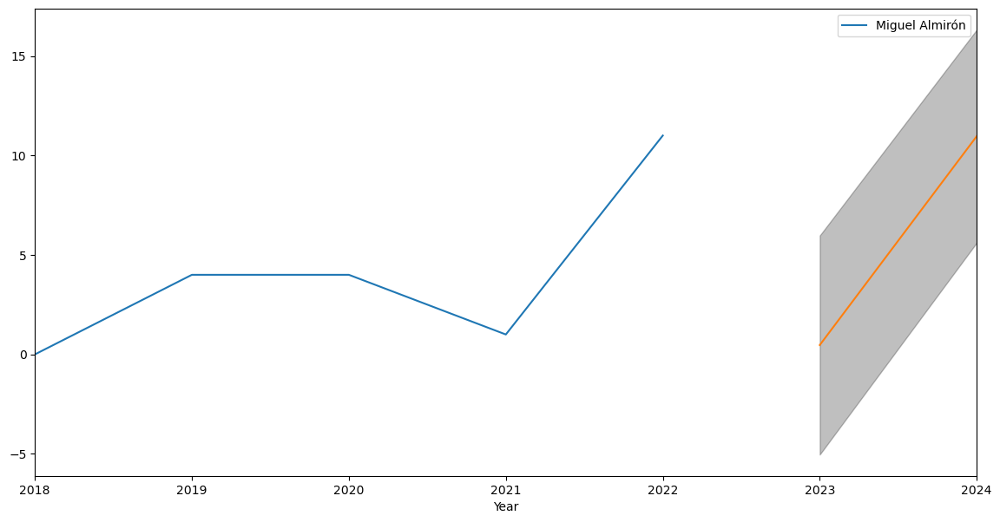

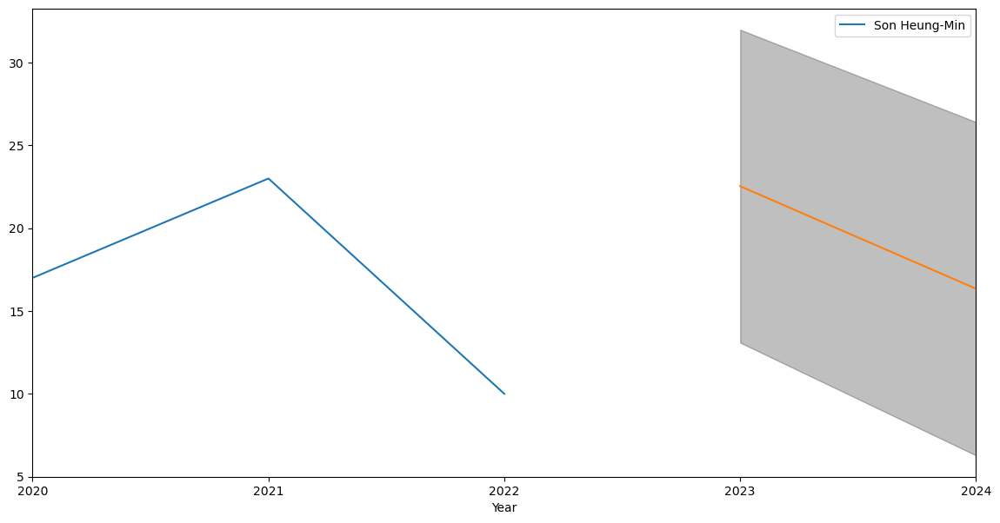

In [ ]:
player_goals['Year'] = pd.to_datetime(player_goals['Year'],format='%Y')
player_goals.set_index('Year',inplace = True)
err_goals = G_A_arima(player_goals,'goals')

In [ ]:
err_goals

,Mean absolute error
0,5.609117
1,4.610063
2,3.483134
3,1.985438
4,2.585746
5,10.478472


In [ ]:
player_assists = player_char[['Year','player_name','assists']]
player_assists

,Year,player_name,assists
0,2018,Pierre-Emerick Aubameyang,5
1,2018,Sadio Mané,1
2,2018,Mohamed Salah,8
3,2018,Sergio Agüero,8
4,2018,Jamie Vardy,4
...,...,...,...
10023,2022,Ángel Alarcón,0
10024,2022,Alexander Callens,0
10025,2022,Ángel Alarcón,0
10026,2022,Francisco Mwepu,0


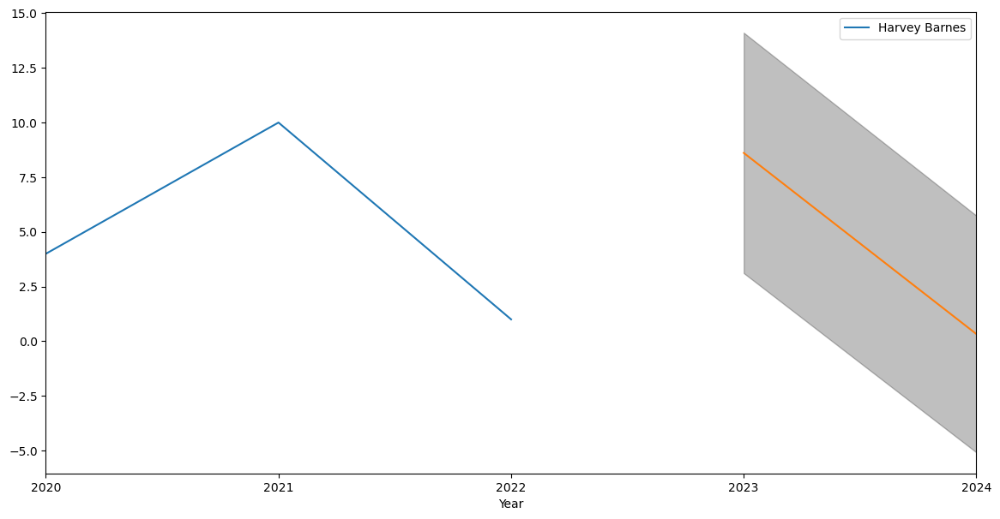

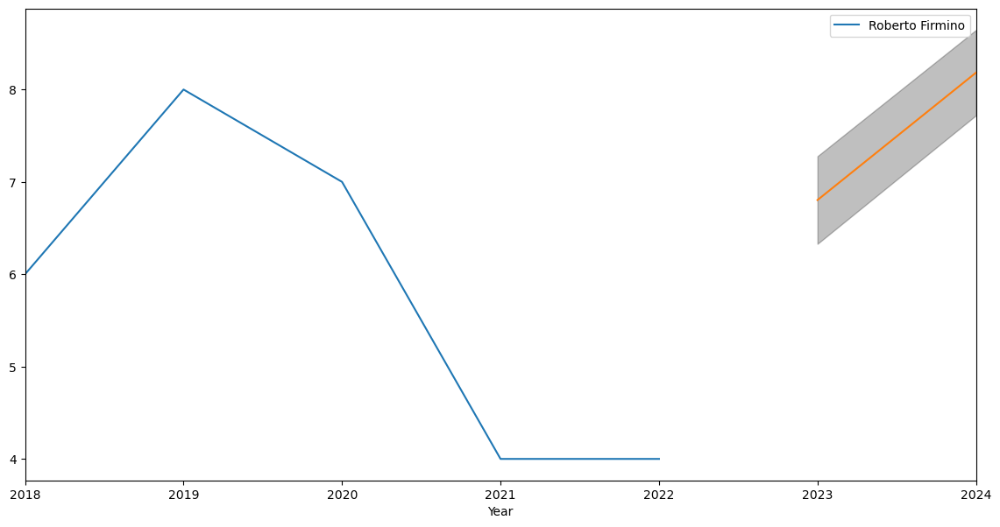

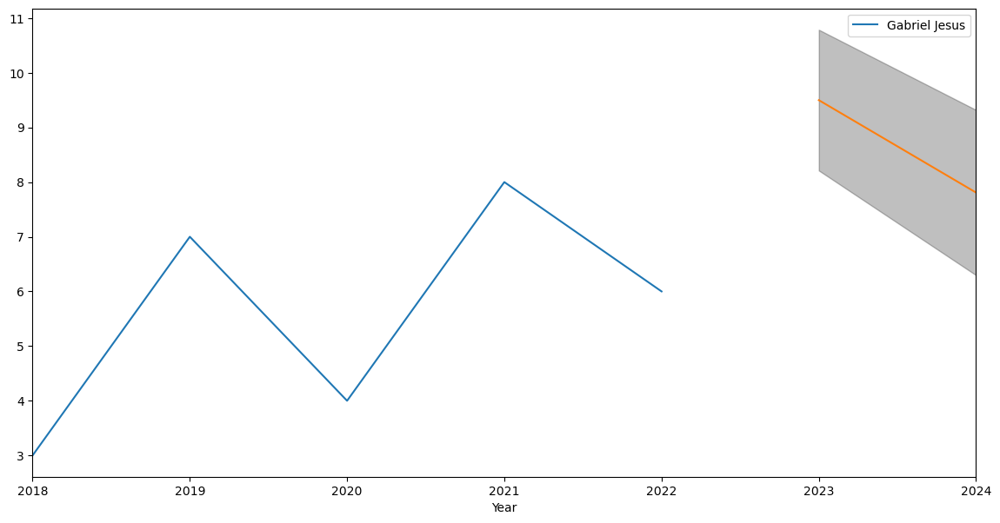

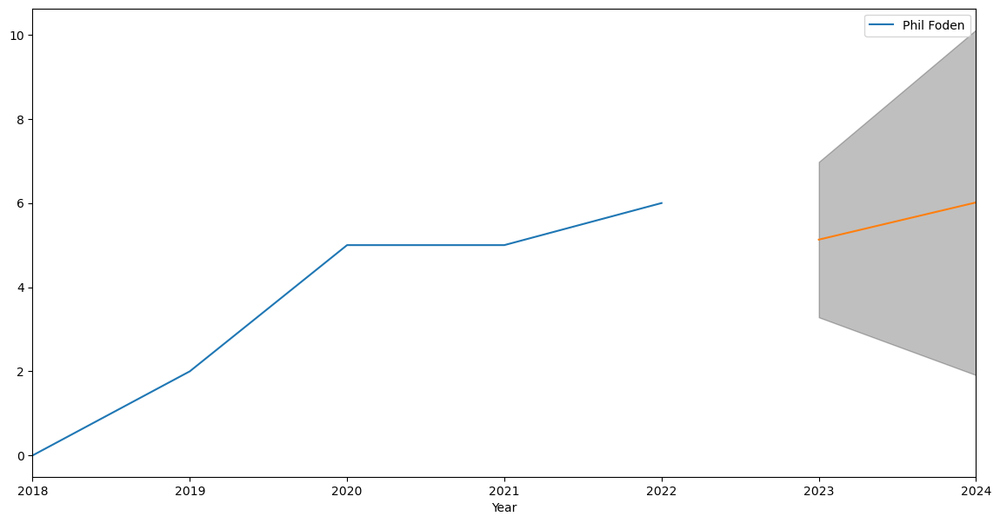

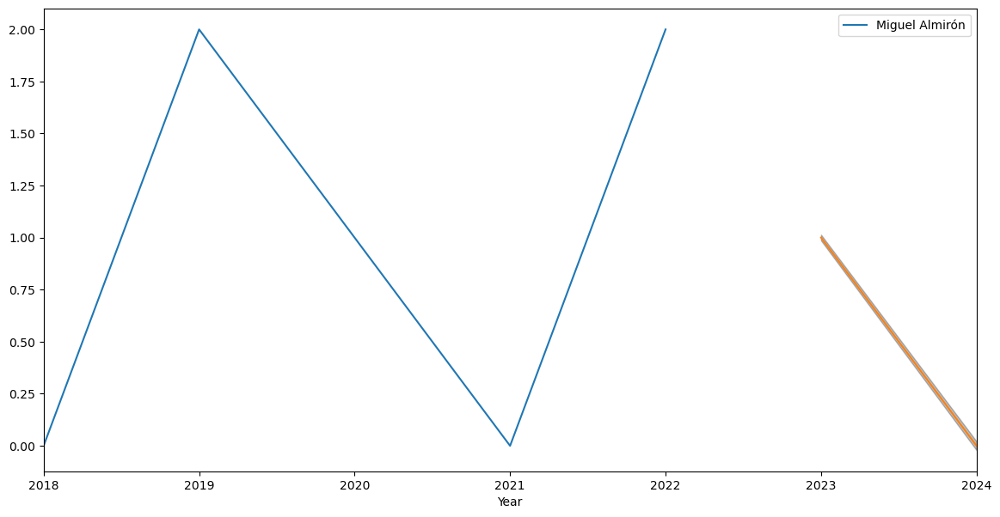

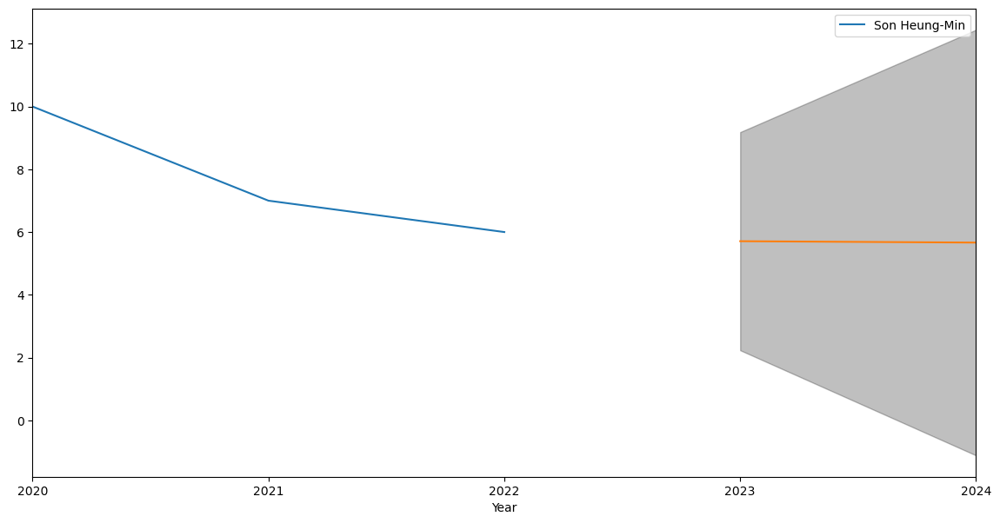

In [ ]:
player_assists['Year'] = pd.to_datetime(player_assists['Year'],format='%Y')
player_assists.set_index('Year',inplace = True)
err_assist = G_A_arima(player_assists,'assists')

In [ ]:
err_assist

,Mean absolute error
0,4.487248
1,2.024464
2,1.762109
3,1.155408
4,0.400071
5,4.599999


In [ ]:
err_attack = pd.DataFrame({'Mean absolute error':err_attack.mean().values},index=['ARIMA_model_attack'])
err_mid = pd.DataFrame({'Mean absolute error':err_mid.mean().values},index=['ARIMA_model_mid'])
err_defend = pd.DataFrame({'Mean absolute error':err_defend.mean().values},index=['ARIMA_model_defend'])
err_gk = pd.DataFrame({'Mean absolute error':err_gk.mean().values},index=['ARIMA_model_gk'])

err_goals = pd.DataFrame({'Mean absolute error':err_goals.mean().values},index=['ARIMA_model_goals'])
err_assist = pd.DataFrame({'Mean absolute error':err_assist.mean().values},index=['ARIMA_model_assist'])

ARIMA_model = pd.concat([err_attack,err_mid,err_defend,err_gk,err_goals,err_assist])
ARIMA_model

,Mean absolute error
ARIMA_model_attack,21.910614
ARIMA_model_mid,17.934154
ARIMA_model_defend,17.315938
ARIMA_model_gk,18.213866
ARIMA_model_goals,4.791995
ARIMA_model_assist,2.404883


Comparison between ARIMA model and prophet model

## Unsupervised Learning

Cost_Function=62938556.796299055 with 1 Clusters
Cost_Function=32939223.901443347 with 2 Clusters
Cost_Function=23688617.410532255 with 3 Clusters
Cost_Function=20238297.287103117 with 4 Clusters
Cost_Function=17700501.40910221 with 5 Clusters
Cost_Function=15686670.863388302 with 6 Clusters
Cost_Function=14349915.681476874 with 7 Clusters
Cost_Function=13349677.823777251 with 8 Clusters
Cost_Function=12406040.700961456 with 9 Clusters
Cost_Function=11583588.485658627 with 10 Clusters


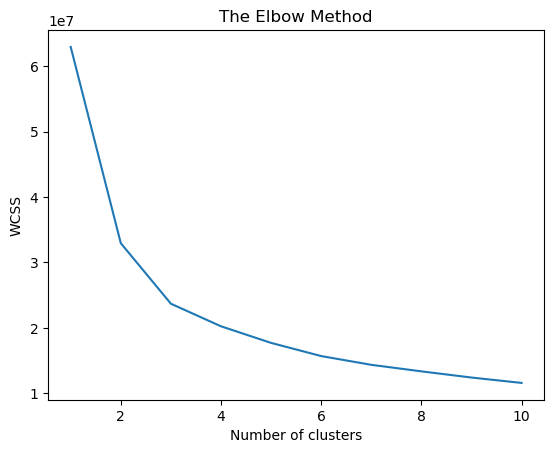

In [ ]:
from sklearn.cluster import KMeans,AgglomerativeClustering

wcss = []           

X = Trial_df[['power_strength','power_stamina','mentality_aggression']] 


for i in range(1, 11):
    kmeans = KMeans(n_clusters = i, init = 'k-means++')
    kmeans.fit(X)
    print(f'Cost_Function={kmeans.inertia_} with {i} Clusters')
    wcss.append(kmeans.inertia_)
    
plt.plot(range(1, 11), wcss)
plt.title('The Elbow Method')
plt.xlabel('Number of clusters')
plt.ylabel('WCSS')
plt.show()

In [ ]:
model = KMeans(n_clusters=3,n_init=50, random_state=0)
y_kmeans= model.fit_predict(X)

In [ ]:
clust = pd.DataFrame({'Clustering':y_kmeans})
clusters = pd.concat([X, clust], axis=1)
clusters

,power_strength,power_stamina,mentality_aggression,Clustering
0,80,92,63,1
1,59,73,48,2
2,83,44,29,0
3,80,89,78,1
4,53,78,56,2
...,...,...,...,...
87540,46,51,52,2
87541,47,63,49,2
87542,50,56,51,2
87543,40,50,34,0


In [ ]:
import plotly.express as px
fig = px.scatter_3d(clusters, x='power_strength', y='power_stamina', z='mentality_aggression', color='Clustering',
                    title='Injuries')

fig.update_layout(width = 1000,
                  height = 800)
fig.show()